# Fiddling about with spectra

## Reproduce QPQ8 results

In [1]:
%matplotlib inline

In [2]:
# imports
from __future__ import print_function,absolute_import,division,unicode_literals
import numpy as np
import glob,os,sys,copy,imp 
from scipy import stats as scistats
import matplotlib as mpl
mpl.rcParams['font.family']='stixgeneral'
from matplotlib.backends.backend_pdf import PdfPages
from matplotlib import pyplot as plt
import matplotlib.gridspec as gridspec
from astropy.table import QTable,Table
from astropy.io import ascii,fits
from astropy import units as u
from astropy import constants as const
from astropy.coordinates import SkyCoord
from linetools.spectralline import AbsLine
import linetools.utils as ltu
from linetools.spectra.xspectrum1d import XSpectrum1D
from xastropy.igm.abs_sys import abssys_utils as abssys
from xastropy import spec as xpsec
from xastropy.plotting import utils as xputils
from xastropy.xutils import xdebug as xdb
from xastropy.obs import radec as xor
from xastropy.atomic import ionization as xai
from xastropy.xutils import fits as xxf
sys.path.append(os.path.abspath("../../../py"))
from enigma.qpq import utils as qpqutils
from enigma.qpq import spec as qpqs
from enigma.qpq import stacks as qpqk
from enigma.qpq import qpq as eqpq
sys.path.append(os.path.abspath("../Analysis/Bootstrap/py"))
import qpq9_boot as qpq9b
sys.path.append(os.path.abspath("../Analysis/Stacks/py"))
import qpq9_stacks as qpq9k
from astropy.modeling import models, fitting

/Users/lwymarie/anaconda/lib/python2.7/site-packages/astroquery/sdss/__init__.py:28: UserWarning: Experimental: SDSS has not yet been refactored to have its API match the rest of astroquery (but it's nearly there).
  warnings.warn("Experimental: SDSS has not yet been refactored to have its API "


Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits
Using spec-4216-55477-0198.fits.gz for BOSSJ0001+0000
S/N 0.0 1 / Angstrom


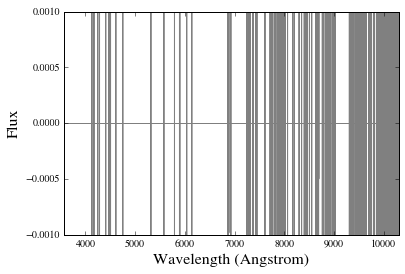

No spectrum found for BOSSJ0008-0039 and wvobs=3486.99 Angstrom!
Using spSpec-52994-1490-155.fit.gz for BOSSJ0008-0039
S/N 2.76495870168 1 / Angstrom


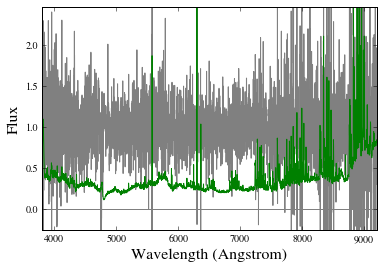

Using spec-6197-56191-0089.fits.gz for BOSSJ0042+1350
S/N 2.57936611809 1 / Angstrom


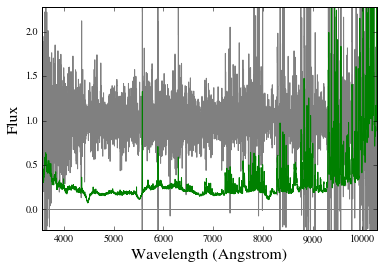

No spectrum found for BOSSJ0047+1447 and wvobs=3496.06 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ005718.90-000134.7.fits for BOSSJ0057-0001
S/N 6.41480558361 1 / Angstrom


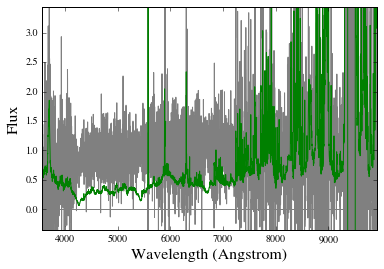

Using spec-3735-55209-0693.fits.gz for BOSSJ0103-0002
S/N 3.23908245976 1 / Angstrom


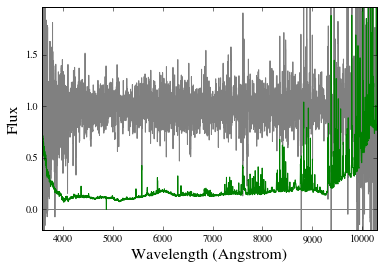

Using spec-4226-55475-0663.fits.gz for BOSSJ0106+0056
S/N 0.0 1 / Angstrom


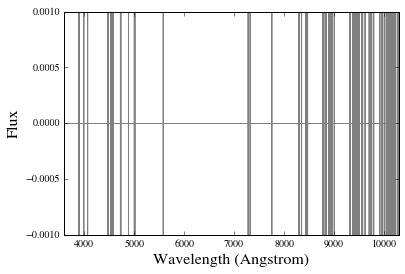

No spectrum found for SDSSJ0111+1402 and wvobs=4651.03 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ014917.46-002158.5_b1200_F.fits.gz for SDSSJ0149-0021
S/N 26.0103874929 1 / Angstrom


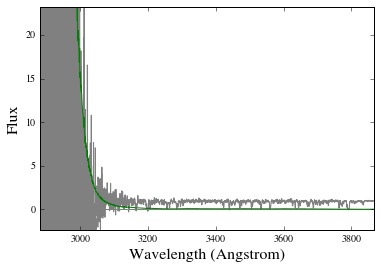

Using spec-4233-55449-0726.fits.gz for BOSSJ0154+0020
S/N 0.0 1 / Angstrom


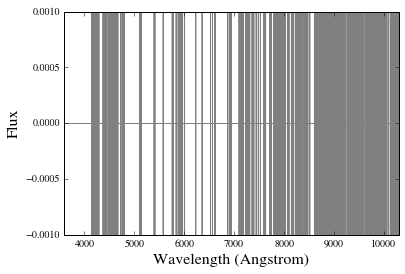

No spectrum found for BOSSJ0206+2238 and wvobs=3474.41 Angstrom!
Using spec-4236-55479-0340.fits.gz for BOSSJ0214-0052
S/N 3.64648354412 1 / Angstrom


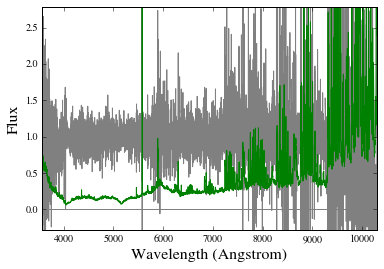

No spectrum found for BOSSJ0224-0046 and wvobs=3597.79 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ023019.99-033316.0.fits for BOSSJ0230-0333
S/N 11.2756982268 1 / Angstrom


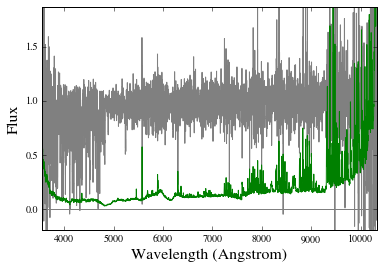

No continuum: /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ023946.44-010644.1_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ023946.45-010644.1.fits for BOSSJ0239-0106
S/N 8.08973344351 1 / Angstrom


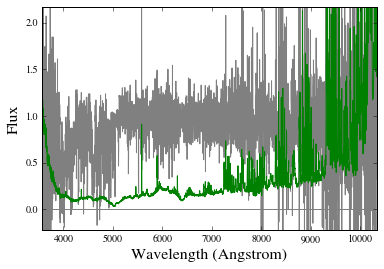

Using spec-6782-56572-0338.fits.gz for BOSSJ0242-0046
S/N 0.0 1 / Angstrom


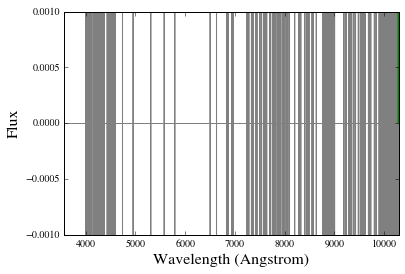

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ025039.82-004749.6.fits for BOSSJ0250-0047
S/N 4.93350054114 1 / Angstrom


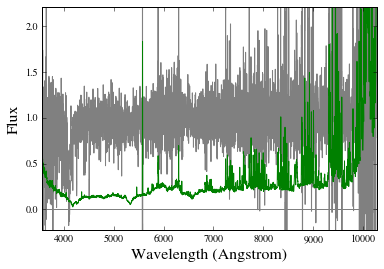

No spectrum found for BOSSJ0334-0058 and wvobs=3502.25 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ034139.19-000012.7_b1200_F.fits.gz for SDSSJ0341-0000
S/N 67.0428935554 1 / Angstrom


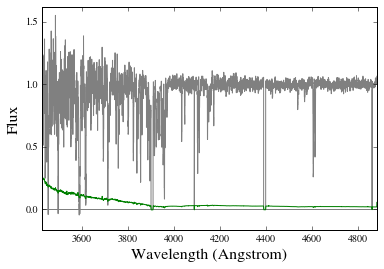

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ040954.21-041137.1_b1200_F.fits.gz for SDSSJ0409-0411
S/N 50.7085964442 1 / Angstrom


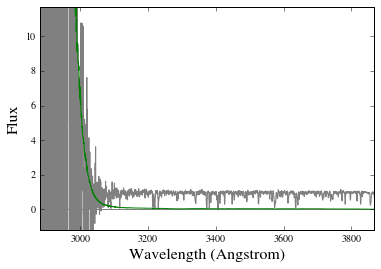

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ074953.62+370206.5.fits for BOSSJ0749+3702
S/N 2.42657528385 1 / Angstrom


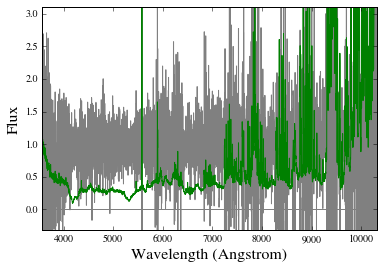

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ075259.14+401118.4.fits.gz for SDSSJ0752+4011
S/N 6.86512524048 1 / Angstrom


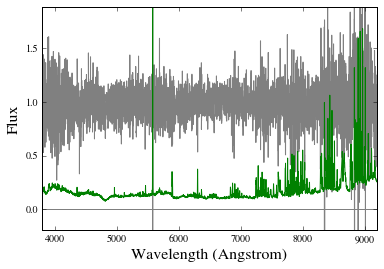

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ080048.74+354231.3_b1200_F.fits.gz for APOJ0800+3542
S/N 75.0359170696 1 / Angstrom


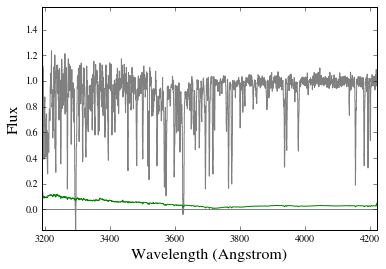

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ080948.22+453929.0.fits for BOSSJ0809+4539
S/N 4.48422620521 1 / Angstrom


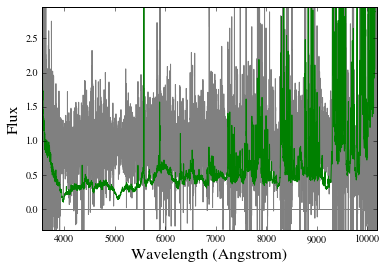

No spectrum found for BOSSJ0812+2620 and wvobs=3527.36 Angstrom!
Using spec-4763-55869-0178.fits.gz for BOSSJ0814+0402
S/N 0.858600683341 1 / Angstrom


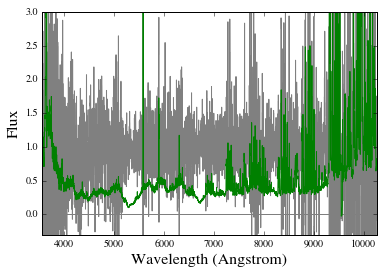

Using spec-4498-55615-0336.fits.gz for BOSSJ0818+1527
S/N 0.0 1 / Angstrom


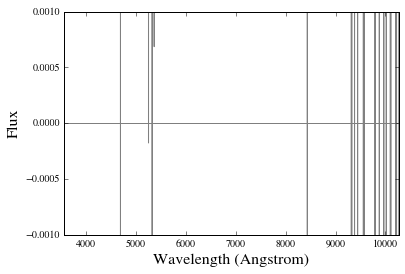

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ081833.97+123215.4.fits for BOSSJ0818+1232
S/N 3.37426129933 1 / Angstrom


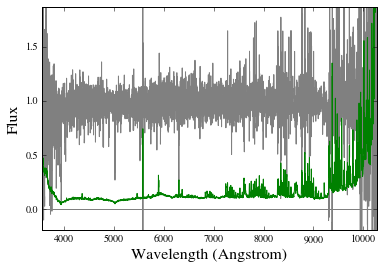

No spectrum found for BOSSJ0826+4708 and wvobs=3734.97 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ082844.87+454518.2_b1200_F.fits.gz for SDSSJ0828+4545
S/N 26.1307452153 1 / Angstrom


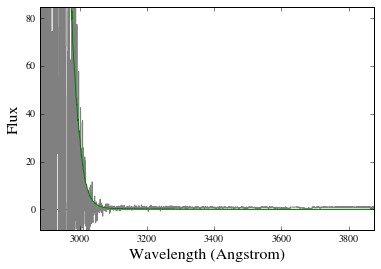

No spectrum found for BOSSJ0830+5452 and wvobs=3565.69 Angstrom!
No spectrum found for BOSSJ0833+4823 and wvobs=3470.92 Angstrom!
Using spec-5285-55946-0580.fits.gz for BOSSJ0837+0810
S/N 5.03231966808 1 / Angstrom


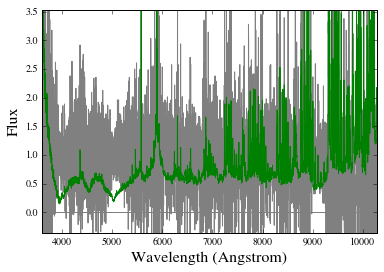

Using /u/xavier/Dropbox//QSOPairs/data/MODS_redux//./SDSSJ083712.69+363037.7_b_F.fits.gz for APOJ0837+3630
S/N 15.5601431219 1 / Angstrom


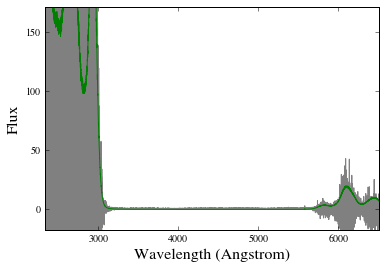

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ083757.13+383722.4_b1200_F.fits.gz for APOJ0837+3837
S/N 24.5031563117 1 / Angstrom


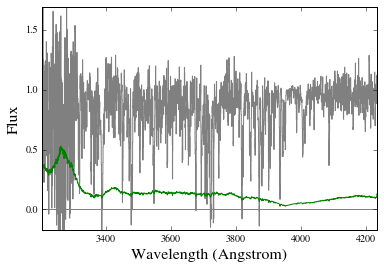

Using spec-5160-55895-0092.fits.gz for BOSSJ0838+4621
S/N 2.95705794739 1 / Angstrom


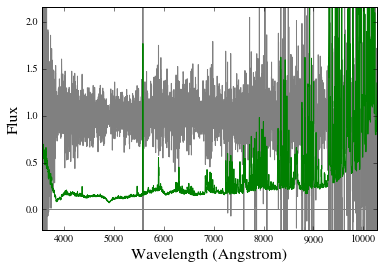

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ084159.26+392140.0.fits for BOSSJ0841+3921
S/N 8.52097176417 1 / Angstrom


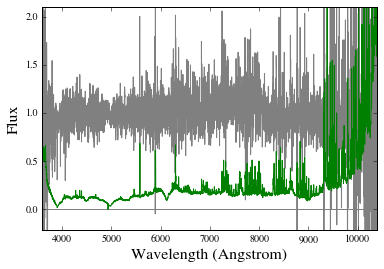

No spectrum found for BOSSJ0844+4839 and wvobs=3606.24 Angstrom!
Using spec-5185-55978-0760.fits.gz for BOSSJ0845+3202
S/N 0.605766485754 1 / Angstrom


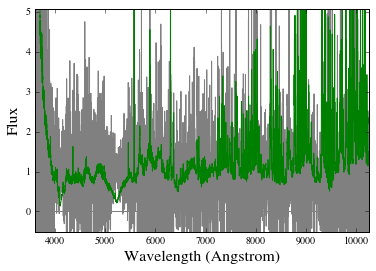

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ085357.49-001106.1_F.fits.gz for BOSSJ0853-0011
S/N 92.9574401142 1 / Angstrom


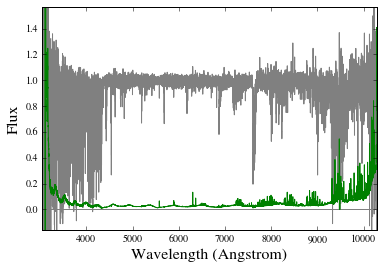

No spectrum found for BOSSJ0856+5514 and wvobs=3498.21 Angstrom!
Using spec-4608-55973-0634.fits.gz for BOSSJ0857+3901
S/N 0.0 1 / Angstrom


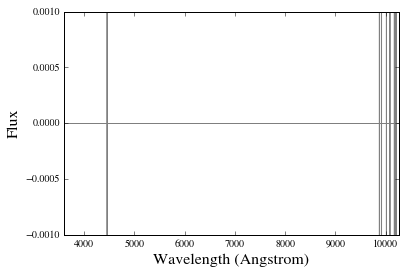

Using spec-4645-55623-0611.fits.gz for BOSSJ0902+3602
S/N 1.95079702005 1 / Angstrom


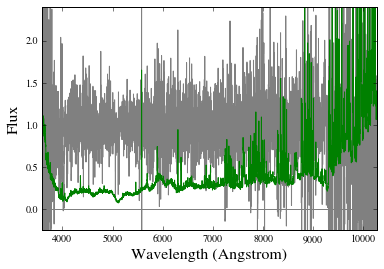

Using spec-7304-56745-0838.fits.gz for BOSSJ0903+5133
S/N 1.02132828731 1 / Angstrom


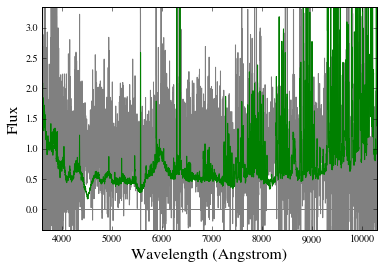

No spectrum found for BOSSJ0904+0042 and wvobs=3493.83 Angstrom!
No spectrum found for BOSSJ0906+1001 and wvobs=3599.84 Angstrom!
Using spec-5779-56338-0574.fits.gz for BOSSJ0907+2802
S/N 0.0 1 / Angstrom


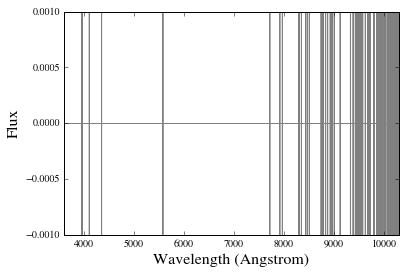

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ091046.69+041448.4_b1200_F.fits.gz for APOJ0910+0414
S/N 102.080488439 1 / Angstrom


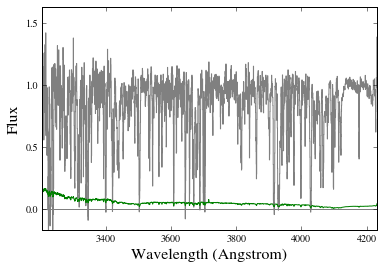

Using spec-5733-56575-0604.fits.gz for BOSSJ0911+4905
S/N 0.0 1 / Angstrom


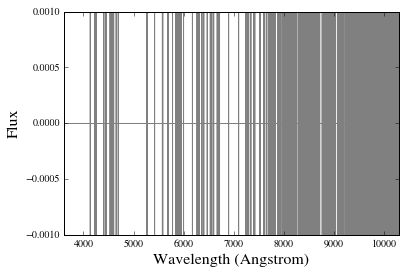

Using spec-4603-55999-0132.fits.gz for BOSSJ0912+4139
S/N 2.37186549982 1 / Angstrom


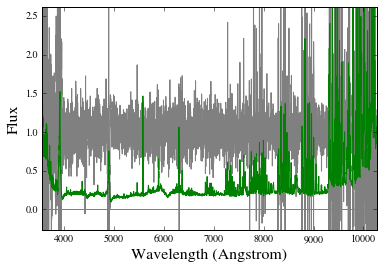

No spectrum found for BOSSJ0912+2518 and wvobs=3539.18 Angstrom!
No spectrum found for BOSSJ0912+3056 and wvobs=3499 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ091338.97-010704.6_F.fits.gz for BOSSJ0913-0107
S/N 154.945135067 1 / Angstrom


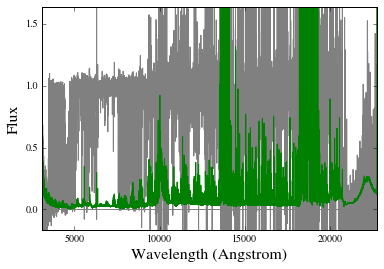

No spectrum found for BOSSJ0913+3151 and wvobs=3595.2 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091430.84+010927.5.fits for BOSSJ0914+0109
S/N 15.1674790212 1 / Angstrom


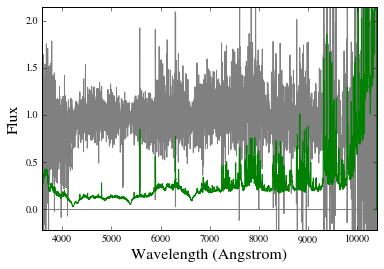

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091553.38+011911.3.fits for BOSSJ0915+0119
S/N 6.55962845821 1 / Angstrom


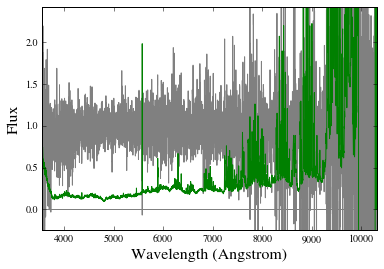

Using spec-4687-56338-0202.fits.gz for BOSSJ0916+4250
S/N 0.773685110141 1 / Angstrom


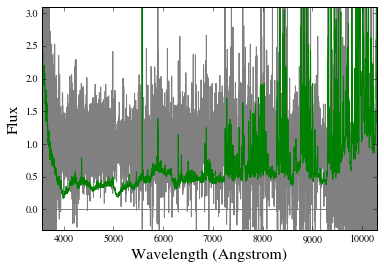

Using spec-5810-56358-0452.fits.gz for BOSSJ0920+3340
S/N 0.0 1 / Angstrom


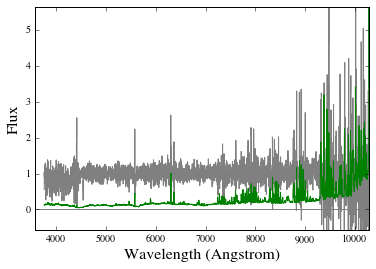

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ092416.73+392914.6_b1200_F.fits.gz for APOJ0924+3929
S/N 61.0004815303 1 / Angstrom


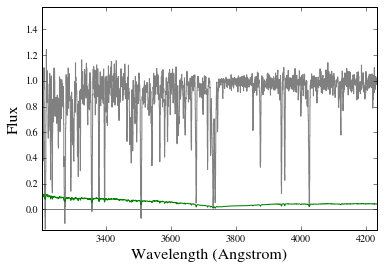

Using spec-5309-55929-0018.fits.gz for BOSSJ0932+0843
S/N 0.0 1 / Angstrom


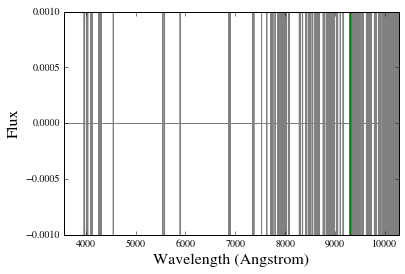

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ093225.60+092500.2_F.fits.gz for APOJ0932+0925
S/N 59.8322852369 1 / Angstrom


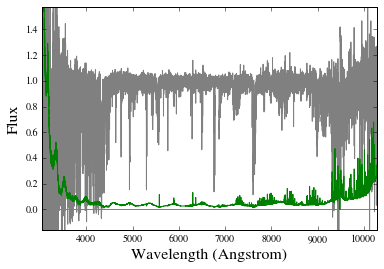

Using spec-5716-56684-0357.fits.gz for BOSSJ0933+5920
S/N 5.45135160377 1 / Angstrom


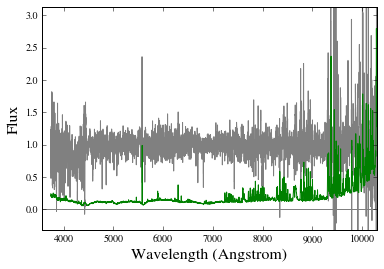

Using spec-4695-55957-0570.fits.gz for BOSSJ0935+4532
S/N 0.0 1 / Angstrom


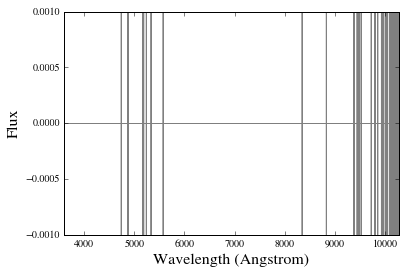

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ093642.20-005831.3.fits for BOSSJ0936-0058
S/N 6.88703438434 1 / Angstrom


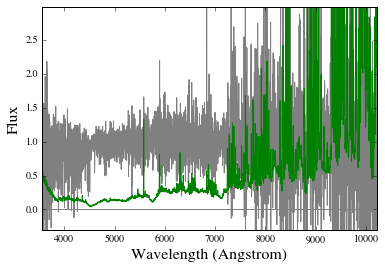

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ093804.84+531743.0_b1200_F.fits.gz for APOJ0938+5317
S/N 74.742049199 1 / Angstrom


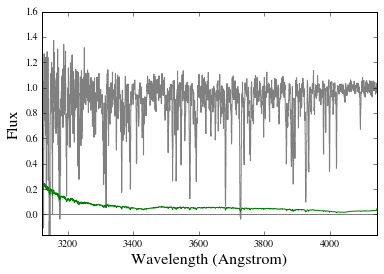

Using spec-5798-56326-0494.fits.gz for BOSSJ0940+3345
S/N 0.0 1 / Angstrom


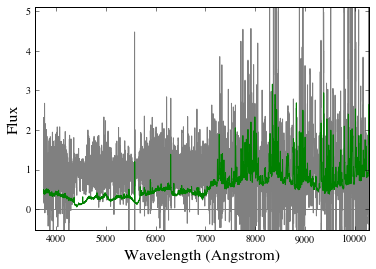

Using spec-5788-56255-0380.fits.gz for BOSSJ0941+2308
S/N 3.5986521199 1 / Angstrom


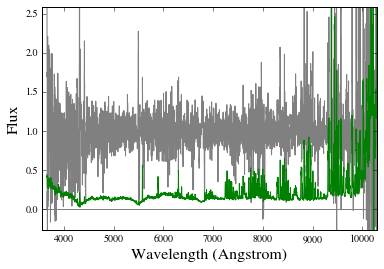

Using spec-5315-55978-0050.fits.gz for BOSSJ0942+1347
S/N 0.990615952436 1 / Angstrom


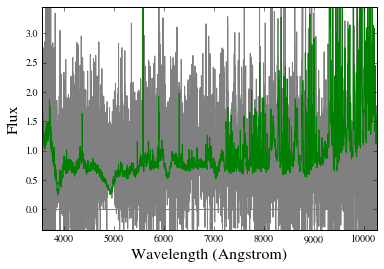

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ095641.74+024840.8.fits for BOSSJ0956+0248
S/N 3.34078810683 1 / Angstrom


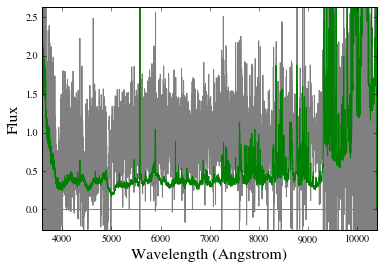

Using spec-4800-55674-0408.fits.gz for BOSSJ1000+0337
S/N 1.18399794396 1 / Angstrom


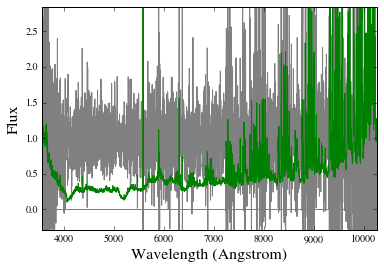

Using spec-4566-55630-0392.fits.gz for BOSSJ1001+4023
S/N 2.22713037741 1 / Angstrom


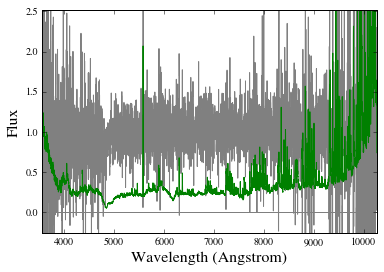

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ100247.14+002053.0.fits for BOSSJ1002+0020
S/N 2.25850551387 1 / Angstrom


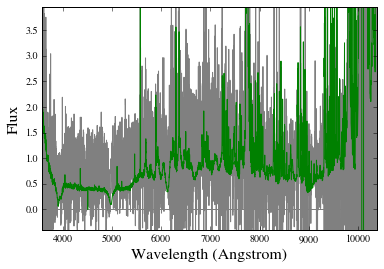

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ100507.08+501929.8_b1200_F.fits.gz for SDSSJ1005+5019
S/N 52.7244276535 1 / Angstrom


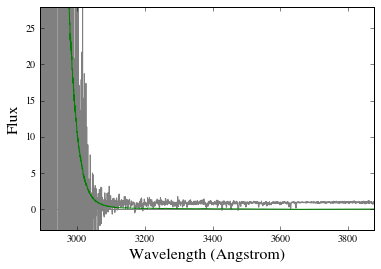

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ100627.10+480429.9.fits for BOSSJ1006+4804
S/N 16.8652343521 1 / Angstrom


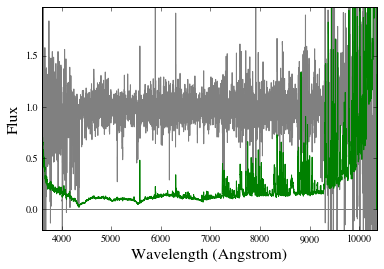

Using spec-5332-55981-0712.fits.gz for BOSSJ1009+1749
S/N 0.0 1 / Angstrom


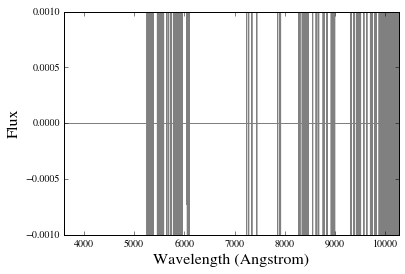

Using spec-4738-55650-0778.fits.gz for BOSSJ1009+0236
S/N 0.977473825969 1 / Angstrom


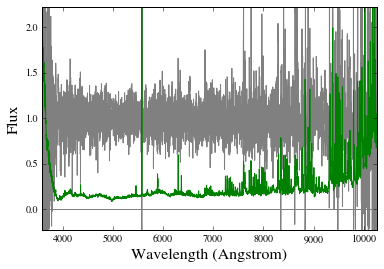

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ100940.58+250053.9.fits for APOJ1009+2500
S/N 3.60799477778 1 / Angstrom


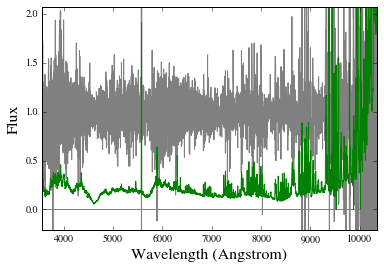

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ101003.47+403754.9.fits for BOSSJ1010+4037
S/N 30.8121198746 1 / Angstrom


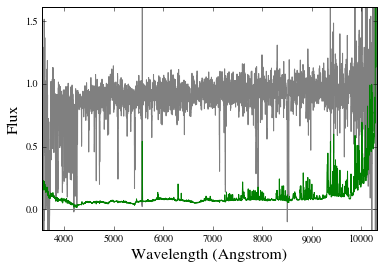

Using spec-7384-56715-0292.fits.gz for BOSSJ1010+4517
S/N 1.82836503098 1 / Angstrom


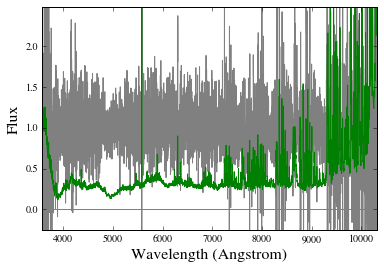

Using spec-5334-55928-0394.fits.gz for BOSSJ1010+0821
S/N 3.35432411283 1 / Angstrom


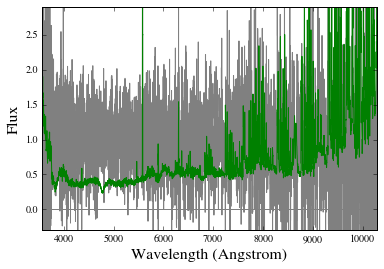

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ101322.31+033009.0.fits for BOSSJ1013+0330
S/N 6.19266259552 1 / Angstrom


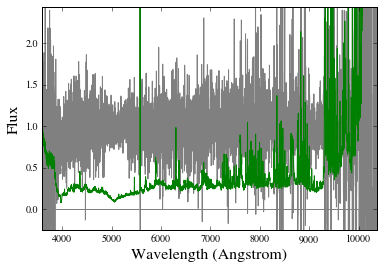

Using spec-6470-56334-0188.fits.gz for BOSSJ1014+2653
S/N 0.347940452722 1 / Angstrom


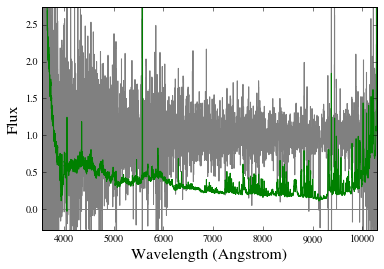

No spectrum found for BOSSJ1015+1245 and wvobs=3579.06 Angstrom!
No spectrum found for BOSSJ1017+6226 and wvobs=3540.5 Angstrom!
Using spec-7090-56659-0466.fits.gz for BOSSJ1020+6119
S/N 1.40029892442 1 / Angstrom


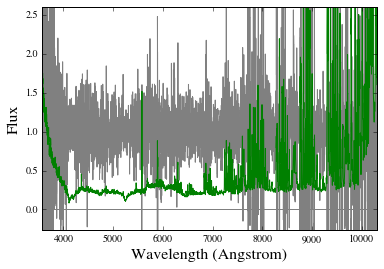

No spectrum found for BOSSJ1024+0354 and wvobs=3561.1 Angstrom!
Using spec-6463-56340-0210.fits.gz for BOSSJ1024+2616
S/N 11.9153295369 1 / Angstrom


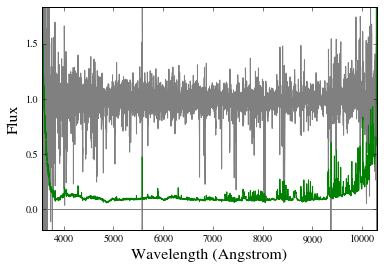

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ102616.12+461420.8_F.fits.gz for APOJ1026+4614
S/N 118.397707353 1 / Angstrom


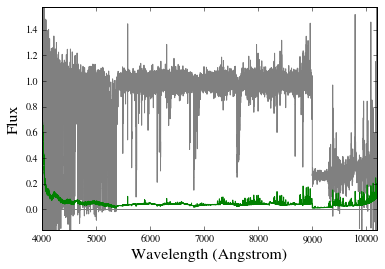

No spectrum found for BOSSJ1028+5121 and wvobs=3564.07 Angstrom!
No spectrum found for BOSSJ1034+0856 and wvobs=3519.73 Angstrom!
Using spec-6702-56381-0508.fits.gz for BOSSJ1036+5012
S/N 11.0602703675 1 / Angstrom


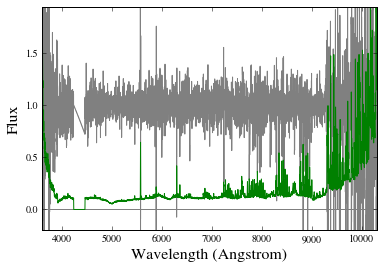

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ103900.01+502652.8_F.fits.gz for BOSSJ1039+5026
S/N 64.9694788715 1 / Angstrom


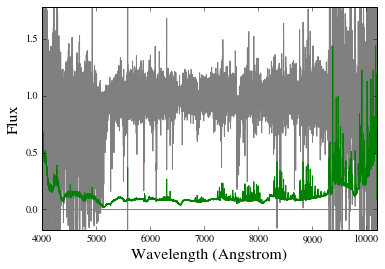

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ104143.85+195724.4_b1200_F.fits.gz for APOJ1041+1957
S/N 97.7825931315 1 / Angstrom


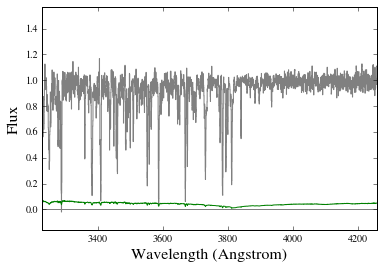

Using spec-7083-56722-0068.fits.gz for BOSSJ1042+6459
S/N 7.85775596901 1 / Angstrom


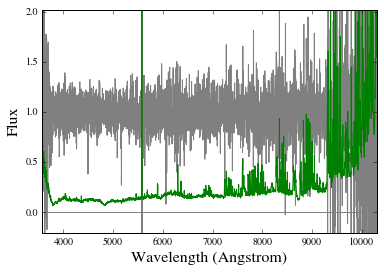

Using spec-6448-56365-0160.fits.gz for BOSSJ1044+3139
S/N 1.7176240134 1 / Angstrom


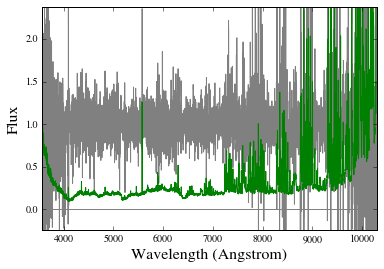

No spectrum found for APOJ1045+4351 and wvobs=4575.16 Angstrom!
Using spec-5351-55952-0348.fits.gz for BOSSJ1045+1000
S/N 0.0 1 / Angstrom


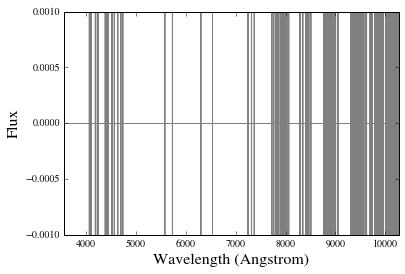

Using spec-7094-56660-0184.fits.gz for BOSSJ1052+5553
S/N 15.3837994294 1 / Angstrom


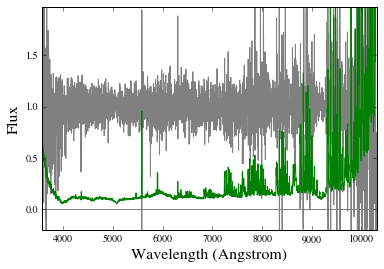

Using spec-7104-56711-0232.fits.gz for BOSSJ1059+6255
S/N 0.942001395817 1 / Angstrom


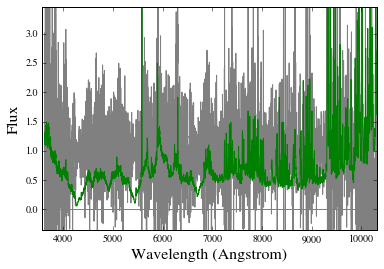

No spectrum found for BOSSJ1106+4635 and wvobs=3472.63 Angstrom!
Using spec-6440-56370-0888.fits.gz for BOSSJ1113+3305
S/N 2.96374723052 1 / Angstrom


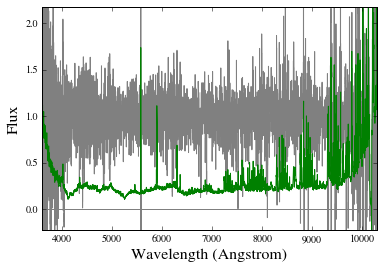

Using spec-4651-56008-0354.fits.gz for BOSSJ1118+4025
S/N 3.71966683797 1 / Angstrom


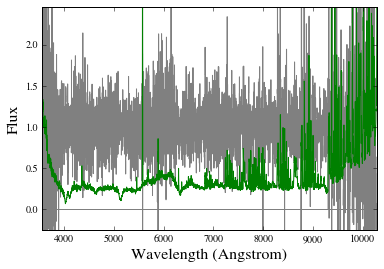

No spectrum found for BOSSJ1136-0029 and wvobs=3484.67 Angstrom!
Using spec-7113-56711-0152.fits.gz for BOSSJ1138+6329
S/N 6.36085948261 1 / Angstrom


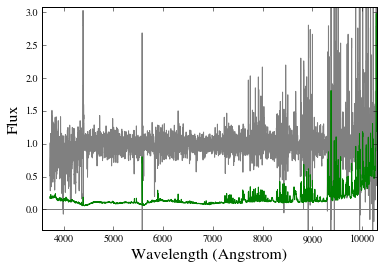

No spectrum found for BOSSJ1140+2709 and wvobs=3628.04 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114145.43+072423.3_b400_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ114145.43+072423.3_b600_F.fits.gz for APOJ1141+0724
S/N 25.4164574809 1 / Angstrom


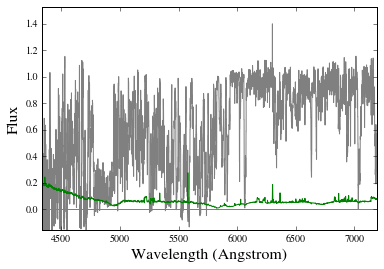

Using spec-6406-56330-0400.fits.gz for BOSSJ1142+2822
S/N 0.0 1 / Angstrom


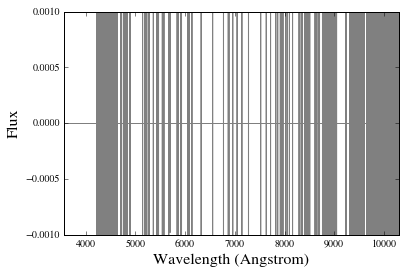

No spectrum found for BOSSJ1142+1128 and wvobs=3484.65 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ114436.66+095904.9_F.fits.gz for BOSSJ1144+0959
S/N 171.406440037 1 / Angstrom


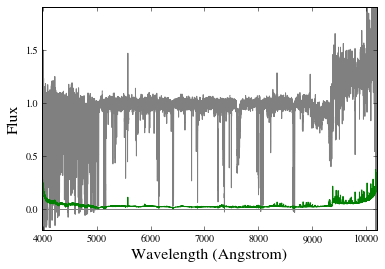

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114546.22+032251.9_b1200_F.fits.gz for BOSSJ1145+0322
S/N 68.3352930284 1 / Angstrom


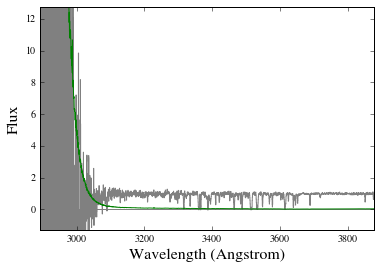

Using spec-7091-56658-0662.fits.gz for BOSSJ1150+5802
S/N 0.0 1 / Angstrom


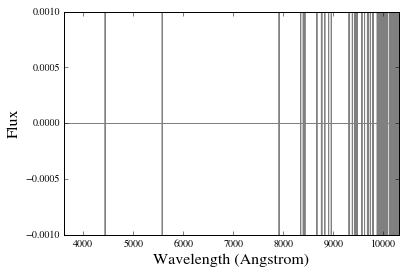

Using spec-5383-56013-0218.fits.gz for BOSSJ1152+1507
S/N 0.0 1 / Angstrom


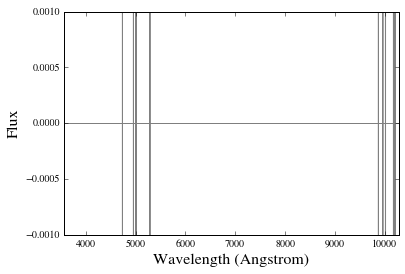

No spectrum found for BOSSJ1155+3934 and wvobs=3485.13 Angstrom!
Using spec-5387-56009-0348.fits.gz for BOSSJ1159+1433
S/N 1.20803443821 1 / Angstrom


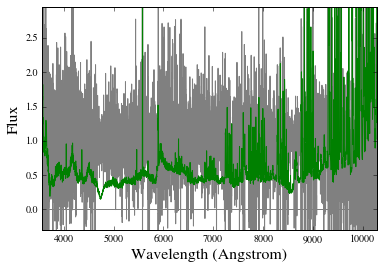

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ120029.15+012946.3.fits for BOSSJ1200+0129
S/N 1.49353728094 1 / Angstrom


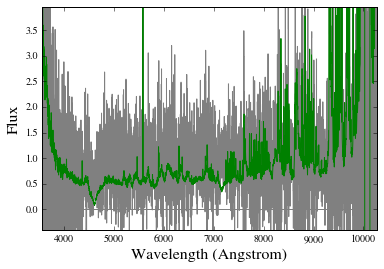

No spectrum found for BOSSJ1202+0747 and wvobs=3552.12 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ120416.69+022111.0_b1200_F.fits.gz
No continuum: /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz
Using conti=1 for HIRES
Using /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz for BOSSJ1204+0221
S/N 386.536517315 1 / Angstrom


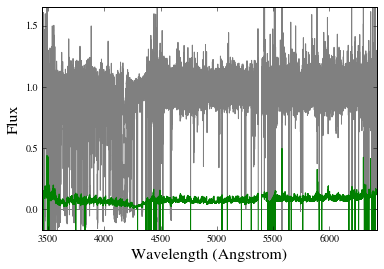

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120857.16+073727.3_F.fits.gz for APOJ1208+0737
S/N 15.2343039581 1 / Angstrom


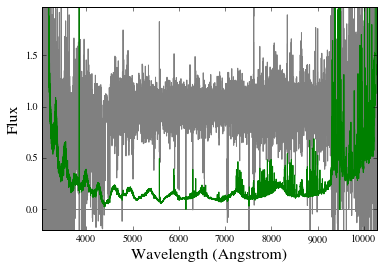

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ121201.68+324013.3.fits for BOSSJ1212+3240
S/N 21.1233803355 1 / Angstrom


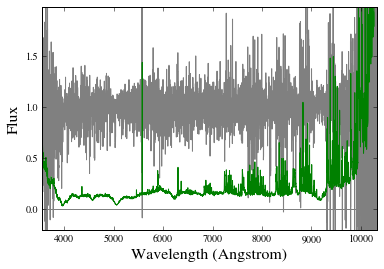

Using spec-6640-56385-0544.fits.gz for BOSSJ1213+4719
S/N 1.33145526176 1 / Angstrom


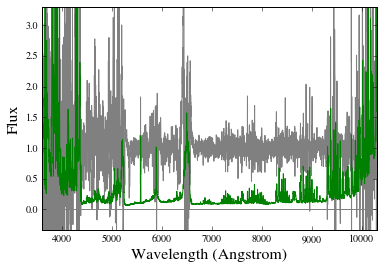

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ121558.80+571555.4.fits.gz for BOSSJ1215+5715
S/N 9.48453293613 1 / Angstrom


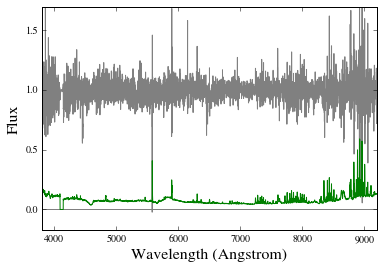

Using spec-6837-56442-0324.fits.gz for BOSSJ1225+5709
S/N 4.85229800209 1 / Angstrom


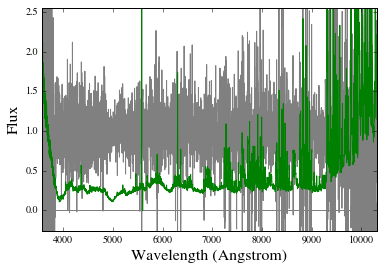

Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ123141.73+002913.9_b600_F.fits.gz for BOSSJ1231+0029
S/N 28.0243826395 1 / Angstrom


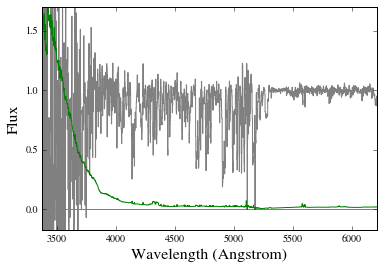

Using spec-3970-55591-0870.fits.gz for BOSSJ1239+3955
S/N 1.36985870976 1 / Angstrom


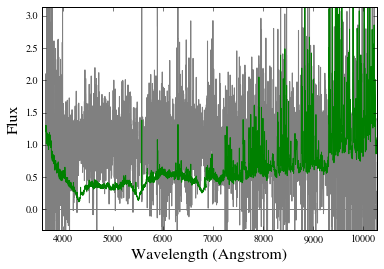

Using spec-6680-56420-0155.fits.gz for BOSSJ1242+5331
S/N 0.709904811577 1 / Angstrom


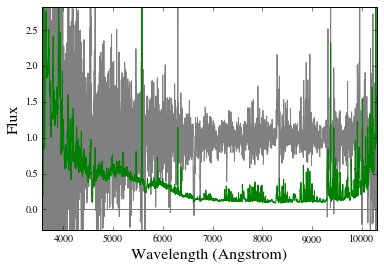

Using spec-3972-55589-0570.fits.gz for BOSSJ1244+3916
S/N 4.27031027348 1 / Angstrom


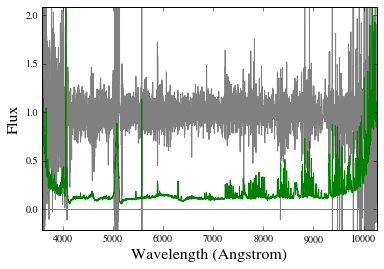

Using spec-6482-56358-0110.fits.gz for BOSSJ1244+3208
S/N 3.55115381741 1 / Angstrom


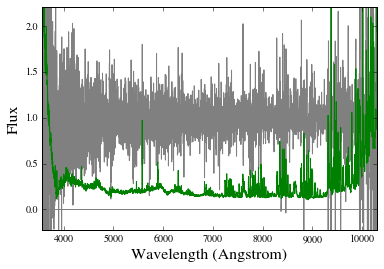

Using spec-6840-56685-0230.fits.gz for BOSSJ1245+5922
S/N 0.743335672931 1 / Angstrom


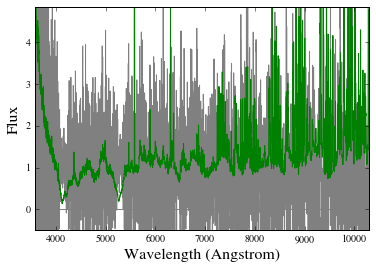

Using spec-5986-56328-0112.fits.gz for BOSSJ1246+2345
S/N 3.74094502637 1 / Angstrom


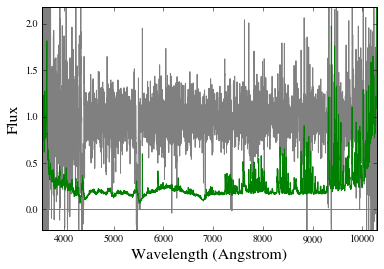

Using spec-4703-55617-0350.fits.gz for BOSSJ1248+4058
S/N 8.97210974849 1 / Angstrom


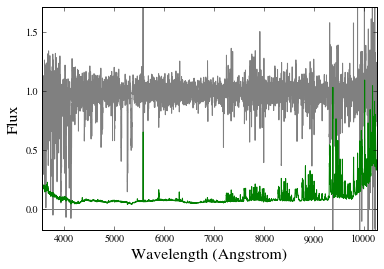

Using spec-6970-56444-0800.fits.gz for BOSSJ1253+6327
S/N 1.99372437667 1 / Angstrom


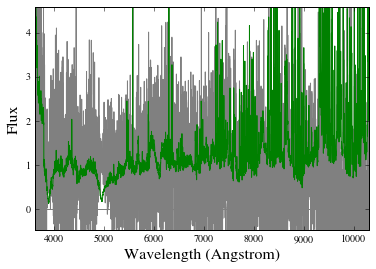

Using spec-5989-56312-0172.fits.gz for BOSSJ1255+2234
S/N 0.0 1 / Angstrom


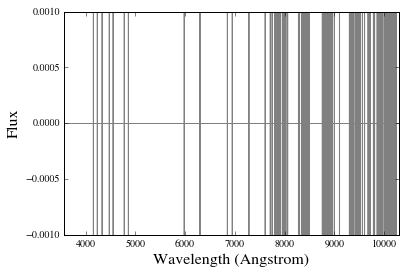

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ130125.67+475930.8.fits.gz for SDSSJ1301+4759
S/N 10.9867478756 1 / Angstrom


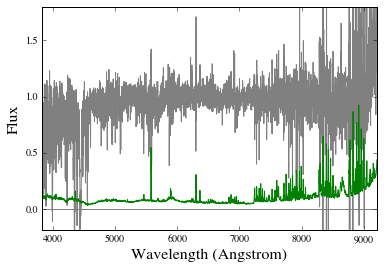

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ130603.55+615835.2_b1200_F.fits.gz for APOJ1306+6158
S/N 26.0013604328 1 / Angstrom


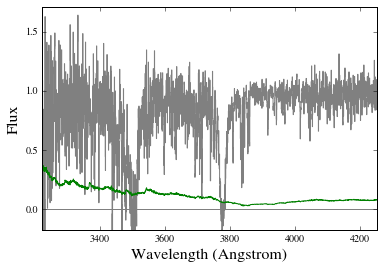

Using spec-5422-55986-0346.fits.gz for BOSSJ1310+1134
S/N 1.91978077016 1 / Angstrom


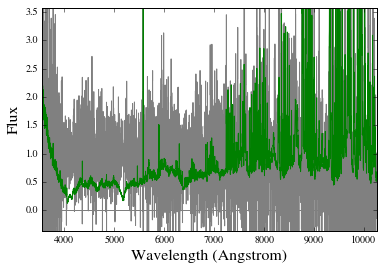

Using spec-5865-56067-0543.fits.gz for BOSSJ1319+2138
S/N 1.30801146583 1 / Angstrom


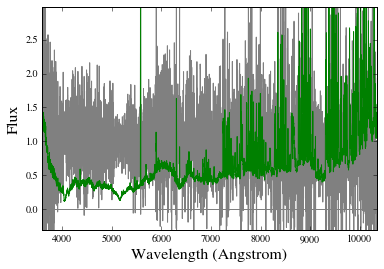

Using spec-6828-56430-0134.fits.gz for BOSSJ1325+5409
S/N 0.0 1 / Angstrom


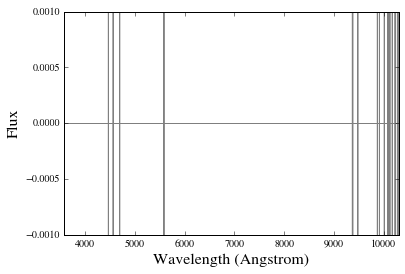

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ132739.89+342317.7_b1200_F.fits.gz for APOJ1327+3423
S/N 17.0829991054 1 / Angstrom


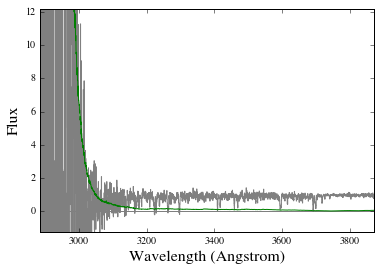

Using spec-6626-56330-0556.fits.gz for BOSSJ1335+4330
S/N 2.54499875332 1 / Angstrom


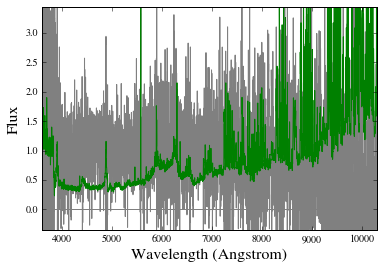

Using spec-5858-56063-0734.fits.gz for BOSSJ1346+1952
S/N 3.21258652445 1 / Angstrom


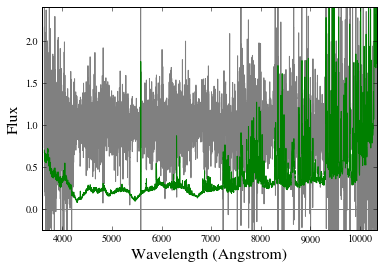

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ135629.54+613310.4_b1200_F.fits.gz for BOSSJ1356+6133
S/N 27.9882651058 1 / Angstrom


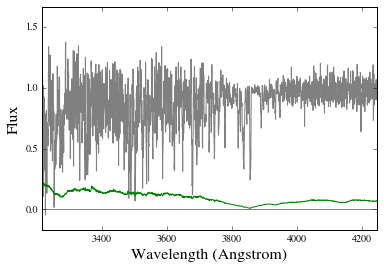

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ135849.54+273756.9.fits for APOJ1358+2737
S/N 9.40150347524 1 / Angstrom


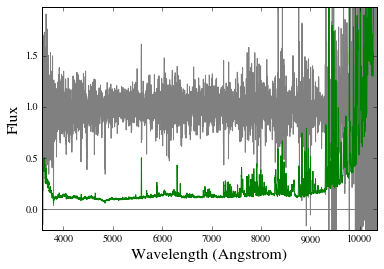

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ140209.53+470117.8.fits.gz for BOSSJ1402+4701
S/N 2.59423042644 1 / Angstrom


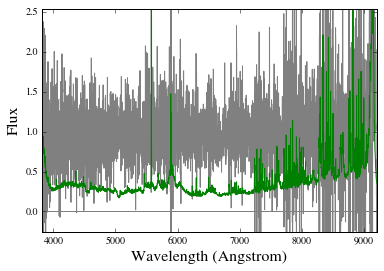

Using spec-6751-56368-0576.fits.gz for BOSSJ1410+4804
S/N 1.0448495035 1 / Angstrom


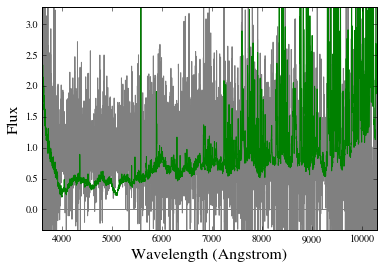

No spectrum found for SDSSJ1413+2715 and wvobs=3588.98 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ142004.12+022708.8_F.fits.gz for BOSSJ1420+0227
S/N 93.2405930162 1 / Angstrom


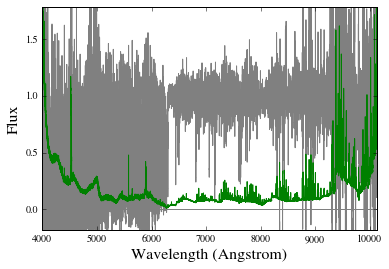

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142054.92+160342.9_F.fits.gz for APOJ1420+1603
S/N 46.3661168562 1 / Angstrom


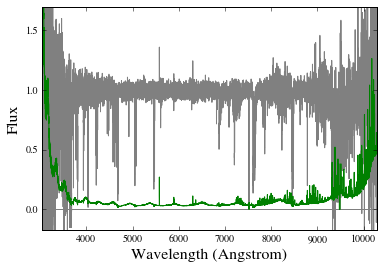

Using spec-6752-56366-0559.fits.gz for BOSSJ1422+4652
S/N 0.690612192854 1 / Angstrom


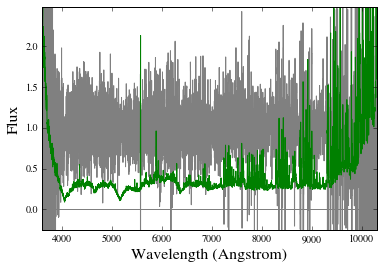

No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ142758.74-012136.2_b1200_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/MIKE_redux//./SDSSJ142758.74-012136.2_b_F.fits.gz for BOSSJ1427-0121
S/N 366.132948268 1 / Angstrom


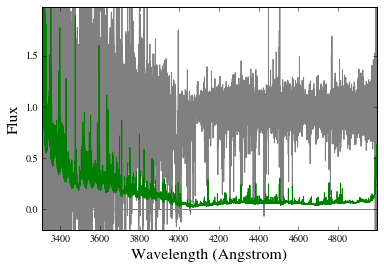

Using spec-6710-56416-0700.fits.gz for BOSSJ1428+5509
S/N 0.409242562648 1 / Angstrom


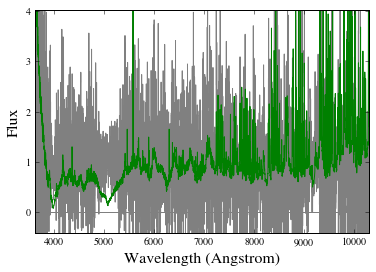

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ143109.22+572726.4_b1200_F.fits.gz for APOJ1431+5727
S/N 36.4198952106 1 / Angstrom


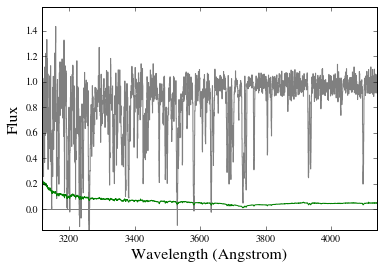

Using spec-5467-55973-0438.fits.gz for BOSSJ1433+0827
S/N 8.45588016668 1 / Angstrom


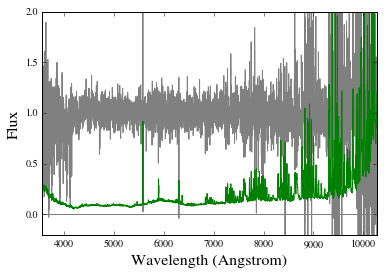

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_4_45/SDSSJ143344.55+064111.9.fits for BOSSJ1433+0641
S/N 12.3631226341 1 / Angstrom


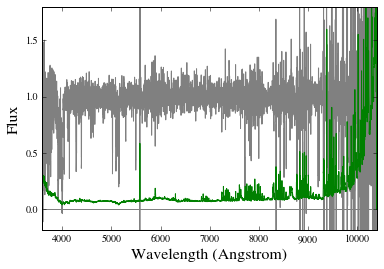

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ144231.91+013734.8.fits for BOSSJ1442+0137
S/N 17.1680000811 1 / Angstrom


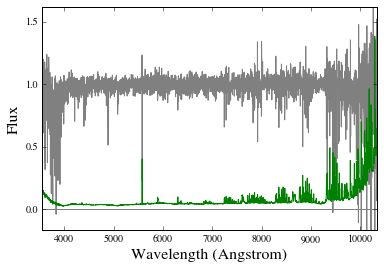

Using spec-6800-56399-0012.fits.gz for BOSSJ1448+5649
S/N 1.35901731362 1 / Angstrom


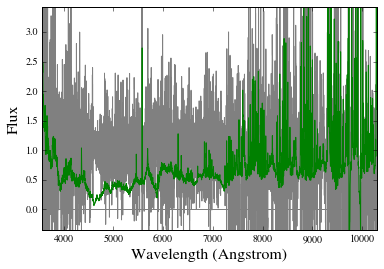

Using spec-4015-55624-0682.fits.gz for BOSSJ1457+0237
S/N 1.64454630166 1 / Angstrom


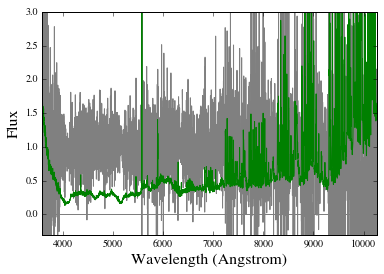

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ150812.80+363530.3.fits for BOSSJ1508+3635
S/N 4.27804080419 1 / Angstrom


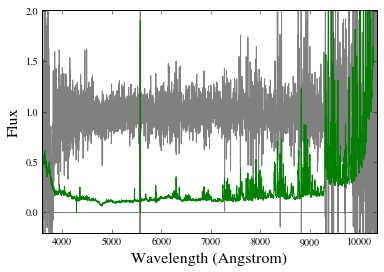

Using spec-3964-55648-0682.fits.gz for BOSSJ1515+2627
S/N 0.0 1 / Angstrom


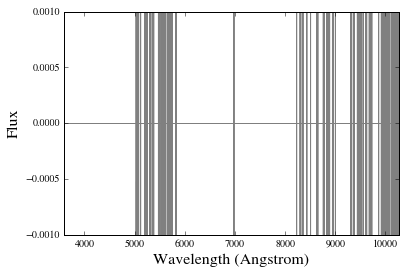

Using spec-3950-55680-0428.fits.gz for BOSSJ1517+2002
S/N 0.239396355166 1 / Angstrom


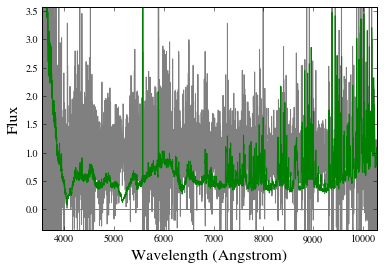

Using spec-3953-55322-0392.fits.gz for BOSSJ1530+2515
S/N 0.745869676679 1 / Angstrom


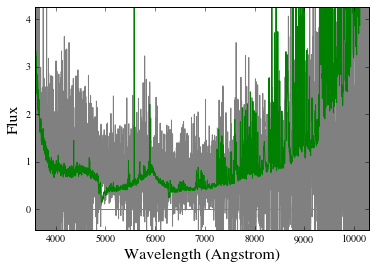

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ153329.17+142537.8.fits for BOSSJ1533+1425
S/N 12.9977826427 1 / Angstrom


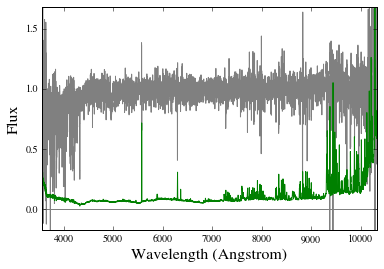

No spectrum found for BOSSJ1534+2153 and wvobs=3561.82 Angstrom!
Using spec-6791-56429-0266.fits.gz for BOSSJ1538+5707
S/N 1.69222830485 1 / Angstrom


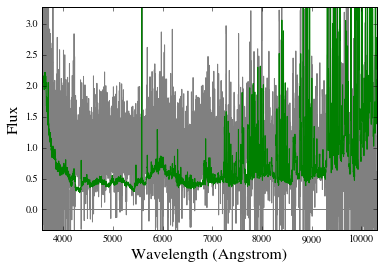

Using spec-4723-56033-0012.fits.gz for BOSSJ1539+3146
S/N 4.06902863141 1 / Angstrom


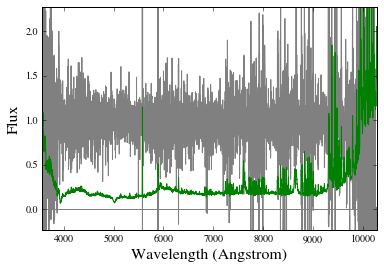

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ155325.89+192137.7_F.fits.gz for APOJ1553+1921
S/N 23.4573419536 1 / Angstrom


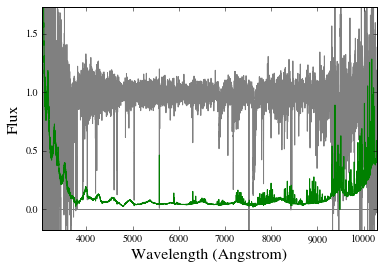

Using spec-4900-55739-0026.fits.gz for BOSSJ1554+1244
S/N 5.93323718344 1 / Angstrom


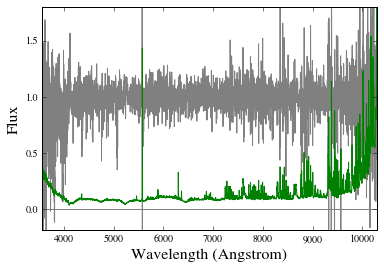

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ155622.54+304059.9.fits for BOSSJ1556+3040
S/N 2.21233619529 1 / Angstrom


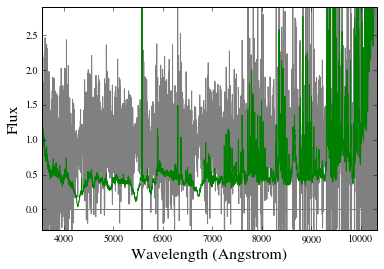

Using spec-4806-55688-0910.fits.gz for BOSSJ1557+0434
S/N 2.57440343177 1 / Angstrom


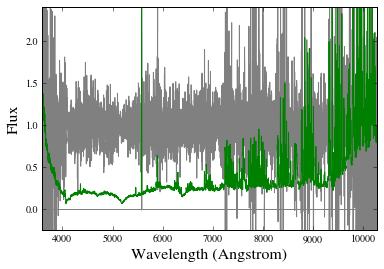

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ155946.28+494326.5_b1200_F.fits.gz for APOJ1559+4943
S/N 21.2398400039 1 / Angstrom


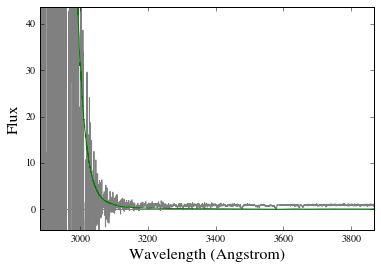

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ160546.67+511323.0.fits for BOSSJ1605+5113
S/N 11.4266522785 1 / Angstrom


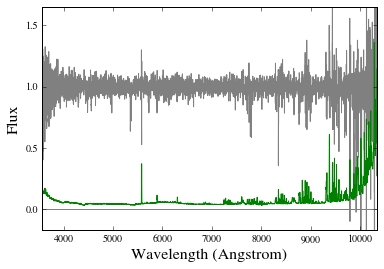

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ161817.31+184230.1.fits for BOSSJ1618+1842
S/N 0.771256061742 1 / Angstrom


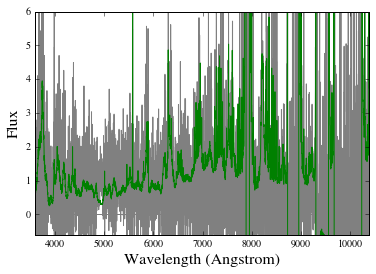

Using spec-4057-55357-0161.fits.gz for BOSSJ1619+1926
S/N 1.53835016741 1 / Angstrom


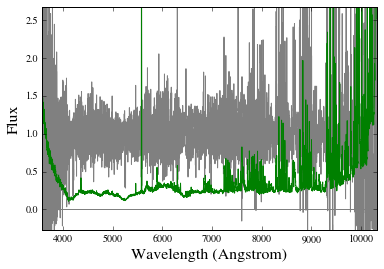

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ162737.91+221509.3_F.fits.gz for BOSSJ1627+2215
S/N 140.734155115 1 / Angstrom


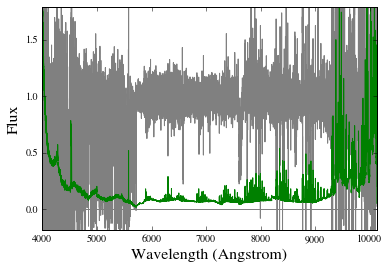

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ162737.25+460609.3_F.fits.gz for APOJ1627+4606
S/N 119.453754785 1 / Angstrom


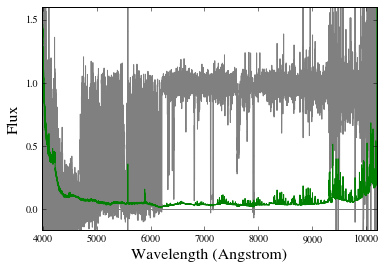

Using spec-4188-55684-0404.fits.gz for BOSSJ1628+2342
S/N 1.3847241268 1 / Angstrom


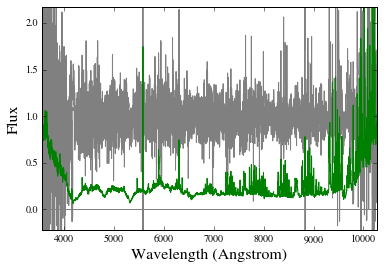

Using spec-6030-56097-0378.fits.gz for BOSSJ1631+4333
S/N 2.70257266078 1 / Angstrom


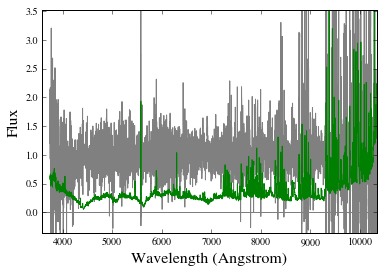

No spectrum found for BOSSJ1631+3659 and wvobs=3522.63 Angstrom!
Using spec-4190-55686-0370.fits.gz for BOSSJ1635+2547
S/N 0.0 1 / Angstrom


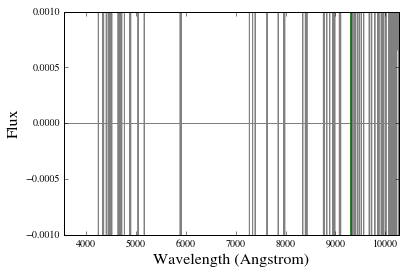

No spectrum found for BOSSJ1651+3410 and wvobs=3561.66 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MODS_redux//./SDSSJ165716.52+310524.5_b_F.fits.gz for BOSSJ1657+3105
S/N 40.6316852534 1 / Angstrom


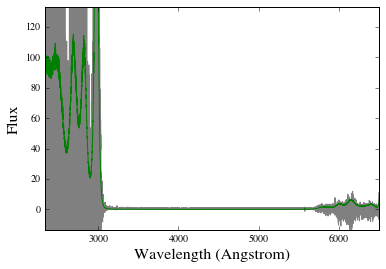

Using spSpec-52443-0983-122.fit.gz for BOSSJ2053-0104
S/N 1.31819716298 1 / Angstrom


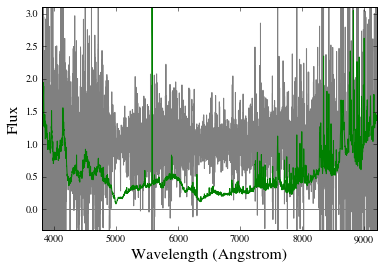

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ214620.98-075303.8_F.fits.gz for APOJ2146-0753
S/N 43.743326547 1 / Angstrom


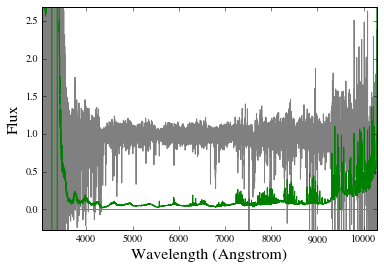

No spectrum found for BOSSJ2156-0003 and wvobs=3574.96 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ220248.31+123656.3.fits for BOSSJ2202+1236
S/N 6.17327392303 1 / Angstrom


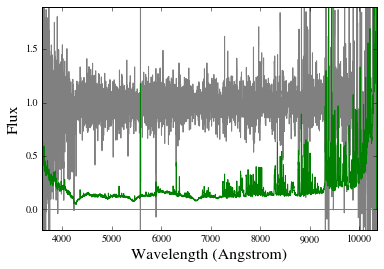

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ221226.36-001150.9.fits for BOSSJ2212-0011
S/N 3.21776216199 1 / Angstrom


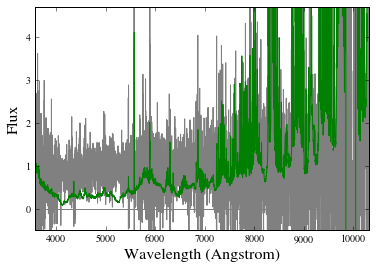

Using spec-4206-55471-0936.fits.gz for BOSSJ2255-0001
S/N 2.10076133812 1 / Angstrom


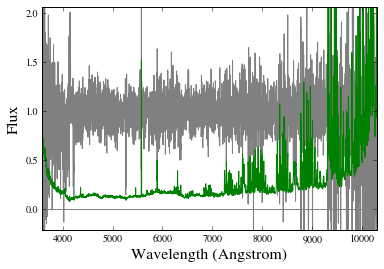

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ225549.55-000927.7.fits for BOSSJ2255-0009
S/N 6.1934643826 1 / Angstrom


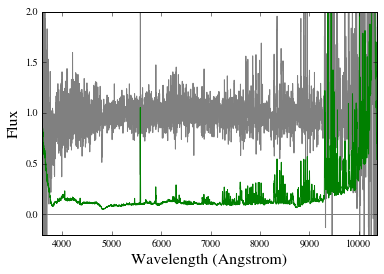

No spectrum found for BOSSJ2314-0108 and wvobs=3531.83 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ233845.45-000331.8.fits for BOSSJ2338-0003
S/N 6.73400316435 1 / Angstrom


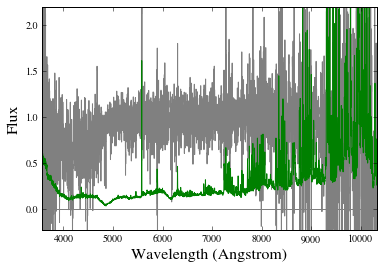

Using spec-4213-55449-0215.fits.gz for BOSSJ2341-0041
S/N 0.129288585442 1 / Angstrom


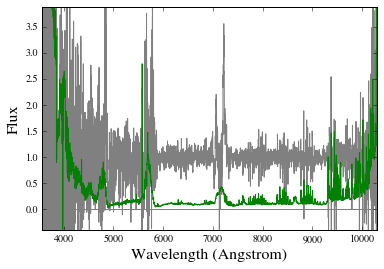

No spectrum found for BOSSJ2348+0110 and wvobs=3595.9 Angstrom!
Using spec-4215-55471-0347.fits.gz for BOSSJ2352-0015
S/N 0.0 1 / Angstrom


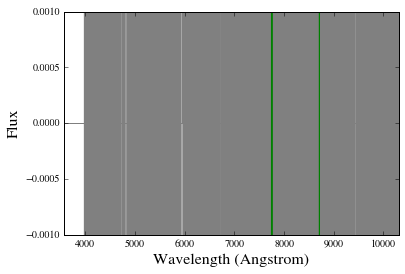

Using spec-4215-55471-0240.fits.gz for BOSSJ2354-0019
S/N 0.541740228176 1 / Angstrom


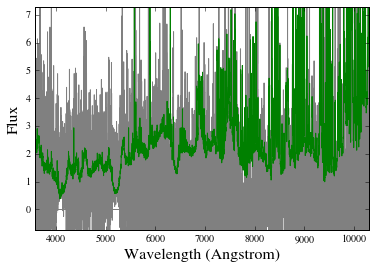

In [14]:
qpq9 = eqpq.QPQ('QPQ9')
qpq9.cull(1334.5323*u.AA,0)
zfg = qpq9._fulldata['Z_FG']
bad = np.where((zfg < 1.6) | (zfg > 9999))[0]
qpq9.mask[bad] = False
stack_tup0 = qpqk.load_stack_img(qpq9.data,1334.5323*u.AA,vmnx=(-1500., 1500.)*u.km/u.s,
                                 spec_dv=25.*u.km/u.s,high_res=0,stack_sig=True,chk_conti=False)
# Mask
fin_velo, stck_img, stck_sig, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
    if (('J0853' in dd['qpq']['NAME']) | ('J1144' in dd['qpq']['NAME']) | ('J1145' in dd['qpq']['NAME']) | 
        ('J1204' in dd['qpq']['NAME']) | ('J1420+1603' in dd['qpq']['NAME']) | 
        ('J1427' in dd['qpq']['NAME']) | ('J1553' in dd['qpq']['NAME'])):
        pass
    else:
        idx_mask.append(ii) 
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [15]:
np.sum(stck_mskN,0)

array([ 7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,
        7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,
        7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,
        7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,
        7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,
        7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,
        7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,
        7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,
        7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,  7.,
        7.,  7.,  7.,  7.])

/Users/lwymarie/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:6: RuntimeWarning: invalid value encountered in log


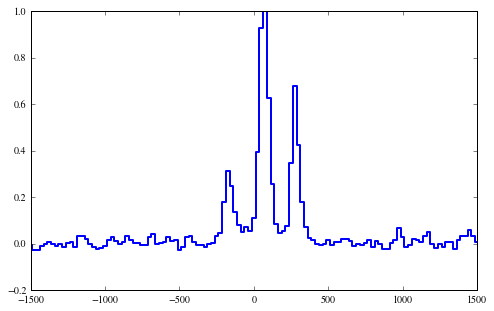

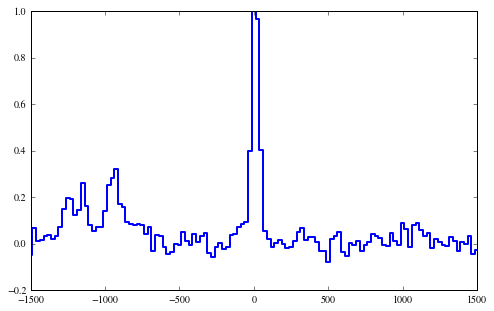

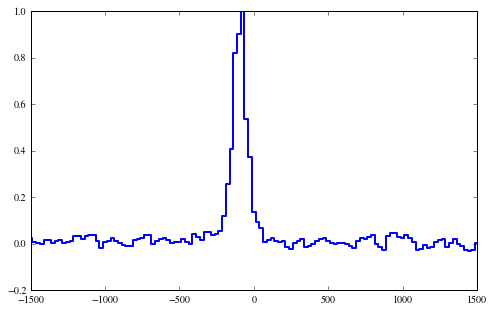

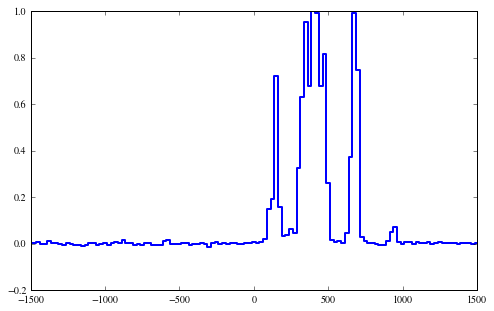

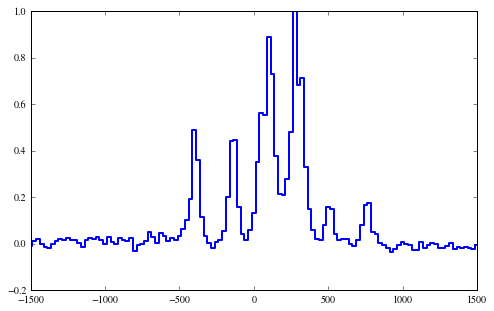

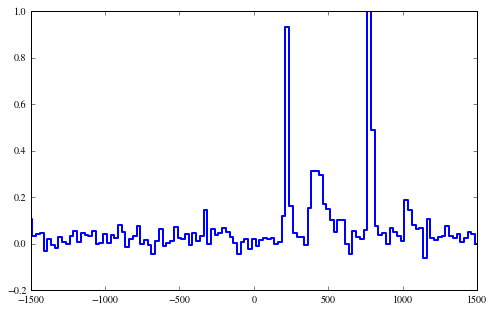

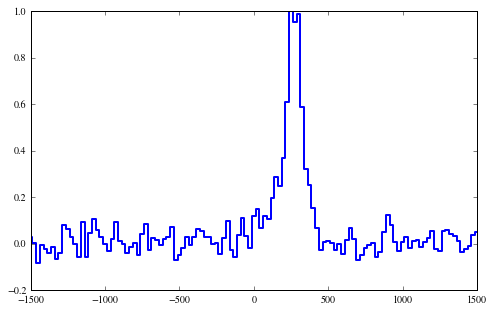

In [16]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
avg_tau = np.zeros(len(stck_img[ii,:]))
for ii,img in enumerate(stck_img):
    if np.sum(stck_mskN[ii,:]) != 0:
        tau = np.log(1./(img))
        sat_pix = np.where(img < stck_sig[ii,:]/2)[0]
        tau[sat_pix] = np.log(1./(stck_sig[ii,:][sat_pix]/2.))
        tau = tau/np.max(tau)
        plt.figure(figsize=(8,5))
        plt.plot(fin_velo.value,tau,drawstyle='steps-mid',linewidth=2.)
        avg_tau += tau
avg_tau = avg_tau/np.sum(stck_mskN,0)

Centroid velocity in km/s =  Parameter('mean_1', value=209.754328202)
tau-weighted centroid and sigma_v in km/s =  211.847317942 229.323158073


<CompoundModel4(amplitude_0=1.0, amplitude_1=0.32338050586752576, mean_1=209.7543282022799, stddev_1=271.53358390922057)>

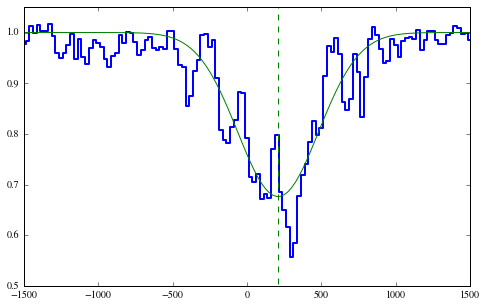

In [20]:
g_init = models.GaussianAbsorption1D(amplitude=0.2,mean=257.,stddev=268.)
c_init = models.Const1D(amplitude=1.0)
model_init = c_init*(g_init)
model_init.amplitude_0.fixed = True
fit = fitting.LevMarLSQFitter()
model_final = fit(model_init,fin_velo.value,fin_flx)
plt.figure(figsize=(8,5))
plt.plot(fin_velo.value,fin_flx,drawstyle='steps-mid',linewidth=2.)
plt.plot(fin_velo.value,model_final(fin_velo.value), label='Gaussian')
plt.plot([model_final.mean_1.value,model_final.mean_1.value],[0,2],'g--')
plt.axis([-1500,1500,0.5,1.05])
print('Centroid velocity in km/s = ',model_final.mean_1)
# tau-weighted centroid
#cranges = [(-3000.,-1300.)*u.km/u.s,(1300.,3000.)*u.km/u.s]
#pix = np.where( (fin_velo >= cranges[0][0]) & (fin_velo <= cranges[0][1]) | 
#               (fin_velo >= cranges[1][0]) & (fin_velo <= cranges[1][1]))[0]
#fit = np.polyfit(fin_velo[pix].value,fin_flx[pix], 0)
#pv = np.poly1d(fit)
#conti = pv(fin_velo.value)
#tau = np.log(1./(fin_flx/conti))
#tau = np.log(1./(fin_flx/model_final.amplitude_0))
start = np.int((len(fin_velo)-1)*1./6.)-1
end = np.int((len(fin_velo)-1)*5./6.)+1
tau_cen = np.sum(fin_velo.value[start:end+1]*tau[start:end+1])/np.sum(tau[start:end+1])
#tau[np.where(tau < 0)] = 0.
tau_disp = np.sqrt(np.abs(np.sum(np.square(fin_velo.value[start:end+1]-tau_cen)*tau[start:end+1])/np.sum(tau[start:end+1])))
print('tau-weighted centroid and sigma_v in km/s = ',tau_cen,tau_disp)
model_final

0.391114321884


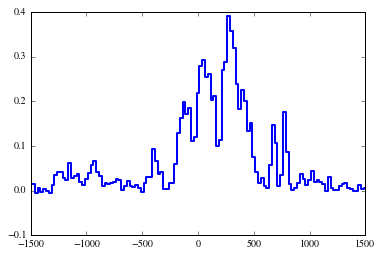

In [21]:
plt.plot(fin_velo.value,avg_tau,drawstyle='steps-mid',linewidth=2.)
plt.axis([-1500,1500,-0.1,0.4])
print(np.max(avg_tau))

Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits
Using spec-4216-55477-0198.fits.gz for BOSSJ0001+0000
S/N 3.99160926043 1 / Angstrom


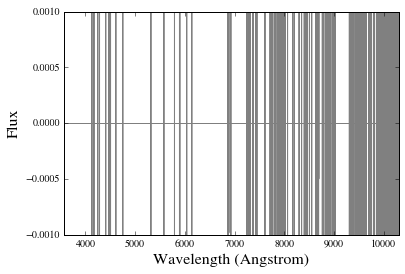

Using spSpec-52994-1490-155.fit.gz for BOSSJ0008-0039
S/N 2.66896966224 1 / Angstrom


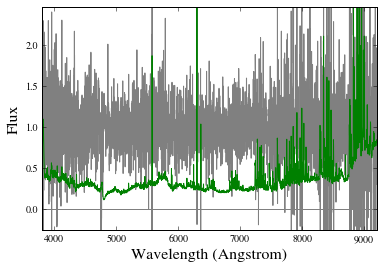

Using spSpec-52994-1490-155.fit.gz for BOSSJ0008-0039
S/N 3.03152012088 1 / Angstrom


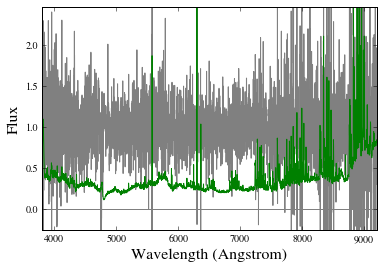

Using spec-6197-56191-0089.fits.gz for BOSSJ0042+1350
S/N 4.78378925531 1 / Angstrom


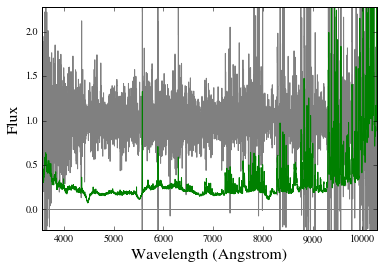

Using spec-6203-56266-0300.fits.gz for BOSSJ0047+1447
S/N 15.2487702641 1 / Angstrom


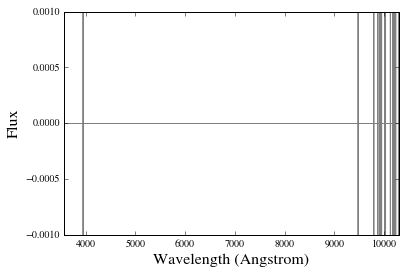

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ005718.90-000134.7.fits for BOSSJ0057-0001
S/N 3.17621972023 1 / Angstrom


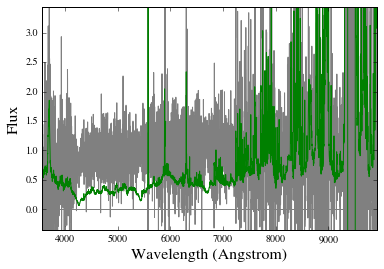

Using spec-3735-55209-0693.fits.gz for BOSSJ0103-0002
S/N 7.99979837142 1 / Angstrom


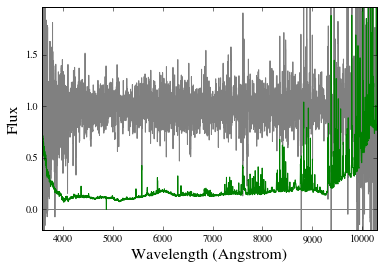

Using spec-4226-55475-0663.fits.gz for BOSSJ0106+0056
S/N 5.77452972033 1 / Angstrom


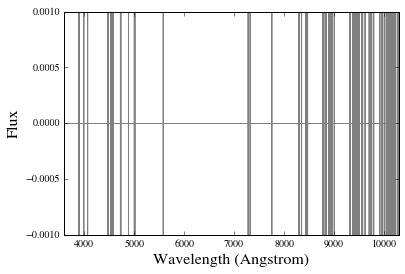

No spectrum found for SDSSJ0111+1402 and wvobs=5395.68 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ014917.46-002158.4.fits.gz for SDSSJ0149-0021
S/N 4.73737490858 1 / Angstrom


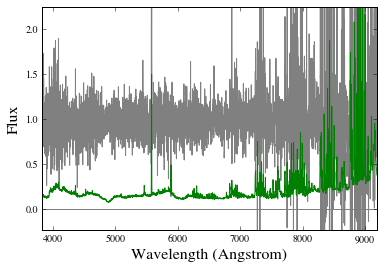

Using spec-4233-55449-0726.fits.gz for BOSSJ0154+0020
S/N 2.09476731289 1 / Angstrom


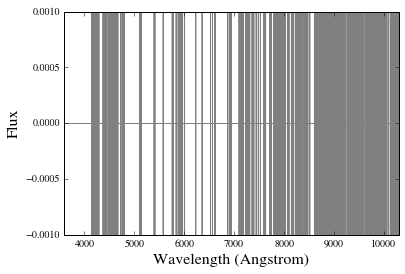

Using spec-5114-55883-0090.fits.gz for BOSSJ0206+2238
S/N 4.32188075506 1 / Angstrom


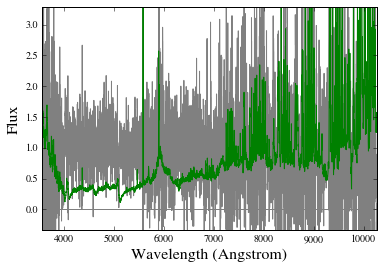

Using spec-4236-55479-0340.fits.gz for BOSSJ0214-0052
S/N 6.23200900767 1 / Angstrom


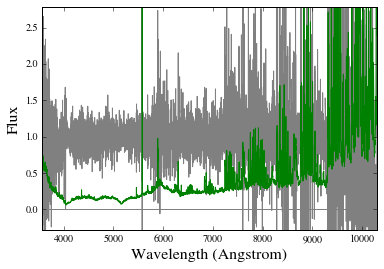

Using spec-6780-56605-0459.fits.gz for BOSSJ0224-0046
S/N 7.47685924003 1 / Angstrom


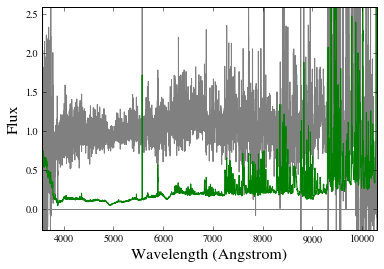

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ023019.99-033316.0.fits for BOSSJ0230-0333
S/N 10.0081325056 1 / Angstrom


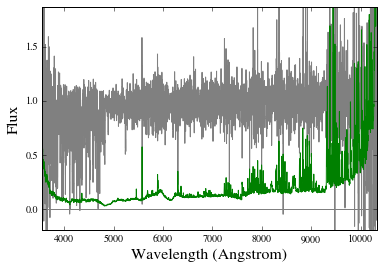

No continuum: /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ023946.44-010644.1_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ023946.45-010644.1.fits for BOSSJ0239-0106
S/N 12.0478731438 1 / Angstrom


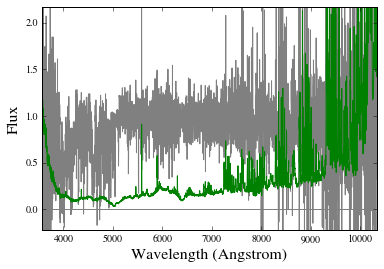

Using spec-6782-56572-0338.fits.gz for BOSSJ0242-0046
S/N 2.2635011456 1 / Angstrom


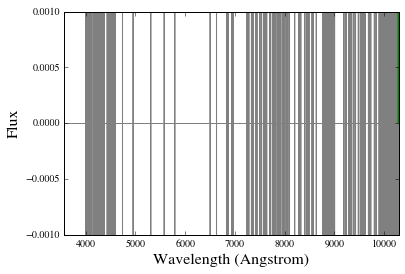

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ025039.82-004749.6.fits for BOSSJ0250-0047
S/N 7.1779329577 1 / Angstrom


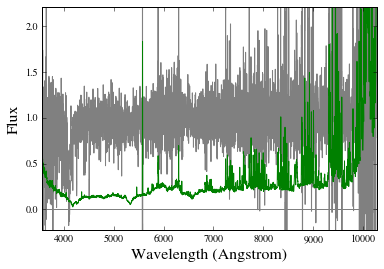

Using spSpec-52178-0713-044.fit.gz for BOSSJ0334-0058
S/N 0.800603634219 1 / Angstrom


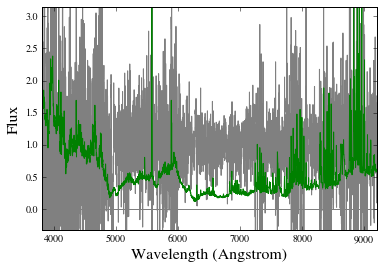

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ034139.19-000012.7_F.fits.gz for SDSSJ0341-0000
S/N 52.5198816706 1 / Angstrom


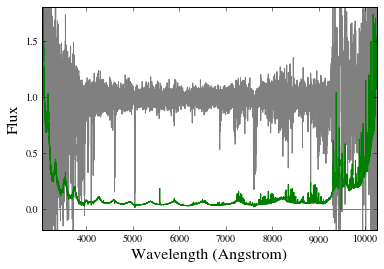

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ040954.21-041137.1_F.fits.gz for SDSSJ0409-0411
S/N 39.2178425522 1 / Angstrom


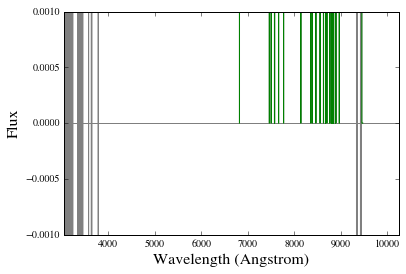

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ074953.62+370206.5.fits for BOSSJ0749+3702
S/N 2.89516607009 1 / Angstrom


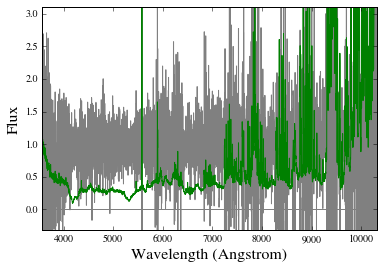

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ075259.14+401118.4.fits.gz for SDSSJ0752+4011
S/N 6.39883598742 1 / Angstrom


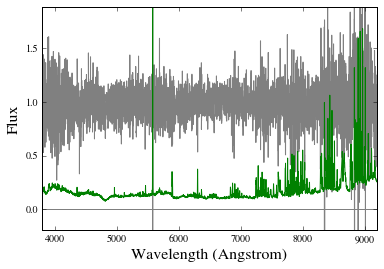

No spectrum found for APOJ0800+3542 and wvobs=4617.2 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ080948.22+453929.0.fits for BOSSJ0809+4539
S/N 2.60777952998 1 / Angstrom


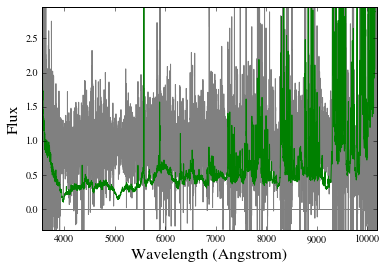

Using spec-4463-55868-0778.fits.gz for BOSSJ0812+2620
S/N 7.91669349809 1 / Angstrom


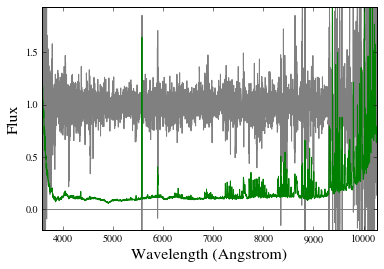

Using spec-4763-55869-0178.fits.gz for BOSSJ0814+0402
S/N 3.63348636684 1 / Angstrom


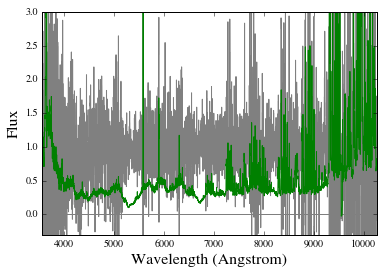

Using spSpec-53713-2272-395.fit.gz for BOSSJ0818+1527
S/N 2.31597390441 1 / Angstrom


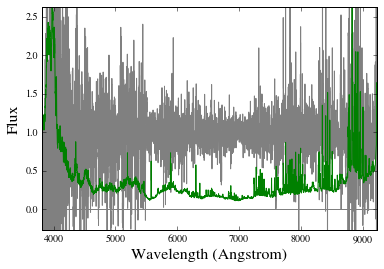

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ081833.97+123215.4.fits for BOSSJ0818+1232
S/N 10.2169718424 1 / Angstrom


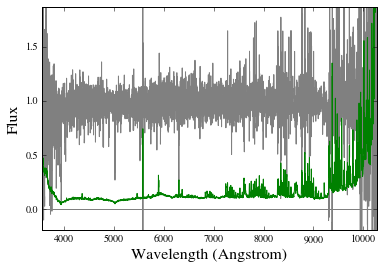

Using spSpec-51868-0441-618.fit.gz for BOSSJ0826+4708
S/N 4.61040425361 1 / Angstrom


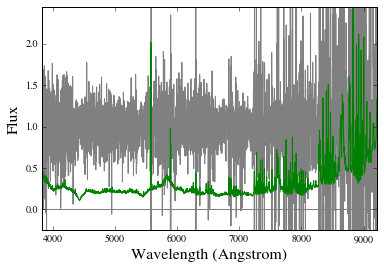

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ082844.87+454518.2.fits for SDSSJ0828+4545
S/N 8.13189991025 1 / Angstrom


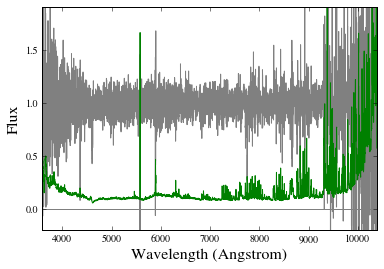

Using spec-7277-56748-0713.fits.gz for BOSSJ0830+5452
S/N 0.0 1 / Angstrom


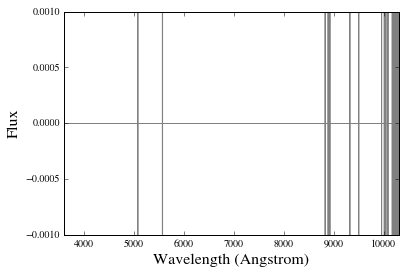

Using spec-5160-55895-0624.fits.gz for BOSSJ0833+4823
S/N 5.84492125774 1 / Angstrom


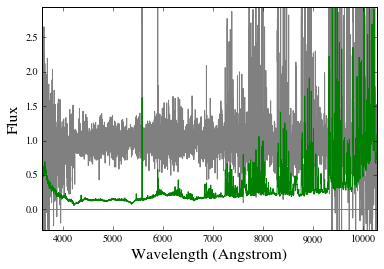

Using spec-5285-55946-0580.fits.gz for BOSSJ0837+0810
S/N 1.93179707338 1 / Angstrom


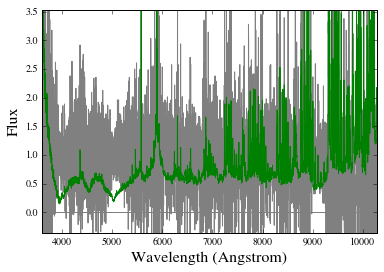

Using /u/xavier/Dropbox//QSOPairs/data/MODS_redux//./SDSSJ083712.69+363037.7_b_F.fits.gz for APOJ0837+3630
S/N 17.8947228184 1 / Angstrom


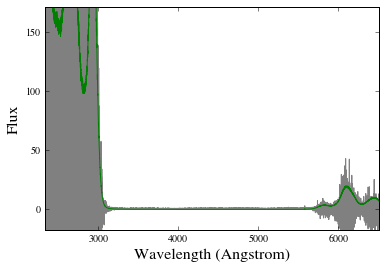

No spectrum found for APOJ0837+3837 and wvobs=4741.22 Angstrom!
Using spec-5160-55895-0092.fits.gz for BOSSJ0838+4621
S/N 6.57216966501 1 / Angstrom


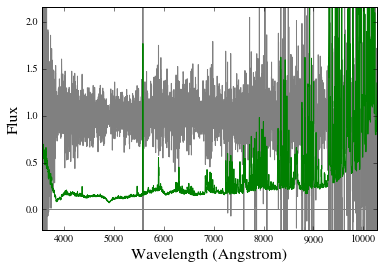

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ084159.26+392140.0.fits for BOSSJ0841+3921
S/N 7.76319133509 1 / Angstrom


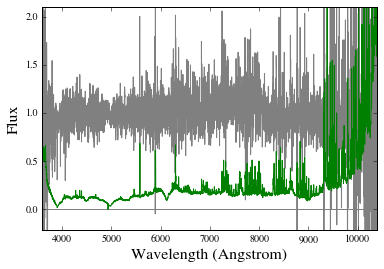

Using spec-7320-56722-0754.fits.gz for BOSSJ0844+4839
S/N 4.48982999002 1 / Angstrom


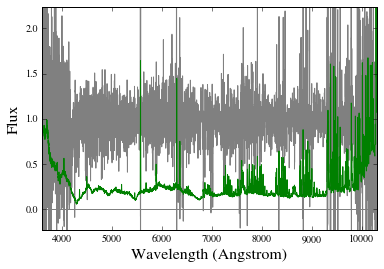

Using spec-5185-55978-0760.fits.gz for BOSSJ0845+3202
S/N 1.14031074005 1 / Angstrom


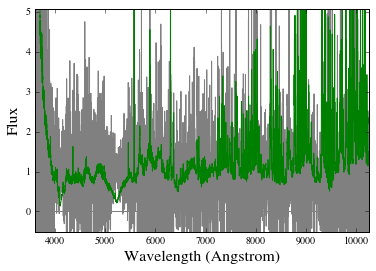

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ085357.49-001106.1_F.fits.gz for BOSSJ0853-0011
S/N 96.4983545463 1 / Angstrom


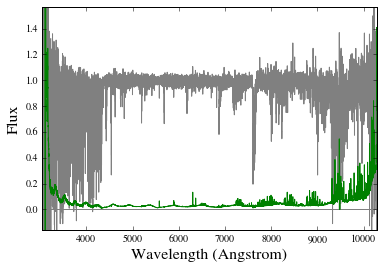

Using spec-5154-55864-0967.fits.gz for BOSSJ0856+5514
S/N 3.66833936389 1 / Angstrom


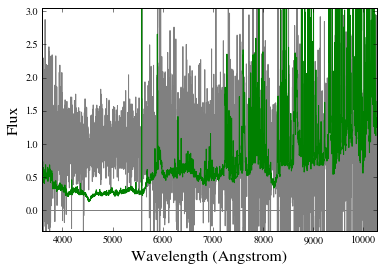

Using spec-4608-55973-0634.fits.gz for BOSSJ0857+3901
S/N 21.1880852128 1 / Angstrom


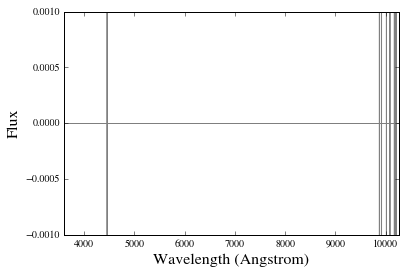

Using spec-4645-55623-0611.fits.gz for BOSSJ0902+3602
S/N 4.89566726117 1 / Angstrom


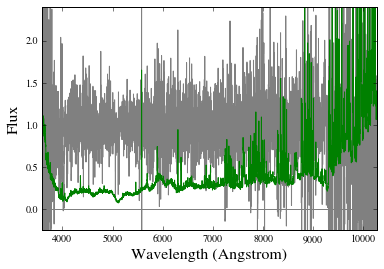

Using spec-7304-56745-0838.fits.gz for BOSSJ0903+5133
S/N 2.1507893647 1 / Angstrom


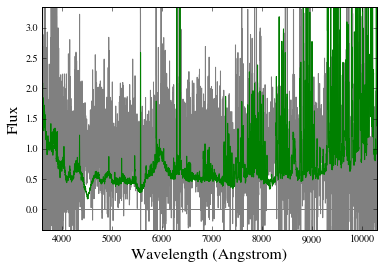

Using spSpec-51929-0470-486.fit.gz for BOSSJ0904+0042
S/N 5.49729625215 1 / Angstrom


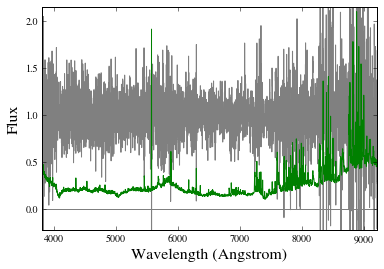

Using spec-5299-55927-0744.fits.gz for BOSSJ0906+1001
S/N 9.83110029346 1 / Angstrom


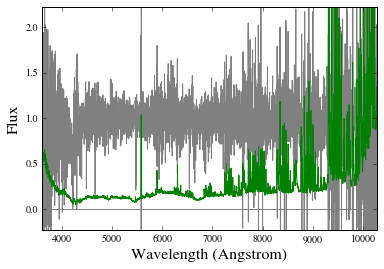

Using spec-5779-56338-0574.fits.gz for BOSSJ0907+2802
S/N 5.20066635458 1 / Angstrom


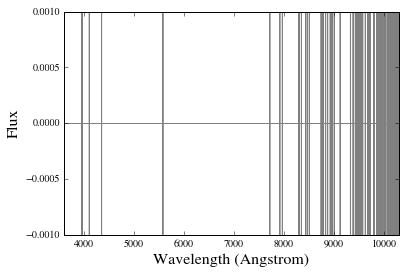

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ091046.69+041448.4_F.fits.gz for APOJ0910+0414
S/N 54.2537884302 1 / Angstrom


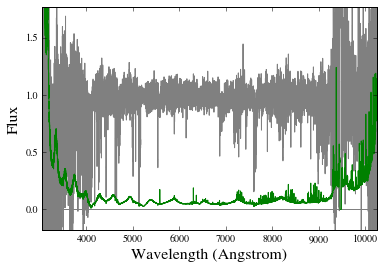

Using spec-5733-56575-0604.fits.gz for BOSSJ0911+4905
S/N 3.14390192037 1 / Angstrom


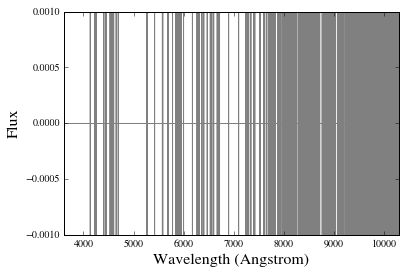

Using spec-4603-55999-0132.fits.gz for BOSSJ0912+4139
S/N 4.7887806603 1 / Angstrom


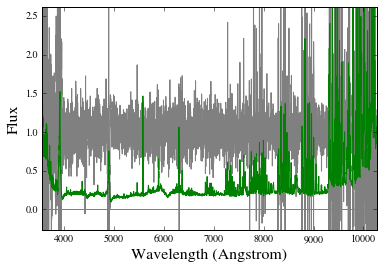

Using spec-5777-56280-0472.fits.gz for BOSSJ0912+2518
S/N 3.10502763228 1 / Angstrom


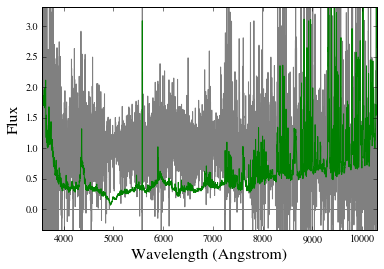

Using spec-5809-56353-0052.fits.gz for BOSSJ0912+3056
S/N 14.3718470326 1 / Angstrom


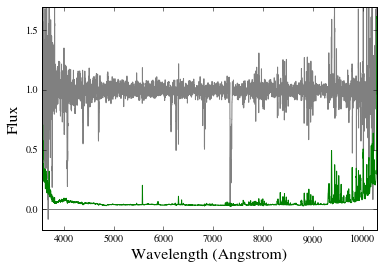

Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ091338.97-010704.6_F.fits.gz for BOSSJ0913-0107
S/N 75.6872586124 1 / Angstrom


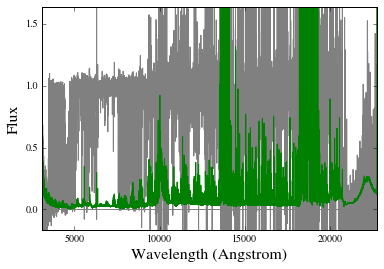

Using spec-5809-56353-0073.fits.gz for BOSSJ0913+3151
S/N 1.56196564745 1 / Angstrom


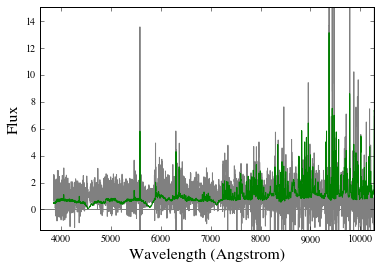

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091430.84+010927.5.fits for BOSSJ0914+0109
S/N 8.25998917053 1 / Angstrom


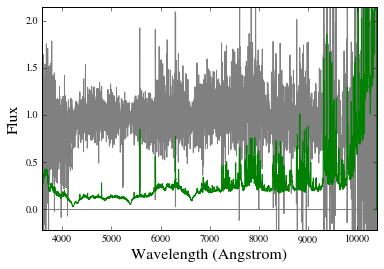

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091553.38+011911.3.fits for BOSSJ0915+0119
S/N 5.86331716164 1 / Angstrom


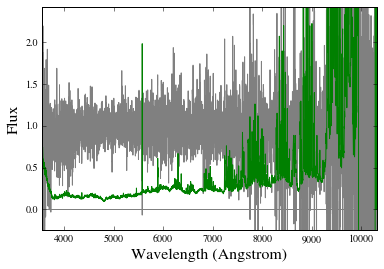

Using spec-4687-56338-0202.fits.gz for BOSSJ0916+4250
S/N 2.34020288086 1 / Angstrom


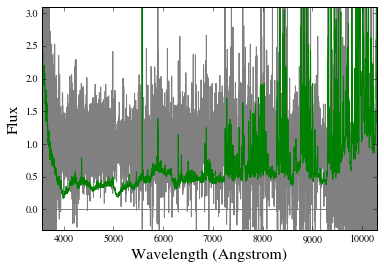

Using spec-5810-56358-0452.fits.gz for BOSSJ0920+3340
S/N 9.07644194639 1 / Angstrom


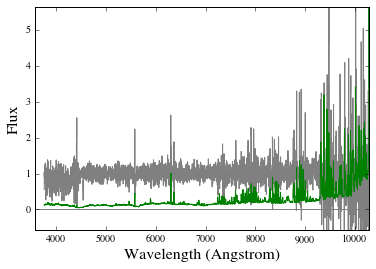

No spectrum found for APOJ0924+3929 and wvobs=4466.88 Angstrom!
Using spec-5309-55929-0018.fits.gz for BOSSJ0932+0843
S/N 3.8103619824 1 / Angstrom


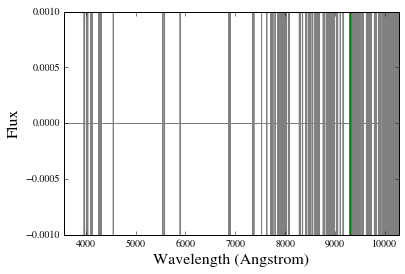

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ093225.60+092500.2_F.fits.gz for APOJ0932+0925
S/N 64.2783612445 1 / Angstrom


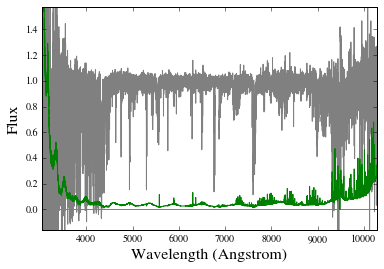

Using spec-5716-56684-0357.fits.gz for BOSSJ0933+5920
S/N 11.4510006139 1 / Angstrom


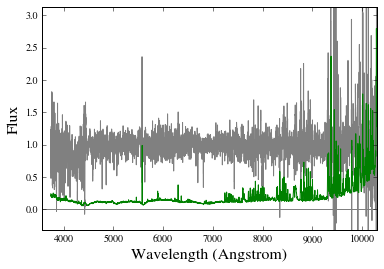

Using spec-4695-55957-0570.fits.gz for BOSSJ0935+4532
S/N 5.38145517764 1 / Angstrom


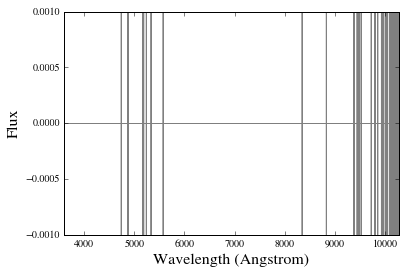

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ093642.20-005831.3.fits for BOSSJ0936-0058
S/N 6.27442689938 1 / Angstrom


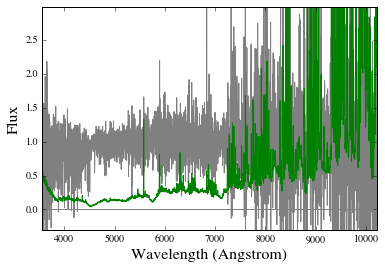

No spectrum found for APOJ0938+5317 and wvobs=4748.36 Angstrom!
Using spec-5798-56326-0494.fits.gz for BOSSJ0940+3345
S/N 4.14098046299 1 / Angstrom


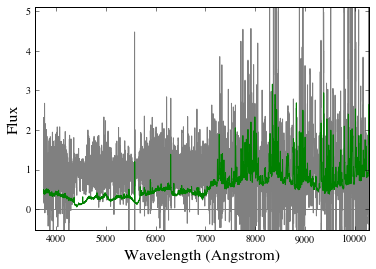

Using spec-5788-56255-0380.fits.gz for BOSSJ0941+2308
S/N 13.1551668596 1 / Angstrom


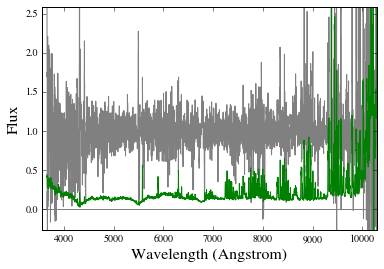

Using spec-5315-55978-0050.fits.gz for BOSSJ0942+1347
S/N 1.51356584538 1 / Angstrom


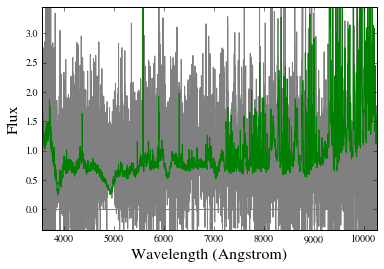

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ095641.74+024840.8.fits for BOSSJ0956+0248
S/N 2.4638483253 1 / Angstrom


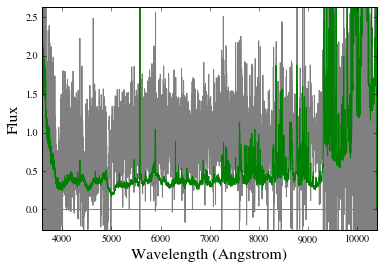

Using spec-4800-55674-0408.fits.gz for BOSSJ1000+0337
S/N 4.45764215896 1 / Angstrom


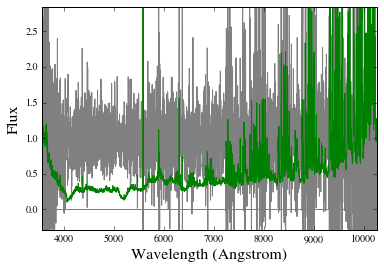

Using spec-4566-55630-0392.fits.gz for BOSSJ1001+4023
S/N 3.38193293135 1 / Angstrom


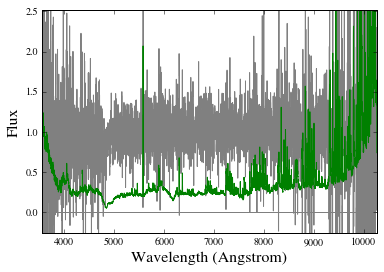

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ100247.14+002053.0.fits for BOSSJ1002+0020
S/N 2.94670208184 1 / Angstrom


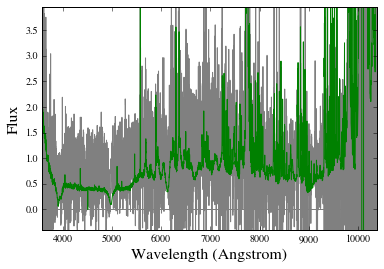

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ100507.08+501929.6.fits.gz for SDSSJ1005+5019
S/N 12.0867028884 1 / Angstrom


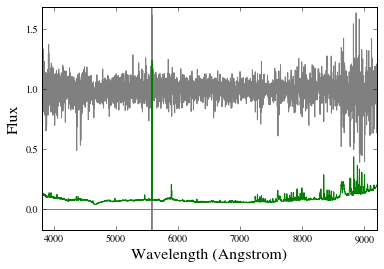

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ100627.10+480429.9.fits for BOSSJ1006+4804
S/N 8.49709978383 1 / Angstrom


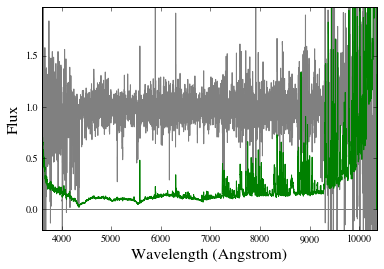

Using spec-5332-55981-0712.fits.gz for BOSSJ1009+1749
S/N 0.0 1 / Angstrom


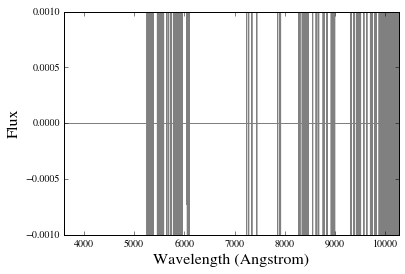

Using spec-4738-55650-0778.fits.gz for BOSSJ1009+0236
S/N 6.4553627316 1 / Angstrom


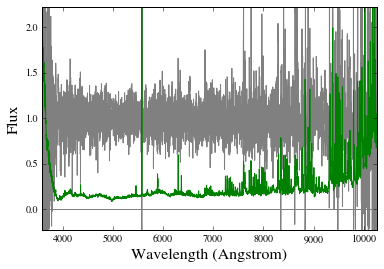

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ100940.58+250053.9.fits for APOJ1009+2500
S/N 5.36994518204 1 / Angstrom


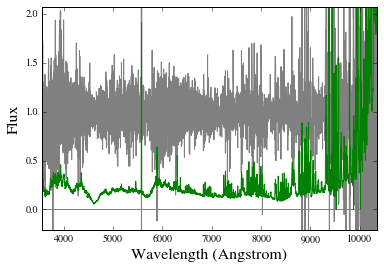

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ101003.47+403754.9.fits for BOSSJ1010+4037
S/N 13.3478805307 1 / Angstrom


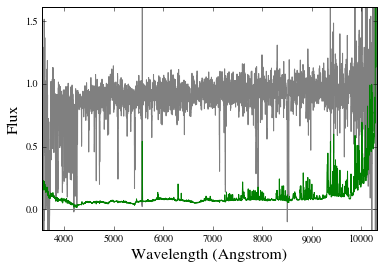

Using spec-7384-56715-0292.fits.gz for BOSSJ1010+4517
S/N 3.26055148641 1 / Angstrom


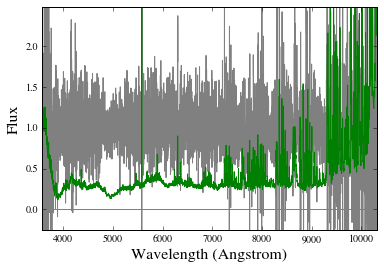

Using spec-5334-55928-0394.fits.gz for BOSSJ1010+0821
S/N 2.47218590656 1 / Angstrom


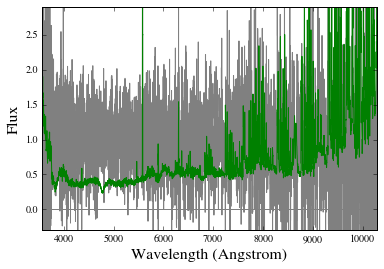

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ101322.31+033009.0.fits for BOSSJ1013+0330
S/N 4.33799827997 1 / Angstrom


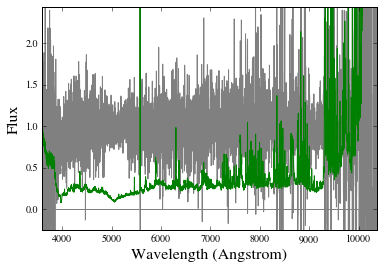

Using spec-6470-56334-0188.fits.gz for BOSSJ1014+2653
S/N 1.78382364909 1 / Angstrom


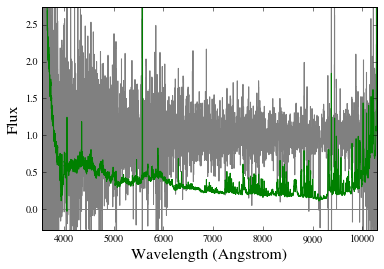

Using spec-5333-56001-0040.fits.gz for BOSSJ1015+1245
S/N 2.20865303238 1 / Angstrom


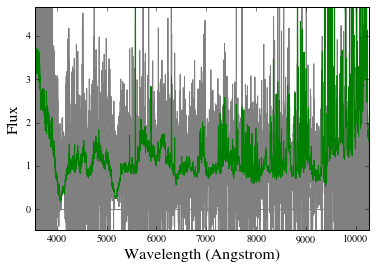

Using spec-7081-56684-0951.fits.gz for BOSSJ1017+6226
S/N 12.8862508873 1 / Angstrom


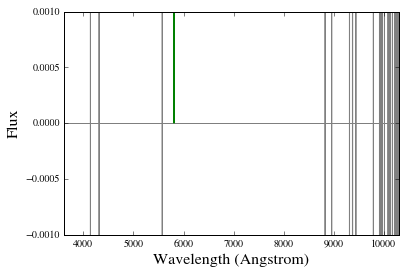

Using spec-7090-56659-0466.fits.gz for BOSSJ1020+6119
S/N 4.08656679764 1 / Angstrom


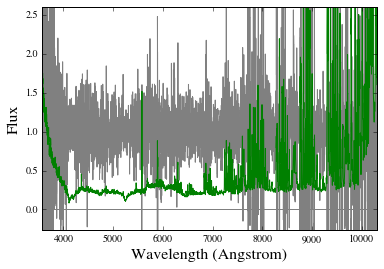

Using spec-4802-55652-0146.fits.gz for BOSSJ1024+0354
S/N 2.71300943676 1 / Angstrom


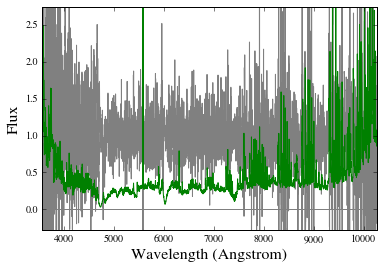

Using spec-6463-56340-0210.fits.gz for BOSSJ1024+2616
S/N 9.10303381718 1 / Angstrom


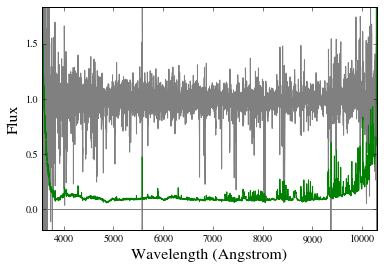

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ102616.12+461420.8_F.fits.gz for APOJ1026+4614
S/N 127.919846343 1 / Angstrom


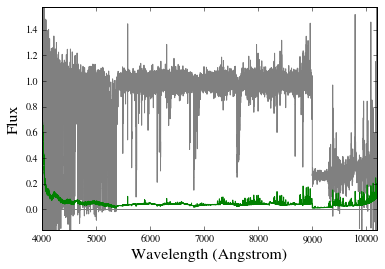

Using spec-6695-56628-0406.fits.gz for BOSSJ1028+5121
S/N 2.54587289663 1 / Angstrom


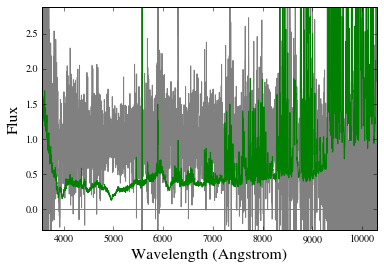

Using spec-5344-55924-0888.fits.gz for BOSSJ1034+0856
S/N 4.13774731128 1 / Angstrom


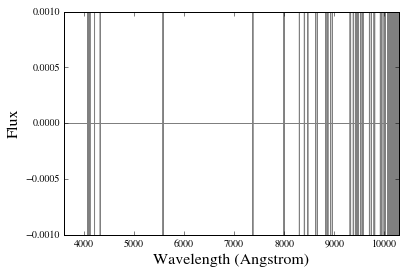

Using spec-6702-56381-0508.fits.gz for BOSSJ1036+5012
S/N 8.37513187158 1 / Angstrom


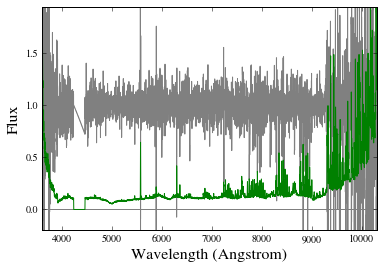

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ103900.01+502652.8_F.fits.gz for BOSSJ1039+5026
S/N 56.8645040078 1 / Angstrom


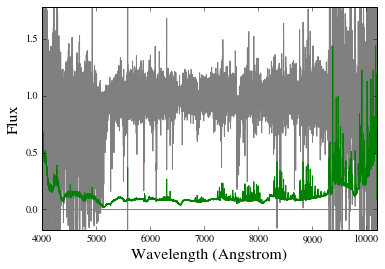

No spectrum found for APOJ1041+1957 and wvobs=4406.95 Angstrom!
Using spec-7083-56722-0068.fits.gz for BOSSJ1042+6459
S/N 7.58582013331 1 / Angstrom


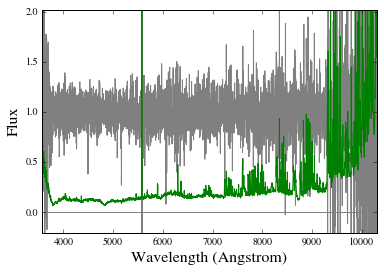

Using spec-6448-56365-0160.fits.gz for BOSSJ1044+3139
S/N 7.86940354567 1 / Angstrom


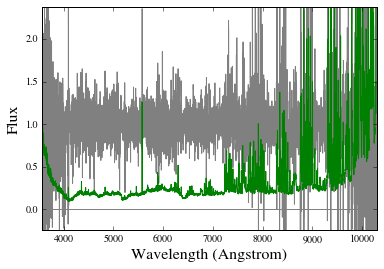

No spectrum found for APOJ1045+4351 and wvobs=5307.66 Angstrom!
Using spec-5351-55952-0348.fits.gz for BOSSJ1045+1000
S/N 4.10381545848 1 / Angstrom


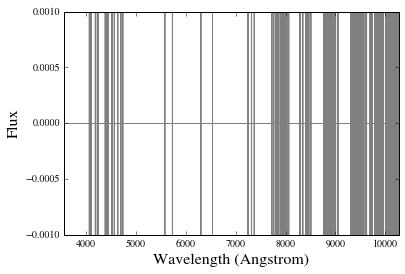

Using spec-7094-56660-0184.fits.gz for BOSSJ1052+5553
S/N 9.29714661482 1 / Angstrom


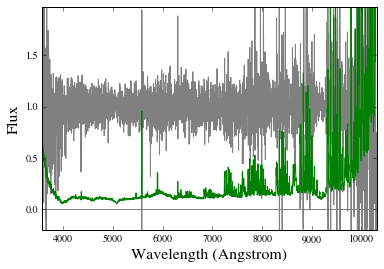

Using spec-7104-56711-0232.fits.gz for BOSSJ1059+6255
S/N 7.94386593937 1 / Angstrom


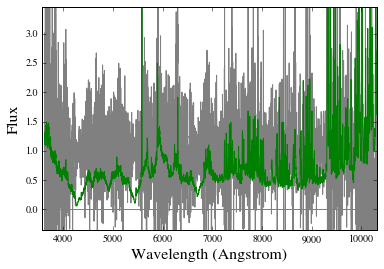

Using spec-6693-56384-0164.fits.gz for BOSSJ1106+4635
S/N 15.7048884164 1 / Angstrom


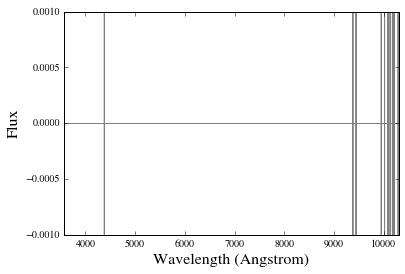

Using spec-6440-56370-0888.fits.gz for BOSSJ1113+3305
S/N 3.70520002184 1 / Angstrom


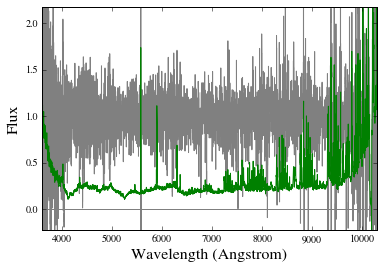

Using spec-4651-56008-0354.fits.gz for BOSSJ1118+4025
S/N 3.53696041947 1 / Angstrom


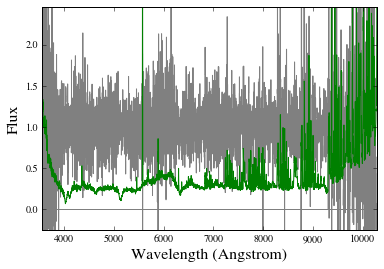

Using spec-3840-55574-0090.fits.gz for BOSSJ1136-0029
S/N 2.28254627656 1 / Angstrom


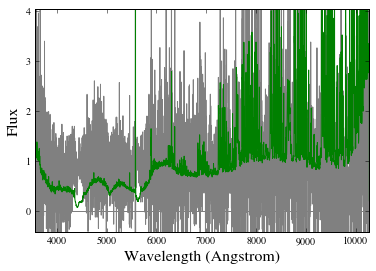

Using spec-7113-56711-0152.fits.gz for BOSSJ1138+6329
S/N 14.0098518741 1 / Angstrom


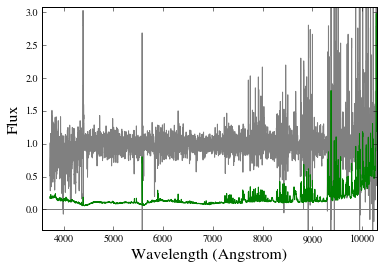

Using spSpec-53792-2221-272.fit.gz for BOSSJ1140+2709
S/N 1.7371434612 1 / Angstrom


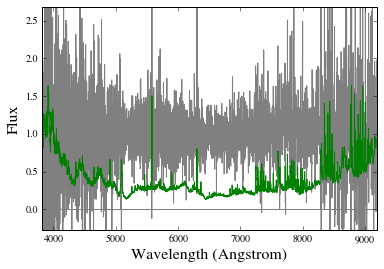

No continuum: /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114145.43+072423.3_b400_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ114145.43+072423.3_b600_F.fits.gz for APOJ1141+0724
S/N 17.5284400508 1 / Angstrom


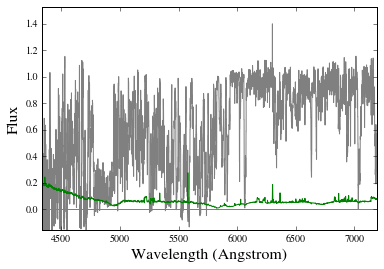

Using spec-6406-56330-0400.fits.gz for BOSSJ1142+2822
S/N 0.0 1 / Angstrom


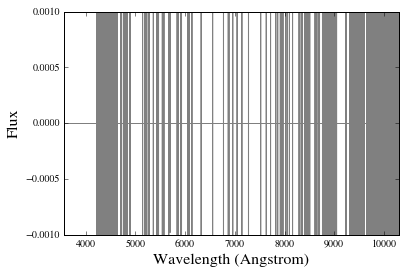

Using spec-5379-55986-0194.fits.gz for BOSSJ1142+1128
S/N 5.98197355801 1 / Angstrom


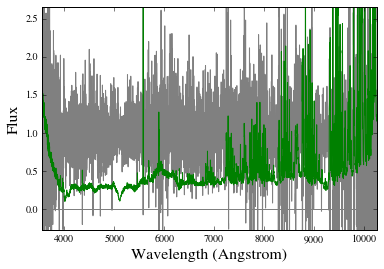

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ114436.66+095904.9_F.fits.gz for BOSSJ1144+0959
S/N 181.598447758 1 / Angstrom


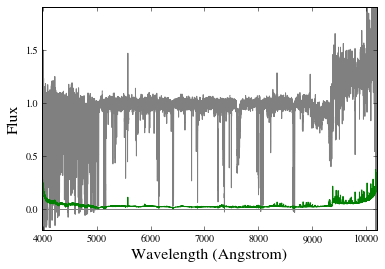

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ114546.22+032251.9_F.fits.gz for BOSSJ1145+0322
S/N 51.0192990134 1 / Angstrom


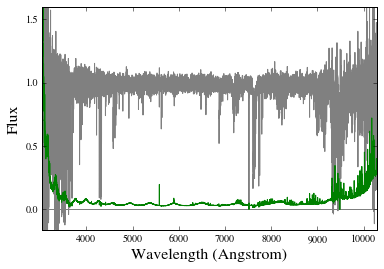

Using spec-7091-56658-0662.fits.gz for BOSSJ1150+5802
S/N 8.31599943026 1 / Angstrom


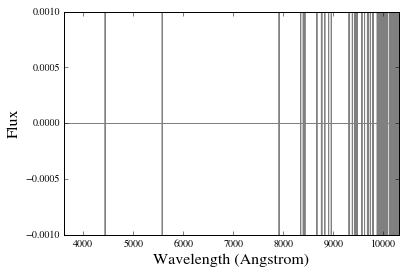

Using spSpec-53415-1762-517.fit.gz for BOSSJ1152+1507
S/N 7.71955016638 1 / Angstrom


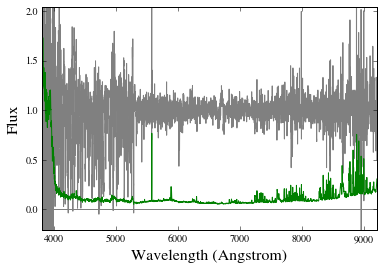

Using spec-4697-55660-0326.fits.gz for BOSSJ1155+3934
S/N 6.52812336087 1 / Angstrom


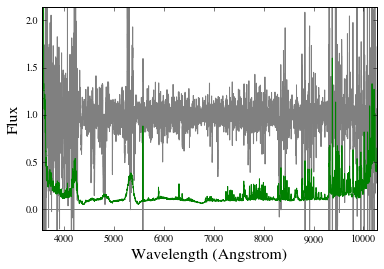

Using spec-5387-56009-0348.fits.gz for BOSSJ1159+1433
S/N 1.53943154978 1 / Angstrom


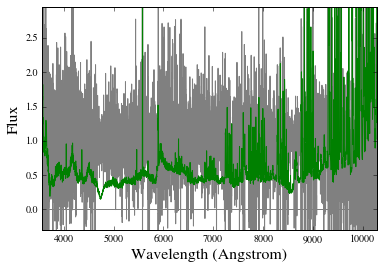

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ120029.15+012946.3.fits for BOSSJ1200+0129
S/N 2.48166265354 1 / Angstrom


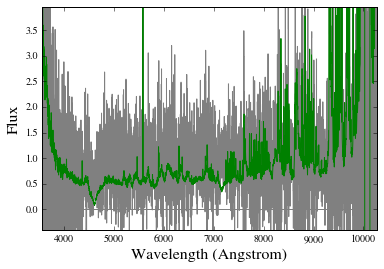

Using spec-5389-55953-0264.fits.gz for BOSSJ1202+0747
S/N 9.28016839295 1 / Angstrom


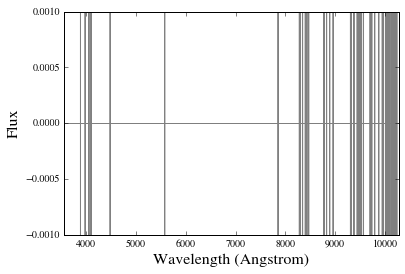

No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ120416.69+022111.0_b1200_F.fits.gz
No continuum: /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz
Using conti=1 for HIRES
Using /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz for BOSSJ1204+0221
S/N 326.062399277 1 / Angstrom


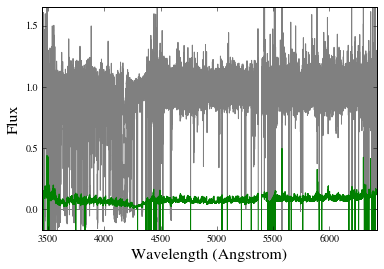

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120857.16+073727.3_F.fits.gz for APOJ1208+0737
S/N 14.4530959413 1 / Angstrom


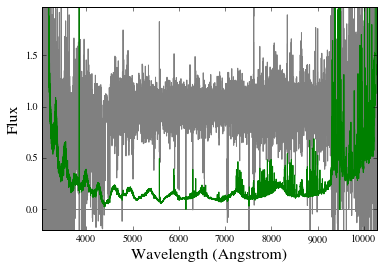

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ121201.68+324013.3.fits for BOSSJ1212+3240
S/N 7.97757344737 1 / Angstrom


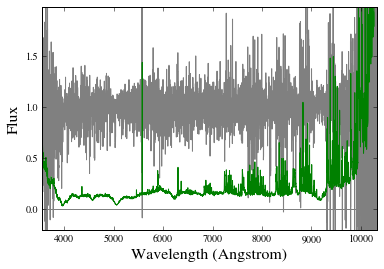

Using spec-6640-56385-0544.fits.gz for BOSSJ1213+4719
S/N 3.99164087068 1 / Angstrom


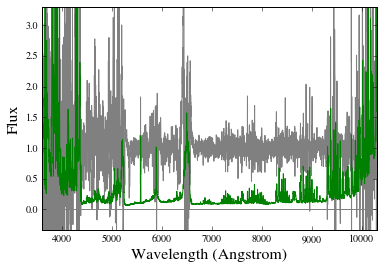

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ121558.80+571555.4.fits.gz for BOSSJ1215+5715
S/N 15.3854556421 1 / Angstrom


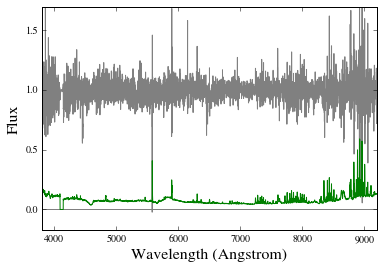

Using spec-6837-56442-0324.fits.gz for BOSSJ1225+5709
S/N 4.05815371971 1 / Angstrom


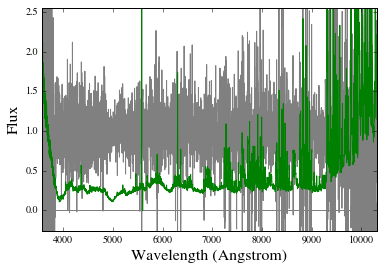

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ123141.73+002913.9.fits for BOSSJ1231+0029
S/N 3.92920264199 1 / Angstrom


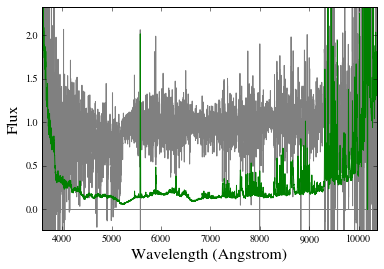

Using spec-3970-55591-0870.fits.gz for BOSSJ1239+3955
S/N 3.86444182982 1 / Angstrom


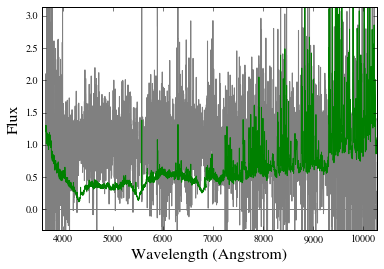

Using spec-6680-56420-0155.fits.gz for BOSSJ1242+5331
S/N 1.36500660891 1 / Angstrom


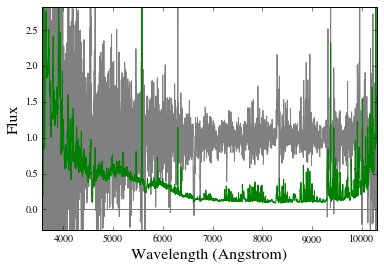

Using spec-3972-55589-0570.fits.gz for BOSSJ1244+3916
S/N 9.25724923589 1 / Angstrom


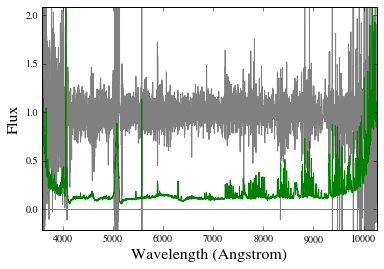

Using spec-6482-56358-0110.fits.gz for BOSSJ1244+3208
S/N 3.6126028455 1 / Angstrom


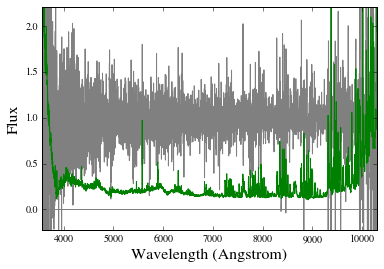

Using spec-6840-56685-0230.fits.gz for BOSSJ1245+5922
S/N 1.14666208827 1 / Angstrom


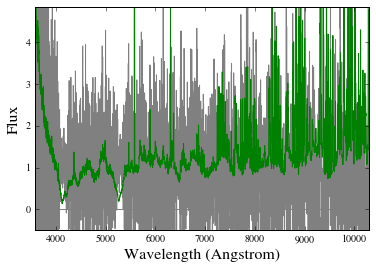

Using spec-5986-56328-0112.fits.gz for BOSSJ1246+2345
S/N 5.06161278448 1 / Angstrom


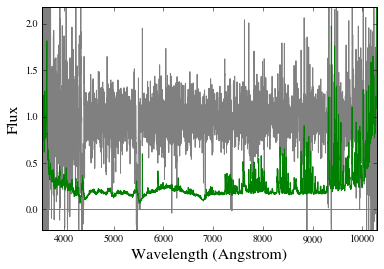

Using spec-4703-55617-0350.fits.gz for BOSSJ1248+4058
S/N 13.6793656083 1 / Angstrom


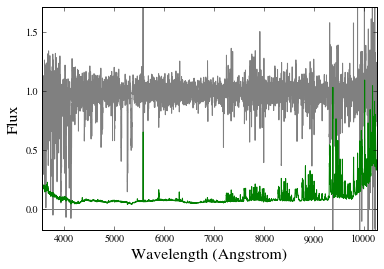

Using spec-6970-56444-0800.fits.gz for BOSSJ1253+6327
S/N 1.13189443657 1 / Angstrom


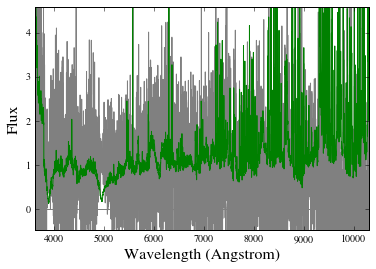

Using spec-5989-56312-0172.fits.gz for BOSSJ1255+2234
S/N 3.85218591356 1 / Angstrom


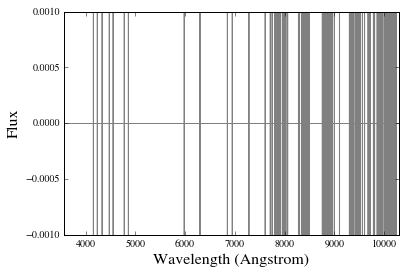

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ130125.67+475930.8.fits.gz for SDSSJ1301+4759
S/N 10.8580339213 1 / Angstrom


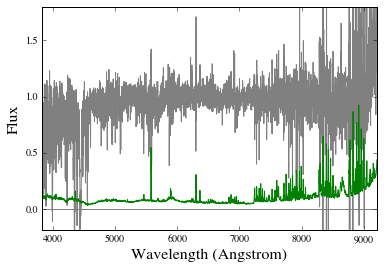

No spectrum found for APOJ1306+6158 and wvobs=4813.24 Angstrom!
Using spec-5422-55986-0346.fits.gz for BOSSJ1310+1134
S/N 1.83130948779 1 / Angstrom


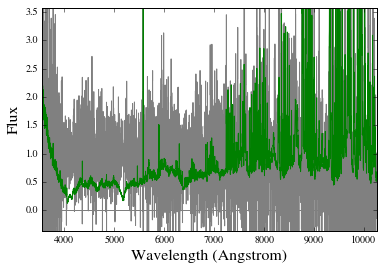

Using spec-5865-56067-0543.fits.gz for BOSSJ1319+2138
S/N 2.51741100493 1 / Angstrom


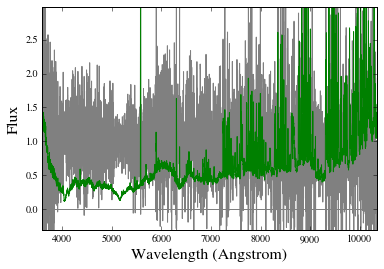

Using spec-6828-56430-0134.fits.gz for BOSSJ1325+5409
S/N 9.65926048224 1 / Angstrom


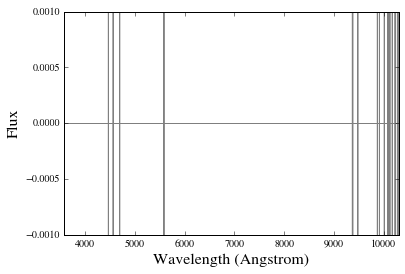

No spectrum found for APOJ1327+3423 and wvobs=4100.35 Angstrom!
Using spec-6626-56330-0556.fits.gz for BOSSJ1335+4330
S/N 2.56351419151 1 / Angstrom


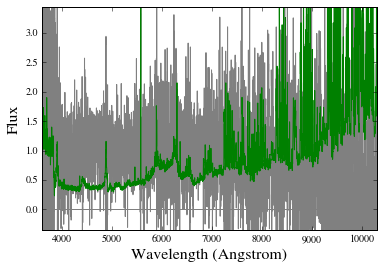

Using spec-5858-56063-0734.fits.gz for BOSSJ1346+1952
S/N 3.99592808315 1 / Angstrom


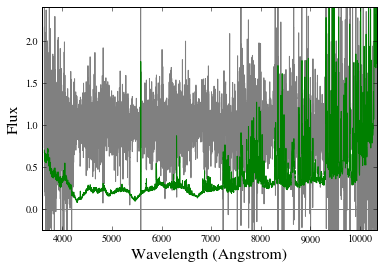

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ135629.53+613310.2.fits.gz for BOSSJ1356+6133
S/N 3.82531752417 1 / Angstrom


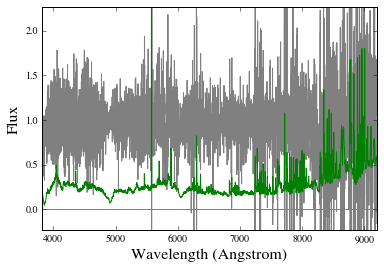

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ135849.54+273756.9.fits for APOJ1358+2737
S/N 8.49498885716 1 / Angstrom


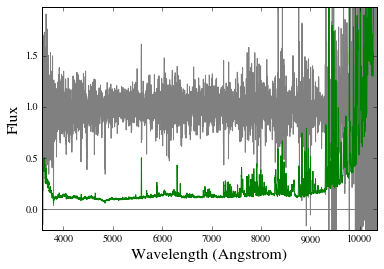

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ140209.53+470117.8.fits.gz for BOSSJ1402+4701
S/N 3.12227698244 1 / Angstrom


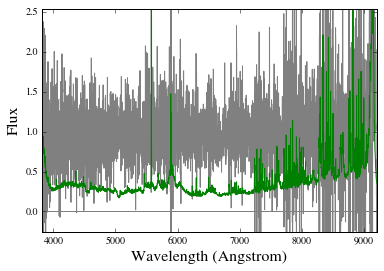

Using spec-6751-56368-0576.fits.gz for BOSSJ1410+4804
S/N 2.02370890079 1 / Angstrom


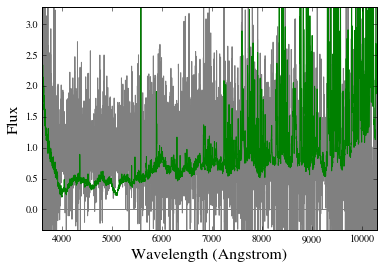

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ141337.96+271511.0.fits for SDSSJ1413+2715
S/N 21.7889265018 1 / Angstrom


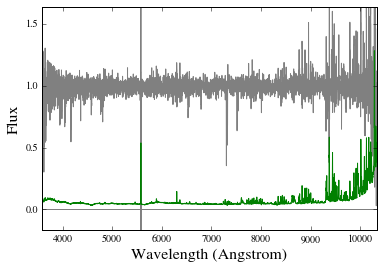

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ142004.12+022708.8_F.fits.gz for BOSSJ1420+0227
S/N 51.3980105492 1 / Angstrom


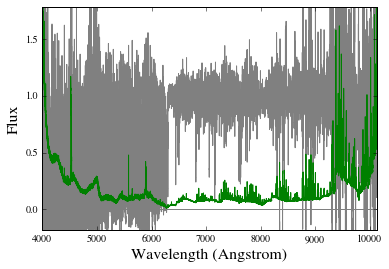

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142054.92+160342.9_F.fits.gz for APOJ1420+1603
S/N 92.5854414587 1 / Angstrom


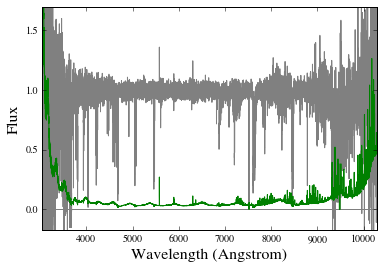

Using spec-6752-56366-0559.fits.gz for BOSSJ1422+4652
S/N 3.61080014807 1 / Angstrom


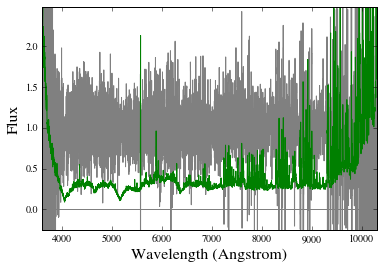

No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ142758.74-012136.2_b1200_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142758.74-012136.2_F.fits.gz for BOSSJ1427-0121
S/N 110.259264069 1 / Angstrom


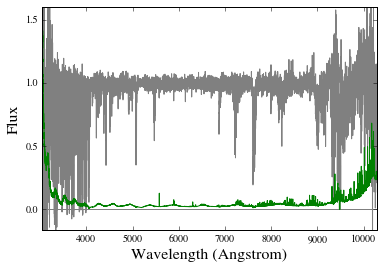

Using spec-6710-56416-0700.fits.gz for BOSSJ1428+5509
S/N 1.42625007252 1 / Angstrom


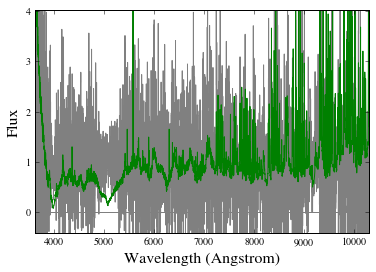

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ143109.22+572726.4.fits for APOJ1431+5727
S/N 3.08768139189 1 / Angstrom


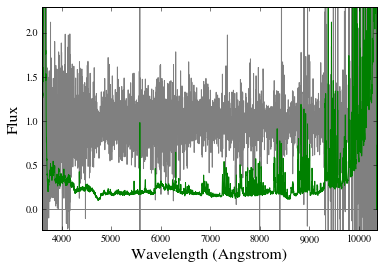

Using spec-5467-55973-0438.fits.gz for BOSSJ1433+0827
S/N 10.9165867956 1 / Angstrom


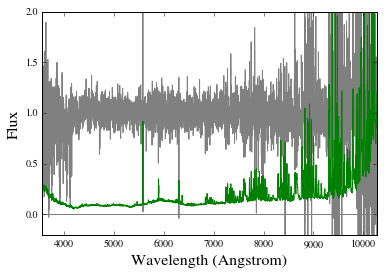

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_4_45/SDSSJ143344.55+064111.9.fits for BOSSJ1433+0641
S/N 14.6793126358 1 / Angstrom


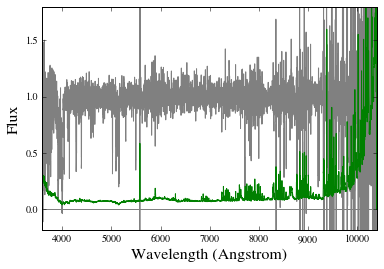

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ144231.91+013734.8.fits for BOSSJ1442+0137
S/N 24.5976142131 1 / Angstrom


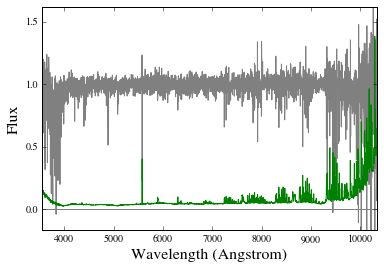

Using spec-6800-56399-0012.fits.gz for BOSSJ1448+5649
S/N 1.95461710275 1 / Angstrom


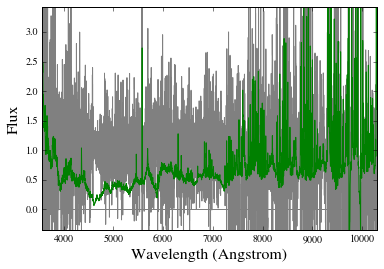

Using spec-4015-55624-0682.fits.gz for BOSSJ1457+0237
S/N 3.13498303577 1 / Angstrom


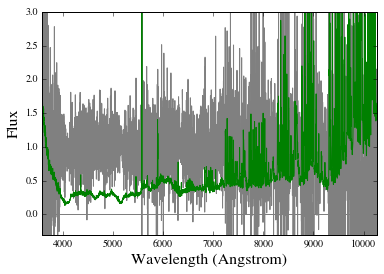

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ150812.80+363530.3.fits for BOSSJ1508+3635
S/N 6.87693182737 1 / Angstrom


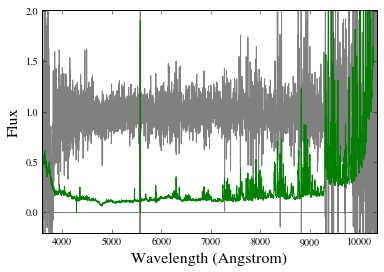

Using spec-3964-55648-0682.fits.gz for BOSSJ1515+2627
S/N 0.0 1 / Angstrom


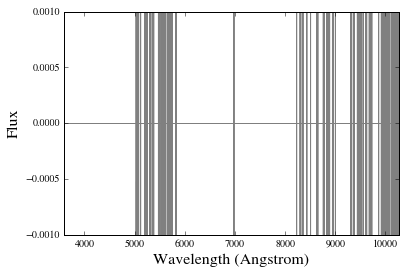

Using spec-3950-55680-0428.fits.gz for BOSSJ1517+2002
S/N 1.86699418099 1 / Angstrom


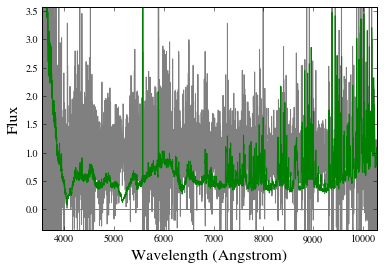

Using spec-3953-55322-0392.fits.gz for BOSSJ1530+2515
S/N 1.293368427 1 / Angstrom


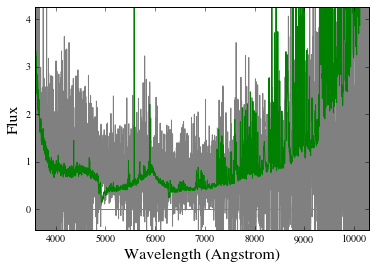

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ153329.17+142537.8.fits for BOSSJ1533+1425
S/N 12.7148246482 1 / Angstrom


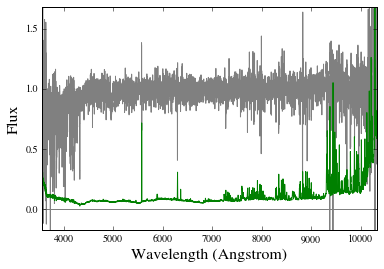

Using spec-3949-55650-0016.fits.gz for BOSSJ1534+2153
S/N 5.14865456959 1 / Angstrom


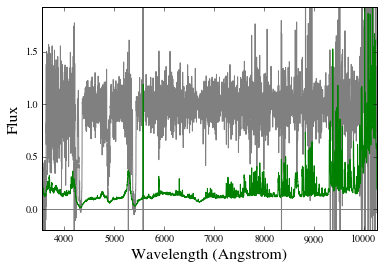

Using spec-6791-56429-0266.fits.gz for BOSSJ1538+5707
S/N 2.31037544012 1 / Angstrom


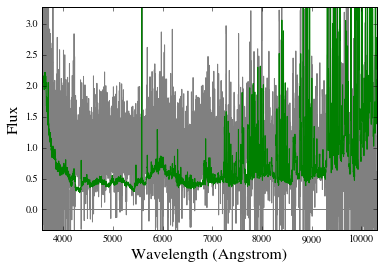

Using spec-4723-56033-0012.fits.gz for BOSSJ1539+3146
S/N 4.93967604614 1 / Angstrom


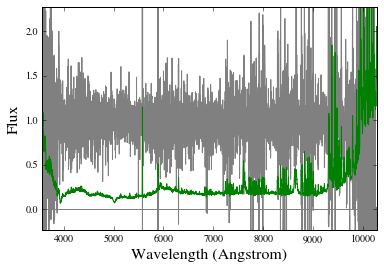

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ155325.89+192137.7_F.fits.gz for APOJ1553+1921
S/N 45.206046235 1 / Angstrom


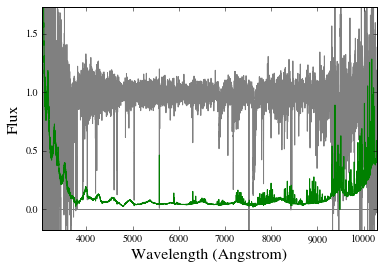

Using spec-4900-55739-0026.fits.gz for BOSSJ1554+1244
S/N 10.2994953239 1 / Angstrom


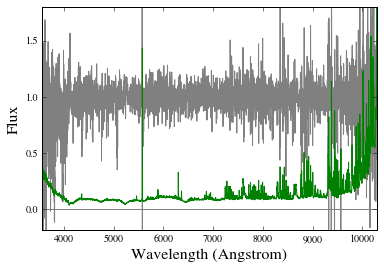

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ155622.54+304059.9.fits for BOSSJ1556+3040
S/N 2.06913256786 1 / Angstrom


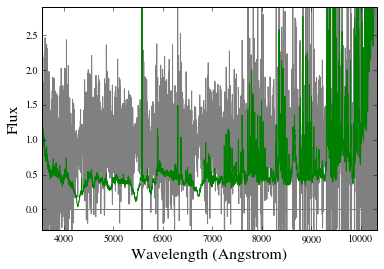

Using spec-4806-55688-0910.fits.gz for BOSSJ1557+0434
S/N 4.65918670304 1 / Angstrom


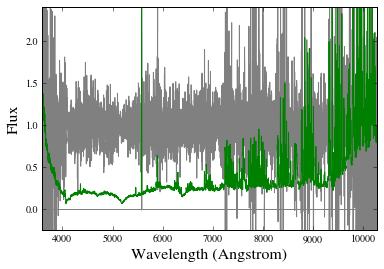

No spectrum found for APOJ1559+4943 and wvobs=4428.27 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ160546.67+511323.0.fits for BOSSJ1605+5113
S/N 20.8590099184 1 / Angstrom


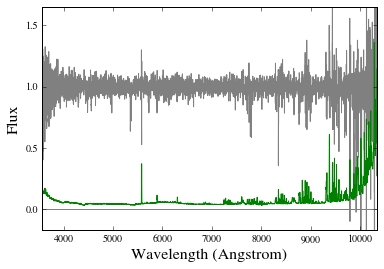

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ161817.31+184230.1.fits for BOSSJ1618+1842
S/N 1.15069994176 1 / Angstrom


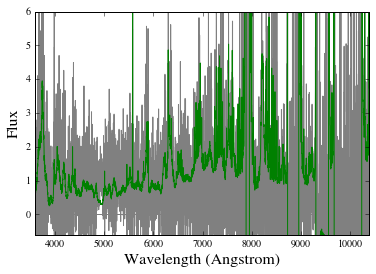

Using spec-4057-55357-0161.fits.gz for BOSSJ1619+1926
S/N 4.71719664024 1 / Angstrom


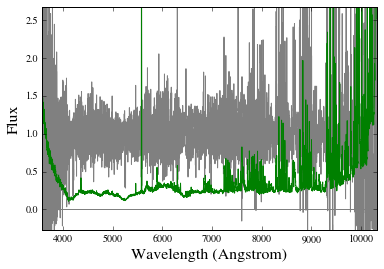

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ162737.91+221509.3_F.fits.gz for BOSSJ1627+2215
S/N 57.8484634235 1 / Angstrom


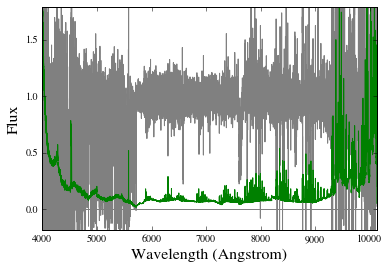

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ162737.25+460609.3_F.fits.gz for APOJ1627+4606
S/N 91.8390265989 1 / Angstrom


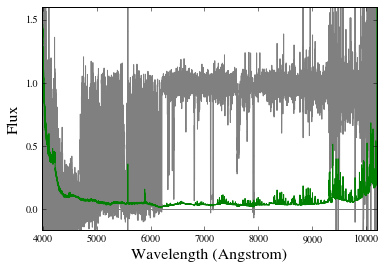

Using spec-4188-55684-0404.fits.gz for BOSSJ1628+2342
S/N 10.293503745 1 / Angstrom


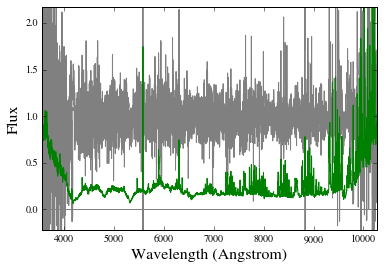

Using spec-6030-56097-0378.fits.gz for BOSSJ1631+4333
S/N 3.71730311755 1 / Angstrom


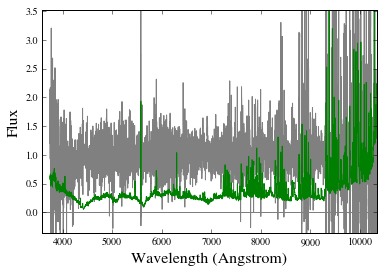

Using spec-5195-56048-0692.fits.gz for BOSSJ1631+3659
S/N 2.94361301773 1 / Angstrom


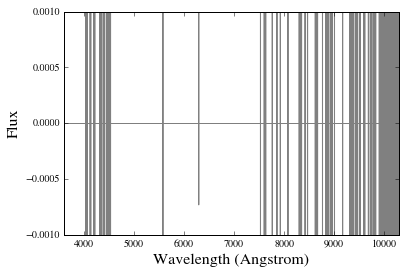

Using spec-4190-55686-0370.fits.gz for BOSSJ1635+2547
S/N 4.09938510832 1 / Angstrom


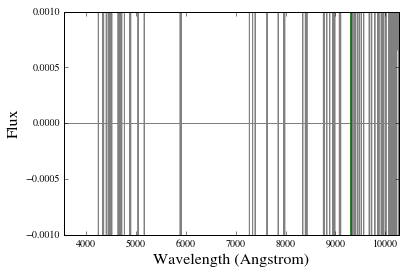

Using spec-5196-55831-0964.fits.gz for BOSSJ1651+3410
S/N 3.36748653467 1 / Angstrom


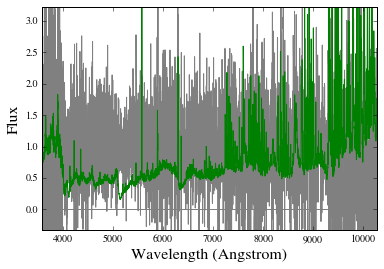

Using /u/xavier/Dropbox//QSOPairs/data/MODS_redux//./SDSSJ165716.52+310524.5_b_F.fits.gz for BOSSJ1657+3105
S/N 22.2855304955 1 / Angstrom


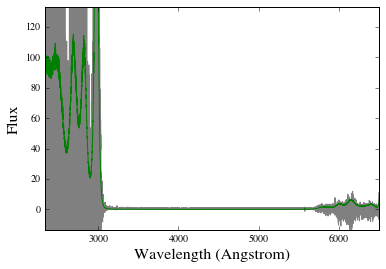

Using spSpec-52443-0983-122.fit.gz for BOSSJ2053-0104
S/N 1.58992257653 1 / Angstrom


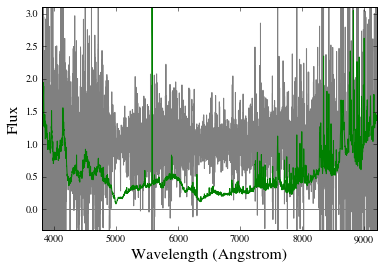

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ214620.98-075303.8_F.fits.gz for APOJ2146-0753
S/N 45.2887015656 1 / Angstrom


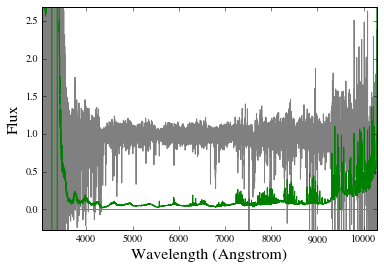

Using spec-4197-55479-0034.fits.gz for BOSSJ2156-0003
S/N 0.24021252098 1 / Angstrom


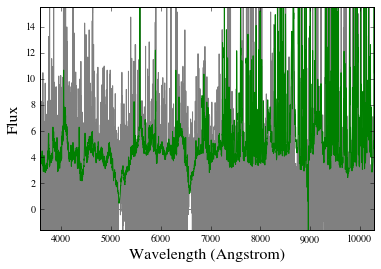

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ220248.31+123656.3.fits for BOSSJ2202+1236
S/N 7.00369061924 1 / Angstrom


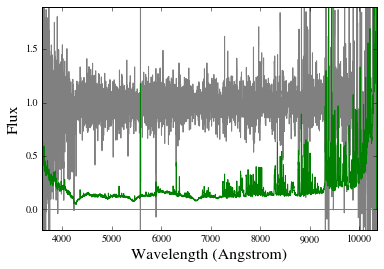

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ221226.36-001150.9.fits for BOSSJ2212-0011
S/N 2.73102795026 1 / Angstrom


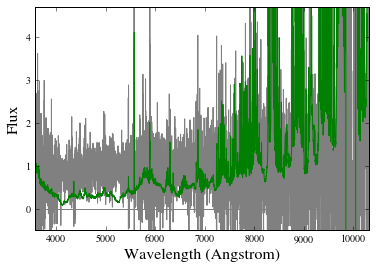

Using spec-4206-55471-0936.fits.gz for BOSSJ2255-0001
S/N 8.96133909541 1 / Angstrom


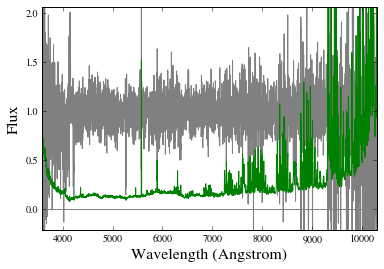

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ225549.55-000927.7.fits for BOSSJ2255-0009
S/N 8.3559972113 1 / Angstrom


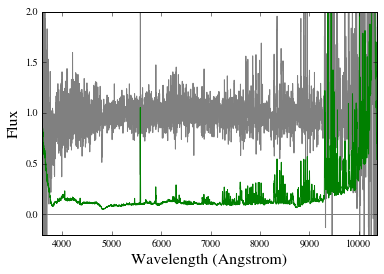

Using spec-4209-55478-0164.fits.gz for BOSSJ2314-0108
S/N 0.0 1 / Angstrom


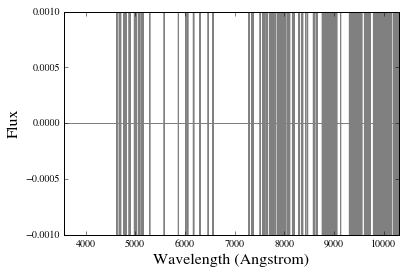

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ233845.45-000331.8.fits for BOSSJ2338-0003
S/N 6.5900547353 1 / Angstrom


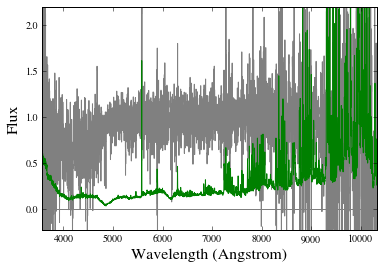

Using spec-4213-55449-0215.fits.gz for BOSSJ2341-0041
S/N 1.62725003624 1 / Angstrom


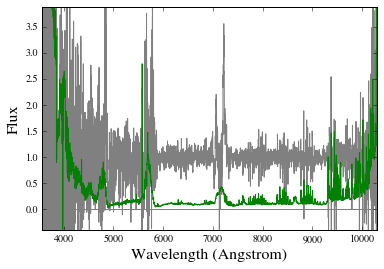

Using spec-4214-55451-0870.fits.gz for BOSSJ2348+0110
S/N 0.733243910262 1 / Angstrom


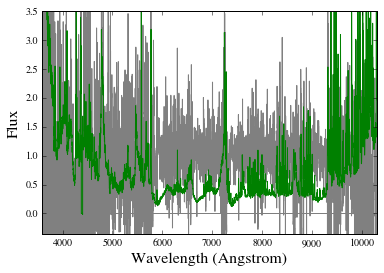

Using spec-4215-55471-0347.fits.gz for BOSSJ2352-0015
S/N 0.703564355027 1 / Angstrom


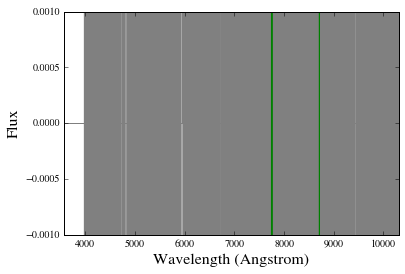

Using spec-4215-55471-0240.fits.gz for BOSSJ2354-0019
S/N 0.683149742013 1 / Angstrom


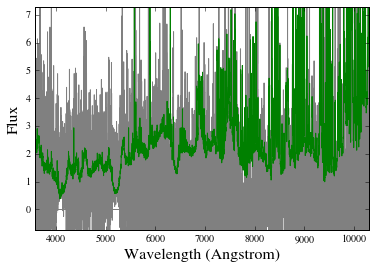

In [25]:
qpq9 = eqpq.QPQ('QPQ9')
qpq9.cull(1548.195*u.AA,0)
zfg = qpq9._fulldata['Z_FG']
bad = np.where((zfg < 1.6) | (zfg > 9999))[0]
qpq9.mask[bad] = False
stack_tup0 = qpqk.load_stack_img(qpq9.data,1548.195*u.AA,vmnx=(-1500., 1500.)*u.km/u.s,
                                 spec_dv=25.*u.km/u.s,high_res=0,stack_sig=True,chk_conti=False)
# Mask
fin_velo, stck_img, stck_sig, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
    if (('J0853' in dd['qpq']['NAME']) | ('J0932+0925' in dd['qpq']['NAME']) | ('J1039' in dd['qpq']['NAME']) | 
        ('J1144' in dd['qpq']['NAME']) | ('J1145' in dd['qpq']['NAME']) | ('J1204' in dd['qpq']['NAME']) | 
        ('J1420+1603' in dd['qpq']['NAME']) | ('J1427' in dd['qpq']['NAME']) | ('J1553' in dd['qpq']['NAME']) | 
        ('J1627+4606' in dd['qpq']['NAME'])):
        pass
    else:
        idx_mask.append(ii) 
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [26]:
np.sum(stck_mskN,0)

array([ 10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,
        10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,
        10.,  10.,  10.,  10.,  10.,  10.,   9.,   9.,   9.,   9.,   9.,
        10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,
        10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,
        10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,
        10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,
        10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,
        10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,
        10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,
        10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.,  10.])

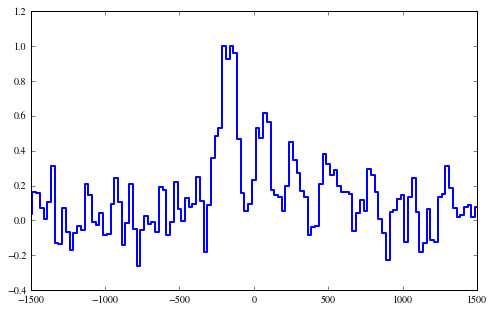

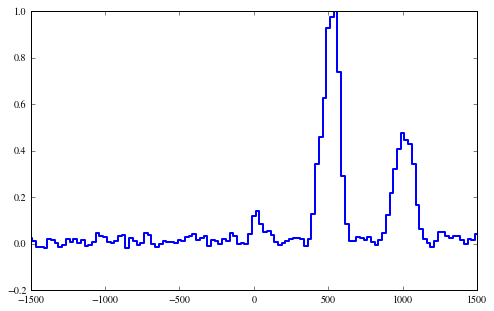

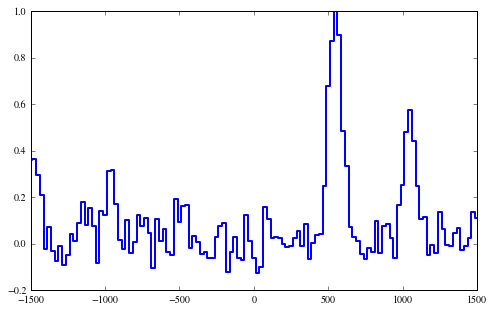

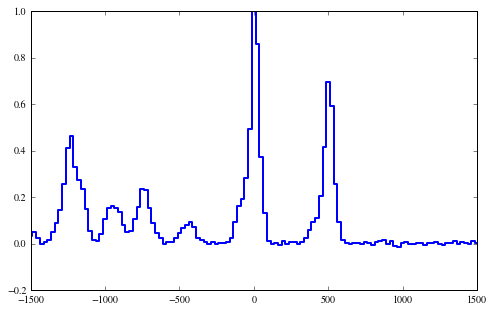

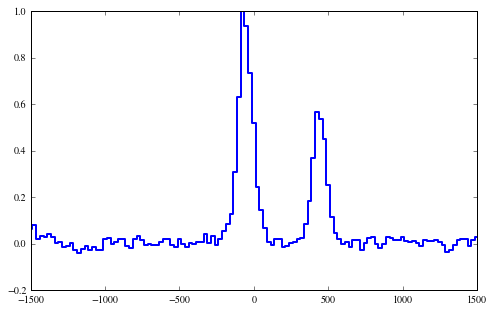

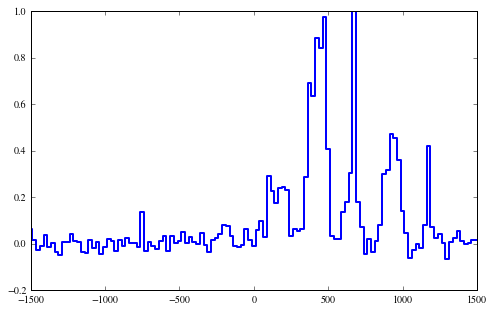

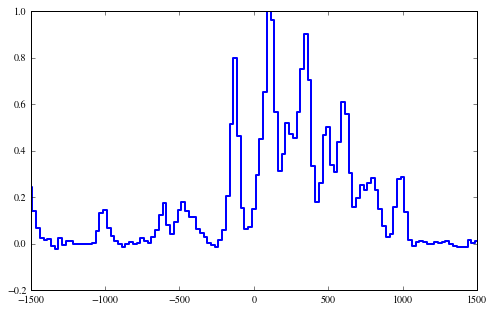

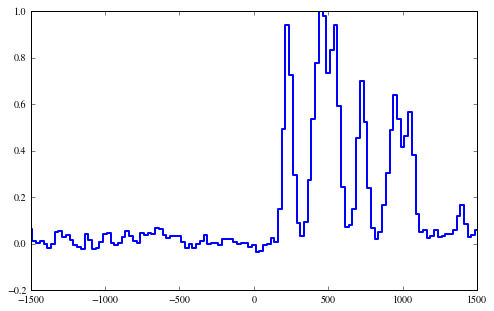

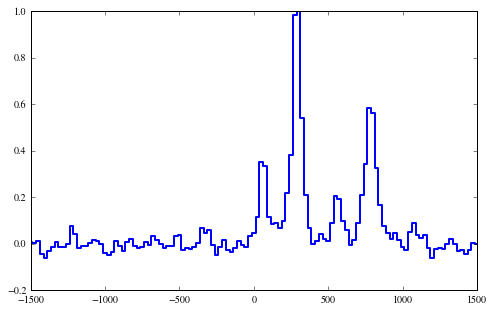

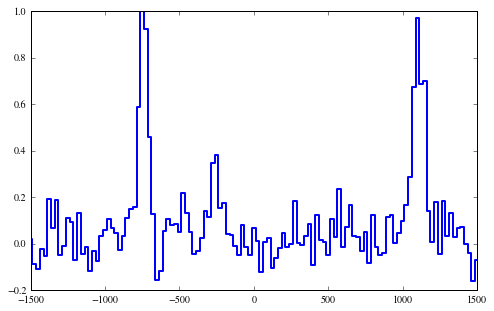

In [27]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
avg_tau = np.zeros(len(stck_img[ii,:]))
for ii,img in enumerate(stck_img):
    if np.sum(stck_mskN[ii,:]) != 0:
        tau = np.log(1./(img))
        sat_pix = np.where(img < stck_sig[ii,:]/2)[0]
        tau[sat_pix] = np.log(1./(stck_sig[ii,:][sat_pix]/2.))
        tau = tau/np.max(tau)
        plt.figure(figsize=(8,5))
        plt.plot(fin_velo.value,tau,drawstyle='steps-mid',linewidth=2.)
        avg_tau += tau
avg_tau = avg_tau/np.sum(stck_mskN,0)

Centroid velocity in km/s =  Parameter('mean_1', value=269.081366502)
tau-weighted centroid and dispersion in km/s =  263.03163529 479.533514314


<CompoundModel6(amplitude_0=1.0, amplitude_1=0.1899693476239911, mean_1=269.0813665019606, stddev_1=382.2962965682809, amplitude_2=0.09498467381199555, mean_2=767.0813665019606, stddev_2=382.2962965682809)>

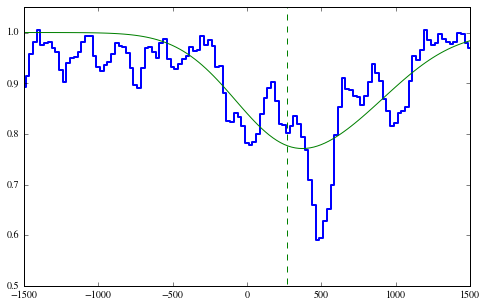

In [29]:
g_1548_init = models.GaussianAbsorption1D(amplitude=0.1,mean=243.,stddev=500.)
g_1550_init = models.GaussianAbsorption1D(amplitude=0.05,mean=243.+498.,stddev=500.)
#c_init = models.Const1D(amplitude=0.98)
c_init = models.Const1D(amplitude=1.)
model_init = c_init*(g_1548_init*g_1550_init)
model_init.amplitude_0.fixed = True
def tie_amplitude2(model):
    amplitude_2 = model.amplitude_1*0.5
    return amplitude_2
def tie_mean2(model):
    mean_2 = model.mean_1 + 498.
    return mean_2
def tie_stddev2(model):
    stddev_2 = model.stddev_1 
    return stddev_2
#model_init.amplitude_2.bounds = [0.1157/2,0.2814]
model_init.amplitude_2.tied = tie_amplitude2
model_init.mean_2.tied = tie_mean2
model_init.stddev_2.tied = tie_stddev2
fit = fitting.LevMarLSQFitter()
model_final = fit(model_init,fin_velo.value,fin_flx)
plt.figure(figsize=(8,5))
plt.plot(fin_velo.value,fin_flx,drawstyle='steps-mid',linewidth=2.)
plt.plot(fin_velo.value,model_final(fin_velo.value), label='Gaussian')
plt.plot([model_final.mean_1.value,model_final.mean_1.value],[0,2],'g--')
plt.axis([-1500,1500,0.5,1.05])
print('Centroid velocity in km/s = ',model_final.mean_1)
# tau-weighted centroid
#cranges = [(-3000.,-1300.)*u.km/u.s,(1300.,3000.)*u.km/u.s]
#pix = np.where( (fin_velo >= cranges[0][0]) & (fin_velo <= cranges[0][1]) | 
#               (fin_velo >= cranges[1][0]) & (fin_velo <= cranges[1][1]))[0]
#fit = np.polyfit(fin_velo[pix].value,fin_flx[pix], 0)
#pv = np.poly1d(fit)
#conti = pv(fin_velo.value)
#tau = np.log(1./(fin_flx/conti))
tau = np.log(1./(fin_flx/model_final.amplitude_0))
start = np.int((len(fin_velo)-1)*1./6.)-1
end = np.int((len(fin_velo)-1)*5./6.)+1
tau_cen = np.sum(fin_velo.value[start:end+1]*tau[start:end+1])/np.sum(tau[start:end+1])
tau[np.where(tau < 0)] = 0.
tau_disp = np.sqrt(np.abs(np.sum(np.square(fin_velo.value[start:end+1]-tau_cen)*tau[start:end+1])/np.sum(tau[start:end+1])))
print('tau-weighted centroid and dispersion in km/s = ',tau_cen,tau_disp)
model_final


0.456699997821


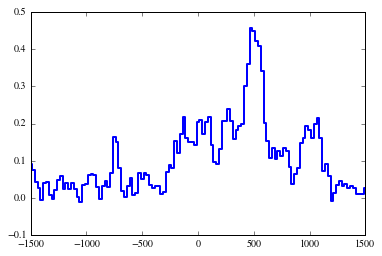

In [32]:
plt.plot(fin_velo.value,avg_tau,drawstyle='steps-mid',linewidth=2.)
plt.axis([-1500,1500,-0.1,0.5])
print(np.max(avg_tau))

## Try lowering S/N cut for MgII stack 

Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits
No spectrum found for BOSSJ0001+0000 and wvobs=8359.87 Angstrom!
No spectrum found for BOSSJ0008-0039 and wvobs=7306.58 Angstrom!
No spectrum found for BOSSJ0008-0039 and wvobs=8215.92 Angstrom!
No spectrum found for BOSSJ0042+1350 and wvobs=7762.94 Angstrom!
Using spec-6203-56266-0300.fits.gz for BOSSJ0047+1447
S/N 10.2401891376 1 / Angstrom


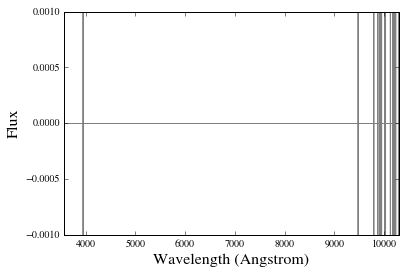

No spectrum found for BOSSJ0057-0001 and wvobs=8838.87 Angstrom!
No spectrum found for BOSSJ0103-0002 and wvobs=7700.43 Angstrom!
No spectrum found for BOSSJ0106+0056 and wvobs=8020.8 Angstrom!
No spectrum found for SDSSJ0111+1402 and wvobs=9745.68 Angstrom!
No spectrum found for SDSSJ0149-0021 and wvobs=7500.52 Angstrom!
No spectrum found for BOSSJ0154+0020 and wvobs=7755.5 Angstrom!
No spectrum found for BOSSJ0206+2238 and wvobs=7280.2 Angstrom!
No spectrum found for BOSSJ0214-0052 and wvobs=7835.16 Angstrom!
No spectrum found for BOSSJ0224-0046 and wvobs=7538.73 Angstrom!
No spectrum found for BOSSJ0230-0333 and wvobs=9452.35 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ023946.44-010644.1_F.fits.gz
No spectrum found for BOSSJ0239-0106 and wvobs=9224.55 Angstrom!
No spectrum found for BOSSJ0242-0046 and wvobs=7746.73 Angstrom!
No spectrum found for BOSSJ0250-0047 and wvobs=7976.1 Angstrom!
No spectrum found for BOSSJ0334-0058 and wvobs=7338.55 Angstrom!


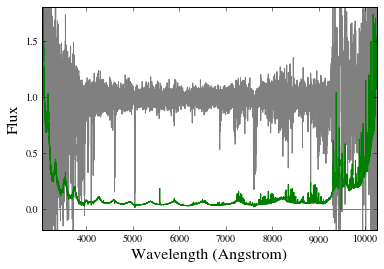

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ040954.21-041137.1_F.fits.gz for SDSSJ0409-0411
S/N 44.0551048259 1 / Angstrom


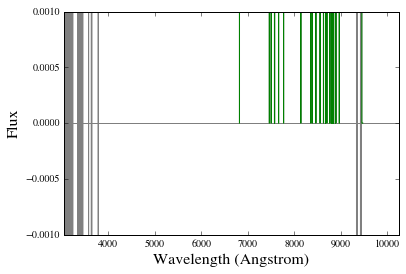

No spectrum found for BOSSJ0749+3702 and wvobs=8266.9 Angstrom!
No spectrum found for SDSSJ0752+4011 and wvobs=8062.43 Angstrom!
No spectrum found for APOJ0800+3542 and wvobs=8339.59 Angstrom!
No spectrum found for BOSSJ0809+4539 and wvobs=8504.22 Angstrom!
No spectrum found for BOSSJ0812+2620 and wvobs=7391.17 Angstrom!
No spectrum found for BOSSJ0814+0402 and wvobs=7730.43 Angstrom!
No spectrum found for BOSSJ0818+1527 and wvobs=7706.87 Angstrom!
No spectrum found for BOSSJ0818+1232 and wvobs=7554.39 Angstrom!
No spectrum found for BOSSJ0826+4708 and wvobs=7826.19 Angstrom!
No spectrum found for SDSSJ0828+4545 and wvobs=8030.56 Angstrom!
No spectrum found for BOSSJ0830+5452 and wvobs=7471.48 Angstrom!
No spectrum found for BOSSJ0833+4823 and wvobs=7272.9 Angstrom!
No spectrum found for BOSSJ0837+0810 and wvobs=8296.52 Angstrom!
No spectrum found for APOJ0837+3630 and wvobs=7928.15 Angstrom!
No spectrum found for APOJ0837+3837 and wvobs=8563.61 Angstrom!
No spectrum found for BOSSJ083

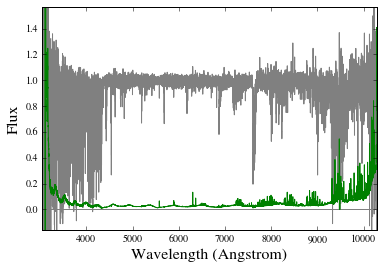

No spectrum found for BOSSJ0856+5514 and wvobs=7330.08 Angstrom!
No spectrum found for BOSSJ0857+3901 and wvobs=8258.74 Angstrom!
No spectrum found for BOSSJ0902+3602 and wvobs=7720.21 Angstrom!
No spectrum found for BOSSJ0903+5133 and wvobs=8020.18 Angstrom!
No spectrum found for BOSSJ0904+0042 and wvobs=7320.9 Angstrom!
No spectrum found for BOSSJ0906+1001 and wvobs=7543.03 Angstrom!
No spectrum found for BOSSJ0907+2802 and wvobs=7704.3 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ091046.69+041448.4_F.fits.gz for APOJ0910+0414
S/N 26.7515845542 1 / Angstrom


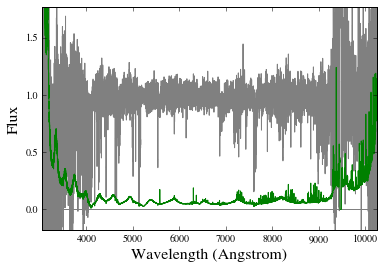

No spectrum found for BOSSJ0911+4905 and wvobs=7811.53 Angstrom!
No spectrum found for BOSSJ0912+4139 and wvobs=7765.52 Angstrom!
No spectrum found for BOSSJ0912+2518 and wvobs=7415.93 Angstrom!
Using spec-5809-56353-0052.fits.gz for BOSSJ0912+3056
S/N 16.4793636553 1 / Angstrom


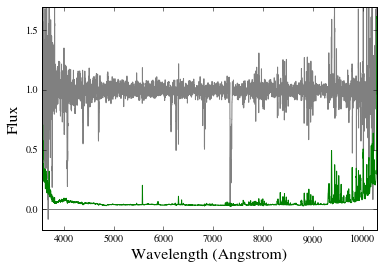

Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ091338.97-010704.6_F.fits.gz for BOSSJ0913-0107
S/N 36.2045833385 1 / Angstrom


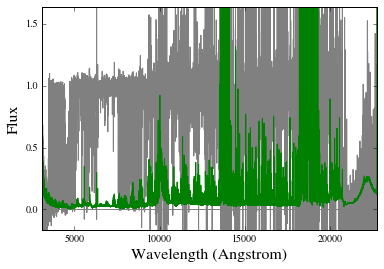

No spectrum found for BOSSJ0913+3151 and wvobs=7533.3 Angstrom!
No spectrum found for BOSSJ0914+0109 and wvobs=8781.11 Angstrom!
No spectrum found for BOSSJ0915+0119 and wvobs=8308.95 Angstrom!
No spectrum found for BOSSJ0916+4250 and wvobs=7660.49 Angstrom!
No spectrum found for BOSSJ0920+3340 and wvobs=7644.43 Angstrom!
No spectrum found for APOJ0924+3929 and wvobs=8068.09 Angstrom!
No spectrum found for BOSSJ0932+0843 and wvobs=7721.14 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ093225.60+092500.2_F.fits.gz for APOJ0932+0925
S/N 15.5986877946 1 / Angstrom


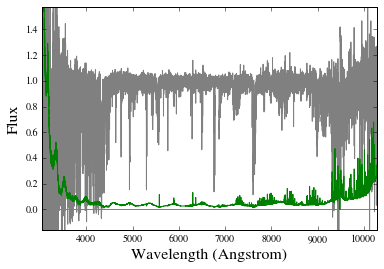

No spectrum found for BOSSJ0933+5920 and wvobs=7992.61 Angstrom!
No spectrum found for BOSSJ0935+4532 and wvobs=8647.46 Angstrom!
No spectrum found for BOSSJ0936-0058 and wvobs=8971.95 Angstrom!
No spectrum found for APOJ0938+5317 and wvobs=8576.49 Angstrom!
No spectrum found for BOSSJ0940+3345 and wvobs=7789.14 Angstrom!
No spectrum found for BOSSJ0941+2308 and wvobs=7754.32 Angstrom!
No spectrum found for BOSSJ0942+1347 and wvobs=7553.54 Angstrom!
No spectrum found for BOSSJ0956+0248 and wvobs=8430.84 Angstrom!
No spectrum found for BOSSJ1000+0337 and wvobs=7547.97 Angstrom!
No spectrum found for BOSSJ1001+4023 and wvobs=7907.67 Angstrom!
No spectrum found for BOSSJ1002+0020 and wvobs=8883.44 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ100507.08+501929.6.fits.gz for SDSSJ1005+5019
S/N 6.52941856034 1 / Angstrom


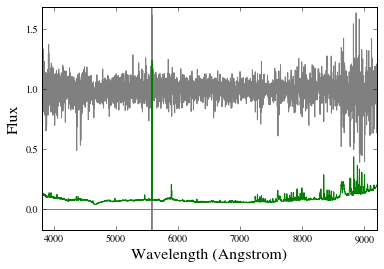

No spectrum found for BOSSJ1006+4804 and wvobs=9236.78 Angstrom!
No spectrum found for BOSSJ1009+1749 and wvobs=8344.39 Angstrom!
No spectrum found for BOSSJ1009+0236 and wvobs=7650.85 Angstrom!
No spectrum found for APOJ1009+2500 and wvobs=8022.84 Angstrom!
No spectrum found for BOSSJ1010+4037 and wvobs=8926.94 Angstrom!
No spectrum found for BOSSJ1010+4517 and wvobs=7788.56 Angstrom!
No spectrum found for BOSSJ1010+0821 and wvobs=8030.54 Angstrom!
No spectrum found for BOSSJ1013+0330 and wvobs=8227.58 Angstrom!
No spectrum found for BOSSJ1014+2653 and wvobs=7629.92 Angstrom!
No spectrum found for BOSSJ1015+1245 and wvobs=7499.5 Angstrom!
No spectrum found for BOSSJ1017+6226 and wvobs=7418.7 Angstrom!
No spectrum found for BOSSJ1020+6119 and wvobs=7796.69 Angstrom!
No spectrum found for BOSSJ1024+0354 and wvobs=7461.87 Angstrom!
Using spec-6463-56340-0210.fits.gz for BOSSJ1024+2616
S/N 6.18168413014 1 / Angstrom


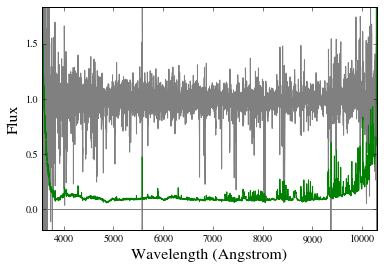

No spectrum found for APOJ1026+4614 and wvobs=12165.5 Angstrom!
No spectrum found for BOSSJ1028+5121 and wvobs=7468.07 Angstrom!
No spectrum found for BOSSJ1034+0856 and wvobs=7375.17 Angstrom!
No spectrum found for BOSSJ1036+5012 and wvobs=8396.78 Angstrom!
No spectrum found for BOSSJ1039+5026 and wvobs=11555.2 Angstrom!
No spectrum found for APOJ1041+1957 and wvobs=7959.85 Angstrom!
No spectrum found for BOSSJ1042+6459 and wvobs=8351.16 Angstrom!
No spectrum found for BOSSJ1044+3139 and wvobs=7568.46 Angstrom!
No spectrum found for APOJ1045+4351 and wvobs=9586.7 Angstrom!
No spectrum found for BOSSJ1045+1000 and wvobs=8447.16 Angstrom!
No spectrum found for BOSSJ1052+5553 and wvobs=8375.3 Angstrom!
No spectrum found for BOSSJ1059+6255 and wvobs=7671.11 Angstrom!
Using spec-6693-56384-0164.fits.gz for BOSSJ1106+4635
S/N 10.8815825437 1 / Angstrom


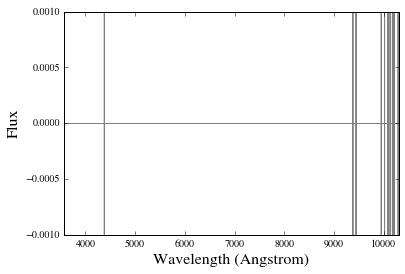

No spectrum found for BOSSJ1113+3305 and wvobs=8087.98 Angstrom!
No spectrum found for BOSSJ1118+4025 and wvobs=8174.42 Angstrom!
No spectrum found for BOSSJ1136-0029 and wvobs=7301.72 Angstrom!
No spectrum found for BOSSJ1138+6329 and wvobs=8065.77 Angstrom!
No spectrum found for BOSSJ1140+2709 and wvobs=7602.13 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114145.43+072423.3_b400_F.fits.gz
No spectrum found for APOJ1141+0724 and wvobs=12725.9 Angstrom!
No spectrum found for BOSSJ1142+2822 and wvobs=7549.73 Angstrom!
No spectrum found for BOSSJ1142+1128 and wvobs=7301.66 Angstrom!
No spectrum found for BOSSJ1144+0959 and wvobs=11110.1 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ114546.22+032251.9_F.fits.gz for BOSSJ1145+0322
S/N 51.7294399516 1 / Angstrom


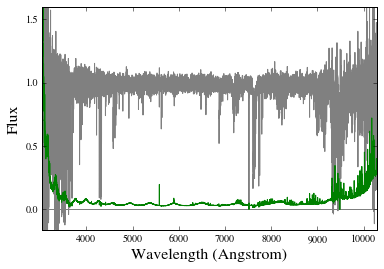

No spectrum found for BOSSJ1150+5802 and wvobs=7666.46 Angstrom!
Using spec-5383-56013-0218.fits.gz for BOSSJ1152+1507
S/N 6.87088787863 1 / Angstrom


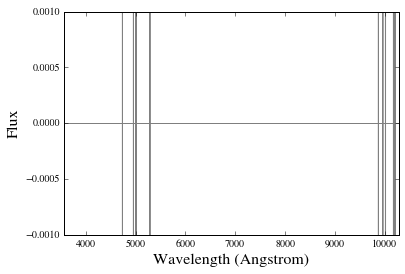

Using spec-4697-55660-0326.fits.gz for BOSSJ1155+3934
S/N 5.51243918821 1 / Angstrom


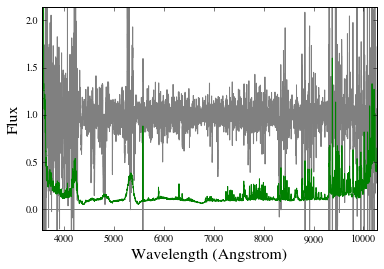

No spectrum found for BOSSJ1159+1433 and wvobs=7578.51 Angstrom!
No spectrum found for BOSSJ1200+0129 and wvobs=8506.2 Angstrom!
No spectrum found for BOSSJ1202+0747 and wvobs=7443.04 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ120416.69+022111.0_b1200_F.fits.gz
No continuum: /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz
Using conti=1 for HIRES
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120416.69+022111.0_F.fits.gz for BOSSJ1204+0221
S/N 10.9859192226 1 / Angstrom


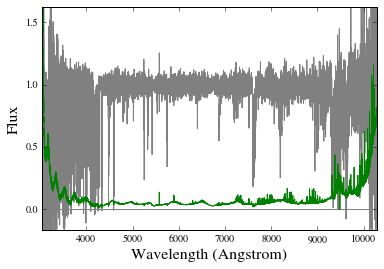

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120857.16+073727.3_F.fits.gz for APOJ1208+0737
S/N 10.7536360531 1 / Angstrom


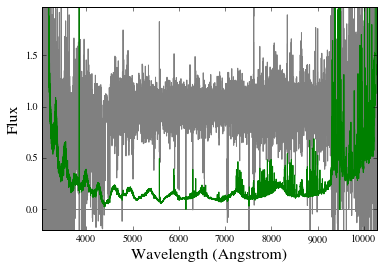

No spectrum found for BOSSJ1212+3240 and wvobs=8335.29 Angstrom!
No spectrum found for BOSSJ1213+4719 and wvobs=7919.04 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ121558.80+571555.4.fits.gz for BOSSJ1215+5715
S/N 9.0646628842 1 / Angstrom


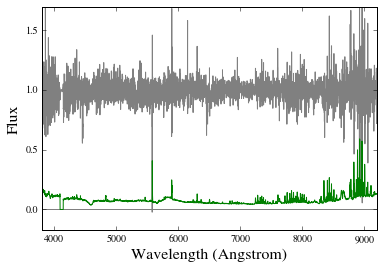

No spectrum found for BOSSJ1225+5709 and wvobs=8101.33 Angstrom!
No spectrum found for BOSSJ1231+0029 and wvobs=11748 Angstrom!
No spectrum found for BOSSJ1239+3955 and wvobs=7946.35 Angstrom!
No spectrum found for BOSSJ1242+5331 and wvobs=7598.52 Angstrom!
No spectrum found for BOSSJ1244+3916 and wvobs=8381.61 Angstrom!
No spectrum found for BOSSJ1244+3208 and wvobs=8363.89 Angstrom!
No spectrum found for BOSSJ1245+5922 and wvobs=8153.23 Angstrom!
No spectrum found for BOSSJ1246+2345 and wvobs=8373.27 Angstrom!
Using spec-4703-55617-0350.fits.gz for BOSSJ1248+4058
S/N 5.87116767045 1 / Angstrom


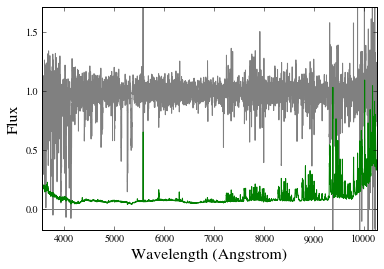

No spectrum found for BOSSJ1253+6327 and wvobs=8298.17 Angstrom!
No spectrum found for BOSSJ1255+2234 and wvobs=7875.36 Angstrom!
No spectrum found for SDSSJ1301+4759 and wvobs=8931.42 Angstrom!
No spectrum found for APOJ1306+6158 and wvobs=8693.68 Angstrom!
No spectrum found for BOSSJ1310+1134 and wvobs=8158.93 Angstrom!
No spectrum found for BOSSJ1319+2138 and wvobs=7723.46 Angstrom!
No spectrum found for BOSSJ1325+5409 and wvobs=8518.69 Angstrom!
No spectrum found for APOJ1327+3423 and wvobs=7406.06 Angstrom!
No spectrum found for BOSSJ1335+4330 and wvobs=8353.65 Angstrom!
No spectrum found for BOSSJ1346+1952 and wvobs=8577.76 Angstrom!
No spectrum found for BOSSJ1356+6133 and wvobs=8454.58 Angstrom!
No spectrum found for APOJ1358+2737 and wvobs=8108.32 Angstrom!
No spectrum found for BOSSJ1402+4701 and wvobs=8153.94 Angstrom!
No spectrum found for BOSSJ1410+4804 and wvobs=7788.69 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ141337.96+271511.0.fits for SDSSJ1413

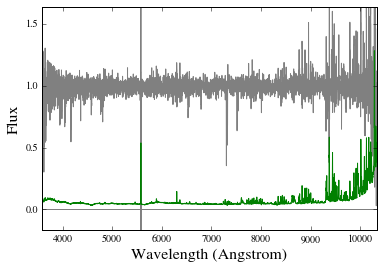

No spectrum found for BOSSJ1420+0227 and wvobs=12909.8 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142054.92+160342.9_F.fits.gz for APOJ1420+1603
S/N 34.7418613707 1 / Angstrom


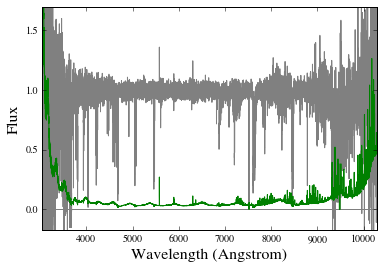

No spectrum found for BOSSJ1422+4652 and wvobs=7681.55 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ142758.74-012136.2_b1200_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142758.74-012136.2_F.fits.gz for BOSSJ1427-0121
S/N 35.6455711808 1 / Angstrom


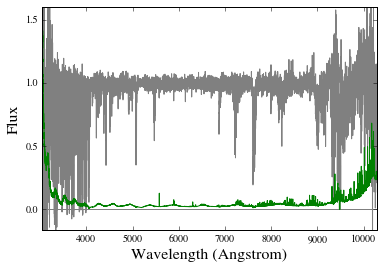

No spectrum found for BOSSJ1428+5509 and wvobs=7739.01 Angstrom!
No spectrum found for APOJ1431+5727 and wvobs=7491.53 Angstrom!
No spectrum found for BOSSJ1433+0827 and wvobs=8055.24 Angstrom!
No spectrum found for BOSSJ1433+0641 and wvobs=9210.41 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ144231.91+013734.8.fits for BOSSJ1442+0137
S/N 8.76419878037 1 / Angstrom


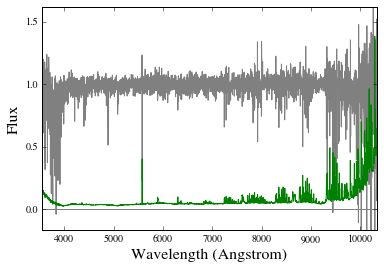

No spectrum found for BOSSJ1448+5649 and wvobs=7859.53 Angstrom!
No spectrum found for BOSSJ1457+0237 and wvobs=7854.9 Angstrom!
No spectrum found for BOSSJ1508+3635 and wvobs=7964.3 Angstrom!
No spectrum found for BOSSJ1515+2627 and wvobs=8201.42 Angstrom!
No spectrum found for BOSSJ1517+2002 and wvobs=7599.35 Angstrom!
No spectrum found for BOSSJ1530+2515 and wvobs=7812.69 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ153329.17+142537.8.fits for BOSSJ1533+1425
S/N 5.65945699302 1 / Angstrom


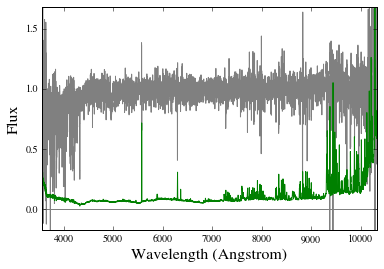

No spectrum found for BOSSJ1534+2153 and wvobs=7463.36 Angstrom!
No spectrum found for BOSSJ1538+5707 and wvobs=8195.92 Angstrom!
No spectrum found for BOSSJ1539+3146 and wvobs=8021.79 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ155325.89+192137.7_F.fits.gz for APOJ1553+1921
S/N 28.2784594603 1 / Angstrom


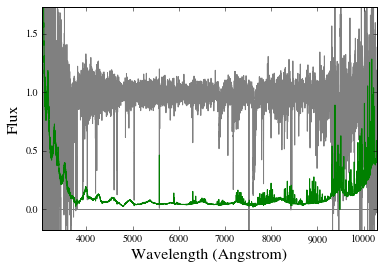

No spectrum found for BOSSJ1554+1244 and wvobs=7874.64 Angstrom!
No spectrum found for BOSSJ1556+3040 and wvobs=8418.31 Angstrom!
No spectrum found for BOSSJ1557+0434 and wvobs=7999.19 Angstrom!
No spectrum found for APOJ1559+4943 and wvobs=7998.35 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ160546.67+511323.0.fits for BOSSJ1605+5113
S/N 11.398281721 1 / Angstrom


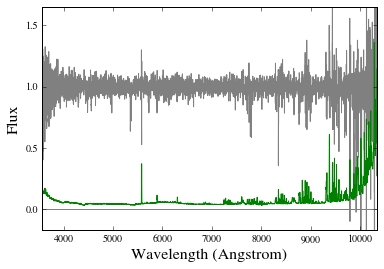

No spectrum found for BOSSJ1618+1842 and wvobs=8523.49 Angstrom!
No spectrum found for BOSSJ1619+1926 and wvobs=7777.76 Angstrom!
No spectrum found for BOSSJ1627+2215 and wvobs=11897.1 Angstrom!
No spectrum found for APOJ1627+4606 and wvobs=13463.2 Angstrom!
No spectrum found for BOSSJ1628+2342 and wvobs=7607.08 Angstrom!
No spectrum found for BOSSJ1631+4333 and wvobs=8435.48 Angstrom!
No spectrum found for BOSSJ1631+3659 and wvobs=7381.25 Angstrom!
No spectrum found for BOSSJ1635+2547 and wvobs=8023.04 Angstrom!
No spectrum found for BOSSJ1651+3410 and wvobs=7463.03 Angstrom!
No spectrum found for BOSSJ1657+3105 and wvobs=8757.58 Angstrom!
No spectrum found for BOSSJ2053-0104 and wvobs=8426.08 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ214620.98-075303.8_F.fits.gz for APOJ2146-0753
S/N 19.0978714623 1 / Angstrom


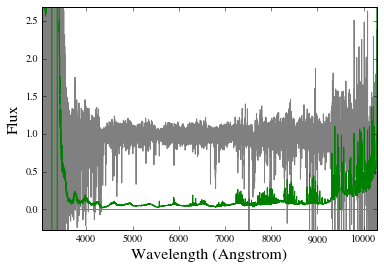

No spectrum found for BOSSJ2156-0003 and wvobs=7490.9 Angstrom!
No spectrum found for BOSSJ2202+1236 and wvobs=8583.38 Angstrom!
No spectrum found for BOSSJ2212-0011 and wvobs=8337.09 Angstrom!
No spectrum found for BOSSJ2255-0001 and wvobs=7640.11 Angstrom!
No spectrum found for BOSSJ2255-0009 and wvobs=8417.3 Angstrom!
No spectrum found for BOSSJ2314-0108 and wvobs=7400.53 Angstrom!
No spectrum found for BOSSJ2338-0003 and wvobs=9618.54 Angstrom!
No spectrum found for BOSSJ2341-0041 and wvobs=7637.36 Angstrom!
No spectrum found for BOSSJ2348+0110 and wvobs=7534.78 Angstrom!
No spectrum found for BOSSJ2352-0015 and wvobs=7627.15 Angstrom!
No spectrum found for BOSSJ2354-0019 and wvobs=7700.92 Angstrom!


In [270]:
stack_tup0 = qpq9k.qpq9_IRMgII(passback=True,wrest=2796.352*u.AA,S2N_cut=5.5/u.AA,zfg_mnx=(1.6,9999))
fin_velo, stck_img, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
    if 'J0822+1319' in dd['qpq']['NAME']: #BAL
        idx_mask.append(ii) 
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [209]:
np.sum(stck_mskN,0)

array([ 26.,  26.,  25.,  25.,  25.,  25.,  25.,  25.,  25.,  25.,  25.,
        25.,  26.,  26.,  26.,  26.,  25.,  25.,  25.,  25.,  25.,  24.,
        24.,  24.,  24.,  24.,  25.,  25.,  26.,  26.,  26.,  26.,  26.,
        26.,  26.,  26.,  26.,  26.,  26.,  26.,  26.,  26.,  26.,  26.,
        26.,  26.,  26.,  26.,  26.,  26.,  26.,  26.,  26.,  26.,  26.,
        26.,  25.,  25.,  25.,  25.,  25.])

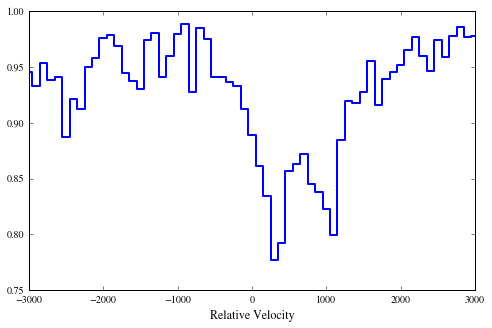

In [271]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)

/Users/lwymarie/python/specdb/specdb/query_catalog.py:140: UserWarning: No sources found at your coordinate within tol=0.5 arcsec.  Returning None
  warnings.warn("No sources found at your coordinate within tol={:g}.  Returning None".format(tol))
/Users/lwymarie/python/linetools/linetools/spectra/xspectrum1d.py:295: UserWarning: No unit given to wavelength, assuming Angstroms.
  warnings.warn("No unit given to wavelength, assuming Angstroms.")


Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits
No spectrum found for BOSSJ0001+0000 and wvobs=8359.87 Angstrom!
No spectrum found for BOSSJ0008-0039 and wvobs=7306.58 Angstrom!
No spectrum found for BOSSJ0008-0039 and wvobs=8215.92 Angstrom!
No spectrum found for BOSSJ0042+1350 and wvobs=7762.94 Angstrom!
Using spec-6203-56266-0300.fits.gz for BOSSJ0047+1447
S/N 10.2401891376 1 / Angstrom


/Users/lwymarie/anaconda/lib/python2.7/site-packages/astropy/units/quantity.py:850: RuntimeWarning: divide by zero encountered in true_divide
  return super(Quantity, self).__itruediv__(other)
/Users/lwymarie/anaconda/lib/python2.7/site-packages/astropy/units/quantity.py:850: RuntimeWarning: invalid value encountered in true_divide
  return super(Quantity, self).__itruediv__(other)
/Users/lwymarie/python/linetools/linetools/spectra/xspectrum1d.py:269: RuntimeWarning: invalid value encountered in greater
  gdsigval = np.where(self.data['sig'][kk].data > 0.)[0]
/Users/lwymarie/python/linetools/linetools/spectra/xspectrum1d.py:270: RuntimeWarning: invalid value encountered in less_equal
  badsigval = self.data['sig'][kk].data <= 0.


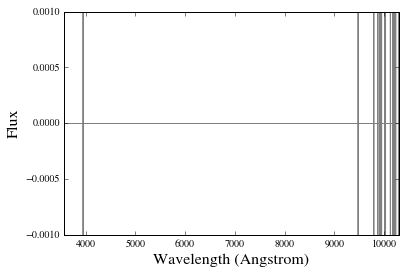

/Users/lwymarie/python/linetools/linetools/spectra/xspectrum1d.py:807: UserWarning: Ignoring NAN and inf in flux
  warnings.warn("Ignoring NAN and inf in flux")
/Users/lwymarie/python/linetools/linetools/spectra/xspectrum1d.py:879: RuntimeWarning: invalid value encountered in less_equal
  bad = np.where(self.sig.value <= 0.)[0]
/Users/lwymarie/python/specdb/specdb/query_catalog.py:145: UserWarning: Found multiple sources in the catalog. Taking the closest one
  warnings.warn("Found multiple sources in the catalog. Taking the closest one")


No spectrum found for BOSSJ0057-0001 and wvobs=8838.87 Angstrom!
Does not survive atmosphere cut
No spectrum found for BOSSJ0103-0002 and wvobs=7700.43 Angstrom!
No spectrum found for BOSSJ0106+0056 and wvobs=8020.8 Angstrom!
No spectrum found for SDSSJ0111+1402 and wvobs=9745.68 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ014917.46-002158.4.fits.gz for SDSSJ0149-0021
S/N 3.71362359528 1 / Angstrom


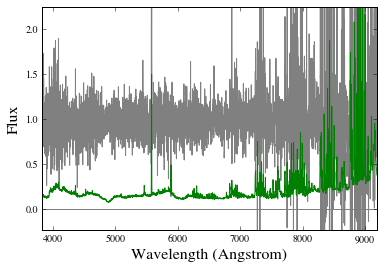

No spectrum found for BOSSJ0154+0020 and wvobs=7755.5 Angstrom!
No spectrum found for BOSSJ0206+2238 and wvobs=7280.2 Angstrom!
No spectrum found for BOSSJ0214-0052 and wvobs=7835.16 Angstrom!
No spectrum found for BOSSJ0224-0046 and wvobs=7538.73 Angstrom!
No spectrum found for BOSSJ0230-0333 and wvobs=9452.35 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ023946.44-010644.1_F.fits.gz
No spectrum found for BOSSJ0239-0106 and wvobs=9224.55 Angstrom!
No spectrum found for BOSSJ0242-0046 and wvobs=7746.73 Angstrom!
No spectrum found for BOSSJ0250-0047 and wvobs=7976.1 Angstrom!
No spectrum found for BOSSJ0334-0058 and wvobs=7338.55 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ034139.19-000012.7_F.fits.gz for SDSSJ0341-0000
S/N 25.9066978318 1 / Angstrom


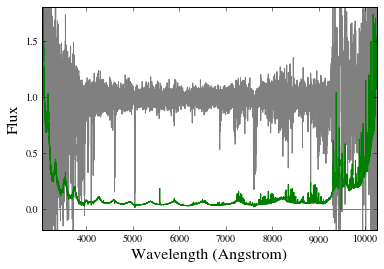

Does not survive atmosphere cut
No spectrum found for SDSSJ0409-0411 and wvobs=7593.49 Angstrom!
No spectrum found for BOSSJ0749+3702 and wvobs=8266.9 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ075259.14+401118.4.fits.gz for SDSSJ0752+4011
S/N 3.04206123108 1 / Angstrom


/Users/lwymarie/anaconda/lib/python2.7/site-packages/astropy/units/quantity.py:858: RuntimeWarning: divide by zero encountered in true_divide
  return super(Quantity, self).__rtruediv__(other)


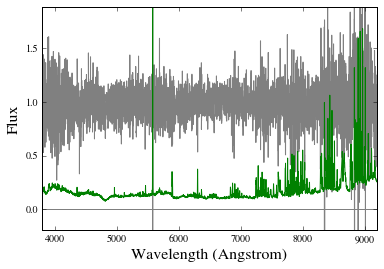

No spectrum found for APOJ0800+3542 and wvobs=8339.59 Angstrom!
No spectrum found for BOSSJ0809+4539 and wvobs=8504.22 Angstrom!
Using spec-4463-55868-0778.fits.gz for BOSSJ0812+2620
S/N 5.27801272052 1 / Angstrom


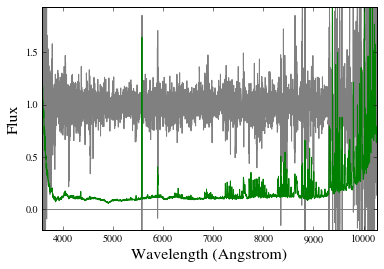

No spectrum found for BOSSJ0814+0402 and wvobs=7730.43 Angstrom!
Does not survive atmosphere cut
No spectrum found for BOSSJ0818+1527 and wvobs=7706.87 Angstrom!
Does not survive atmosphere cut
No spectrum found for BOSSJ0818+1232 and wvobs=7554.39 Angstrom!
No spectrum found for BOSSJ0826+4708 and wvobs=7826.19 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ082844.87+454518.2.fits for SDSSJ0828+4545
S/N 4.94124707979 1 / Angstrom


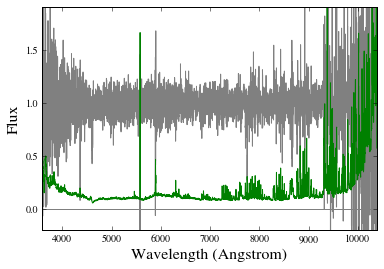

Using spec-7277-56748-0713.fits.gz for BOSSJ0830+5452
S/N 4.42949595737 1 / Angstrom


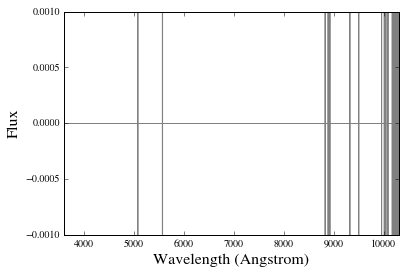

No spectrum found for BOSSJ0833+4823 and wvobs=7272.9 Angstrom!
No spectrum found for BOSSJ0837+0810 and wvobs=8296.52 Angstrom!
No spectrum found for APOJ0837+3630 and wvobs=7928.15 Angstrom!
No spectrum found for APOJ0837+3837 and wvobs=8563.61 Angstrom!
No spectrum found for BOSSJ0838+4621 and wvobs=7720.5 Angstrom!
No spectrum found for BOSSJ0841+3921 and wvobs=8504.2 Angstrom!
Does not survive atmosphere cut
No spectrum found for BOSSJ0844+4839 and wvobs=7556.45 Angstrom!
No spectrum found for BOSSJ0845+3202 and wvobs=8058.03 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ085357.49-001106.1_F.fits.gz for BOSSJ0853-0011
S/N 17.7089097073 1 / Angstrom


/Users/lwymarie/anaconda/lib/python2.7/site-packages/astropy/units/quantity.py:841: RuntimeWarning: divide by zero encountered in true_divide
  return super(Quantity, self).__truediv__(other)


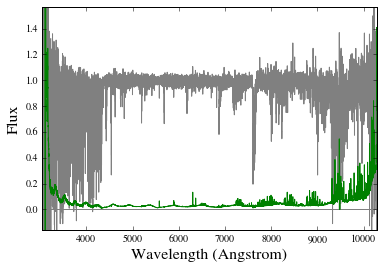

No spectrum found for BOSSJ0856+5514 and wvobs=7330.08 Angstrom!
Using spec-4608-55973-0634.fits.gz for BOSSJ0857+3901
S/N 5.03660278634 1 / Angstrom


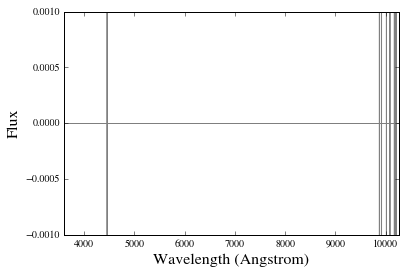

No spectrum found for BOSSJ0902+3602 and wvobs=7720.21 Angstrom!
No spectrum found for BOSSJ0903+5133 and wvobs=8020.18 Angstrom!
No spectrum found for BOSSJ0904+0042 and wvobs=7320.9 Angstrom!
Using spec-5299-55927-0744.fits.gz for BOSSJ0906+1001
S/N 3.08514026689 1 / Angstrom


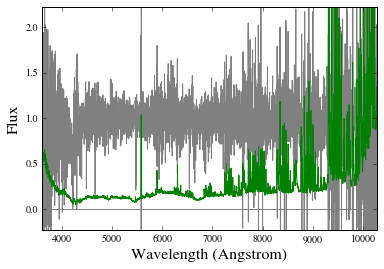

No spectrum found for BOSSJ0907+2802 and wvobs=7704.3 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ091046.69+041448.4_F.fits.gz for APOJ0910+0414
S/N 26.7515845542 1 / Angstrom


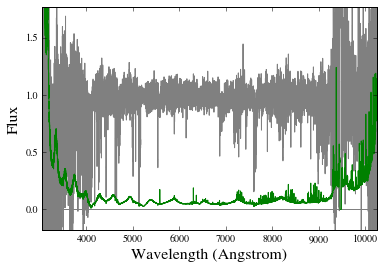

No spectrum found for BOSSJ0911+4905 and wvobs=7811.53 Angstrom!
No spectrum found for BOSSJ0912+4139 and wvobs=7765.52 Angstrom!
No spectrum found for BOSSJ0912+2518 and wvobs=7415.93 Angstrom!
Using spec-5809-56353-0052.fits.gz for BOSSJ0912+3056
S/N 16.4793636553 1 / Angstrom


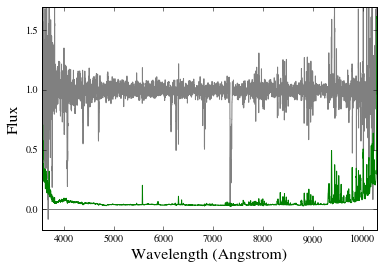

Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ091338.97-010704.6_F.fits.gz for BOSSJ0913-0107
S/N 36.2045833385 1 / Angstrom


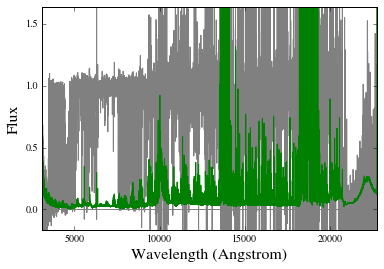

No spectrum found for BOSSJ0913+3151 and wvobs=7533.3 Angstrom!
No spectrum found for BOSSJ0914+0109 and wvobs=8781.11 Angstrom!
No spectrum found for BOSSJ0915+0119 and wvobs=8308.95 Angstrom!
No spectrum found for BOSSJ0916+4250 and wvobs=7660.49 Angstrom!
No spectrum found for BOSSJ0920+3340 and wvobs=7644.43 Angstrom!
No spectrum found for APOJ0924+3929 and wvobs=8068.09 Angstrom!
No spectrum found for BOSSJ0932+0843 and wvobs=7721.14 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ093225.60+092500.2_F.fits.gz for APOJ0932+0925
S/N 15.5986877946 1 / Angstrom


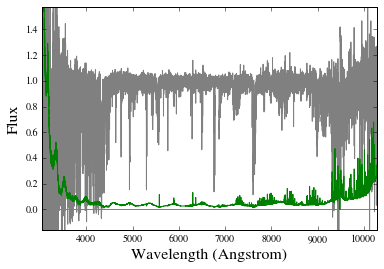

Using spec-5716-56684-0357.fits.gz for BOSSJ0933+5920
S/N 3.28204052592 1 / Angstrom


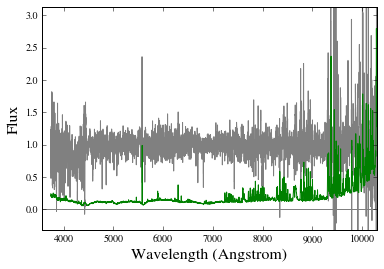

No spectrum found for BOSSJ0935+4532 and wvobs=8647.46 Angstrom!
No spectrum found for BOSSJ0936-0058 and wvobs=8971.95 Angstrom!
No spectrum found for APOJ0938+5317 and wvobs=8576.49 Angstrom!
No spectrum found for BOSSJ0940+3345 and wvobs=7789.14 Angstrom!
Using spec-5788-56255-0380.fits.gz for BOSSJ0941+2308
S/N 3.29072687662 1 / Angstrom


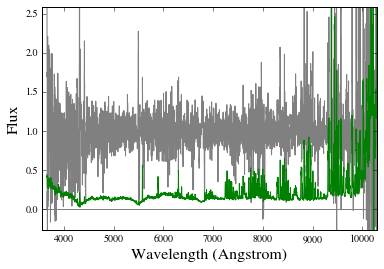

No spectrum found for BOSSJ0942+1347 and wvobs=7553.54 Angstrom!
No spectrum found for BOSSJ0956+0248 and wvobs=8430.84 Angstrom!
No spectrum found for BOSSJ1000+0337 and wvobs=7547.97 Angstrom!
No spectrum found for BOSSJ1001+4023 and wvobs=7907.67 Angstrom!
No spectrum found for BOSSJ1002+0020 and wvobs=8883.44 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ100507.08+501929.6.fits.gz for SDSSJ1005+5019
S/N 6.52941856034 1 / Angstrom


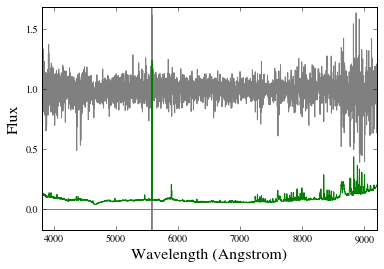

No spectrum found for BOSSJ1006+4804 and wvobs=9236.78 Angstrom!
No spectrum found for BOSSJ1009+1749 and wvobs=8344.39 Angstrom!
No spectrum found for BOSSJ1009+0236 and wvobs=7650.85 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ100940.58+250053.9.fits for APOJ1009+2500
S/N 3.3982254573 1 / Angstrom


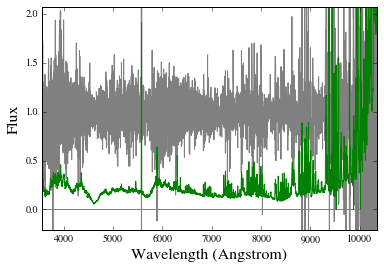

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ101003.47+403754.9.fits for BOSSJ1010+4037
S/N 5.38572815486 1 / Angstrom


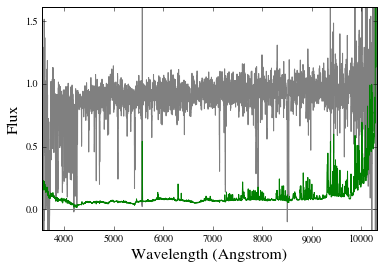

No spectrum found for BOSSJ1010+4517 and wvobs=7788.56 Angstrom!
No spectrum found for BOSSJ1010+0821 and wvobs=8030.54 Angstrom!
No spectrum found for BOSSJ1013+0330 and wvobs=8227.58 Angstrom!
No spectrum found for BOSSJ1014+2653 and wvobs=7629.92 Angstrom!
No spectrum found for BOSSJ1015+1245 and wvobs=7499.5 Angstrom!
Using spec-7081-56684-0951.fits.gz for BOSSJ1017+6226
S/N 4.72976019779 1 / Angstrom


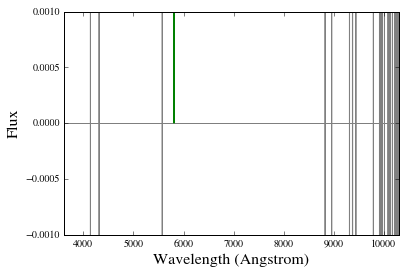

No spectrum found for BOSSJ1020+6119 and wvobs=7796.69 Angstrom!
No spectrum found for BOSSJ1024+0354 and wvobs=7461.87 Angstrom!
Using spec-6463-56340-0210.fits.gz for BOSSJ1024+2616
S/N 6.18168413014 1 / Angstrom


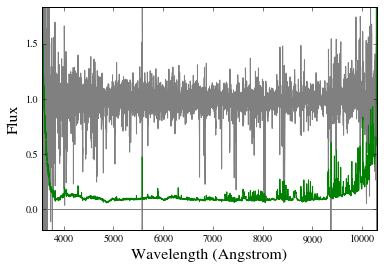

No spectrum found for APOJ1026+4614 and wvobs=12165.5 Angstrom!
No spectrum found for BOSSJ1028+5121 and wvobs=7468.07 Angstrom!
No spectrum found for BOSSJ1034+0856 and wvobs=7375.17 Angstrom!
Using spec-6702-56381-0508.fits.gz for BOSSJ1036+5012
S/N 3.50848179056 1 / Angstrom


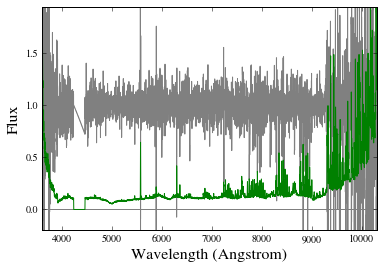

No spectrum found for BOSSJ1039+5026 and wvobs=11555.2 Angstrom!
No spectrum found for APOJ1041+1957 and wvobs=7959.85 Angstrom!
No spectrum found for BOSSJ1042+6459 and wvobs=8351.16 Angstrom!
No spectrum found for BOSSJ1044+3139 and wvobs=7568.46 Angstrom!
No spectrum found for APOJ1045+4351 and wvobs=9586.7 Angstrom!
No spectrum found for BOSSJ1045+1000 and wvobs=8447.16 Angstrom!
No spectrum found for BOSSJ1052+5553 and wvobs=8375.3 Angstrom!
No spectrum found for BOSSJ1059+6255 and wvobs=7671.11 Angstrom!
Using spec-6693-56384-0164.fits.gz for BOSSJ1106+4635
S/N 10.8815825437 1 / Angstrom


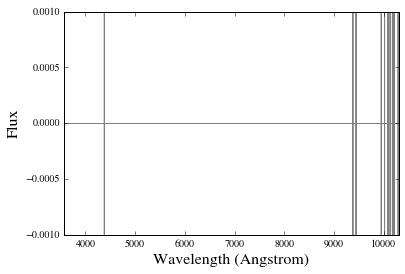

No spectrum found for BOSSJ1113+3305 and wvobs=8087.98 Angstrom!
No spectrum found for BOSSJ1118+4025 and wvobs=8174.42 Angstrom!
No spectrum found for BOSSJ1136-0029 and wvobs=7301.72 Angstrom!
Using spec-7113-56711-0152.fits.gz for BOSSJ1138+6329
S/N 4.03659734092 1 / Angstrom


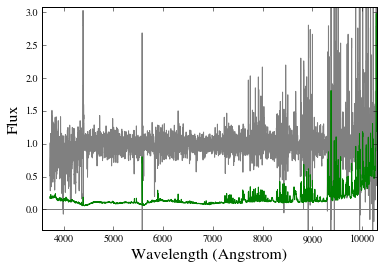

Does not survive atmosphere cut
No spectrum found for BOSSJ1140+2709 and wvobs=7602.13 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114145.43+072423.3_b400_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ114145.43+072423.3_F.fits.gz for APOJ1141+0724
S/N 3.8686298398 1 / Angstrom


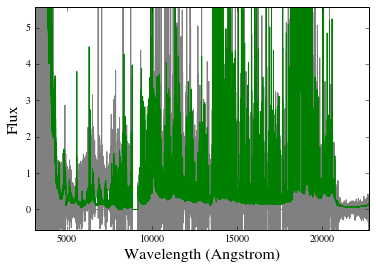

No spectrum found for BOSSJ1142+2822 and wvobs=7549.73 Angstrom!
No spectrum found for BOSSJ1142+1128 and wvobs=7301.66 Angstrom!
No spectrum found for BOSSJ1144+0959 and wvobs=11110.1 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ114546.22+032251.9_F.fits.gz for BOSSJ1145+0322
S/N 51.7294399516 1 / Angstrom


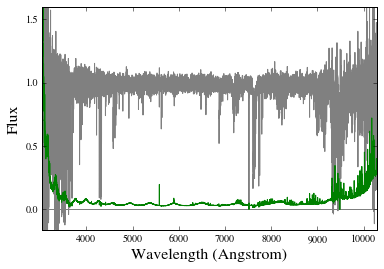

No spectrum found for BOSSJ1150+5802 and wvobs=7666.46 Angstrom!
Using spec-5383-56013-0218.fits.gz for BOSSJ1152+1507
S/N 6.87088787863 1 / Angstrom


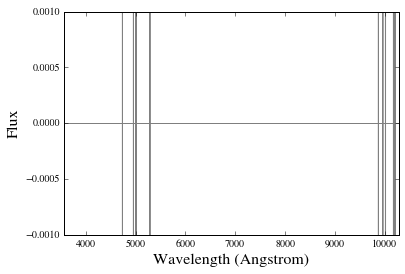

Using spec-4697-55660-0326.fits.gz for BOSSJ1155+3934
S/N 5.51243918821 1 / Angstrom


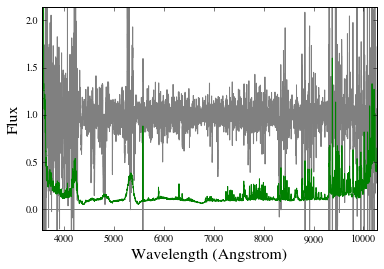

No spectrum found for BOSSJ1159+1433 and wvobs=7578.51 Angstrom!
No spectrum found for BOSSJ1200+0129 and wvobs=8506.2 Angstrom!
Using spec-5389-55953-0264.fits.gz for BOSSJ1202+0747
S/N 4.46157629986 1 / Angstrom


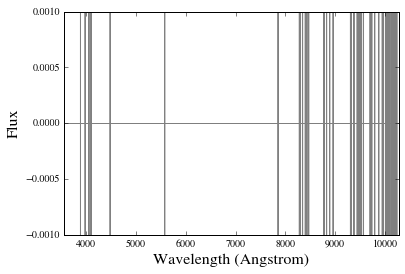

No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ120416.69+022111.0_b1200_F.fits.gz
No continuum: /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz
Using conti=1 for HIRES
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120416.69+022111.0_F.fits.gz for BOSSJ1204+0221
S/N 10.9859192226 1 / Angstrom


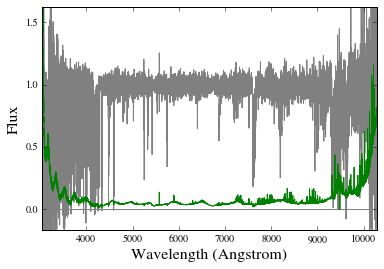

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120857.16+073727.3_F.fits.gz for APOJ1208+0737
S/N 10.7536360531 1 / Angstrom


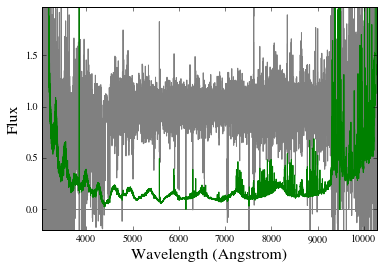

No spectrum found for BOSSJ1212+3240 and wvobs=8335.29 Angstrom!
Using spec-6640-56385-0544.fits.gz for BOSSJ1213+4719
S/N 3.72556736869 1 / Angstrom


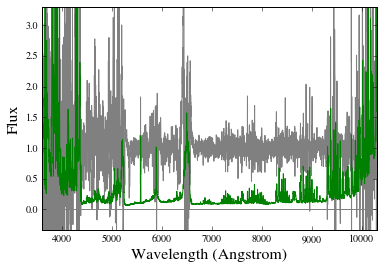

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ121558.80+571555.4.fits.gz for BOSSJ1215+5715
S/N 9.0646628842 1 / Angstrom


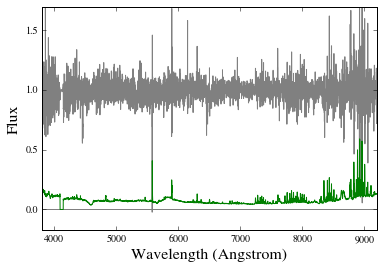

No spectrum found for BOSSJ1225+5709 and wvobs=8101.33 Angstrom!
No spectrum found for BOSSJ1231+0029 and wvobs=11748 Angstrom!
No spectrum found for BOSSJ1239+3955 and wvobs=7946.35 Angstrom!
Does not survive atmosphere cut
No spectrum found for BOSSJ1242+5331 and wvobs=7598.52 Angstrom!
Using spec-3972-55589-0570.fits.gz for BOSSJ1244+3916
S/N 3.56532862119 1 / Angstrom


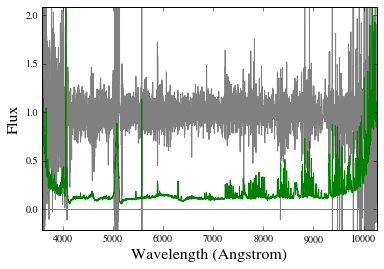

No spectrum found for BOSSJ1244+3208 and wvobs=8363.89 Angstrom!
No spectrum found for BOSSJ1245+5922 and wvobs=8153.23 Angstrom!
No spectrum found for BOSSJ1246+2345 and wvobs=8373.27 Angstrom!
Using spec-4703-55617-0350.fits.gz for BOSSJ1248+4058
S/N 5.87116767045 1 / Angstrom


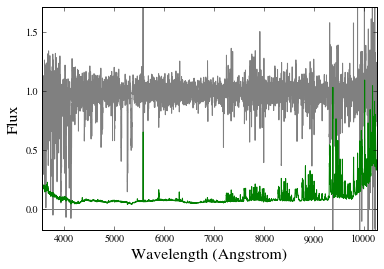

No spectrum found for BOSSJ1253+6327 and wvobs=8298.17 Angstrom!
No spectrum found for BOSSJ1255+2234 and wvobs=7875.36 Angstrom!
No spectrum found for SDSSJ1301+4759 and wvobs=8931.42 Angstrom!
No spectrum found for APOJ1306+6158 and wvobs=8693.68 Angstrom!
No spectrum found for BOSSJ1310+1134 and wvobs=8158.93 Angstrom!
No spectrum found for BOSSJ1319+2138 and wvobs=7723.46 Angstrom!
Using spec-6828-56430-0134.fits.gz for BOSSJ1325+5409
S/N 3.91139494755 1 / Angstrom


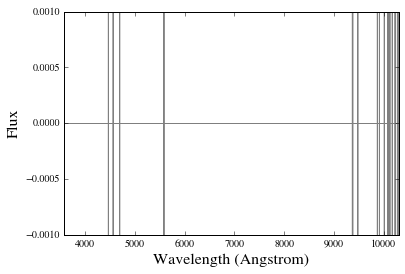

No spectrum found for APOJ1327+3423 and wvobs=7406.06 Angstrom!
No spectrum found for BOSSJ1335+4330 and wvobs=8353.65 Angstrom!
No spectrum found for BOSSJ1346+1952 and wvobs=8577.76 Angstrom!
No spectrum found for BOSSJ1356+6133 and wvobs=8454.58 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ135849.54+273756.9.fits for APOJ1358+2737
S/N 3.45545455063 1 / Angstrom


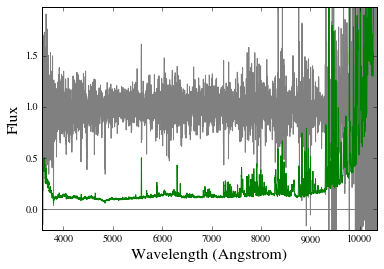

No spectrum found for BOSSJ1402+4701 and wvobs=8153.94 Angstrom!
No spectrum found for BOSSJ1410+4804 and wvobs=7788.69 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ141337.96+271511.0.fits for SDSSJ1413+2715
S/N 13.2389480754 1 / Angstrom


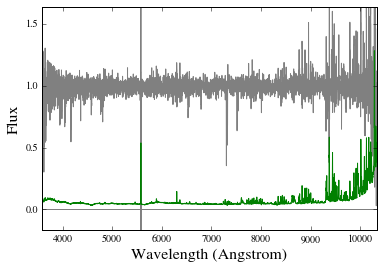

No spectrum found for BOSSJ1420+0227 and wvobs=12909.8 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142054.92+160342.9_F.fits.gz for APOJ1420+1603
S/N 34.7418613707 1 / Angstrom


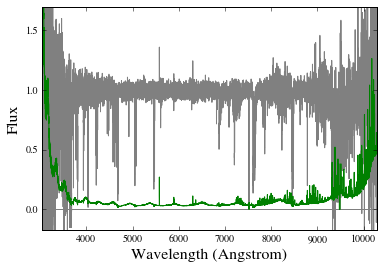

No spectrum found for BOSSJ1422+4652 and wvobs=7681.55 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ142758.74-012136.2_b1200_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142758.74-012136.2_F.fits.gz for BOSSJ1427-0121
S/N 35.6455711808 1 / Angstrom


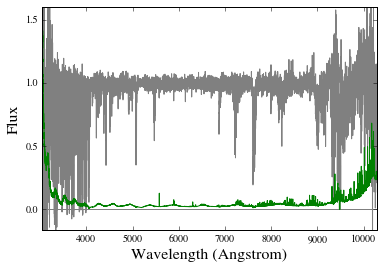

No spectrum found for BOSSJ1428+5509 and wvobs=7739.01 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ143109.22+572726.4.fits for APOJ1431+5727
S/N 3.6181182211 1 / Angstrom


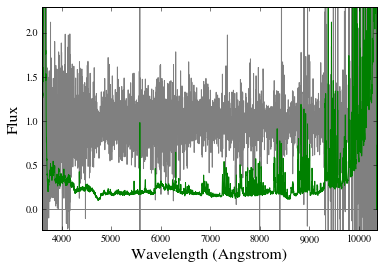

Using spec-5467-55973-0438.fits.gz for BOSSJ1433+0827
S/N 3.62912089324 1 / Angstrom


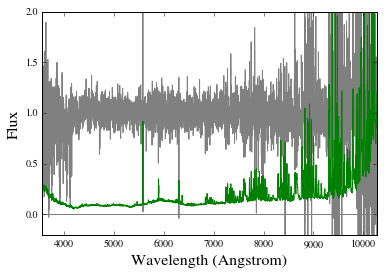

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_4_45/SDSSJ143344.55+064111.9.fits for BOSSJ1433+0641
S/N 4.73484139614 1 / Angstrom


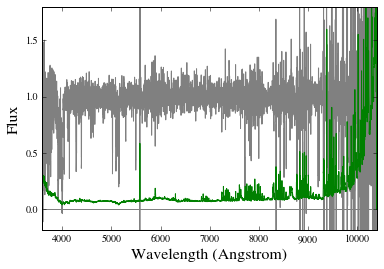

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ144231.91+013734.8.fits for BOSSJ1442+0137
S/N 8.76419878037 1 / Angstrom


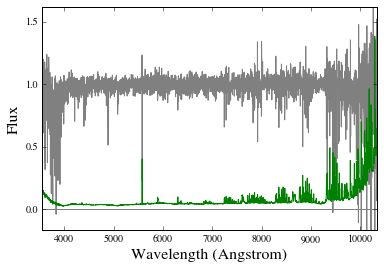

No spectrum found for BOSSJ1448+5649 and wvobs=7859.53 Angstrom!
No spectrum found for BOSSJ1457+0237 and wvobs=7854.9 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ150812.80+363530.3.fits for BOSSJ1508+3635
S/N 3.19567778756 1 / Angstrom


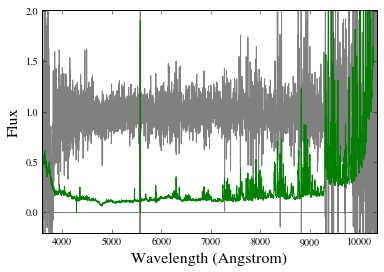

No spectrum found for BOSSJ1515+2627 and wvobs=8201.42 Angstrom!
No spectrum found for BOSSJ1517+2002 and wvobs=7599.35 Angstrom!
No spectrum found for BOSSJ1530+2515 and wvobs=7812.69 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ153329.17+142537.8.fits for BOSSJ1533+1425
S/N 5.65945699302 1 / Angstrom


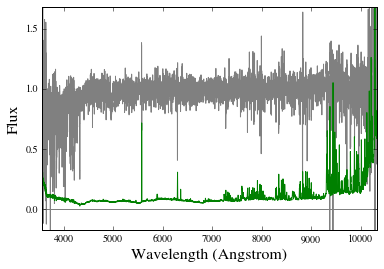

Using spec-3949-55650-0016.fits.gz for BOSSJ1534+2153
S/N 4.47390172101 1 / Angstrom


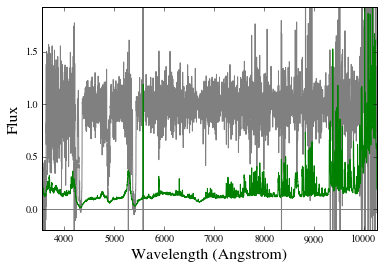

No spectrum found for BOSSJ1538+5707 and wvobs=8195.92 Angstrom!
No spectrum found for BOSSJ1539+3146 and wvobs=8021.79 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ155325.89+192137.7_F.fits.gz for APOJ1553+1921
S/N 28.2784594603 1 / Angstrom


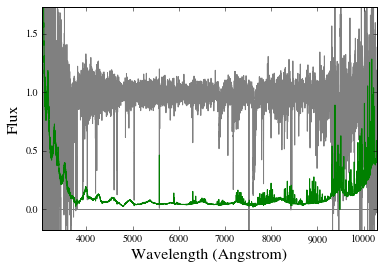

Using spec-4900-55739-0026.fits.gz for BOSSJ1554+1244
S/N 4.91977879663 1 / Angstrom


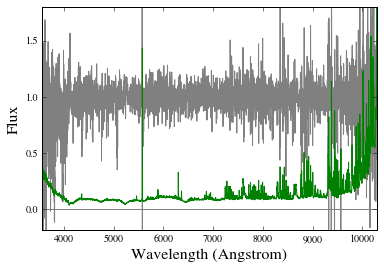

No spectrum found for BOSSJ1556+3040 and wvobs=8418.31 Angstrom!
No spectrum found for BOSSJ1557+0434 and wvobs=7999.19 Angstrom!
No spectrum found for APOJ1559+4943 and wvobs=7998.35 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ160546.67+511323.0.fits for BOSSJ1605+5113
S/N 11.398281721 1 / Angstrom


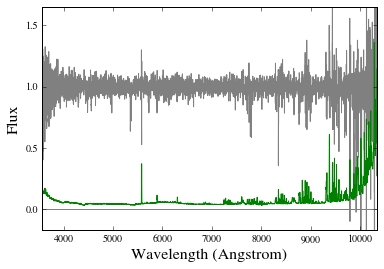

No spectrum found for BOSSJ1618+1842 and wvobs=8523.49 Angstrom!
No spectrum found for BOSSJ1619+1926 and wvobs=7777.76 Angstrom!
No spectrum found for BOSSJ1627+2215 and wvobs=11897.1 Angstrom!
No spectrum found for APOJ1627+4606 and wvobs=13463.2 Angstrom!
No spectrum found for BOSSJ1628+2342 and wvobs=7607.08 Angstrom!
No spectrum found for BOSSJ1631+4333 and wvobs=8435.48 Angstrom!
No spectrum found for BOSSJ1631+3659 and wvobs=7381.25 Angstrom!
No spectrum found for BOSSJ1635+2547 and wvobs=8023.04 Angstrom!
No spectrum found for BOSSJ1651+3410 and wvobs=7463.03 Angstrom!
No spectrum found for BOSSJ1657+3105 and wvobs=8757.58 Angstrom!
No spectrum found for BOSSJ2053-0104 and wvobs=8426.08 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ214620.98-075303.8_F.fits.gz for APOJ2146-0753
S/N 19.0978714623 1 / Angstrom


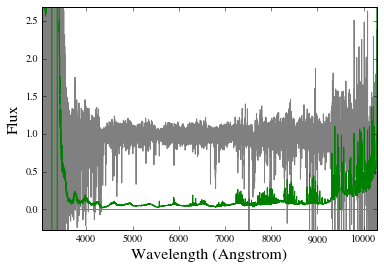

No spectrum found for BOSSJ2156-0003 and wvobs=7490.9 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ220248.31+123656.3.fits for BOSSJ2202+1236
S/N 3.35412230533 1 / Angstrom


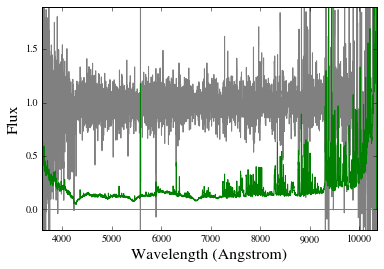

No spectrum found for BOSSJ2212-0011 and wvobs=8337.09 Angstrom!
No spectrum found for BOSSJ2255-0001 and wvobs=7640.11 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ225549.55-000927.7.fits for BOSSJ2255-0009
S/N 3.94594168504 1 / Angstrom


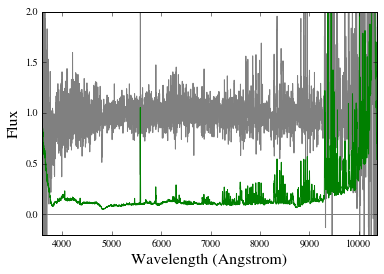

No spectrum found for BOSSJ2314-0108 and wvobs=7400.53 Angstrom!
No spectrum found for BOSSJ2338-0003 and wvobs=9618.54 Angstrom!
Does not survive atmosphere cut
No spectrum found for BOSSJ2341-0041 and wvobs=7637.36 Angstrom!
No spectrum found for BOSSJ2348+0110 and wvobs=7534.78 Angstrom!
No spectrum found for BOSSJ2352-0015 and wvobs=7627.15 Angstrom!
No spectrum found for BOSSJ2354-0019 and wvobs=7700.92 Angstrom!


In [5]:
stack_tup0 = qpq9k.qpq9_IRMgII(passback=True,wrest=2796.352*u.AA,S2N_cut=3/u.AA,zfg_mnx=(1.6,9999),atmosphere_cut=True)
fin_velo, stck_img, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
    if 'J0822+1319' in dd['qpq']['NAME']: #BAL
        idx_mask.append(ii) 
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [6]:
np.sum(stck_mskN,0)

array([ 53.,  53.,  52.,  52.,  52.,  52.,  52.,  52.,  52.,  52.,  52.,
        52.,  53.,  53.,  53.,  53.,  52.,  52.,  52.,  52.,  52.,  52.,
        52.,  52.,  52.,  52.,  53.,  53.,  53.,  53.,  53.,  53.,  53.,
        53.,  53.,  53.,  53.,  53.,  53.,  53.,  53.,  53.,  53.,  53.,
        53.,  53.,  53.,  53.,  53.,  53.,  53.,  53.,  53.,  53.,  53.,
        53.,  53.,  53.,  53.,  53.,  53.])

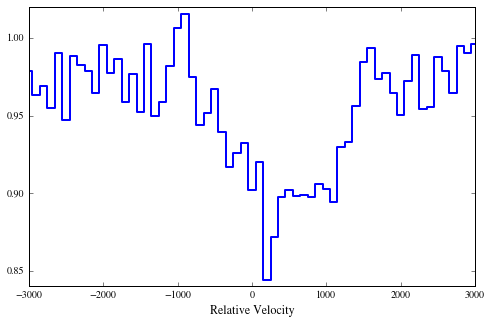

In [7]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)

Centroid velocity in km/s =  Parameter('mean_1', value=135.822018435)
tau-weighted centroid and dispersion in km/s =  476.77488949 746.242302285


<CompoundModel3(amplitude_0=0.9756854414496346, amplitude_1=0.0869964031219668, mean_1=135.8220184352202, stddev_1=337.7597696385718, amplitude_2=0.07281735522938264, mean_2=904.8220184352202, stddev_2=337.7597696385718)>

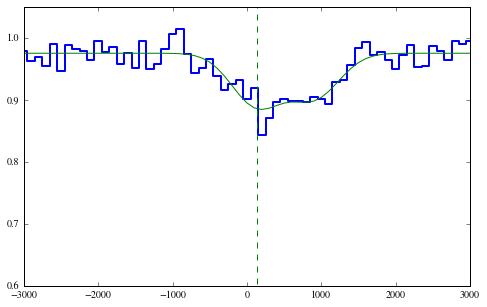

In [9]:
g_2798_init = models.GaussianAbsorption1D(amplitude=0.1,mean=243.,stddev=500.)
g_2803_init = models.GaussianAbsorption1D(amplitude=0.05,mean=243.+769.,stddev=500.)
c_init = models.Const1D(amplitude=0.98)
model_init = c_init*(g_2798_init*g_2803_init)
def tie_amplitude2(model):
    amplitude_2 = model.amplitude_1*0.5
    return amplitude_2
def tie_mean2(model):
    mean_2 = model.mean_1 + 769.
    return mean_2
def tie_stddev2(model):
    stddev_2 = model.stddev_1 
    return stddev_2
#model_init.amplitude_2.bounds = [0.1157/2,0.2814]
#model_init.amplitude_2.tied = tie_amplitude2
model_init.mean_2.tied = tie_mean2
model_init.stddev_2.tied = tie_stddev2
fit = fitting.LevMarLSQFitter()
model_final = fit(model_init,fin_velo.value,fin_flx)
plt.figure(figsize=(8,5))
plt.plot(fin_velo.value,fin_flx,drawstyle='steps-mid',linewidth=2.)
plt.plot(fin_velo.value,model_final(fin_velo.value), label='Gaussian')
plt.plot([model_final.mean_1.value,model_final.mean_1.value],[0,2],'g--')
plt.axis([-3000,3000,0.6,1.05])
print('Centroid velocity in km/s = ',model_final.mean_1)
# tau-weighted centroid
#cranges = [(-3000.,-1300.)*u.km/u.s,(1300.,3000.)*u.km/u.s]
#pix = np.where( (fin_velo >= cranges[0][0]) & (fin_velo <= cranges[0][1]) | 
#               (fin_velo >= cranges[1][0]) & (fin_velo <= cranges[1][1]))[0]
#fit = np.polyfit(fin_velo[pix].value,fin_flx[pix], 0)
#pv = np.poly1d(fit)
#conti = pv(fin_velo.value)
#print(conti)
#tau = np.log(1./(fin_flx/conti))
tau = np.log(1./(fin_flx/model_final.amplitude_0))
start = np.int((len(fin_velo)-1)*1./6.)-1
end = np.int((len(fin_velo)-1)*5./6.)+1
tau_cen = np.sum(fin_velo.value[start:end+1]*tau[start:end+1])/np.sum(tau[start:end+1])
tau[np.where(tau < 0)] = 0.
tau_disp = np.sqrt(np.abs(np.sum(np.square(fin_velo.value[start:end+1]-tau_cen)*tau[start:end+1])/np.sum(tau[start:end+1])))
print('tau-weighted centroid and dispersion in km/s = ',tau_cen,tau_disp)
model_final


Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits
Using spec-4216-55477-0198.fits.gz for BOSSJ0001+0000
S/N 0.816863564656 1 / Angstrom


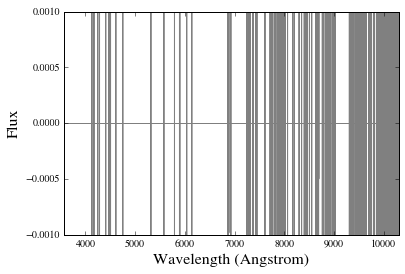

Using spSpec-52994-1490-155.fit.gz for BOSSJ0008-0039
S/N 1.86120113093 1 / Angstrom


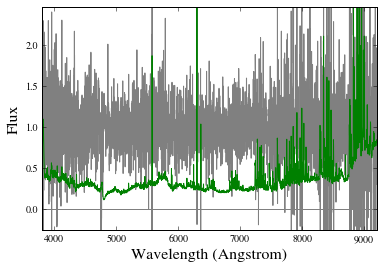

Using spSpec-52994-1490-155.fit.gz for BOSSJ0008-0039
S/N 1.37514495238 1 / Angstrom


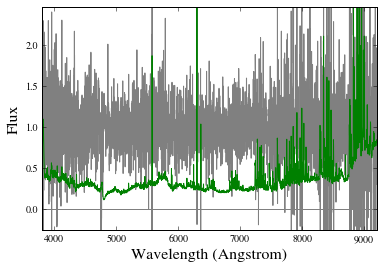

Using spec-6197-56191-0089.fits.gz for BOSSJ0042+1350
S/N 2.34549574892 1 / Angstrom


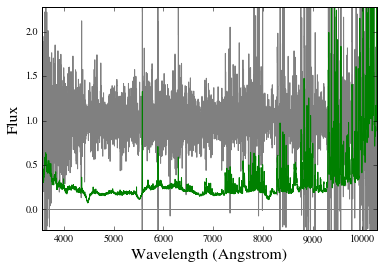

Using spec-6203-56266-0300.fits.gz for BOSSJ0047+1447
S/N 10.2401891376 1 / Angstrom


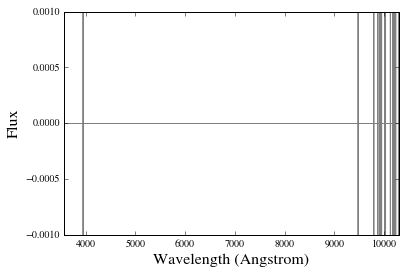

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ005718.90-000134.7.fits for BOSSJ0057-0001
S/N 0.37407393166 1 / Angstrom


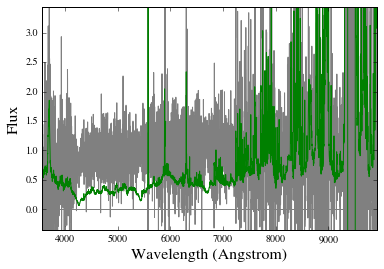

BOSSJ0103-0002 does not survive atmosphere cut
No spectrum found for BOSSJ0103-0002 and wvobs=7700.43 Angstrom!
Using spec-4226-55475-0663.fits.gz for BOSSJ0106+0056
S/N 2.23025933906 1 / Angstrom


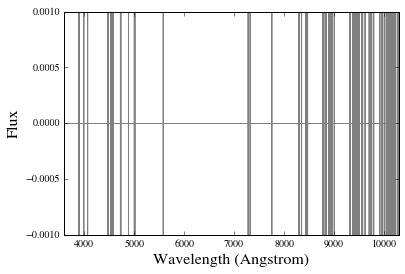

No spectrum found for SDSSJ0111+1402 and wvobs=9745.68 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ014917.46-002158.4.fits.gz for SDSSJ0149-0021
S/N 3.71362359528 1 / Angstrom


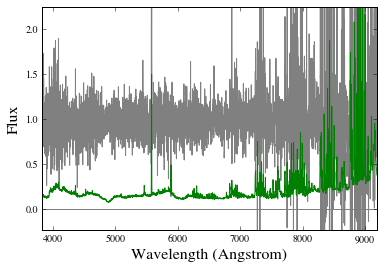

Using spec-4233-55449-0726.fits.gz for BOSSJ0154+0020
S/N 0.640855788663 1 / Angstrom


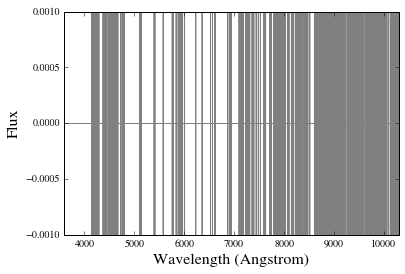

Using spec-5114-55883-0090.fits.gz for BOSSJ0206+2238
S/N 0.786187872186 1 / Angstrom


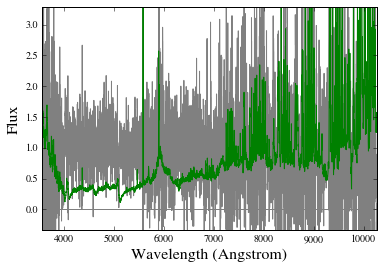

Using spec-4236-55479-0340.fits.gz for BOSSJ0214-0052
S/N 1.250411727 1 / Angstrom


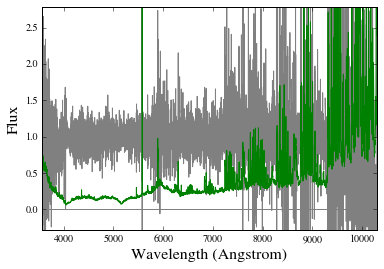

Using spec-6780-56605-0459.fits.gz for BOSSJ0224-0046
S/N 2.50743066544 1 / Angstrom


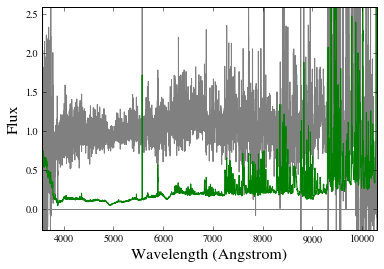

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ023019.99-033316.0.fits for BOSSJ0230-0333
S/N 1.59374309947 1 / Angstrom


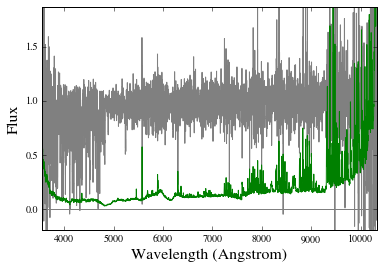

No continuum: /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ023946.44-010644.1_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ023946.45-010644.1.fits for BOSSJ0239-0106
S/N 1.24211184806 1 / Angstrom


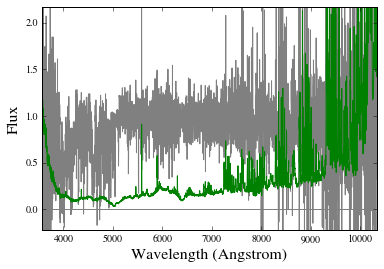

Using spec-6782-56572-0338.fits.gz for BOSSJ0242-0046
S/N 0.960677515638 1 / Angstrom


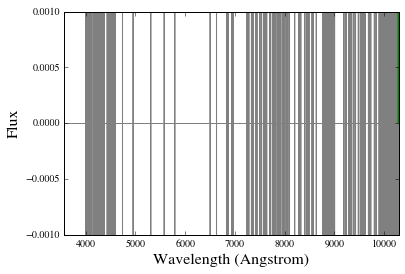

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ025039.82-004749.6.fits for BOSSJ0250-0047
S/N 2.17597454108 1 / Angstrom


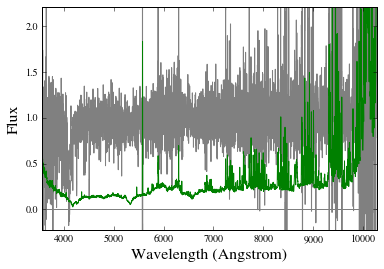

Using spSpec-52178-0713-044.fit.gz for BOSSJ0334-0058
S/N 1.8017861 1 / Angstrom


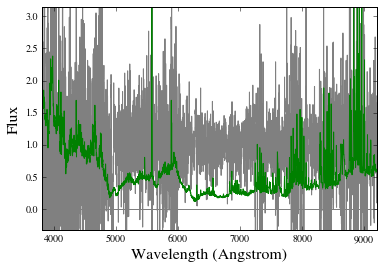

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ034139.19-000012.7_F.fits.gz for SDSSJ0341-0000
S/N 25.9066978318 1 / Angstrom


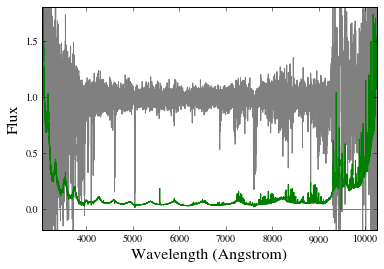

SDSSJ0409-0411 does not survive atmosphere cut
No spectrum found for SDSSJ0409-0411 and wvobs=7593.49 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ074953.62+370206.5.fits for BOSSJ0749+3702
S/N 1.15697732915 1 / Angstrom


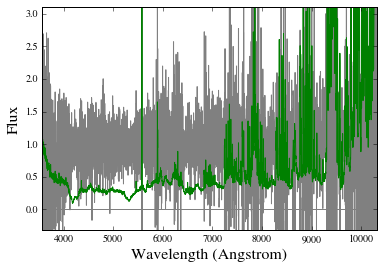

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ075259.14+401118.4.fits.gz for SDSSJ0752+4011
S/N 3.04206123108 1 / Angstrom


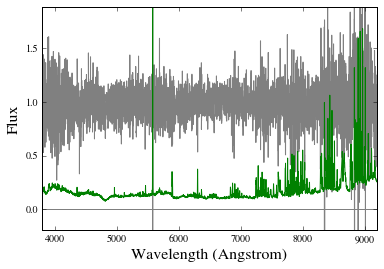

No spectrum found for APOJ0800+3542 and wvobs=8339.59 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ080948.22+453929.0.fits for BOSSJ0809+4539
S/N 1.05570884487 1 / Angstrom


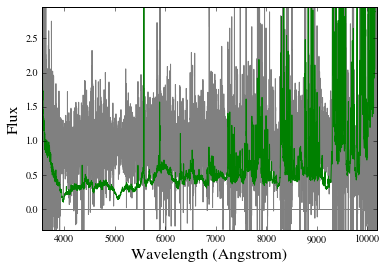

Using spec-4463-55868-0778.fits.gz for BOSSJ0812+2620
S/N 5.27801272052 1 / Angstrom


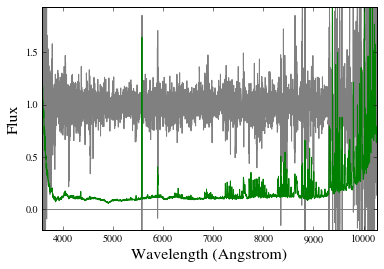

BOSSJ0814+0402 does not survive atmosphere cut
No spectrum found for BOSSJ0814+0402 and wvobs=7730.43 Angstrom!
BOSSJ0818+1527 does not survive atmosphere cut
BOSSJ0818+1527 does not survive atmosphere cut
No spectrum found for BOSSJ0818+1527 and wvobs=7706.87 Angstrom!
BOSSJ0818+1232 does not survive atmosphere cut
No spectrum found for BOSSJ0818+1232 and wvobs=7554.39 Angstrom!
Using spSpec-51868-0441-618.fit.gz for BOSSJ0826+4708
S/N 2.05514173383 1 / Angstrom


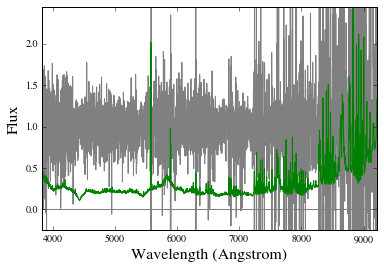

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ082844.87+454518.2.fits for SDSSJ0828+4545
S/N 4.94124707979 1 / Angstrom


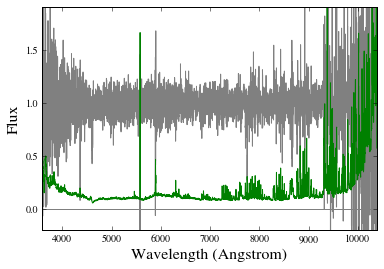

Using spec-7277-56748-0713.fits.gz for BOSSJ0830+5452
S/N 4.42949595737 1 / Angstrom


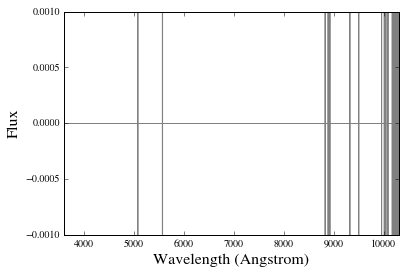

Using spec-5160-55895-0624.fits.gz for BOSSJ0833+4823
S/N 2.63248583999 1 / Angstrom


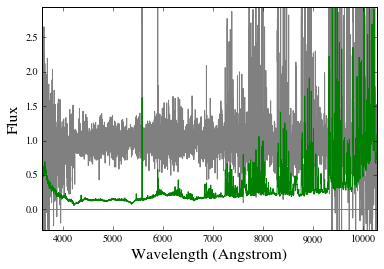

Using spec-5285-55946-0580.fits.gz for BOSSJ0837+0810
S/N 0.795237535348 1 / Angstrom


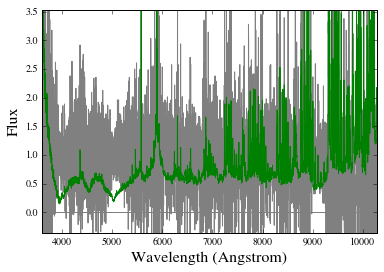

No spectrum found for APOJ0837+3630 and wvobs=7928.15 Angstrom!
No spectrum found for APOJ0837+3837 and wvobs=8563.61 Angstrom!
BOSSJ0838+4621 does not survive atmosphere cut
No spectrum found for BOSSJ0838+4621 and wvobs=7720.5 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ084159.26+392140.0.fits for BOSSJ0841+3921
S/N 2.78187336036 1 / Angstrom


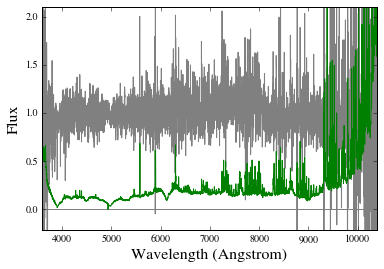

BOSSJ0844+4839 does not survive atmosphere cut
No spectrum found for BOSSJ0844+4839 and wvobs=7556.45 Angstrom!
Using spec-5185-55978-0760.fits.gz for BOSSJ0845+3202
S/N 0.456787944813 1 / Angstrom


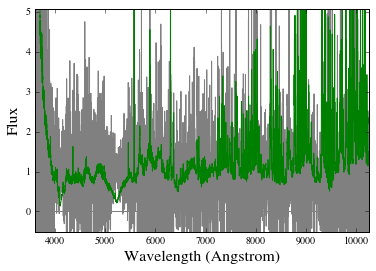

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ085357.49-001106.1_F.fits.gz for BOSSJ0853-0011
S/N 17.7089097073 1 / Angstrom


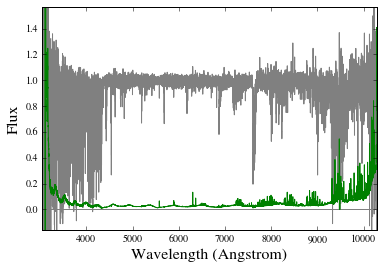

Using spec-5154-55864-0967.fits.gz for BOSSJ0856+5514
S/N 0.847643604985 1 / Angstrom


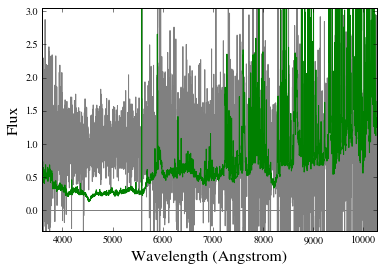

Using spec-4608-55973-0634.fits.gz for BOSSJ0857+3901
S/N 5.03660278634 1 / Angstrom


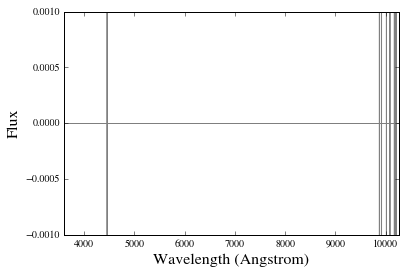

BOSSJ0902+3602 does not survive atmosphere cut
No spectrum found for BOSSJ0902+3602 and wvobs=7720.21 Angstrom!
Using spec-7304-56745-0838.fits.gz for BOSSJ0903+5133
S/N 0.954703328472 1 / Angstrom


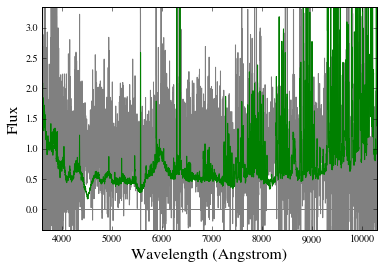

Using spSpec-51929-0470-486.fit.gz for BOSSJ0904+0042
S/N 2.82944540101 1 / Angstrom


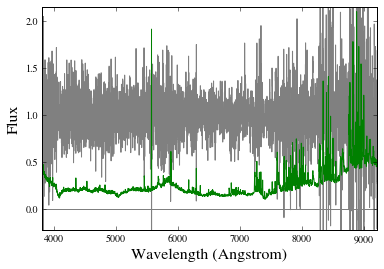

Using spec-5299-55927-0744.fits.gz for BOSSJ0906+1001
S/N 3.08514026689 1 / Angstrom


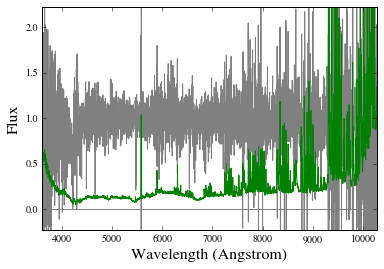

BOSSJ0907+2802 does not survive atmosphere cut
No spectrum found for BOSSJ0907+2802 and wvobs=7704.3 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ091046.69+041448.4_F.fits.gz for APOJ0910+0414
S/N 26.7515845542 1 / Angstrom


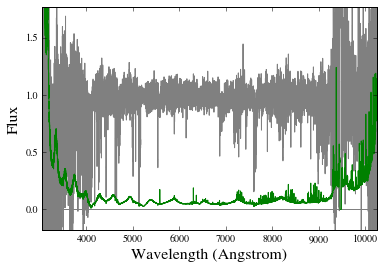

Using spec-5733-56575-0604.fits.gz for BOSSJ0911+4905
S/N 0.679100051122 1 / Angstrom


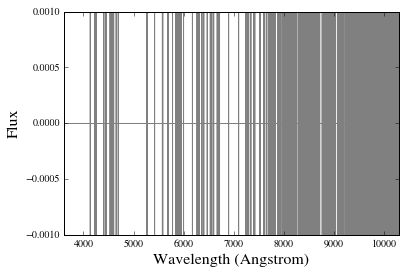

Using spec-4603-55999-0132.fits.gz for BOSSJ0912+4139
S/N 2.20488582633 1 / Angstrom


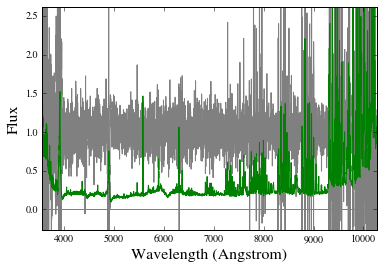

Using spec-5777-56280-0472.fits.gz for BOSSJ0912+2518
S/N 1.38289797715 1 / Angstrom


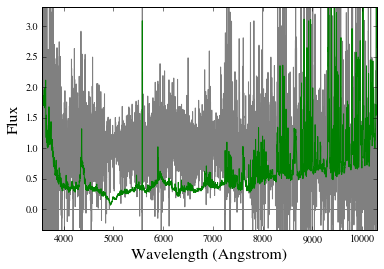

Using spec-5809-56353-0052.fits.gz for BOSSJ0912+3056
S/N 16.4793636553 1 / Angstrom


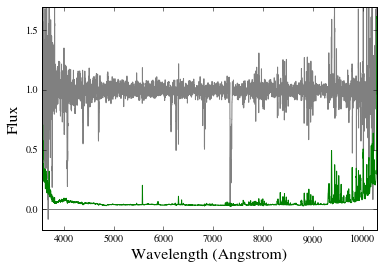

Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ091338.97-010704.6_F.fits.gz for BOSSJ0913-0107
S/N 36.2045833385 1 / Angstrom


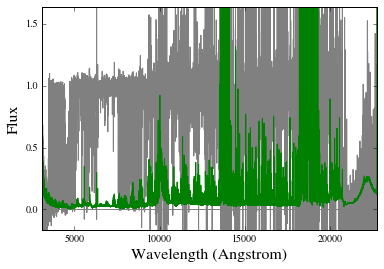

Using spec-5809-56353-0073.fits.gz for BOSSJ0913+3151
S/N 0.675126702936 1 / Angstrom


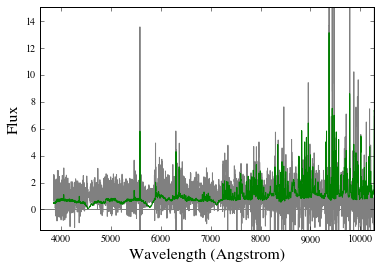

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091430.84+010927.5.fits for BOSSJ0914+0109
S/N 2.15763982584 1 / Angstrom


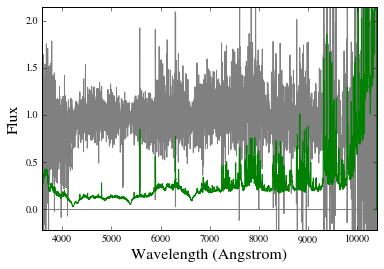

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091553.38+011911.3.fits for BOSSJ0915+0119
S/N 1.26077848806 1 / Angstrom


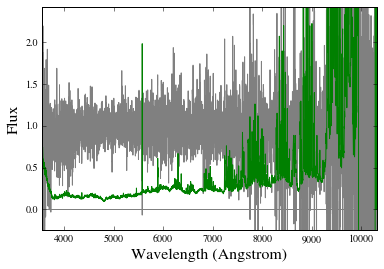

BOSSJ0916+4250 does not survive atmosphere cut
No spectrum found for BOSSJ0916+4250 and wvobs=7660.49 Angstrom!
BOSSJ0920+3340 does not survive atmosphere cut
No spectrum found for BOSSJ0920+3340 and wvobs=7644.43 Angstrom!
No spectrum found for APOJ0924+3929 and wvobs=8068.09 Angstrom!
BOSSJ0932+0843 does not survive atmosphere cut
No spectrum found for BOSSJ0932+0843 and wvobs=7721.14 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ093225.60+092500.2_F.fits.gz for APOJ0932+0925
S/N 15.5986877946 1 / Angstrom


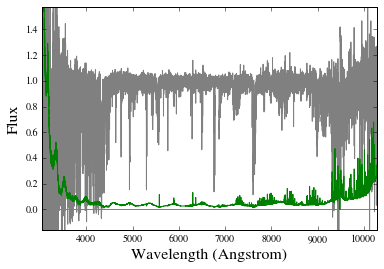

Using spec-5716-56684-0357.fits.gz for BOSSJ0933+5920
S/N 3.28204052592 1 / Angstrom


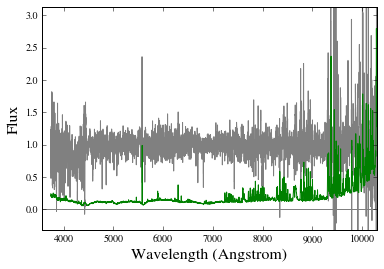

Using spec-4695-55957-0570.fits.gz for BOSSJ0935+4532
S/N 2.29146056201 1 / Angstrom


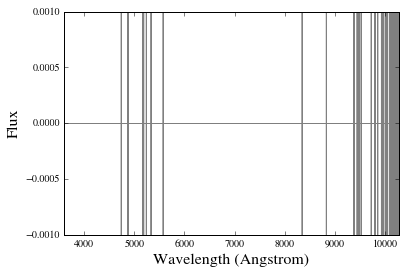

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ093642.20-005831.3.fits for BOSSJ0936-0058
S/N 0.638739598499 1 / Angstrom


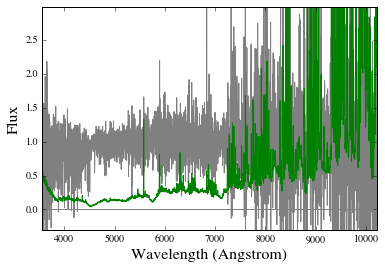

No spectrum found for APOJ0938+5317 and wvobs=8576.49 Angstrom!
Using spec-5798-56326-0494.fits.gz for BOSSJ0940+3345
S/N 0.554873247611 1 / Angstrom


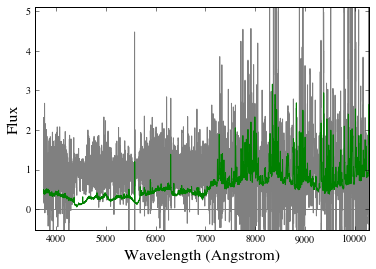

Using spec-5788-56255-0380.fits.gz for BOSSJ0941+2308
S/N 3.29072687662 1 / Angstrom


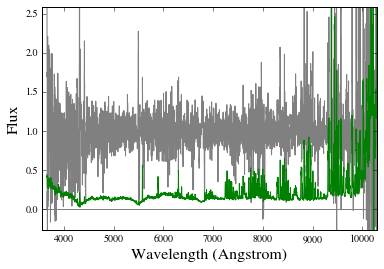

BOSSJ0942+1347 does not survive atmosphere cut
No spectrum found for BOSSJ0942+1347 and wvobs=7553.54 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ095641.74+024840.8.fits for BOSSJ0956+0248
S/N 1.00974767707 1 / Angstrom


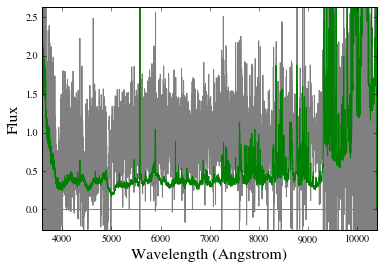

BOSSJ1000+0337 does not survive atmosphere cut
No spectrum found for BOSSJ1000+0337 and wvobs=7547.97 Angstrom!
Using spec-4566-55630-0392.fits.gz for BOSSJ1001+4023
S/N 1.52941855238 1 / Angstrom


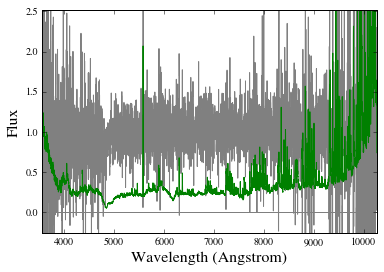

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ100247.14+002053.0.fits for BOSSJ1002+0020
S/N 0.688967619396 1 / Angstrom


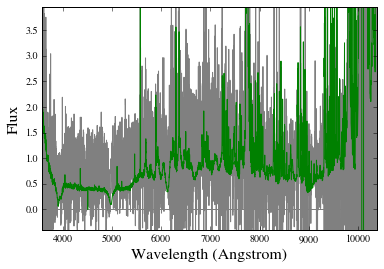

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ100507.08+501929.6.fits.gz for SDSSJ1005+5019
S/N 6.52941856034 1 / Angstrom


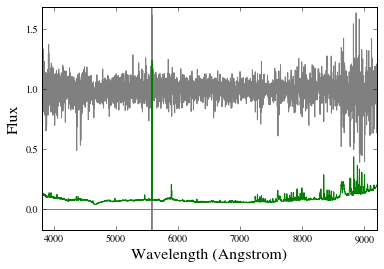

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ100627.10+480429.9.fits for BOSSJ1006+4804
S/N 2.63277386577 1 / Angstrom


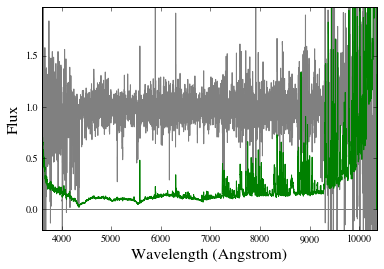

Using spec-5332-55981-0712.fits.gz for BOSSJ1009+1749
S/N 1.38833427332 1 / Angstrom


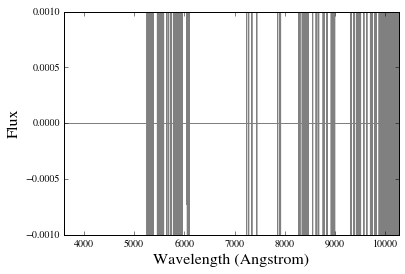

BOSSJ1009+0236 does not survive atmosphere cut
No spectrum found for BOSSJ1009+0236 and wvobs=7650.85 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ100940.58+250053.9.fits for APOJ1009+2500
S/N 3.3982254573 1 / Angstrom


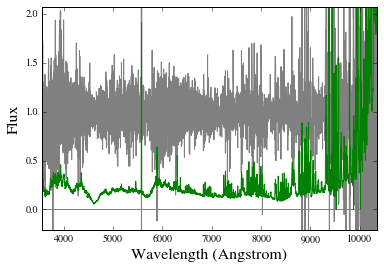

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ101003.47+403754.9.fits for BOSSJ1010+4037
S/N 5.38572815486 1 / Angstrom


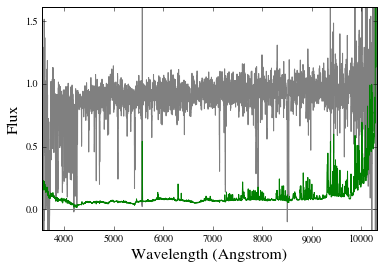

Using spec-7384-56715-0292.fits.gz for BOSSJ1010+4517
S/N 1.67978536901 1 / Angstrom


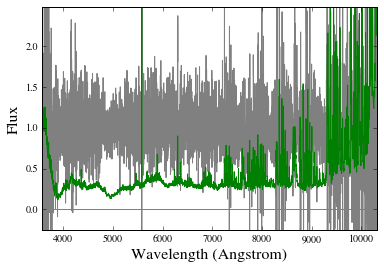

Using spec-5334-55928-0394.fits.gz for BOSSJ1010+0821
S/N 0.754607847993 1 / Angstrom


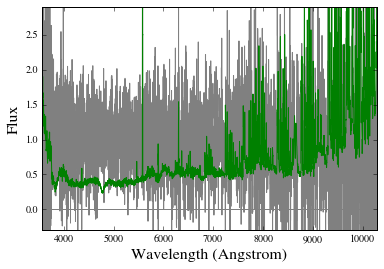

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ101322.31+033009.0.fits for BOSSJ1013+0330
S/N 1.68230274718 1 / Angstrom


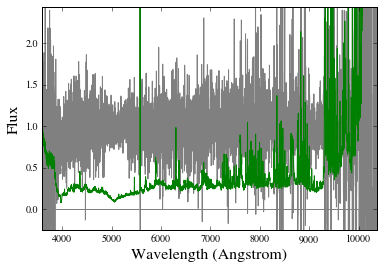

BOSSJ1014+2653 does not survive atmosphere cut
No spectrum found for BOSSJ1014+2653 and wvobs=7629.92 Angstrom!
Using spec-5333-56001-0040.fits.gz for BOSSJ1015+1245
S/N 0.555824476074 1 / Angstrom


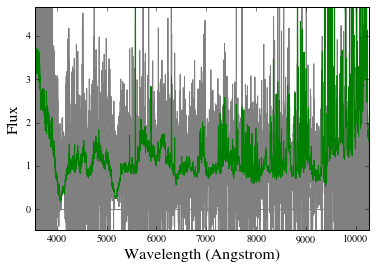

Using spec-7081-56684-0951.fits.gz for BOSSJ1017+6226
S/N 4.72976019779 1 / Angstrom


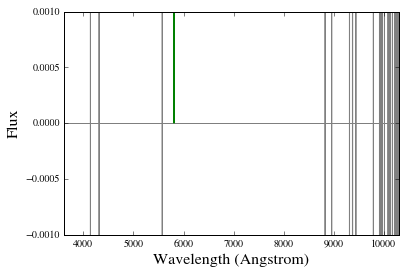

Using spec-7090-56659-0466.fits.gz for BOSSJ1020+6119
S/N 1.18888023136 1 / Angstrom


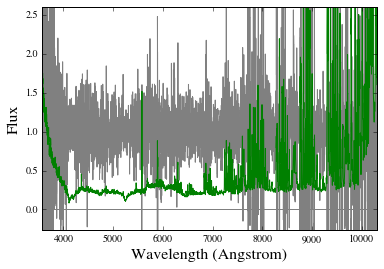

Using spec-4802-55652-0146.fits.gz for BOSSJ1024+0354
S/N 2.5006179159 1 / Angstrom


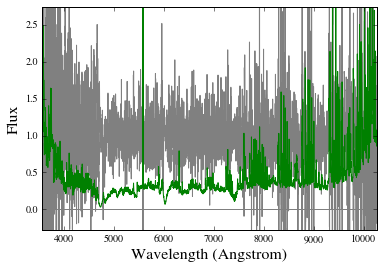

Using spec-6463-56340-0210.fits.gz for BOSSJ1024+2616
S/N 6.18168413014 1 / Angstrom


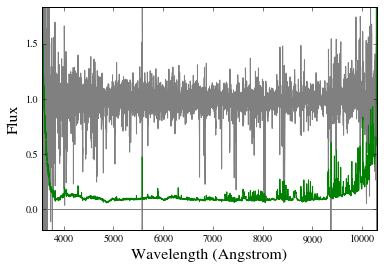

No spectrum found for APOJ1026+4614 and wvobs=12165.5 Angstrom!
Using spec-6695-56628-0406.fits.gz for BOSSJ1028+5121
S/N 1.46751355705 1 / Angstrom


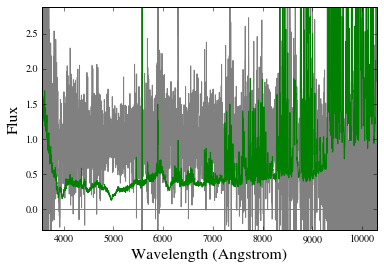

Using spec-5344-55924-0888.fits.gz for BOSSJ1034+0856
S/N 2.81280220916 1 / Angstrom


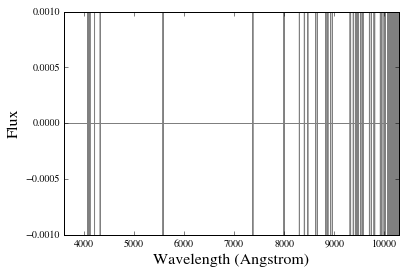

Using spec-6702-56381-0508.fits.gz for BOSSJ1036+5012
S/N 3.50848179056 1 / Angstrom


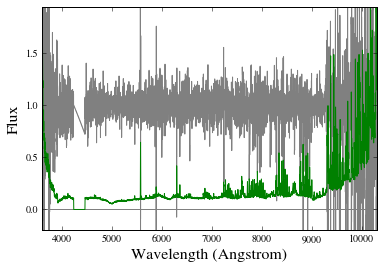

No spectrum found for BOSSJ1039+5026 and wvobs=11555.2 Angstrom!
No spectrum found for APOJ1041+1957 and wvobs=7959.85 Angstrom!
Using spec-7083-56722-0068.fits.gz for BOSSJ1042+6459
S/N 2.00233092921 1 / Angstrom


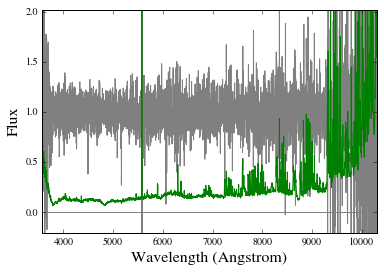

BOSSJ1044+3139 does not survive atmosphere cut
No spectrum found for BOSSJ1044+3139 and wvobs=7568.46 Angstrom!
No spectrum found for APOJ1045+4351 and wvobs=9586.7 Angstrom!
Using spec-5351-55952-0348.fits.gz for BOSSJ1045+1000
S/N 1.22836426271 1 / Angstrom


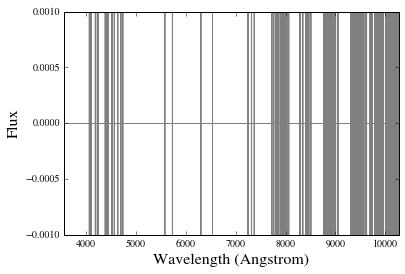

Using spec-7094-56660-0184.fits.gz for BOSSJ1052+5553
S/N 2.56395717571 1 / Angstrom


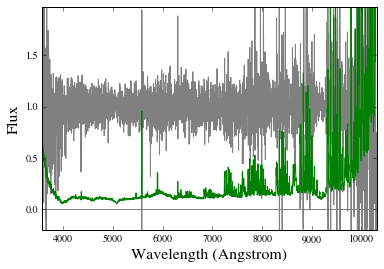

BOSSJ1059+6255 does not survive atmosphere cut
No spectrum found for BOSSJ1059+6255 and wvobs=7671.11 Angstrom!
Using spec-6693-56384-0164.fits.gz for BOSSJ1106+4635
S/N 10.8815825437 1 / Angstrom


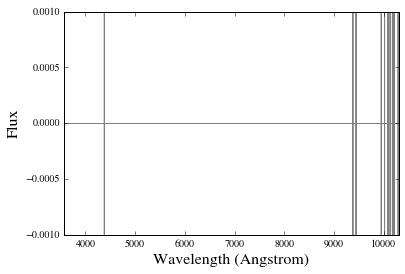

Using spec-6440-56370-0888.fits.gz for BOSSJ1113+3305
S/N 2.36063200728 1 / Angstrom


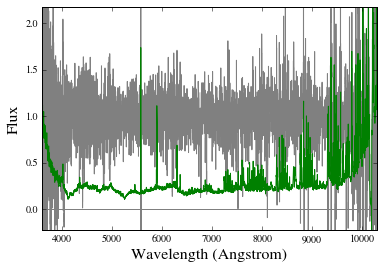

Using spec-4651-56008-0354.fits.gz for BOSSJ1118+4025
S/N 1.86152222123 1 / Angstrom


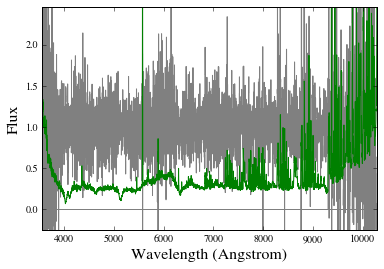

Using spec-3840-55574-0090.fits.gz for BOSSJ1136-0029
S/N 0.569524591619 1 / Angstrom


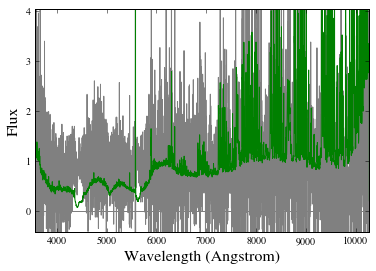

Using spec-7113-56711-0152.fits.gz for BOSSJ1138+6329
S/N 4.03659734092 1 / Angstrom


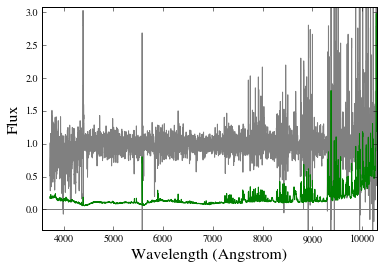

BOSSJ1140+2709 does not survive atmosphere cut
BOSSJ1140+2709 does not survive atmosphere cut
No spectrum found for BOSSJ1140+2709 and wvobs=7602.13 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114145.43+072423.3_b400_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ114145.43+072423.3_F.fits.gz for APOJ1141+0724
S/N 3.8686298398 1 / Angstrom


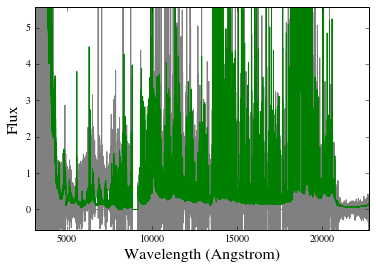

BOSSJ1142+2822 does not survive atmosphere cut
No spectrum found for BOSSJ1142+2822 and wvobs=7549.73 Angstrom!
Using spec-5379-55986-0194.fits.gz for BOSSJ1142+1128
S/N 1.25338719413 1 / Angstrom


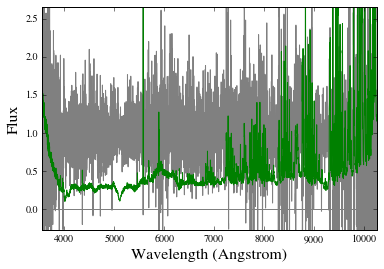

No spectrum found for BOSSJ1144+0959 and wvobs=11110.1 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ114546.22+032251.9_F.fits.gz for BOSSJ1145+0322
S/N 51.7294399516 1 / Angstrom


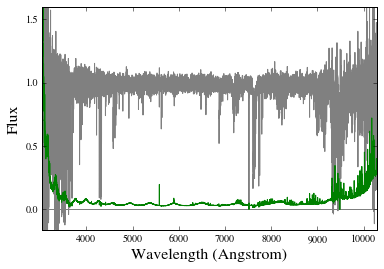

BOSSJ1150+5802 does not survive atmosphere cut
No spectrum found for BOSSJ1150+5802 and wvobs=7666.46 Angstrom!
Using spec-5383-56013-0218.fits.gz for BOSSJ1152+1507
S/N 6.87088787863 1 / Angstrom


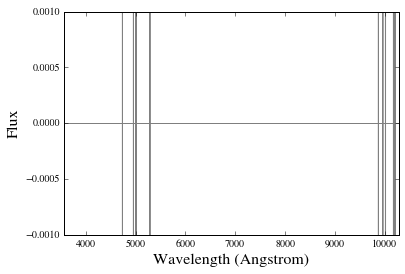

Using spec-4697-55660-0326.fits.gz for BOSSJ1155+3934
S/N 5.51243918821 1 / Angstrom


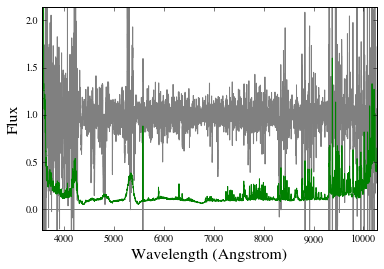

BOSSJ1159+1433 does not survive atmosphere cut
No spectrum found for BOSSJ1159+1433 and wvobs=7578.51 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ120029.15+012946.3.fits for BOSSJ1200+0129
S/N 0.574268517411 1 / Angstrom


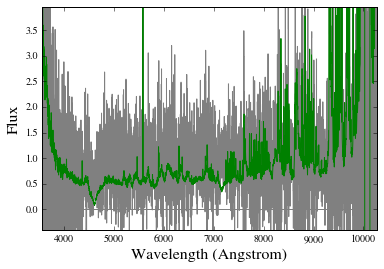

Using spec-5389-55953-0264.fits.gz for BOSSJ1202+0747
S/N 4.46157629986 1 / Angstrom


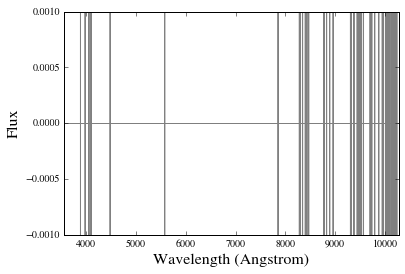

No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ120416.69+022111.0_b1200_F.fits.gz
No continuum: /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz
Using conti=1 for HIRES
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120416.69+022111.0_F.fits.gz for BOSSJ1204+0221
S/N 10.9859192226 1 / Angstrom


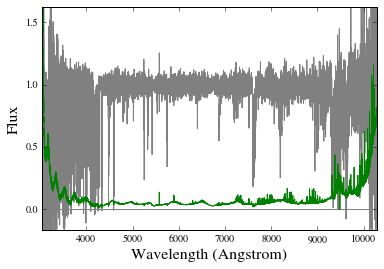

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120857.16+073727.3_F.fits.gz for APOJ1208+0737
S/N 10.7536360531 1 / Angstrom


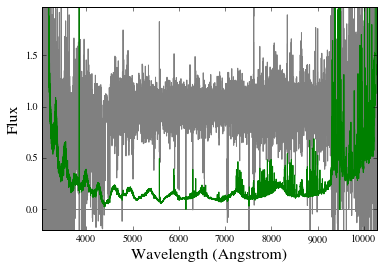

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ121201.68+324013.3.fits for BOSSJ1212+3240
S/N 2.99730665895 1 / Angstrom


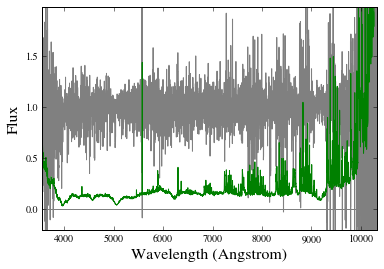

Using spec-6640-56385-0544.fits.gz for BOSSJ1213+4719
S/N 3.72556736869 1 / Angstrom


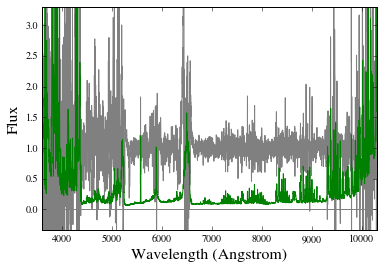

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ121558.80+571555.4.fits.gz for BOSSJ1215+5715
S/N 9.0646628842 1 / Angstrom


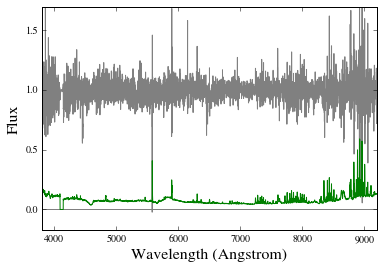

Using spec-6837-56442-0324.fits.gz for BOSSJ1225+5709
S/N 1.59355041712 1 / Angstrom


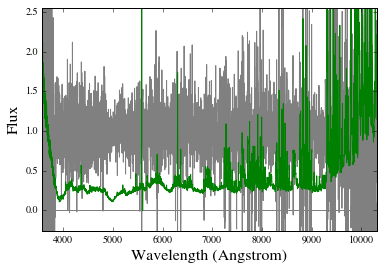

No spectrum found for BOSSJ1231+0029 and wvobs=11748 Angstrom!
Using spec-3970-55591-0870.fits.gz for BOSSJ1239+3955
S/N 0.801110484742 1 / Angstrom


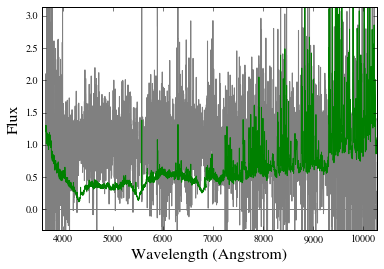

BOSSJ1242+5331 does not survive atmosphere cut
No spectrum found for BOSSJ1242+5331 and wvobs=7598.52 Angstrom!
Using spec-3972-55589-0570.fits.gz for BOSSJ1244+3916
S/N 3.56532862119 1 / Angstrom


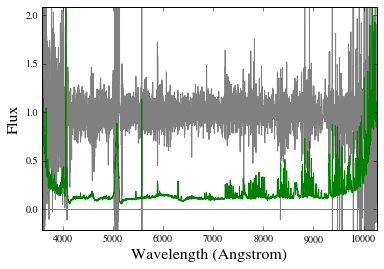

Using spec-6482-56358-0110.fits.gz for BOSSJ1244+3208
S/N 2.72082612337 1 / Angstrom


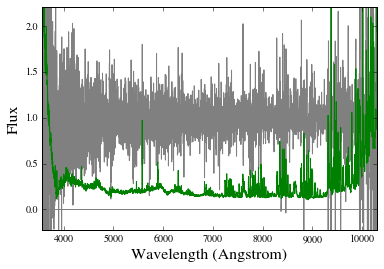

Using spec-6840-56685-0230.fits.gz for BOSSJ1245+5922
S/N 0.483931875874 1 / Angstrom


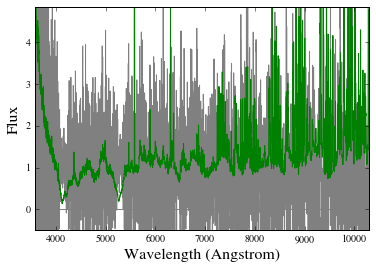

Using spec-5986-56328-0112.fits.gz for BOSSJ1246+2345
S/N 2.27252228185 1 / Angstrom


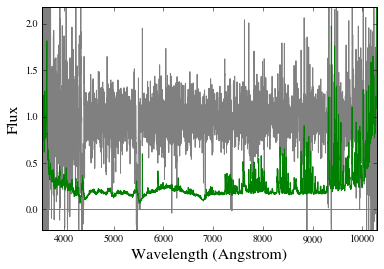

Using spec-4703-55617-0350.fits.gz for BOSSJ1248+4058
S/N 5.87116767045 1 / Angstrom


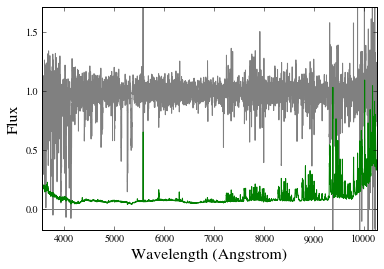

Using spec-6970-56444-0800.fits.gz for BOSSJ1253+6327
S/N 0.388015583333 1 / Angstrom


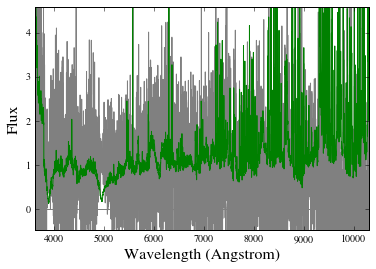

Using spec-5989-56312-0172.fits.gz for BOSSJ1255+2234
S/N 0.963157516138 1 / Angstrom


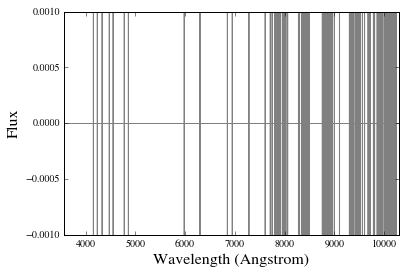

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ130125.67+475930.8.fits.gz for SDSSJ1301+4759
S/N 2.50494295115 1 / Angstrom


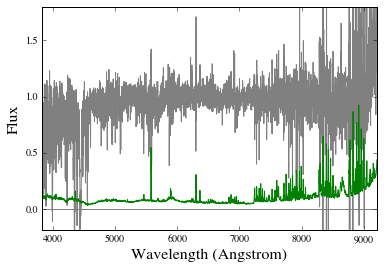

No spectrum found for APOJ1306+6158 and wvobs=8693.68 Angstrom!
Using spec-5422-55986-0346.fits.gz for BOSSJ1310+1134
S/N 0.579779596926 1 / Angstrom


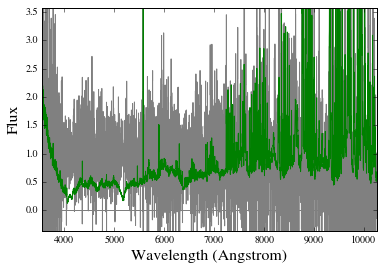

BOSSJ1319+2138 does not survive atmosphere cut
No spectrum found for BOSSJ1319+2138 and wvobs=7723.46 Angstrom!
Using spec-6828-56430-0134.fits.gz for BOSSJ1325+5409
S/N 3.91139494755 1 / Angstrom


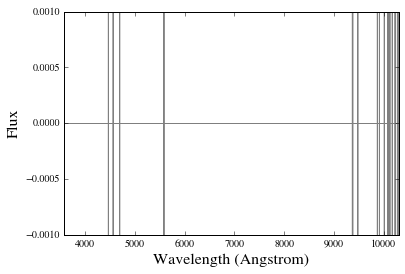

No spectrum found for APOJ1327+3423 and wvobs=7406.06 Angstrom!
Using spec-6626-56330-0556.fits.gz for BOSSJ1335+4330
S/N 0.478607100239 1 / Angstrom


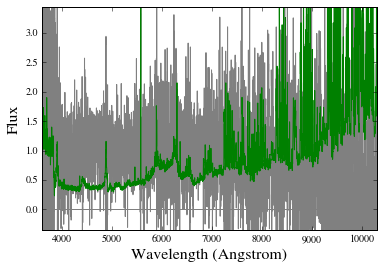

Using spec-5858-56063-0734.fits.gz for BOSSJ1346+1952
S/N 1.38833379698 1 / Angstrom


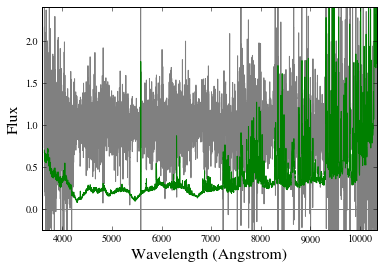

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ135629.53+613310.2.fits.gz for BOSSJ1356+6133
S/N 1.41392667034 1 / Angstrom


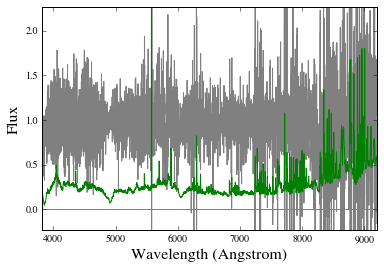

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ135849.54+273756.9.fits for APOJ1358+2737
S/N 3.45545455063 1 / Angstrom


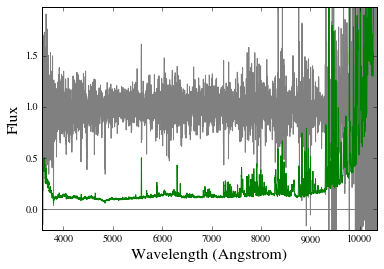

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ140209.53+470117.8.fits.gz for BOSSJ1402+4701
S/N 1.37236068111 1 / Angstrom


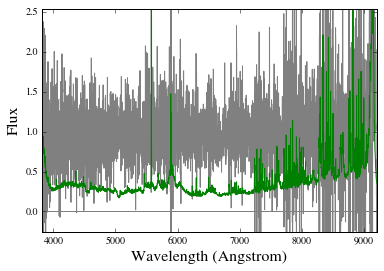

Using spec-6751-56368-0576.fits.gz for BOSSJ1410+4804
S/N 0.48976042172 1 / Angstrom


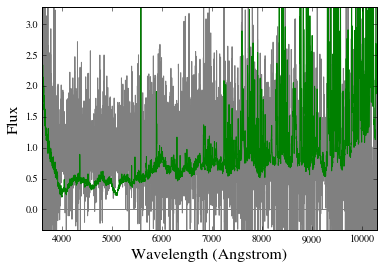

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ141337.96+271511.0.fits for SDSSJ1413+2715
S/N 13.2389480754 1 / Angstrom


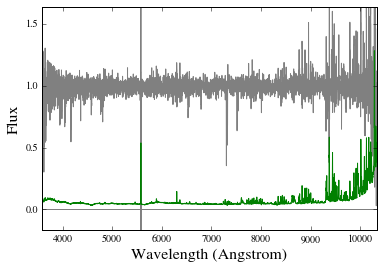

No spectrum found for BOSSJ1420+0227 and wvobs=12909.8 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142054.92+160342.9_F.fits.gz for APOJ1420+1603
S/N 34.7418613707 1 / Angstrom


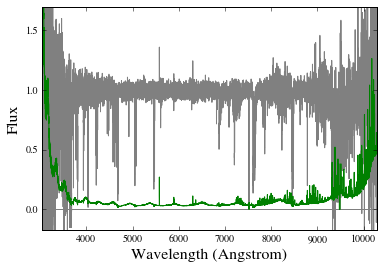

BOSSJ1422+4652 does not survive atmosphere cut
No spectrum found for BOSSJ1422+4652 and wvobs=7681.55 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ142758.74-012136.2_b1200_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142758.74-012136.2_F.fits.gz for BOSSJ1427-0121
S/N 35.6455711808 1 / Angstrom


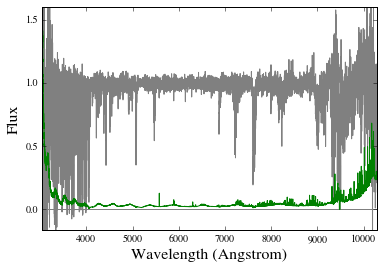

Using spec-6710-56416-0700.fits.gz for BOSSJ1428+5509
S/N 0.612818118579 1 / Angstrom


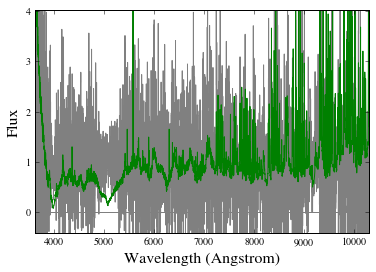

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ143109.22+572726.4.fits for APOJ1431+5727
S/N 3.6181182211 1 / Angstrom


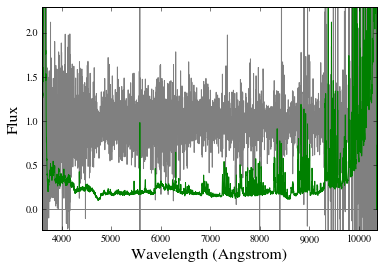

Using spec-5467-55973-0438.fits.gz for BOSSJ1433+0827
S/N 3.62912089324 1 / Angstrom


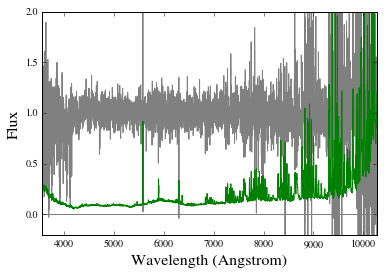

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_4_45/SDSSJ143344.55+064111.9.fits for BOSSJ1433+0641
S/N 4.73484139614 1 / Angstrom


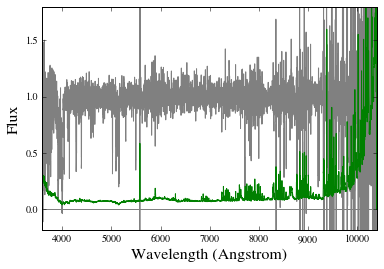

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ144231.91+013734.8.fits for BOSSJ1442+0137
S/N 8.76419878037 1 / Angstrom


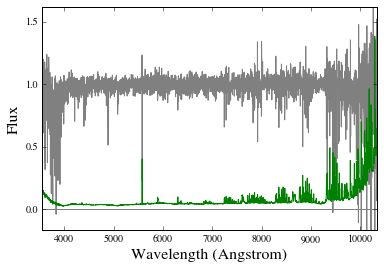

Using spec-6800-56399-0012.fits.gz for BOSSJ1448+5649
S/N 0.530348471545 1 / Angstrom


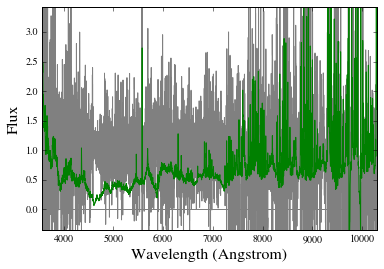

Using spec-4015-55624-0682.fits.gz for BOSSJ1457+0237
S/N 0.919666658052 1 / Angstrom


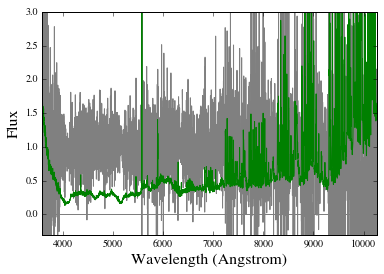

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ150812.80+363530.3.fits for BOSSJ1508+3635
S/N 3.19567778756 1 / Angstrom


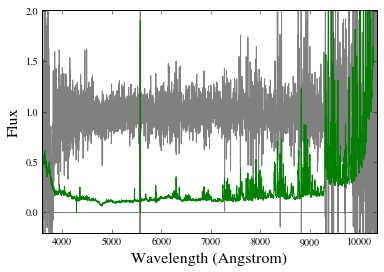

Using spec-3964-55648-0682.fits.gz for BOSSJ1515+2627
S/N 1.83538532676 1 / Angstrom


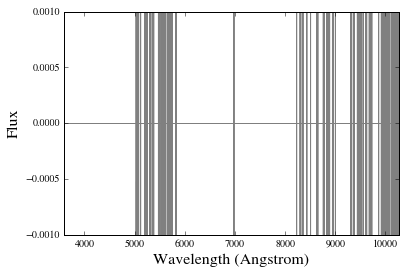

BOSSJ1517+2002 does not survive atmosphere cut
No spectrum found for BOSSJ1517+2002 and wvobs=7599.35 Angstrom!
Using spec-3953-55322-0392.fits.gz for BOSSJ1530+2515
S/N 0.597699801559 1 / Angstrom


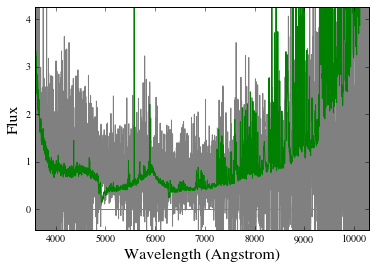

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ153329.17+142537.8.fits for BOSSJ1533+1425
S/N 5.65945699302 1 / Angstrom


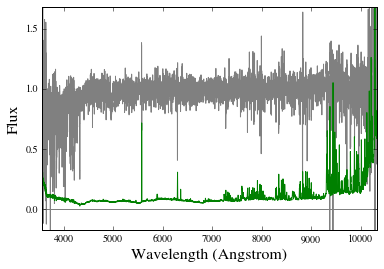

Using spec-3949-55650-0016.fits.gz for BOSSJ1534+2153
S/N 4.47390172101 1 / Angstrom


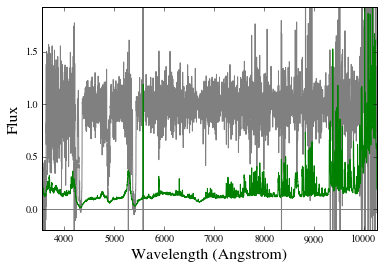

Using spec-6791-56429-0266.fits.gz for BOSSJ1538+5707
S/N 0.918226664604 1 / Angstrom


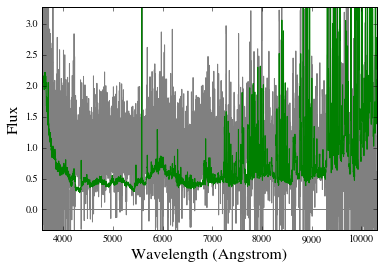

Using spec-4723-56033-0012.fits.gz for BOSSJ1539+3146
S/N 2.87864858724 1 / Angstrom


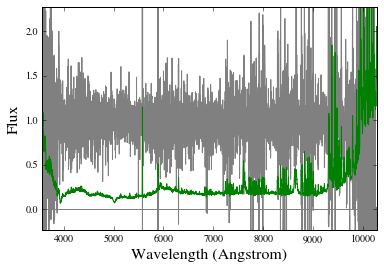

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ155325.89+192137.7_F.fits.gz for APOJ1553+1921
S/N 28.2784594603 1 / Angstrom


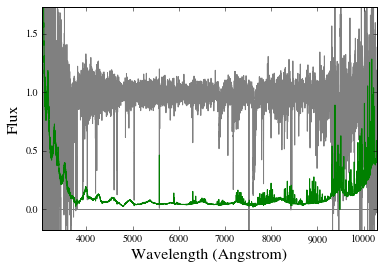

Using spec-4900-55739-0026.fits.gz for BOSSJ1554+1244
S/N 4.91977879663 1 / Angstrom


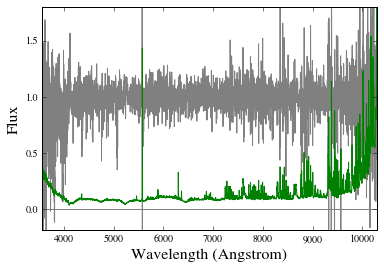

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ155622.54+304059.9.fits for BOSSJ1556+3040
S/N 0.793742808334 1 / Angstrom


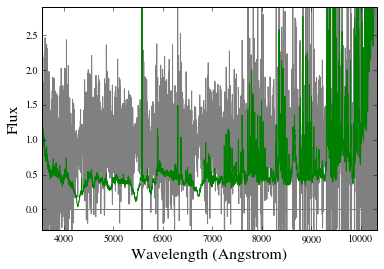

Using spec-4806-55688-0910.fits.gz for BOSSJ1557+0434
S/N 1.67352772391 1 / Angstrom


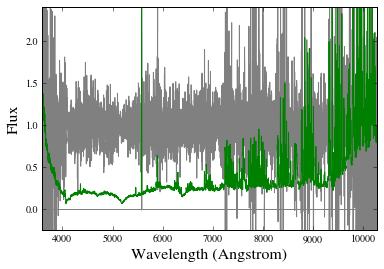

No spectrum found for APOJ1559+4943 and wvobs=7998.35 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ160546.67+511323.0.fits for BOSSJ1605+5113
S/N 11.398281721 1 / Angstrom


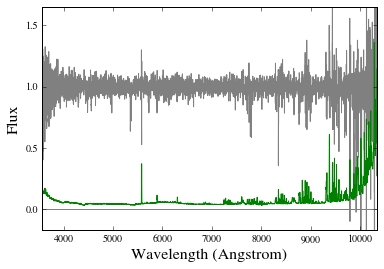

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ161817.31+184230.1.fits for BOSSJ1618+1842
S/N 0.4637711856 1 / Angstrom


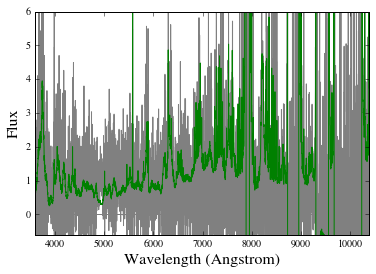

Using spec-4057-55357-0161.fits.gz for BOSSJ1619+1926
S/N 1.87282383952 1 / Angstrom


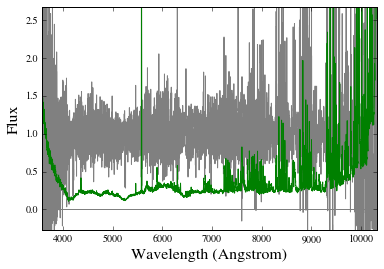

No spectrum found for BOSSJ1627+2215 and wvobs=11897.1 Angstrom!
No spectrum found for APOJ1627+4606 and wvobs=13463.2 Angstrom!
BOSSJ1628+2342 does not survive atmosphere cut
No spectrum found for BOSSJ1628+2342 and wvobs=7607.08 Angstrom!
Using spec-6030-56097-0378.fits.gz for BOSSJ1631+4333
S/N 1.83465760383 1 / Angstrom


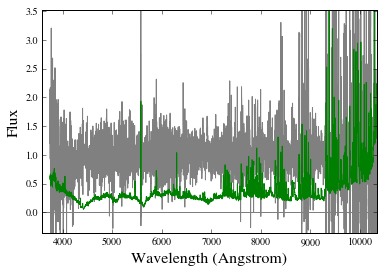

Using spec-5195-56048-0692.fits.gz for BOSSJ1631+3659
S/N 2.13256723689 1 / Angstrom


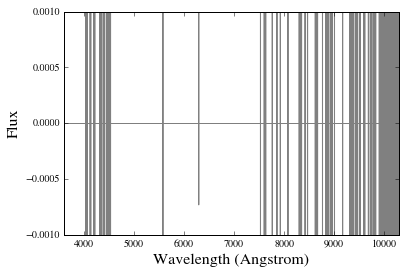

Using spec-4190-55686-0370.fits.gz for BOSSJ1635+2547
S/N 1.79184168897 1 / Angstrom


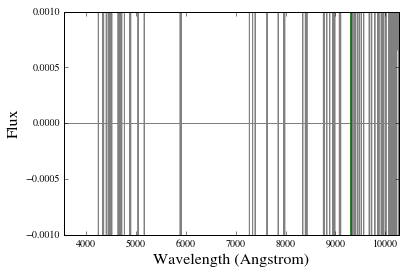

Using spec-5196-55831-0964.fits.gz for BOSSJ1651+3410
S/N 0.80605237028 1 / Angstrom


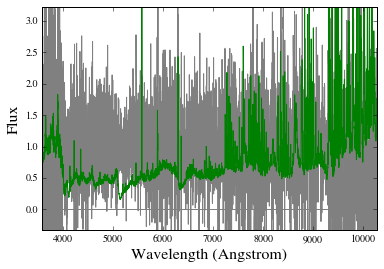

No spectrum found for BOSSJ1657+3105 and wvobs=8757.58 Angstrom!
Using spSpec-52443-0983-122.fit.gz for BOSSJ2053-0104
S/N 0.771083985876 1 / Angstrom


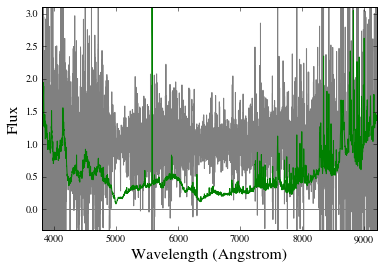

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ214620.98-075303.8_F.fits.gz for APOJ2146-0753
S/N 19.0978714623 1 / Angstrom


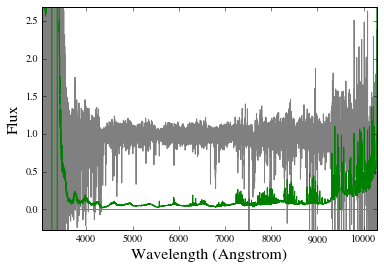

Using spec-4197-55479-0034.fits.gz for BOSSJ2156-0003
S/N 0.13371430653 1 / Angstrom


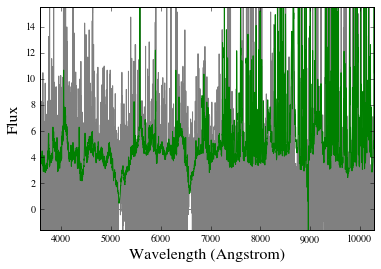

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ220248.31+123656.3.fits for BOSSJ2202+1236
S/N 3.35412230533 1 / Angstrom


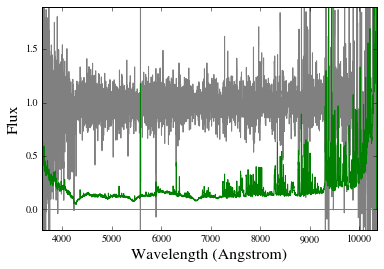

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ221226.36-001150.9.fits for BOSSJ2212-0011
S/N 0.169957719128 1 / Angstrom


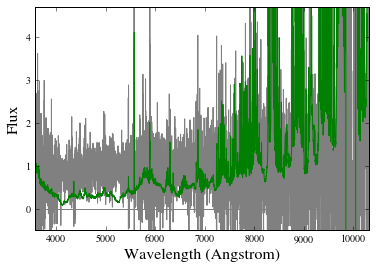

BOSSJ2255-0001 does not survive atmosphere cut
No spectrum found for BOSSJ2255-0001 and wvobs=7640.11 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ225549.55-000927.7.fits for BOSSJ2255-0009
S/N 3.94594168504 1 / Angstrom


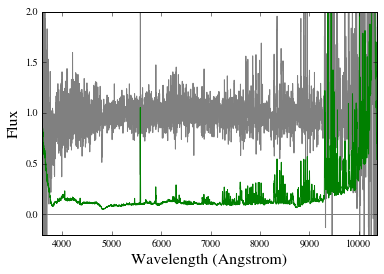

Using spec-4209-55478-0164.fits.gz for BOSSJ2314-0108
S/N 1.38310401328 1 / Angstrom


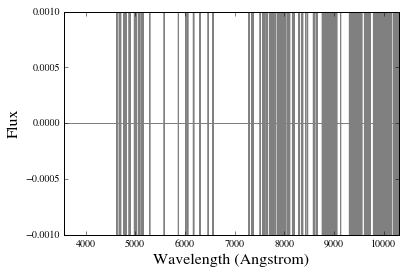

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ233845.45-000331.8.fits for BOSSJ2338-0003
S/N 0.6904877235 1 / Angstrom


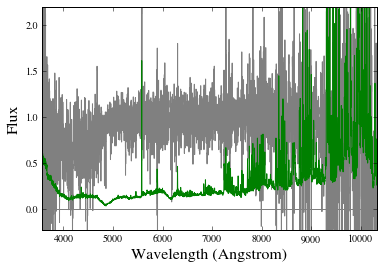

BOSSJ2341-0041 does not survive atmosphere cut
BOSSJ2341-0041 does not survive atmosphere cut
No spectrum found for BOSSJ2341-0041 and wvobs=7637.36 Angstrom!
Using spec-4214-55451-0870.fits.gz for BOSSJ2348+0110
S/N 1.89935084568 1 / Angstrom


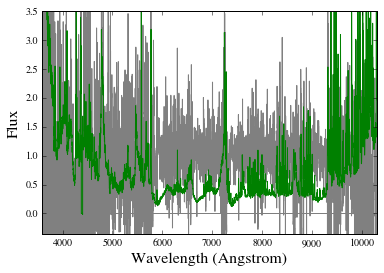

BOSSJ2352-0015 does not survive atmosphere cut
No spectrum found for BOSSJ2352-0015 and wvobs=7627.15 Angstrom!
BOSSJ2354-0019 does not survive atmosphere cut
No spectrum found for BOSSJ2354-0019 and wvobs=7700.92 Angstrom!


In [16]:
stack_tup0 = qpq9k.qpq9_IRMgII(passback=True,wrest=2796.352*u.AA,zfg_mnx=(1.6,9999),atmosphere_cut=True)
fin_velo, stck_img, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
    if 'J0822+1319' in dd['qpq']['NAME']: #BAL
        idx_mask.append(ii) 
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [17]:
np.sum(stck_mskN,0)

array([ 144.,  144.,  143.,  143.,  143.,  143.,  143.,  143.,  143.,
        143.,  143.,  143.,  144.,  144.,  144.,  144.,  143.,  143.,
        143.,  143.,  143.,  143.,  143.,  143.,  143.,  143.,  144.,
        144.,  144.,  144.,  144.,  144.,  144.,  144.,  144.,  144.,
        144.,  144.,  144.,  144.,  144.,  144.,  144.,  144.,  144.,
        144.,  144.,  144.,  144.,  144.,  144.,  144.,  144.,  144.,
        144.,  144.,  144.,  144.,  144.,  144.,  144.])

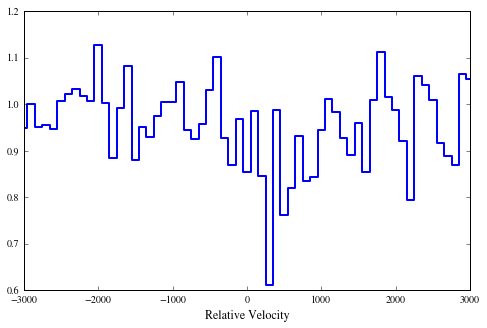

In [18]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)

## Measure equivalent width of MgII stack at z ~ 1 

Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits
No spectrum found for BOSSJ0003-0022 and wvobs=4248.22 Angstrom!
No spectrum found for BOSSJ0012+0115 and wvobs=4207.58 Angstrom!
Using spec-6185-56217-0318.fits.gz for BOSSJ0021+1602
S/N 5.77527243714 1 / Angstrom


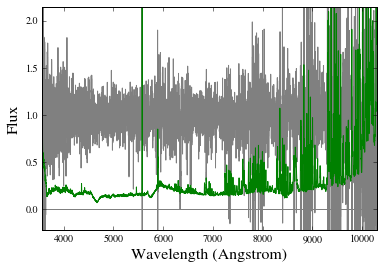

No spectrum found for BOSSJ0024+0032 and wvobs=3922.11 Angstrom!
No spectrum found for BOSSJ0025-0054 and wvobs=4366.76 Angstrom!
No spectrum found for BOSSJ0026+1354 and wvobs=6485.16 Angstrom!
No spectrum found for BOSSJ0029+0001 and wvobs=5537.44 Angstrom!
No spectrum found for BOSSJ0030+0054 and wvobs=6873.68 Angstrom!
Using spec-6192-56269-0188.fits.gz for BOSSJ0033+1546
S/N 7.6085096335 1 / Angstrom


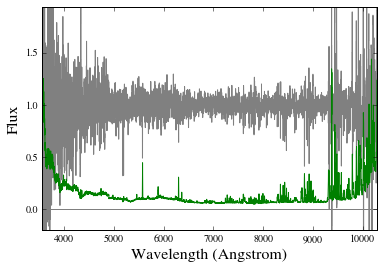

No spectrum found for BOSSJ0036+1609 and wvobs=4097.89 Angstrom!
No spectrum found for BOSSJ0039-0007 and wvobs=5626.85 Angstrom!
No spectrum found for BOSSJ0040+1409 and wvobs=4677.35 Angstrom!
No spectrum found for BOSSJ0041+0115 and wvobs=6144.67 Angstrom!
No spectrum found for BOSSJ0041+1355 and wvobs=5263.96 Angstrom!
No spectrum found for BOSSJ0044-0042 and wvobs=4357.09 Angstrom!
No spectrum found for BOSSJ0045+0011 and wvobs=7019.27 Angstrom!
No spectrum found for BOSSJ0056+0103 and wvobs=6156.38 Angstrom!
No spectrum found for BOSSJ0057-0100 and wvobs=4612.23 Angstrom!
No spectrum found for BOSSJ0058+0013 and wvobs=6265.88 Angstrom!
No spectrum found for BOSSJ0100-0031 and wvobs=4856.13 Angstrom!
Using spec-5131-55835-0432.fits.gz for BOSSJ0103+1501
S/N 22.9973549837 1 / Angstrom


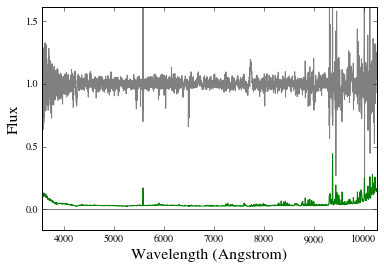

Using spec-4226-55475-0874.fits.gz for BOSSJ0109+0104
S/N 12.1001604663 1 / Angstrom


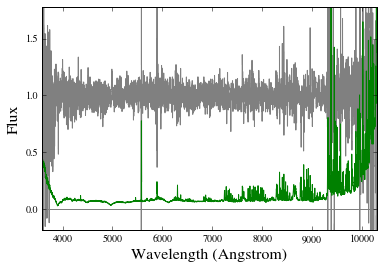

No spectrum found for BOSSJ0110+0002 and wvobs=4412.44 Angstrom!
Using spec-4227-55481-0650.fits.gz for BOSSJ0112+0019
S/N 9.34182152011 1 / Angstrom


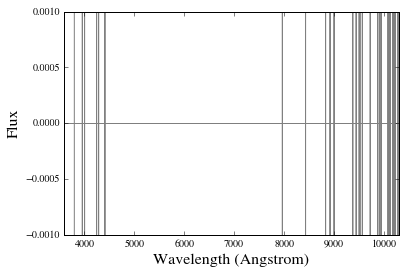

No spectrum found for BOSSJ0114+0004 and wvobs=4068.28 Angstrom!
No spectrum found for BOSSJ0121+1329 and wvobs=6722.48 Angstrom!
Using spec-4228-55484-0190.fits.gz for BOSSJ0122-0032
S/N 6.05423182321 1 / Angstrom


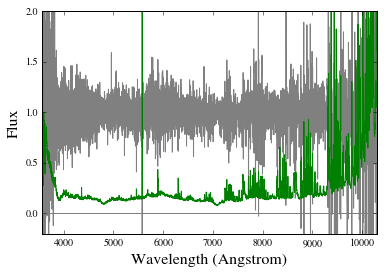

Using spec-4229-55501-0182.fits.gz for BOSSJ0129-0032
S/N 8.4139668618 1 / Angstrom


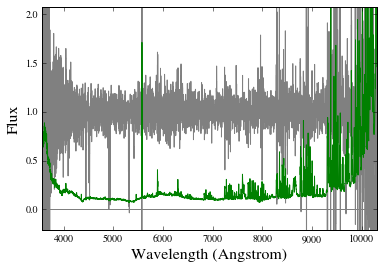

Using spec-4230-55483-0595.fits.gz for BOSSJ0131+0047
S/N 6.90156876823 1 / Angstrom


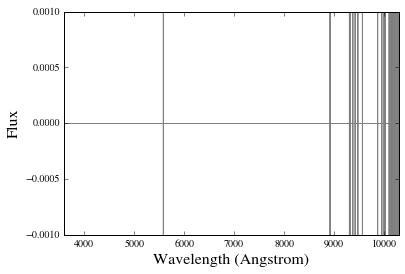

No spectrum found for BOSSJ0134-0014 and wvobs=5670.03 Angstrom!
No spectrum found for BOSSJ0135-0041 and wvobs=5610.4 Angstrom!
Using spec-5130-55835-0460.fits.gz for BOSSJ0138+1443
S/N 7.78550018075 1 / Angstrom


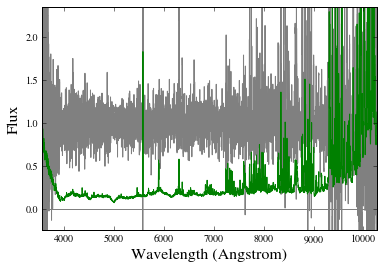

No spectrum found for BOSSJ0143+0108 and wvobs=6598.64 Angstrom!
Using spSpec-52914-1076-331.fit.gz for BOSSJ0146+0015
S/N 10.9866764975 1 / Angstrom


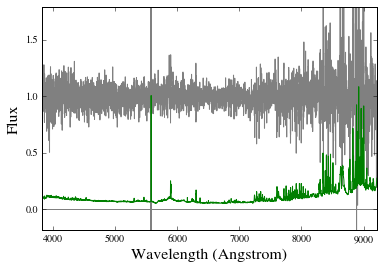

Using spSpec-52914-1076-331.fit.gz for BOSSJ0146+0015
S/N 9.55923015694 1 / Angstrom


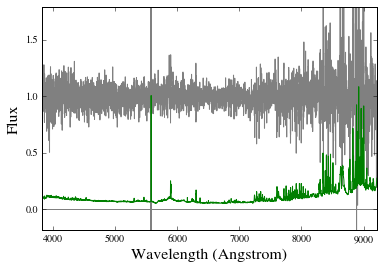

No spectrum found for BOSSJ0148+0012 and wvobs=6984.83 Angstrom!
Using spSpec-51793-0402-408.fit.gz for BOSSJ0151+0056
S/N 10.6600445495 1 / Angstrom


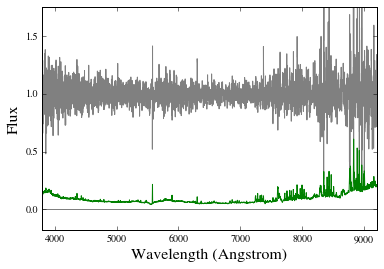

No spectrum found for BOSSJ0152+1409 and wvobs=4365.24 Angstrom!
Using spec-7165-56603-0456.fits.gz for BOSSJ0152-0758
S/N 16.8933474746 1 / Angstrom


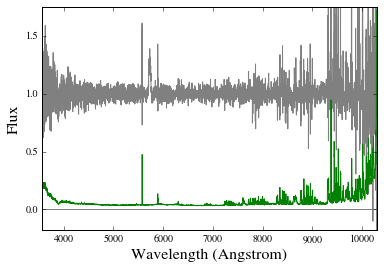

No spectrum found for BOSSJ0153-0018 and wvobs=5258.4 Angstrom!
No spectrum found for BOSSJ0154+0046 and wvobs=5200.22 Angstrom!
Using spec-4236-55479-0786.fits.gz for BOSSJ0215+0109
S/N 10.1177118553 1 / Angstrom


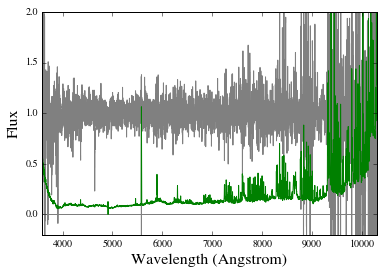

No spectrum found for BOSSJ0219-0044 and wvobs=4714.18 Angstrom!
No spectrum found for BOSSJ0221-0010 and wvobs=5691.47 Angstrom!
Using spec-6782-56572-0317.fits.gz for BOSSJ0243-0010
S/N 10.6633382019 1 / Angstrom


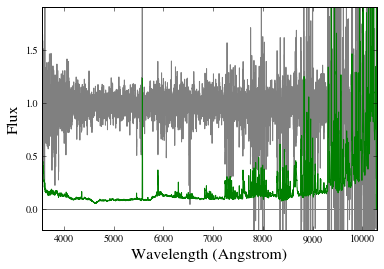

Using spec-4242-55476-0657.fits.gz for BOSSJ0253+0016
S/N 16.7121288277 1 / Angstrom


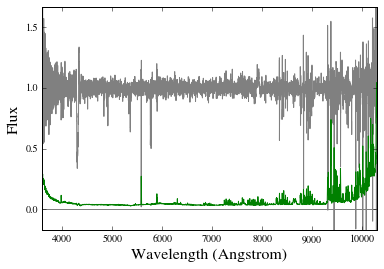

No spectrum found for BOSSJ0255-0734 and wvobs=6911.12 Angstrom!
Using spSpec-51816-0410-539.fit.gz for BOSSJ0255+0053
S/N 13.1684961811 1 / Angstrom


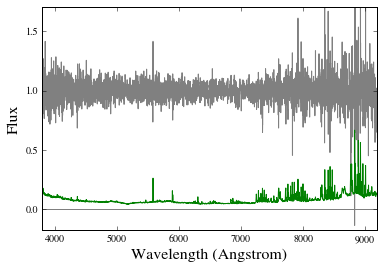

Using spSpec-52614-1068-094.fit.gz for BOSSJ0256-0114
S/N 6.94224535056 1 / Angstrom


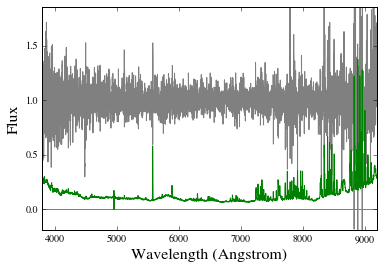

No spectrum found for BOSSJ0300-0030 and wvobs=7021.07 Angstrom!
No spectrum found for BOSSJ0332+0030 and wvobs=3978.09 Angstrom!
No spectrum found for BOSSJ0336-0619 and wvobs=4023.48 Angstrom!
No spectrum found for BOSSJ0338-0023 and wvobs=6132.65 Angstrom!
No spectrum found for BOSSJ0339+0029 and wvobs=4298.28 Angstrom!
No spectrum found for BOSSJ0747+3248 and wvobs=6771.03 Angstrom!
No spectrum found for BOSSJ0752+4302 and wvobs=6814.75 Angstrom!
No spectrum found for BOSSJ0754+3636 and wvobs=4439.93 Angstrom!
No spectrum found for BOSSJ0757+5110 and wvobs=7171.19 Angstrom!
No spectrum found for BOSSJ0804+3156 and wvobs=5722.81 Angstrom!
No spectrum found for BOSSJ0804+5300 and wvobs=6742.89 Angstrom!
Using spSpec-53713-2267-266.fit.gz for BOSSJ0805+1506
S/N 6.95328621358 1 / Angstrom


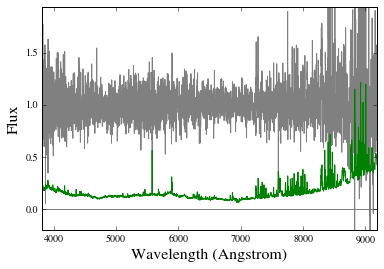

Using spec-4481-55630-0392.fits.gz for BOSSJ0806+2100
S/N 6.5073924871 1 / Angstrom


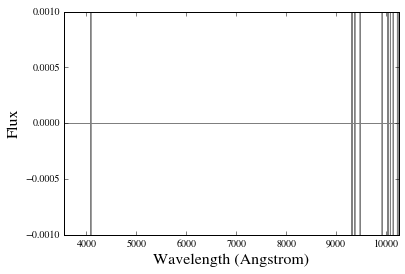

No spectrum found for BOSSJ0806+2332 and wvobs=6369.79 Angstrom!
No spectrum found for BOSSJ0807+0955 and wvobs=6372.56 Angstrom!
No spectrum found for BOSSJ0809+0743 and wvobs=4621.32 Angstrom!
No spectrum found for BOSSJ0814+4604 and wvobs=6465.96 Angstrom!
No spectrum found for BOSSJ0815+0717 and wvobs=5917.14 Angstrom!
Using spec-3701-55540-0828.fits.gz for BOSSJ0815+5501
S/N 8.57642457862 1 / Angstrom


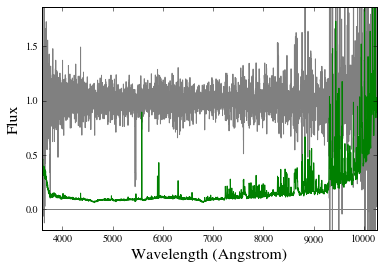

No spectrum found for BOSSJ0820+2905 and wvobs=7071.14 Angstrom!
No spectrum found for BOSSJ0820+5828 and wvobs=3981.53 Angstrom!
Using spec-4504-55571-0020.fits.gz for BOSSJ0822+1319
S/N 13.2231714071 1 / Angstrom


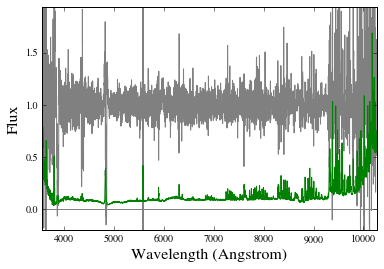

No spectrum found for BOSSJ0825+4559 and wvobs=6274.17 Angstrom!
Using spec-7325-56717-0804.fits.gz for BOSSJ0828+4637
S/N 6.32885401954 1 / Angstrom


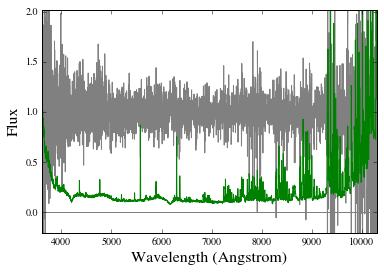

No spectrum found for BOSSJ0830+0716 and wvobs=5146.29 Angstrom!
No spectrum found for BOSSJ0832+5034 and wvobs=4281.19 Angstrom!
No spectrum found for BOSSJ0832+5243 and wvobs=7214.5 Angstrom!
No spectrum found for BOSSJ0833+3356 and wvobs=4355.13 Angstrom!
No spectrum found for BOSSJ0833+2349 and wvobs=3981.11 Angstrom!
No spectrum found for BOSSJ0836+3143 and wvobs=5925.46 Angstrom!
No spectrum found for BOSSJ0837+2209 and wvobs=7046.45 Angstrom!
Using spSpec-52937-1269-291.fit.gz for BOSSJ0838+2933
S/N 5.53037097544 1 / Angstrom


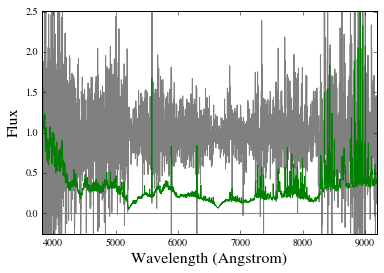

Using spec-5286-56225-0548.fits.gz for BOSSJ0838+1715
S/N 8.34054349691 1 / Angstrom


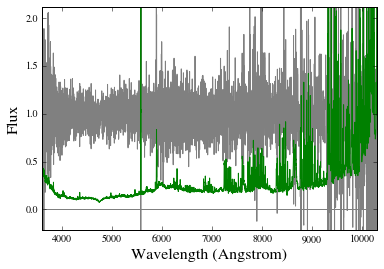

Using spec-4445-55869-0030.fits.gz for BOSSJ0841+3200
S/N 6.47647094727 1 / Angstrom


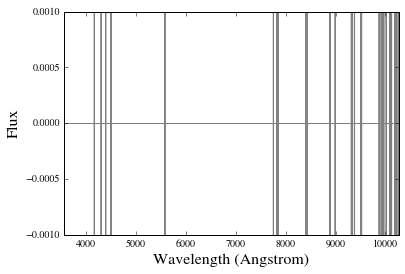

Using spec-4472-55893-0192.fits.gz for BOSSJ0841+2222
S/N 6.09386176326 1 / Angstrom


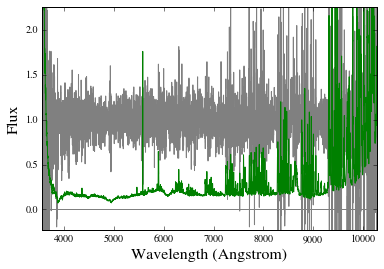

No spectrum found for BOSSJ0841+4052 and wvobs=4939.03 Angstrom!
No spectrum found for BOSSJ0841+3215 and wvobs=7211.13 Angstrom!
No spectrum found for BOSSJ0842+4733 and wvobs=7148.5 Angstrom!
No spectrum found for BOSSJ0846+5206 and wvobs=5174.34 Angstrom!
Using spSpec-53801-2428-064.fit.gz for BOSSJ0848+1200
S/N 6.31677827051 1 / Angstrom


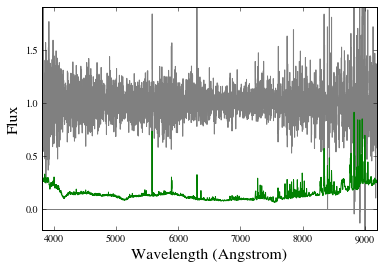

Using spSpec-52972-1589-230.fit.gz for BOSSJ0849+2832
S/N 15.8838561402 1 / Angstrom


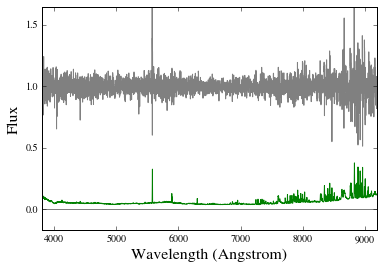

Using spec-3813-55532-0114.fits.gz for BOSSJ0854+0147
S/N 6.92281516241 1 / Angstrom


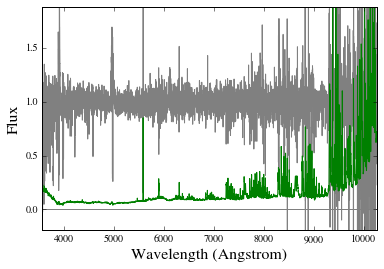

No spectrum found for BOSSJ0857+0050 and wvobs=5463.38 Angstrom!
Using spSpec-52293-0830-620.fit.gz for BOSSJ0859+4241
S/N 8.20296525272 1 / Angstrom


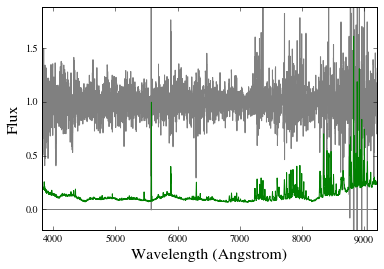

Using spec-3818-55532-0566.fits.gz for BOSSJ0902+0024
S/N 5.76785441452 1 / Angstrom


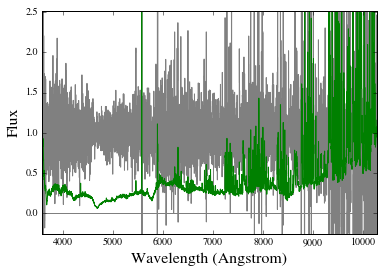

No spectrum found for BOSSJ0902+1752 and wvobs=5997.67 Angstrom!
No spectrum found for BOSSJ0903+2056 and wvobs=6308.85 Angstrom!
Using spSpec-51924-0471-181.fit.gz for BOSSJ0907+0117
S/N 5.7012081284 1 / Angstrom


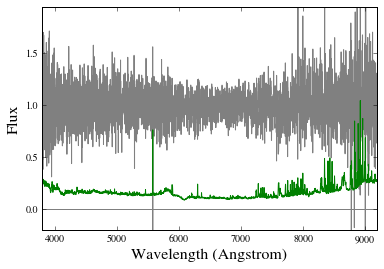

Using spec-4603-55999-0276.fits.gz for BOSSJ0908+4215
S/N 10.2989722136 1 / Angstrom


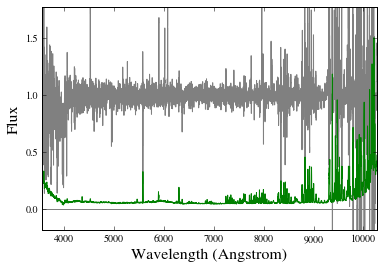

No spectrum found for BOSSJ0909+3421 and wvobs=6125.26 Angstrom!
No spectrum found for BOSSJ0911+1456 and wvobs=6355.18 Angstrom!
No spectrum found for BOSSJ0912+1510 and wvobs=4572.43 Angstrom!
No spectrum found for BOSSJ0912-0036 and wvobs=4890.25 Angstrom!
No spectrum found for BOSSJ0913+6036 and wvobs=6454.34 Angstrom!
No spectrum found for BOSSJ0913+0720 and wvobs=3982.18 Angstrom!
No spectrum found for BOSSJ0915+0721 and wvobs=4959.38 Angstrom!
No spectrum found for BOSSJ0916+4124 and wvobs=4962.72 Angstrom!
No spectrum found for BOSSJ0920+3306 and wvobs=6729.74 Angstrom!
Using spec-4870-55923-0228.fits.gz for BOSSJ0922+0627
S/N 9.55034462325 1 / Angstrom


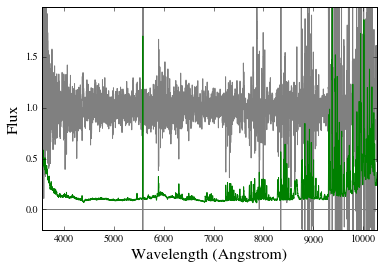

Using spec-5774-56002-0838.fits.gz for BOSSJ0925+2418
S/N 11.0583574731 1 / Angstrom


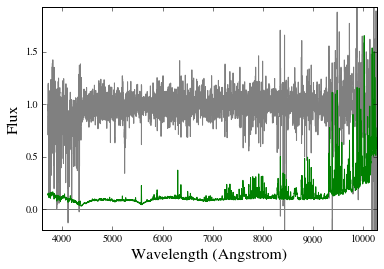

No spectrum found for BOSSJ0926+4724 and wvobs=5405.51 Angstrom!
Using spSpec-52254-0568-082.fit.gz for BOSSJ0927+0243
S/N 10.7822855587 1 / Angstrom


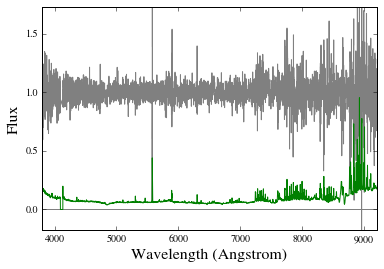

No spectrum found for BOSSJ0929+3509 and wvobs=4653.69 Angstrom!
No spectrum found for BOSSJ0929+3951 and wvobs=5755.22 Angstrom!
No spectrum found for BOSSJ0929+1816 and wvobs=7260.01 Angstrom!
No spectrum found for BOSSJ0931+6011 and wvobs=6866.15 Angstrom!
Using spec-5805-56336-0570.fits.gz for BOSSJ0931+3416
S/N 8.30292167418 1 / Angstrom


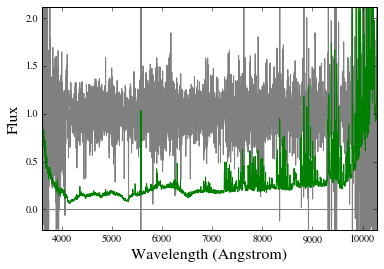

Using spec-5803-56272-0049.fits.gz for BOSSJ0932+2840
S/N 7.49239286535 1 / Angstrom


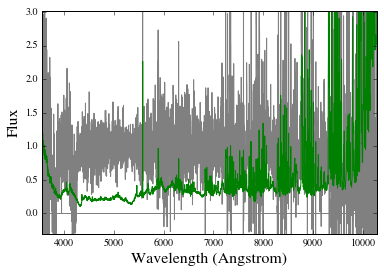

No spectrum found for BOSSJ0932+1001 and wvobs=5600.76 Angstrom!
No spectrum found for BOSSJ0933+5330 and wvobs=6532.78 Angstrom!
No spectrum found for BOSSJ0936+5908 and wvobs=4825.6 Angstrom!
No spectrum found for BOSSJ0936+4613 and wvobs=5280.63 Angstrom!
Using spec-4871-55928-0005.fits.gz for BOSSJ0937+0632
S/N 13.5910198427 1 / Angstrom


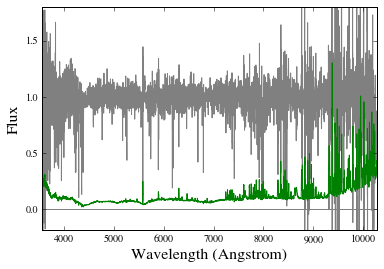

No spectrum found for BOSSJ0938+4052 and wvobs=5643.41 Angstrom!
No spectrum found for BOSSJ0939+3336 and wvobs=7084.59 Angstrom!
No spectrum found for BOSSJ0941+3058 and wvobs=6136.49 Angstrom!
No spectrum found for BOSSJ0941+3251 and wvobs=5783.4 Angstrom!
No spectrum found for BOSSJ0942+0716 and wvobs=5043.25 Angstrom!
Using spec-5715-56657-0664.fits.gz for BOSSJ0943+5842
S/N 13.1967059034 1 / Angstrom


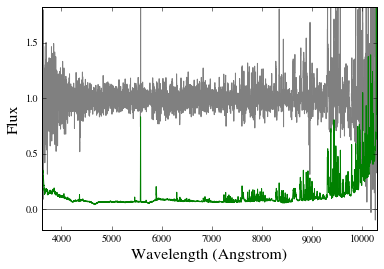

No spectrum found for BOSSJ0944+4807 and wvobs=5913.38 Angstrom!
No spectrum found for BOSSJ0944+2321 and wvobs=7060.62 Angstrom!
No spectrum found for BOSSJ0944+4514 and wvobs=6831.19 Angstrom!
No spectrum found for BOSSJ0948+0022 and wvobs=4432.58 Angstrom!
No spectrum found for BOSSJ0949+5603 and wvobs=4904.71 Angstrom!
No spectrum found for BOSSJ0949+1753 and wvobs=4737.13 Angstrom!
Using spec-5719-56014-0340.fits.gz for BOSSJ0952+5909
S/N 9.60892823844 1 / Angstrom


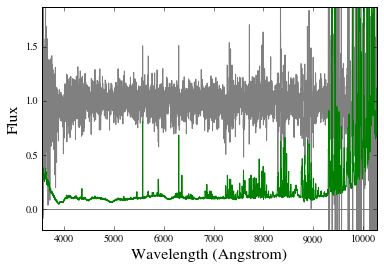

No spectrum found for BOSSJ0952+0429 and wvobs=4828.61 Angstrom!
No spectrum found for BOSSJ0952+2746 and wvobs=4434.87 Angstrom!
No spectrum found for BOSSJ0953+5644 and wvobs=5426.03 Angstrom!
No spectrum found for BOSSJ0954+2053 and wvobs=5748.43 Angstrom!
No spectrum found for BOSSJ0957+2509 and wvobs=6086.48 Angstrom!
Using spSpec-53433-1949-410.fit.gz for BOSSJ0958+3322
S/N 6.07114757491 1 / Angstrom


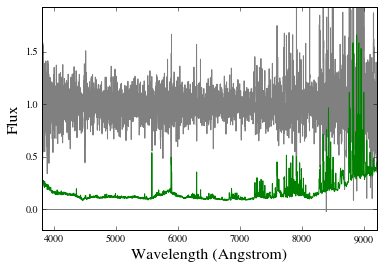

No spectrum found for BOSSJ0959+1114 and wvobs=6833.32 Angstrom!
Using spec-7284-56683-0223.fits.gz for BOSSJ0959+4530
S/N 8.14318530001 1 / Angstrom


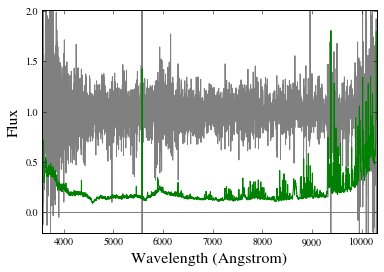

No spectrum found for BOSSJ0959+0511 and wvobs=7247.85 Angstrom!
No spectrum found for BOSSJ1000+2752 and wvobs=6169.12 Angstrom!
No spectrum found for BOSSJ1003+2746 and wvobs=4739.51 Angstrom!
No spectrum found for BOSSJ1004+0938 and wvobs=4781.26 Angstrom!
Using spec-5332-55981-0467.fits.gz for BOSSJ1006+1650
S/N 7.78070070162 1 / Angstrom


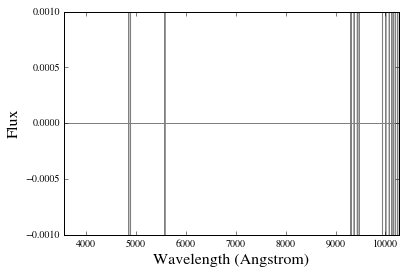

No spectrum found for BOSSJ1006+4613 and wvobs=5631.94 Angstrom!
Using spec-4693-55632-0734.fits.gz for BOSSJ1006+4455
S/N 12.1321231618 1 / Angstrom


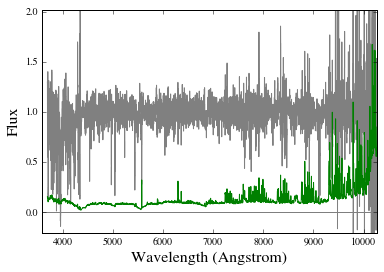

Using spec-6469-56328-0810.fits.gz for BOSSJ1010+2953
S/N 6.92894486156 1 / Angstrom


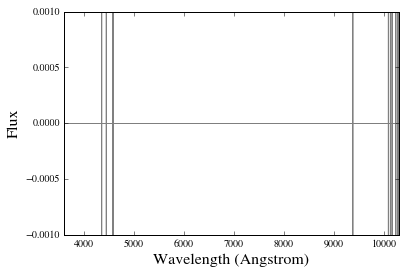

Using spec-6466-56310-0204.fits.gz for BOSSJ1011+2415
S/N 6.64705351412 1 / Angstrom


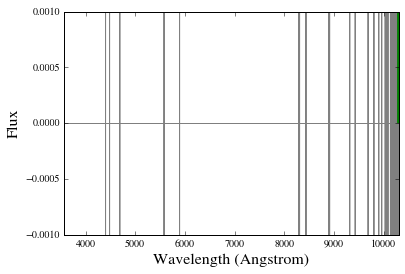

No spectrum found for BOSSJ1012+5135 and wvobs=4674.54 Angstrom!
No spectrum found for BOSSJ1012+1345 and wvobs=3991.03 Angstrom!
No spectrum found for BOSSJ1014+0349 and wvobs=5588.9 Angstrom!
Using spSpec-52355-0574-515.fit.gz for BOSSJ1016+0419
S/N 6.50068541881 1 / Angstrom


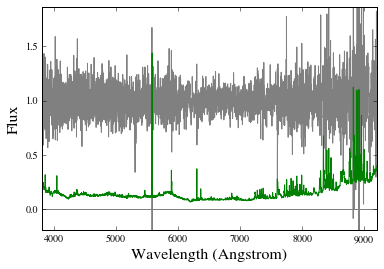

Using spec-6658-56606-0446.fits.gz for BOSSJ1017+4740
S/N 15.8301344015 1 / Angstrom


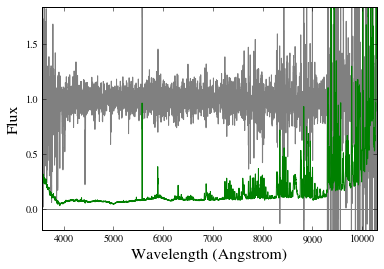

No spectrum found for BOSSJ1018+2913 and wvobs=4960.13 Angstrom!
No spectrum found for BOSSJ1020+4323 and wvobs=5931.89 Angstrom!
Using spec-6456-56339-0518.fits.gz for BOSSJ1022+2925
S/N 14.4047390245 1 / Angstrom


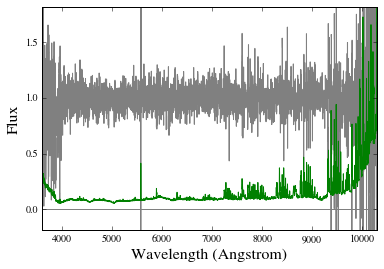

No spectrum found for BOSSJ1022+2945 and wvobs=6111.6 Angstrom!
No spectrum found for BOSSJ1023+1220 and wvobs=5546.72 Angstrom!
No spectrum found for BOSSJ1024+3222 and wvobs=5814.12 Angstrom!
No spectrum found for BOSSJ1024+4051 and wvobs=6850.41 Angstrom!
No spectrum found for BOSSJ1025+3156 and wvobs=6239.82 Angstrom!
No spectrum found for BOSSJ1032+1850 and wvobs=6971.08 Angstrom!
Using spec-6425-56298-0102.fits.gz for BOSSJ1035+2250
S/N 25.7159968464 1 / Angstrom


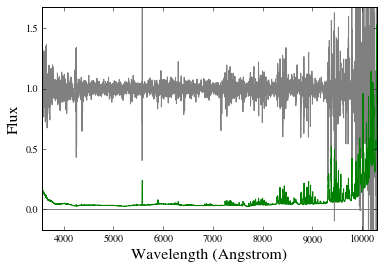

No spectrum found for BOSSJ1037+4401 and wvobs=5671.6 Angstrom!
No spectrum found for BOSSJ1037+0736 and wvobs=3956.99 Angstrom!
Using spec-7097-56667-0830.fits.gz for BOSSJ1039+6336
S/N 6.48829079296 1 / Angstrom


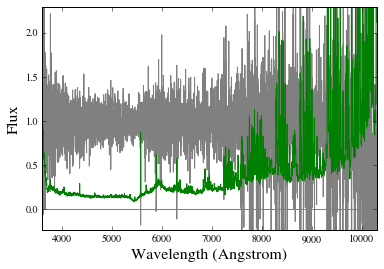

No spectrum found for BOSSJ1040+4529 and wvobs=6931.25 Angstrom!
Using spec-6452-56366-0844.fits.gz for BOSSJ1041+2929
S/N 8.5069076815 1 / Angstrom


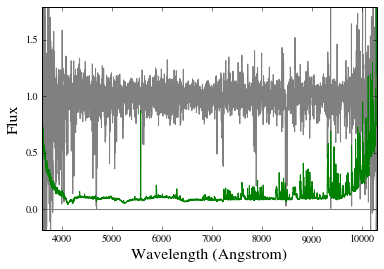

Using spec-6703-56636-0396.fits.gz for BOSSJ1041+5233
S/N 25.3337318462 1 / Angstrom


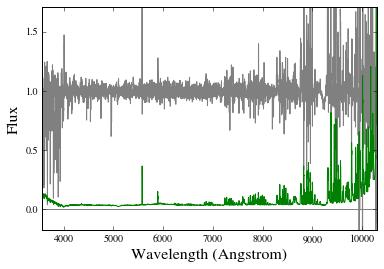

Using spec-4852-55689-0978.fits.gz for BOSSJ1042+0645
S/N 5.93290775978 1 / Angstrom


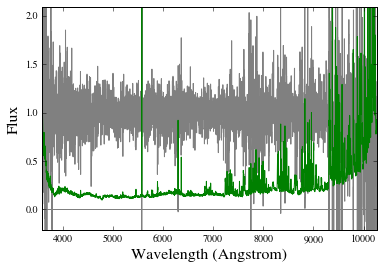

No spectrum found for BOSSJ1044+4652 and wvobs=4809.51 Angstrom!
No spectrum found for BOSSJ1044+6138 and wvobs=5871.48 Angstrom!
No spectrum found for BOSSJ1044+2957 and wvobs=5927.06 Angstrom!
Using spec-6448-56365-0102.fits.gz for BOSSJ1045+3103
S/N 8.90494551961 1 / Angstrom


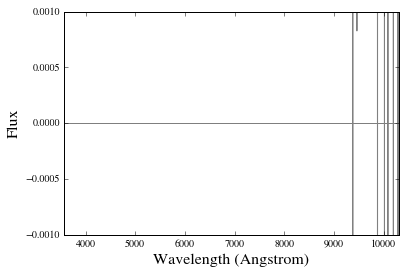

No spectrum found for BOSSJ1046+0821 and wvobs=5182.51 Angstrom!
No spectrum found for BOSSJ1046+4717 and wvobs=7084.5 Angstrom!
Using spec-6445-56366-0604.fits.gz for BOSSJ1049+3133
S/N 10.8648511502 1 / Angstrom


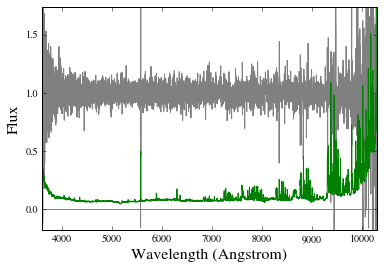

No spectrum found for BOSSJ1050+6028 and wvobs=5492.87 Angstrom!
Using spec-5356-55979-0514.fits.gz for BOSSJ1050+1030
S/N 12.7703289806 1 / Angstrom


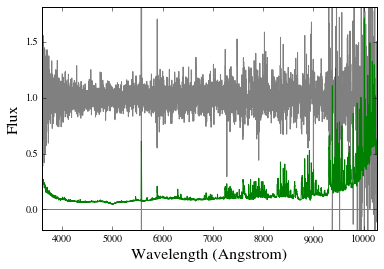

Using spec-4628-55646-0087.fits.gz for BOSSJ1052+4053
S/N 11.1509966427 1 / Angstrom


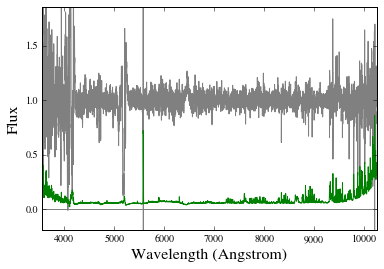

No spectrum found for BOSSJ1056+0736 and wvobs=5199.28 Angstrom!
No spectrum found for BOSSJ1056+1003 and wvobs=6365.64 Angstrom!
Using spec-6445-56366-0036.fits.gz for BOSSJ1056+3048
S/N 16.7242427585 1 / Angstrom


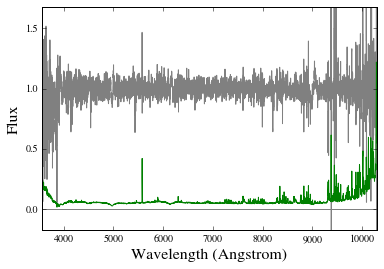

No spectrum found for BOSSJ1059+3755 and wvobs=4641.72 Angstrom!
No spectrum found for BOSSJ1059+2804 and wvobs=6063.67 Angstrom!
Using spec-6693-56384-0170.fits.gz for BOSSJ1106+4705
S/N 16.187503431 1 / Angstrom


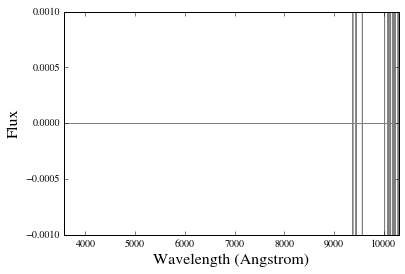

No spectrum found for BOSSJ1106+1406 and wvobs=6613.63 Angstrom!
Using spec-6440-56370-0652.fits.gz for BOSSJ1108+3306
S/N 8.23150125985 1 / Angstrom


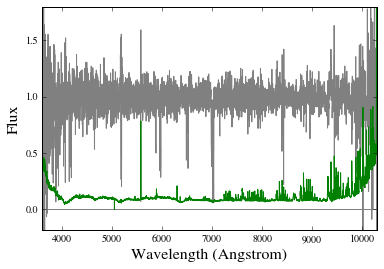

No spectrum found for BOSSJ1108+4520 and wvobs=4951.79 Angstrom!
No spectrum found for BOSSJ1111+3515 and wvobs=7125.06 Angstrom!
No spectrum found for BOSSJ1111+0811 and wvobs=5341.87 Angstrom!
No spectrum found for BOSSJ1112+2300 and wvobs=6820.06 Angstrom!
No spectrum found for BOSSJ1112+1129 and wvobs=5962.17 Angstrom!
Using spec-6649-56364-0080.fits.gz for BOSSJ1112+4548
S/N 6.81902988471 1 / Angstrom


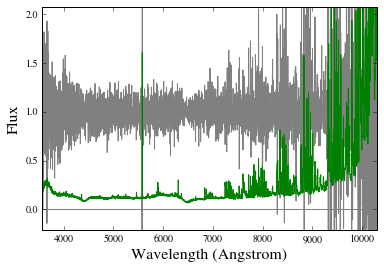

No spectrum found for BOSSJ1112+6018 and wvobs=5169.35 Angstrom!
No spectrum found for BOSSJ1114+3149 and wvobs=6087.45 Angstrom!
Using spec-5364-56000-0992.fits.gz for BOSSJ1115+1218
S/N 17.0597602175 1 / Angstrom


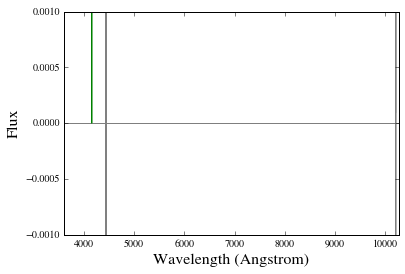

No spectrum found for BOSSJ1115+3720 and wvobs=4588.57 Angstrom!
No spectrum found for BOSSJ1119+3829 and wvobs=4886.5 Angstrom!
Using spec-7093-56657-0322.fits.gz for BOSSJ1120+5444
S/N 6.82573237908 1 / Angstrom


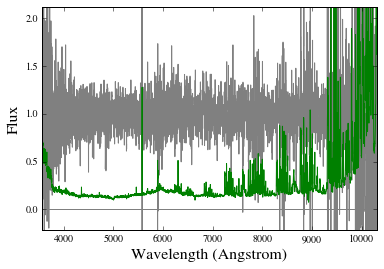

Using spec-5369-56272-0786.fits.gz for BOSSJ1120+0856
S/N 5.75538007583 1 / Angstrom


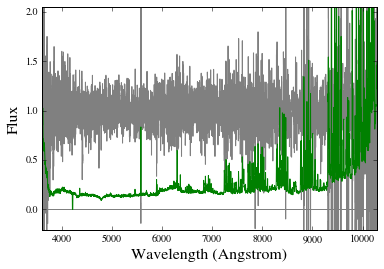

No spectrum found for BOSSJ1124-0118 and wvobs=5577.82 Angstrom!
Using spSpec-53795-2216-155.fit.gz for BOSSJ1125+2637
S/N 9.09324152711 1 / Angstrom


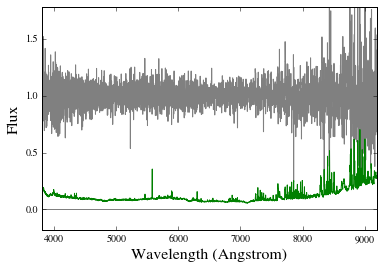

No spectrum found for BOSSJ1127+3651 and wvobs=4259.92 Angstrom!
No spectrum found for BOSSJ1129+4229 and wvobs=4423.65 Angstrom!
No spectrum found for BOSSJ1129+0616 and wvobs=5595.62 Angstrom!
Using spec-6647-56390-0320.fits.gz for BOSSJ1129+4629
S/N 6.35461372163 1 / Angstrom


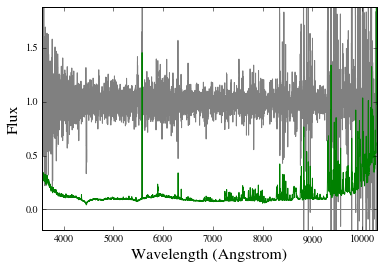

No spectrum found for BOSSJ1130+6229 and wvobs=6329.97 Angstrom!
No spectrum found for BOSSJ1131+0735 and wvobs=6500.09 Angstrom!
No spectrum found for BOSSJ1134+2555 and wvobs=4782.2 Angstrom!
No spectrum found for BOSSJ1137+4616 and wvobs=6598.28 Angstrom!
No spectrum found for BOSSJ1137+5942 and wvobs=4497.76 Angstrom!
No spectrum found for BOSSJ1138+3949 and wvobs=6364.42 Angstrom!
No spectrum found for BOSSJ1139+3618 and wvobs=5393.42 Angstrom!
No spectrum found for BOSSJ1141+4549 and wvobs=5050.59 Angstrom!
Using spec-4614-55604-0403.fits.gz for BOSSJ1144+3136
S/N 5.53490340285 1 / Angstrom


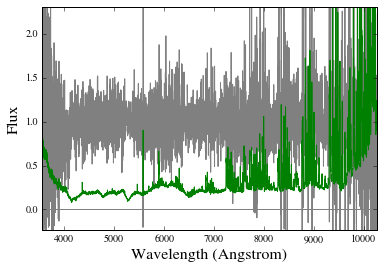

No spectrum found for BOSSJ1146+3236 and wvobs=4098.98 Angstrom!
No spectrum found for BOSSJ1146+3904 and wvobs=6904.66 Angstrom!
No spectrum found for BOSSJ1147+6013 and wvobs=6333.04 Angstrom!
Using spec-6689-56396-0414.fits.gz for BOSSJ1150+5252
S/N 12.4793566504 1 / Angstrom


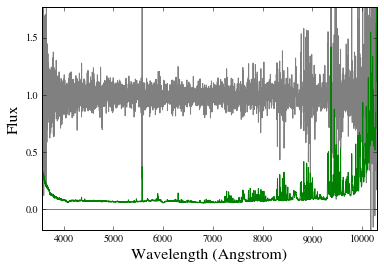

No spectrum found for BOSSJ1150+2713 and wvobs=5809.17 Angstrom!
No spectrum found for BOSSJ1150+5026 and wvobs=4613.96 Angstrom!
Using spec-5881-56038-0730.fits.gz for BOSSJ1152+1912
S/N 10.3574120693 1 / Angstrom


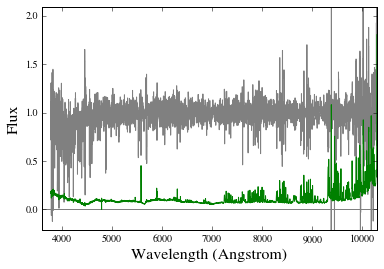

No spectrum found for BOSSJ1156+0427 and wvobs=5751.33 Angstrom!
No spectrum found for BOSSJ1156+1215 and wvobs=6290.95 Angstrom!
Using spec-6838-56429-0475.fits.gz for BOSSJ1201+5640
S/N 14.2985225719 1 / Angstrom


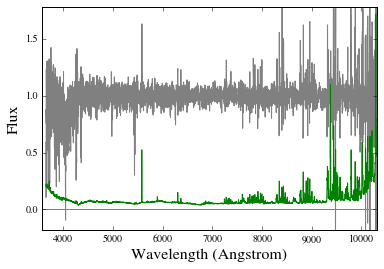

Using spec-7091-56658-0032.fits.gz for BOSSJ1202+5722
S/N 6.33540536586 1 / Angstrom


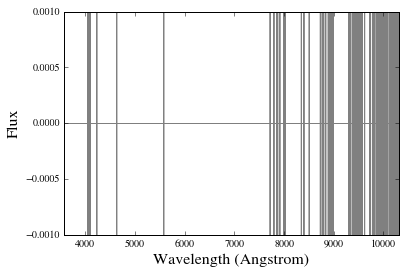

No spectrum found for BOSSJ1203+4406 and wvobs=7162.91 Angstrom!
Using spec-7098-56661-0024.fits.gz for BOSSJ1203+5954
S/N 6.79849760896 1 / Angstrom


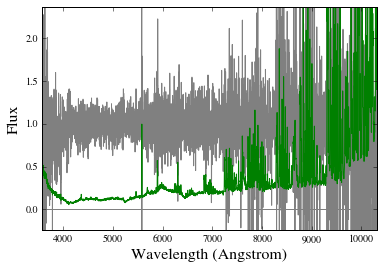

No spectrum found for BOSSJ1204+4111 and wvobs=5178.83 Angstrom!
No spectrum found for BOSSJ1204+2529 and wvobs=4051.93 Angstrom!
No spectrum found for BOSSJ1204+1142 and wvobs=4462.42 Angstrom!
No spectrum found for BOSSJ1206+5814 and wvobs=5846.33 Angstrom!
No spectrum found for BOSSJ1207+4634 and wvobs=5480.41 Angstrom!
Using spec-6682-56390-0798.fits.gz for BOSSJ1210+5254
S/N 5.83372632763 1 / Angstrom


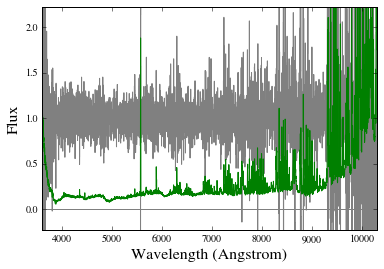

Using spSpec-54476-2609-624.fit.gz for BOSSJ1213+2007
S/N 11.0120350695 1 / Angstrom


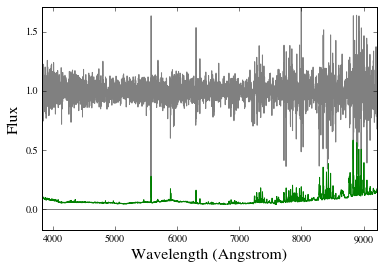

Using spec-6975-56720-0186.fits.gz for BOSSJ1215+6538
S/N 23.8243567336 1 / Angstrom


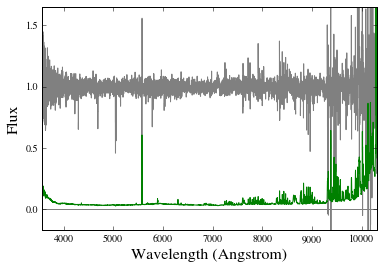

No spectrum found for BOSSJ1215+1954 and wvobs=4114.67 Angstrom!
Using spec-6477-56365-0540.fits.gz for BOSSJ1215+3126
S/N 9.79314133217 1 / Angstrom


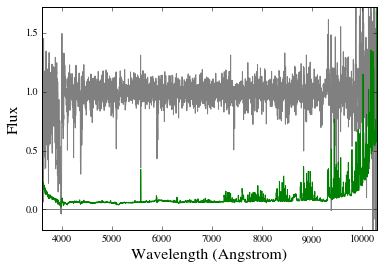

No spectrum found for BOSSJ1218+5739 and wvobs=4527.46 Angstrom!
No spectrum found for BOSSJ1219+5801 and wvobs=5005.41 Angstrom!
No spectrum found for BOSSJ1224+3721 and wvobs=4433.62 Angstrom!
No spectrum found for BOSSJ1224+4307 and wvobs=4192.04 Angstrom!
No spectrum found for BOSSJ1227+3518 and wvobs=5988.1 Angstrom!
No spectrum found for BOSSJ1227-0015 and wvobs=4554.42 Angstrom!
No spectrum found for BOSSJ1229+3430 and wvobs=6264.64 Angstrom!
No spectrum found for BOSSJ1231+3515 and wvobs=7178.97 Angstrom!
Using spec-6832-56426-0556.fits.gz for BOSSJ1232+5655
S/N 10.0988290583 1 / Angstrom


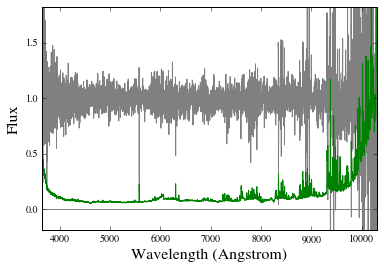

No spectrum found for BOSSJ1233+1246 and wvobs=7129.36 Angstrom!
Using spec-3969-55307-0644.fits.gz for BOSSJ1235+3758
S/N 7.64150779107 1 / Angstrom


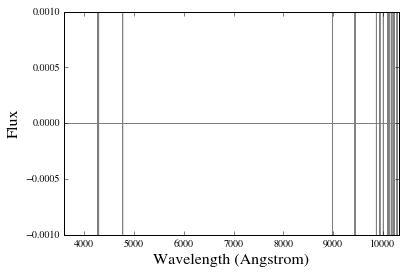

No spectrum found for BOSSJ1235+4258 and wvobs=6098.14 Angstrom!
Using spec-6973-56741-0802.fits.gz for BOSSJ1235+6451
S/N 5.59653094586 1 / Angstrom


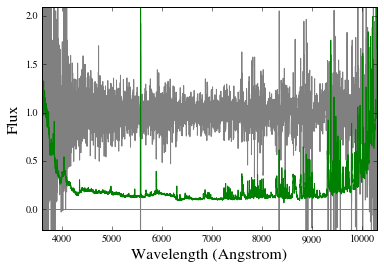

No spectrum found for BOSSJ1238+4634 and wvobs=6759.53 Angstrom!
No spectrum found for BOSSJ1238+3801 and wvobs=5746.44 Angstrom!
No spectrum found for BOSSJ1239+3815 and wvobs=4230.31 Angstrom!
Using spSpec-54485-2648-309.fit.gz for BOSSJ1239+2218
S/N 11.094779303 1 / Angstrom


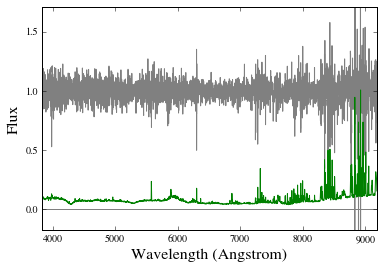

No spectrum found for BOSSJ1241+4548 and wvobs=4118.79 Angstrom!
Using spec-5986-56328-0738.fits.gz for BOSSJ1242+2419
S/N 6.18425254927 1 / Angstrom


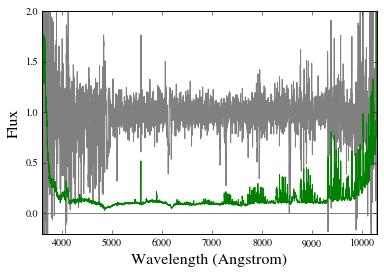

Using spec-5856-56090-0504.fits.gz for BOSSJ1242+1817
S/N 7.36701137399 1 / Angstrom


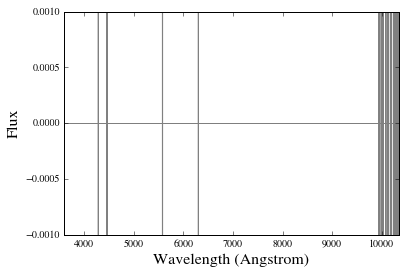

No spectrum found for BOSSJ1243+5922 and wvobs=6568.69 Angstrom!
No spectrum found for BOSSJ1244+3442 and wvobs=5989.36 Angstrom!
Using spec-6478-56341-0050.fits.gz for BOSSJ1244+2915
S/N 7.36502078539 1 / Angstrom


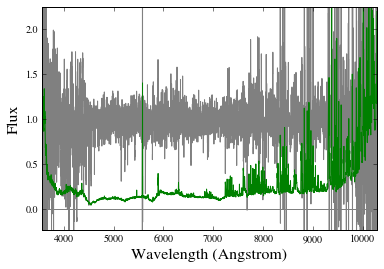

No spectrum found for BOSSJ1244+4727 and wvobs=5140.94 Angstrom!
No spectrum found for BOSSJ1244+6428 and wvobs=5805.31 Angstrom!
No spectrum found for BOSSJ1244+0339 and wvobs=4253.24 Angstrom!
No spectrum found for BOSSJ1245+4614 and wvobs=6580.7 Angstrom!
Using spec-5414-56014-0460.fits.gz for BOSSJ1247+1512
S/N 5.98778298685 1 / Angstrom


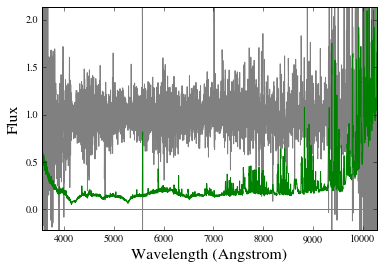

No spectrum found for BOSSJ1247+3153 and wvobs=6790.11 Angstrom!
No spectrum found for BOSSJ1247+3942 and wvobs=4577.95 Angstrom!
No spectrum found for BOSSJ1247+6311 and wvobs=6169.71 Angstrom!
No spectrum found for BOSSJ1248+0340 and wvobs=6285.36 Angstrom!
Using spec-5412-55981-0350.fits.gz for BOSSJ1249+1134
S/N 23.5146339269 1 / Angstrom


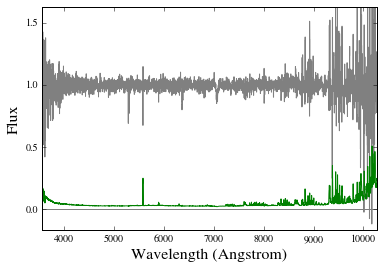

No spectrum found for BOSSJ1249+4600 and wvobs=5309.79 Angstrom!
No spectrum found for BOSSJ1250+3645 and wvobs=4998.69 Angstrom!
Using spSpec-54481-2614-021.fit.gz for BOSSJ1250+1914
S/N 6.63304167749 1 / Angstrom


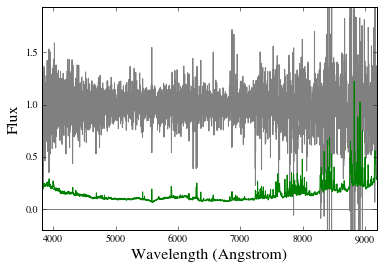

No spectrum found for BOSSJ1252+2849 and wvobs=4867.68 Angstrom!
No spectrum found for BOSSJ1253+2217 and wvobs=5520.74 Angstrom!
No spectrum found for BOSSJ1253+4740 and wvobs=4446.07 Angstrom!
Using spec-6755-56413-0494.fits.gz for BOSSJ1255+4958
S/N 9.53617987035 1 / Angstrom


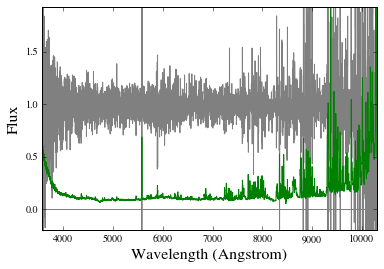

No spectrum found for BOSSJ1259+5531 and wvobs=6918.2 Angstrom!
No spectrum found for BOSSJ1304+3536 and wvobs=5339.29 Angstrom!
No spectrum found for BOSSJ1304+5443 and wvobs=4821.26 Angstrom!
No spectrum found for BOSSJ1306+5428 and wvobs=6221.63 Angstrom!
No spectrum found for BOSSJ1307+0156 and wvobs=5447.97 Angstrom!
Using spec-4760-55656-0422.fits.gz for BOSSJ1308+0343
S/N 7.32268617839 1 / Angstrom


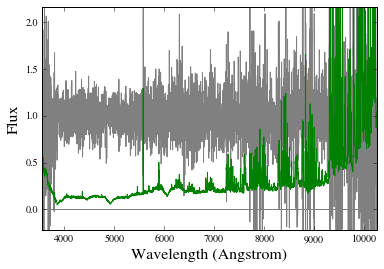

No spectrum found for BOSSJ1308+2349 and wvobs=6872.91 Angstrom!
No spectrum found for BOSSJ1309+6516 and wvobs=5457.98 Angstrom!
No spectrum found for BOSSJ1310+5258 and wvobs=4067.45 Angstrom!
Using spec-4052-55589-0050.fits.gz for BOSSJ1310-0047
S/N 5.90239664176 1 / Angstrom


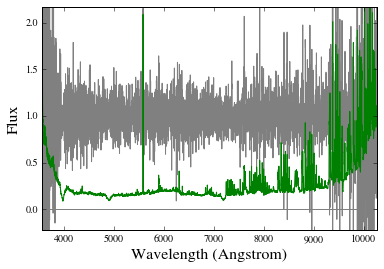

No spectrum found for BOSSJ1310+4721 and wvobs=4996.98 Angstrom!
No spectrum found for BOSSJ1313+2151 and wvobs=6219.72 Angstrom!
No spectrum found for BOSSJ1314+4627 and wvobs=6050.61 Angstrom!
Using spec-6830-56429-0220.fits.gz for BOSSJ1315+5629
S/N 5.65335425511 1 / Angstrom


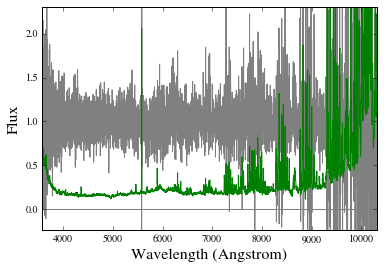

No spectrum found for BOSSJ1315+4807 and wvobs=4308.62 Angstrom!
No spectrum found for BOSSJ1315+5521 and wvobs=4249.16 Angstrom!
No spectrum found for BOSSJ1317+5854 and wvobs=6196.14 Angstrom!
No spectrum found for BOSSJ1318+4801 and wvobs=4297.08 Angstrom!
No spectrum found for BOSSJ1318+4941 and wvobs=7144.54 Angstrom!
No spectrum found for BOSSJ1319+4604 and wvobs=5465.31 Angstrom!
No spectrum found for BOSSJ1322+3114 and wvobs=6557.19 Angstrom!
Using spec-6625-56386-0228.fits.gz for BOSSJ1323+4613
S/N 12.9237947885 1 / Angstrom


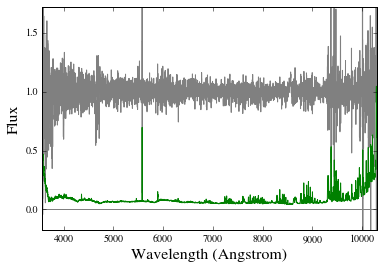

No spectrum found for BOSSJ1323+2518 and wvobs=6684.28 Angstrom!
No spectrum found for BOSSJ1326+4420 and wvobs=5651.74 Angstrom!
No spectrum found for BOSSJ1327+3054 and wvobs=6310.34 Angstrom!
No spectrum found for BOSSJ1328+4704 and wvobs=7111.31 Angstrom!
No spectrum found for BOSSJ1328+5030 and wvobs=6622 Angstrom!
Using spec-6491-56337-0440.fits.gz for BOSSJ1331+2930
S/N 5.83886807007 1 / Angstrom


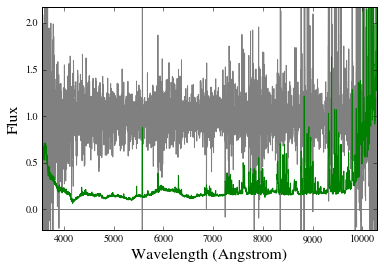

No spectrum found for BOSSJ1331-0236 and wvobs=6163.83 Angstrom!
Using spec-6738-56424-0688.fits.gz for BOSSJ1331+5135
S/N 9.18117818345 1 / Angstrom


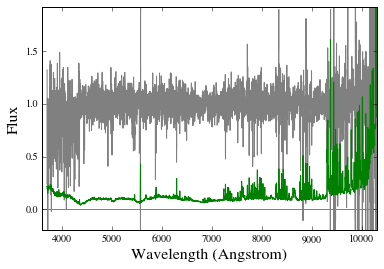

Using spec-5999-56089-0620.fits.gz for BOSSJ1331+2609
S/N 6.67230445606 1 / Angstrom


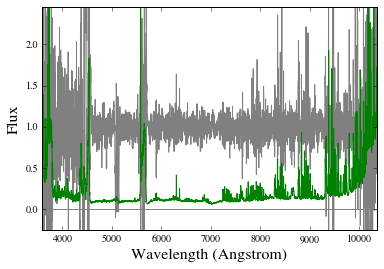

No spectrum found for BOSSJ1338+1126 and wvobs=6046.71 Angstrom!
No spectrum found for BOSSJ1339+0041 and wvobs=6204.27 Angstrom!
Using spSpec-51671-0299-248.fit.gz for BOSSJ1340-0100
S/N 11.2950426592 1 / Angstrom


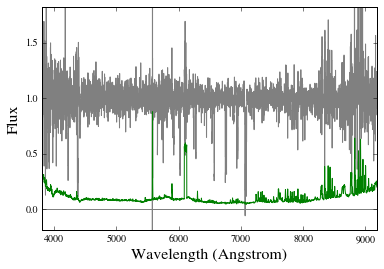

No spectrum found for BOSSJ1340+2021 and wvobs=5242.49 Angstrom!
Using spec-3856-55269-0682.fits.gz for BOSSJ1344+3405
S/N 13.2526033678 1 / Angstrom


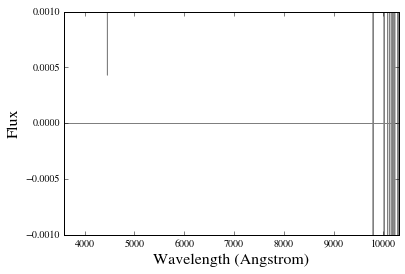

No spectrum found for BOSSJ1345+5037 and wvobs=6082.26 Angstrom!
No spectrum found for BOSSJ1346+5146 and wvobs=6194.97 Angstrom!
No spectrum found for BOSSJ1348+6639 and wvobs=5515.25 Angstrom!
Using spec-6494-56363-0388.fits.gz for BOSSJ1351+3002
S/N 6.19302926268 1 / Angstrom


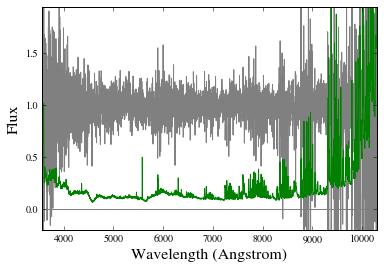

No spectrum found for BOSSJ1353+3529 and wvobs=6384.09 Angstrom!
Using spec-6986-56717-0716.fits.gz for BOSSJ1355+6548
S/N 8.1901171875 1 / Angstrom


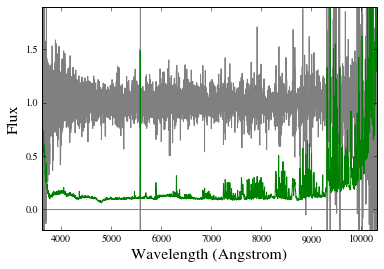

No spectrum found for BOSSJ1401+4204 and wvobs=6784.5 Angstrom!
No spectrum found for BOSSJ1404+4927 and wvobs=4669.21 Angstrom!
Using spSpec-53471-1839-334.fit.gz for BOSSJ1405+3503
S/N 11.4912079871 1 / Angstrom


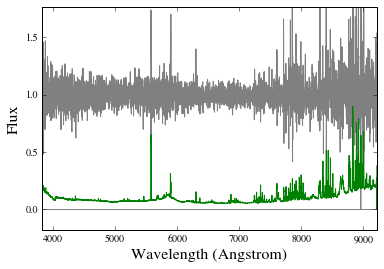

No spectrum found for BOSSJ1406+1056 and wvobs=4650.06 Angstrom!
No spectrum found for BOSSJ1406+2348 and wvobs=4247.56 Angstrom!
No spectrum found for BOSSJ1407+4945 and wvobs=4773.07 Angstrom!
Using spec-4862-55685-0358.fits.gz for BOSSJ1409+0628
S/N 6.0219964356 1 / Angstrom


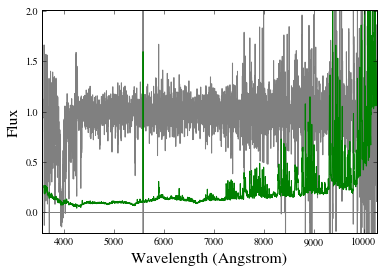

No spectrum found for BOSSJ1411+4834 and wvobs=4739.64 Angstrom!
Using spec-5455-56009-0698.fits.gz for BOSSJ1413+1608
S/N 9.58265508396 1 / Angstrom


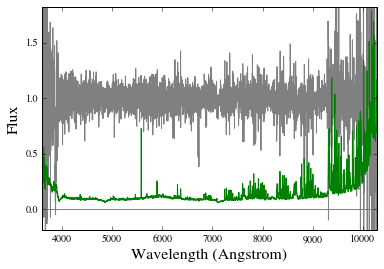

Using spec-5896-56047-0925.fits.gz for BOSSJ1416+2214
S/N 6.83235292472 1 / Angstrom


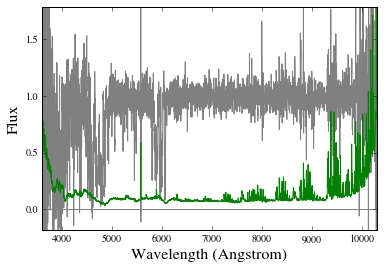

No spectrum found for BOSSJ1416+5110 and wvobs=7026.38 Angstrom!
No spectrum found for BOSSJ1417+4829 and wvobs=6285.13 Angstrom!
Using spec-6013-56074-0792.fits.gz for BOSSJ1418+2441
S/N 7.77641236822 1 / Angstrom


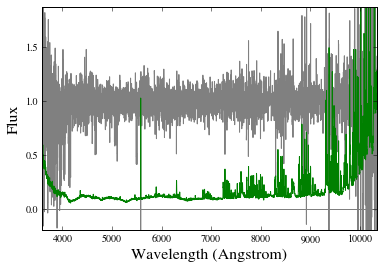

Using spec-6807-56429-0562.fits.gz for BOSSJ1420+5940
S/N 5.77940673417 1 / Angstrom


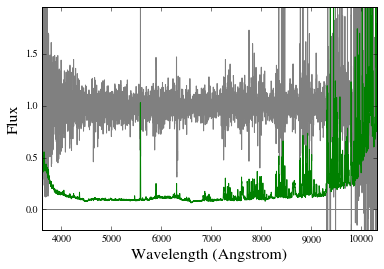

No spectrum found for BOSSJ1422+0436 and wvobs=3994.11 Angstrom!
No spectrum found for BOSSJ1422+2307 and wvobs=6208.2 Angstrom!
Using spec-6803-56402-0122.fits.gz for BOSSJ1423+5535
S/N 6.97879927731 1 / Angstrom


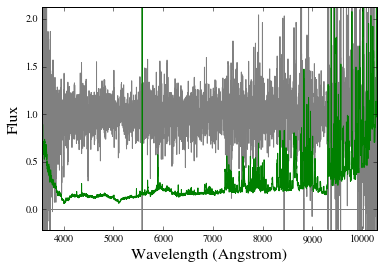

No spectrum found for BOSSJ1435+6343 and wvobs=4271.06 Angstrom!
No spectrum found for BOSSJ1437+4432 and wvobs=5436.59 Angstrom!
No spectrum found for BOSSJ1438+4612 and wvobs=5981.29 Angstrom!
Using spec-6016-56073-0196.fits.gz for BOSSJ1439+2245
S/N 5.92488931865 1 / Angstrom


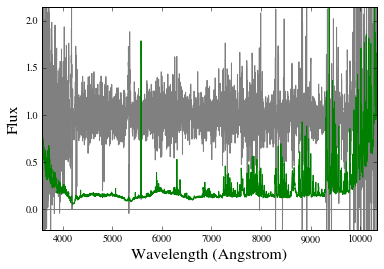

Using spSpec-52435-0791-392.fit.gz for BOSSJ1440+5658
S/N 6.96677253873 1 / Angstrom


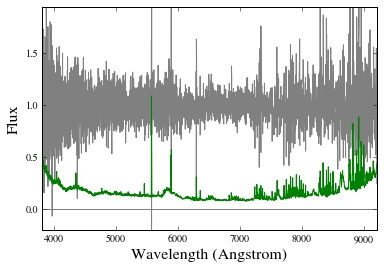

Using spec-3865-55272-0832.fits.gz for BOSSJ1440+3436
S/N 20.2610309636 1 / Angstrom


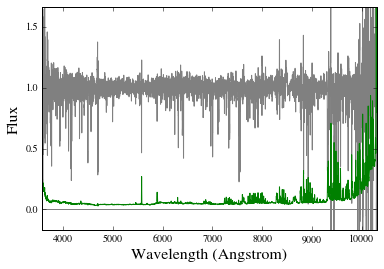

No spectrum found for BOSSJ1443+1055 and wvobs=6334.29 Angstrom!
No spectrum found for BOSSJ1444+2315 and wvobs=4871.48 Angstrom!
No spectrum found for BOSSJ1446+0110 and wvobs=6019.95 Angstrom!
No spectrum found for BOSSJ1447+1001 and wvobs=4694.46 Angstrom!
Using spec-5473-56033-0094.fits.gz for BOSSJ1449+1220
S/N 7.60963890135 1 / Angstrom


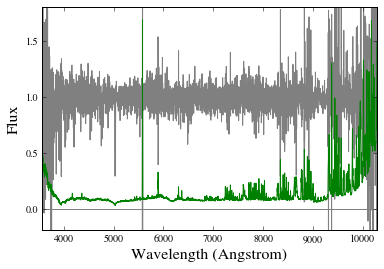

No spectrum found for BOSSJ1449+0143 and wvobs=4316.01 Angstrom!
No spectrum found for BOSSJ1452+0751 and wvobs=6904.83 Angstrom!
Using spSpec-53119-1397-576.fit.gz for BOSSJ1453+4200
S/N 5.82011421214 1 / Angstrom


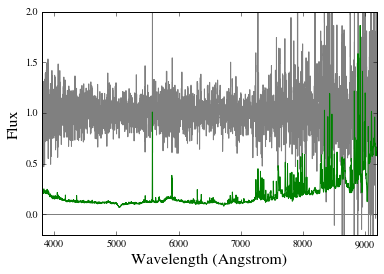

No spectrum found for BOSSJ1454+0749 and wvobs=6642.49 Angstrom!
No spectrum found for BOSSJ1454+3024 and wvobs=5789.42 Angstrom!
No spectrum found for BOSSJ1454+4247 and wvobs=6673.09 Angstrom!
Using spec-5166-56065-0778.fits.gz for BOSSJ1457+3955
S/N 11.4860682398 1 / Angstrom


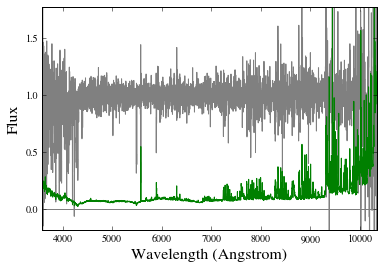

Using spec-6737-56365-0135.fits.gz for BOSSJ1457+4522
S/N 8.46146672275 1 / Angstrom


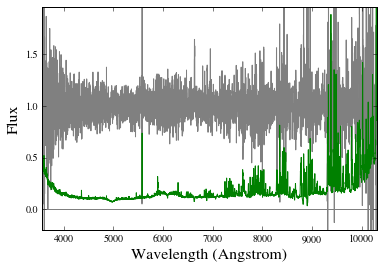

Using spec-4715-55653-0820.fits.gz for BOSSJ1458+3604
S/N 9.96603615392 1 / Angstrom


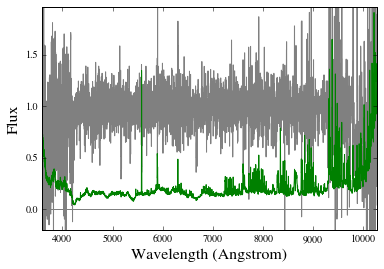

No spectrum found for BOSSJ1459+5717 and wvobs=4639.95 Angstrom!
No spectrum found for BOSSJ1503+0907 and wvobs=4159.67 Angstrom!
No spectrum found for BOSSJ1505+1045 and wvobs=5564.76 Angstrom!
Using spec-6054-56089-0236.fits.gz for BOSSJ1506+4136
S/N 20.0092573481 1 / Angstrom


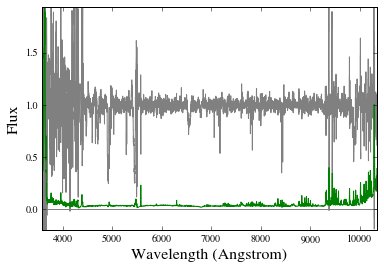

No spectrum found for BOSSJ1506+5734 and wvobs=4368.82 Angstrom!
Using spec-6054-56089-0957.fits.gz for BOSSJ1510+4221
S/N 11.5272521662 1 / Angstrom


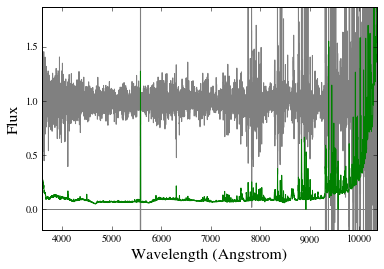

No spectrum found for BOSSJ1511+5440 and wvobs=5224.37 Angstrom!
Using spec-3872-55382-0899.fits.gz for BOSSJ1511+2739
S/N 7.83294691043 1 / Angstrom


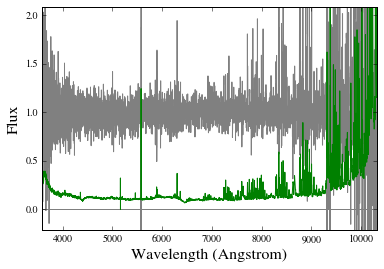

Using spec-4878-55710-0330.fits.gz for BOSSJ1512+0538
S/N 10.3403624461 1 / Angstrom


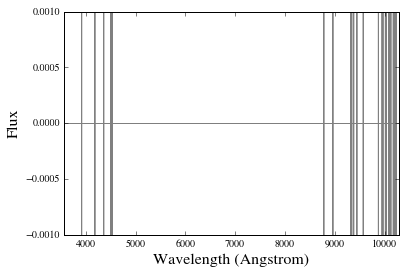

Using spec-6727-56369-0828.fits.gz for BOSSJ1512+5040
S/N 18.7997337554 1 / Angstrom


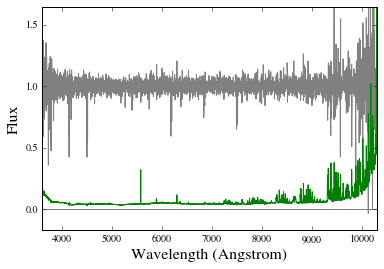

No spectrum found for BOSSJ1514+0954 and wvobs=6254.24 Angstrom!
No spectrum found for BOSSJ1516+1546 and wvobs=5248.71 Angstrom!
No spectrum found for BOSSJ1518+1910 and wvobs=7157.86 Angstrom!
No spectrum found for BOSSJ1520+3112 and wvobs=5508.3 Angstrom!
No spectrum found for BOSSJ1521+3306 and wvobs=4434.25 Angstrom!
Using spSpec-53149-1679-287.fit.gz for BOSSJ1526+4029
S/N 8.45838086925 1 / Angstrom


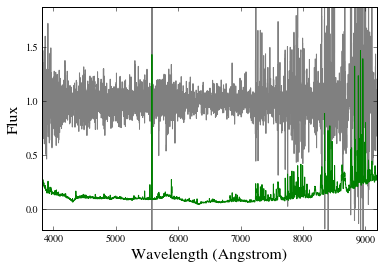

No spectrum found for BOSSJ1527+1422 and wvobs=6927.86 Angstrom!
No spectrum found for BOSSJ1527+3436 and wvobs=4259.61 Angstrom!
Using spec-4723-56033-0474.fits.gz for BOSSJ1528+3151
S/N 13.0110116934 1 / Angstrom


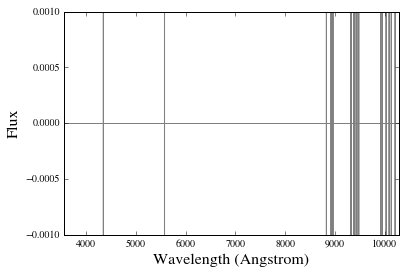

No spectrum found for BOSSJ1529+4040 and wvobs=5791.63 Angstrom!
Using spec-6728-56426-0100.fits.gz for BOSSJ1530+4809
S/N 6.15867961202 1 / Angstrom


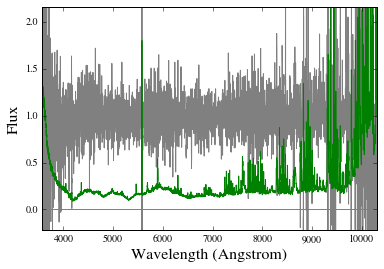

No spectrum found for BOSSJ1531+1412 and wvobs=5587.97 Angstrom!
No spectrum found for BOSSJ1532+0812 and wvobs=4528.14 Angstrom!
No spectrum found for BOSSJ1540+4744 and wvobs=4276.86 Angstrom!
No spectrum found for BOSSJ1544+5027 and wvobs=7269.57 Angstrom!
No spectrum found for BOSSJ1545+2239 and wvobs=5599.24 Angstrom!
No spectrum found for BOSSJ1547+0750 and wvobs=6768.01 Angstrom!
No spectrum found for BOSSJ1548+5707 and wvobs=4548.96 Angstrom!
No spectrum found for BOSSJ1548+4053 and wvobs=6822.25 Angstrom!
No spectrum found for BOSSJ1548+3402 and wvobs=4776.42 Angstrom!
No spectrum found for BOSSJ1552+1417 and wvobs=7090.13 Angstrom!
No spectrum found for BOSSJ1555+1229 and wvobs=6930.89 Angstrom!
Using spec-6043-56096-0666.fits.gz for BOSSJ1558+4408
S/N 21.8935404946 1 / Angstrom


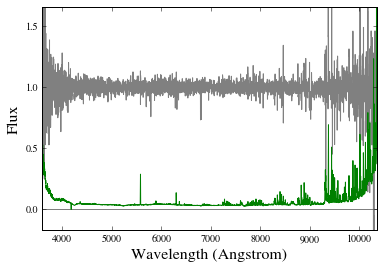

Using spec-6043-56096-0292.fits.gz for BOSSJ1601+4229
S/N 10.381347217 1 / Angstrom


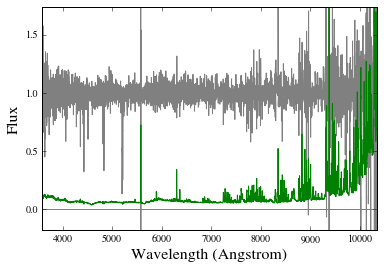

No spectrum found for BOSSJ1604+0632 and wvobs=6253.64 Angstrom!
No spectrum found for BOSSJ1604+2718 and wvobs=4980.33 Angstrom!
No spectrum found for BOSSJ1614+5116 and wvobs=7143.82 Angstrom!
No spectrum found for BOSSJ1618+5143 and wvobs=4244.32 Angstrom!
Using spec-6313-56460-0348.fits.gz for BOSSJ1622+5124
S/N 9.5045885181 1 / Angstrom


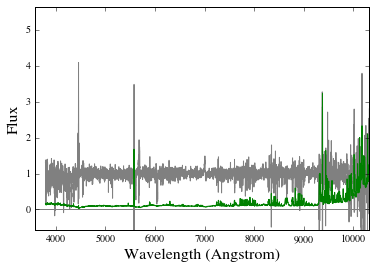

Using spSpec-53496-1576-541.fit.gz for BOSSJ1622+2623
S/N 10.6563603774 1 / Angstrom


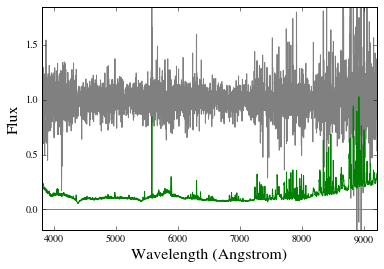

No spectrum found for BOSSJ1622+3531 and wvobs=6909.06 Angstrom!
Using spec-4057-55357-0032.fits.gz for BOSSJ1622+2031
S/N 12.298987518 1 / Angstrom


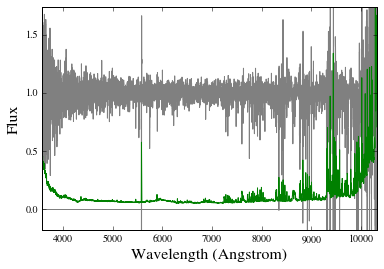

Using spec-6313-56460-0258.fits.gz for BOSSJ1624+5102
S/N 5.61439956491 1 / Angstrom


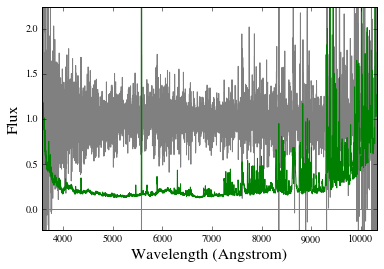

Using spec-6321-56449-0946.fits.gz for BOSSJ1624+4930
S/N 10.2083387662 1 / Angstrom


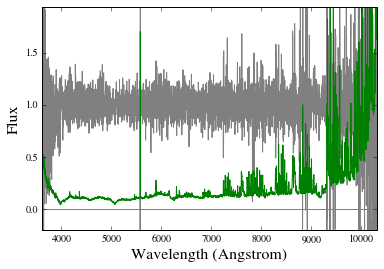

Using spec-6035-56076-0164.fits.gz for BOSSJ1625+4231
S/N 17.9125366767 1 / Angstrom


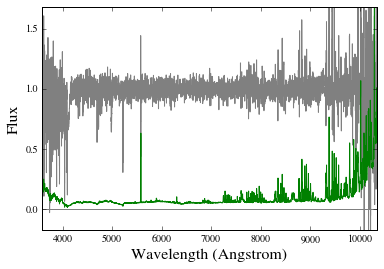

Using spec-4067-55361-0906.fits.gz for BOSSJ1626+1400
S/N 10.0031551022 1 / Angstrom


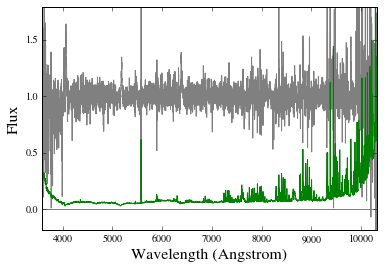

No spectrum found for BOSSJ1629+1808 and wvobs=4457.87 Angstrom!
No spectrum found for BOSSJ1632+4807 and wvobs=6624.02 Angstrom!
Using spSpec-54557-2949-090.fit.gz for BOSSJ1640+2548
S/N 6.52668613496 1 / Angstrom


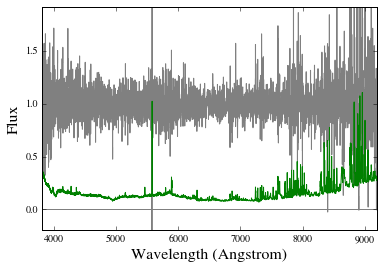

Using spSpec-53472-1686-095.fit.gz for BOSSJ1641+2736
S/N 8.19310712042 1 / Angstrom


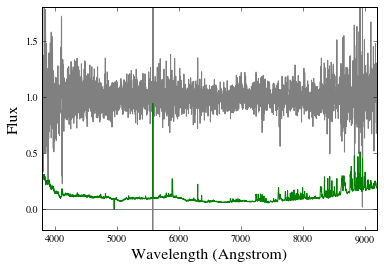

No spectrum found for BOSSJ1643+2918 and wvobs=4558.82 Angstrom!
Using spec-4189-55679-0664.fits.gz for BOSSJ1645+2947
S/N 9.93605293256 1 / Angstrom


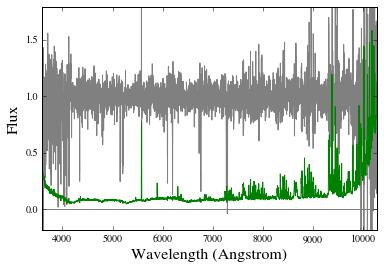

Using spec-5194-56062-0686.fits.gz for BOSSJ1647+3132
S/N 21.9309018604 1 / Angstrom


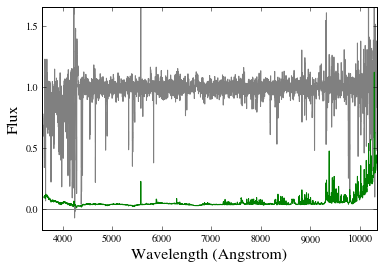

No spectrum found for BOSSJ1652+1858 and wvobs=4027.52 Angstrom!
No spectrum found for BOSSJ1657+3841 and wvobs=7025.61 Angstrom!
No spectrum found for BOSSJ1658+2607 and wvobs=5810.01 Angstrom!
Using spec-4983-55836-0362.fits.gz for BOSSJ1659+3705
S/N 6.09775849163 1 / Angstrom


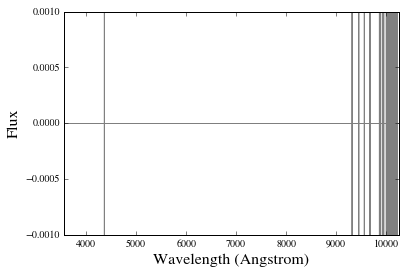

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ171347.50+335813.5.fits for BOSSJ1713+3358
S/N 7.60916262733 1 / Angstrom


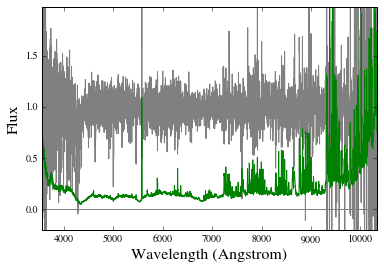

Using spec-4997-55738-0004.fits.gz for BOSSJ1714+3027
S/N 9.70234912478 1 / Angstrom


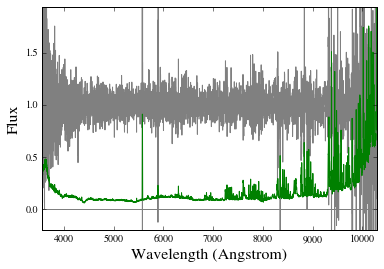

No spectrum found for BOSSJ1727+5937 and wvobs=5961.72 Angstrom!
Using spSpec-52466-0982-251.fit.gz for BOSSJ2043-0010
S/N 8.310919741 1 / Angstrom


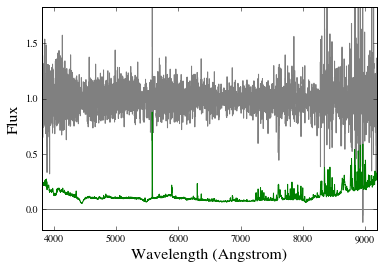

Using spSpec-52431-0985-298.fit.gz for BOSSJ2102-0049
S/N 7.6284496849 1 / Angstrom


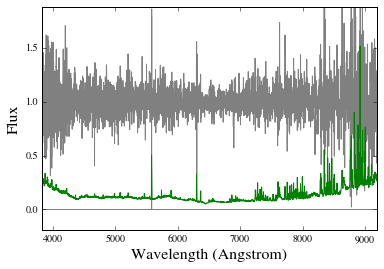

No spectrum found for BOSSJ2118+0111 and wvobs=7178.81 Angstrom!
Using spec-4192-55469-0858.fits.gz for BOSSJ2120+0007
S/N 7.2027763454 1 / Angstrom


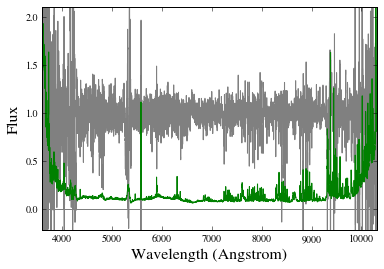

Using spec-5143-55828-0304.fits.gz for BOSSJ2127+0047
S/N 11.9518442057 1 / Angstrom


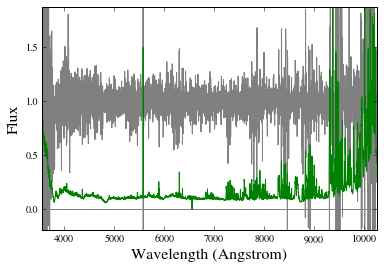

No spectrum found for BOSSJ2135-0103 and wvobs=5017.7 Angstrom!
Using spec-4195-55452-0045.fits.gz for BOSSJ2143-0041
S/N 8.11429894696 1 / Angstrom


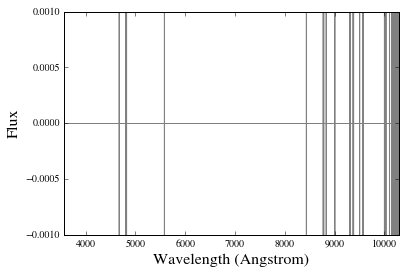

No spectrum found for BOSSJ2150+0058 and wvobs=5629.39 Angstrom!
No spectrum found for BOSSJ2157+0040 and wvobs=4115.94 Angstrom!
No spectrum found for BOSSJ2159+0053 and wvobs=4764.34 Angstrom!
No spectrum found for BOSSJ2201-0017 and wvobs=7221.8 Angstrom!
No spectrum found for BOSSJ2206-0038 and wvobs=6236.48 Angstrom!
No spectrum found for BOSSJ2218+0052 and wvobs=6359.44 Angstrom!
No spectrum found for BOSSJ2221-0012 and wvobs=6250.08 Angstrom!
No spectrum found for BOSSJ2227-0106 and wvobs=6618.95 Angstrom!
Using spec-4202-55445-0890.fits.gz for BOSSJ2227+0032
S/N 5.77926635742 1 / Angstrom


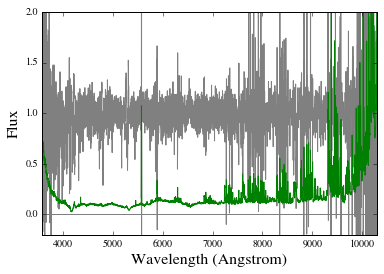

No spectrum found for BOSSJ2227+1215 and wvobs=5531.61 Angstrom!
No spectrum found for BOSSJ2249-0014 and wvobs=7106.59 Angstrom!
No spectrum found for BOSSJ2259+0032 and wvobs=5231.67 Angstrom!
No spectrum found for BOSSJ2303+0104 and wvobs=6635.68 Angstrom!
No spectrum found for BOSSJ2307-0030 and wvobs=4085.36 Angstrom!
No spectrum found for BOSSJ2311+0051 and wvobs=4147.56 Angstrom!
No spectrum found for BOSSJ2312-0018 and wvobs=6047.9 Angstrom!
No spectrum found for BOSSJ2317+0113 and wvobs=4245.11 Angstrom!
No spectrum found for BOSSJ2323-0100 and wvobs=5056.75 Angstrom!
No spectrum found for BOSSJ2326-0030 and wvobs=4423.76 Angstrom!
Using spec-4212-55447-0418.fits.gz for BOSSJ2331-0049
S/N 14.2964190568 1 / Angstrom


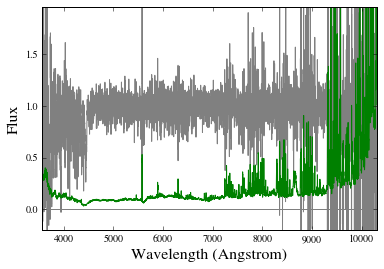

No spectrum found for BOSSJ2331-0114 and wvobs=5248.96 Angstrom!
No spectrum found for BOSSJ2334+0043 and wvobs=6783.69 Angstrom!
Using spec-4215-55471-0292.fits.gz for BOSSJ2353-0050
S/N 12.0312000293 1 / Angstrom


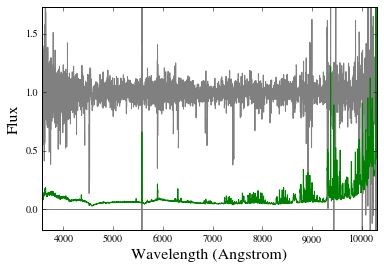

Using spec-6145-56266-0078.fits.gz for BOSSJ2354+1357
S/N 10.7526804957 1 / Angstrom


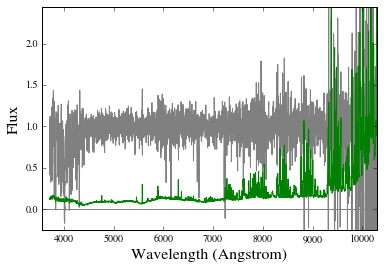

In [38]:
stack_tup0 = qpq9k.qpq9_IRMgII(passback=True,wrest=2796.352*u.AA,S2N_cut=5.5/u.AA,zfg_mnx=(-9999,1.6))
fin_velo, stck_img, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,idict in enumerate(all_dict):
    if idict is None:
        continue
    if ('J0822+1319' in idict['qpq']['NAME']) | ('J0908+4215' in idict['qpq']['NAME']): #BAL, strange emission 
        idx_mask.append(ii)
    if 'J1242+1817' in idict['qpq']['NAME']: # mask sky emission
        stck_mskN[ii,55:61] = 0
    if 'J1622+2031' in idict['qpq']['NAME']: # mask sky emission 
        stck_mskN[ii,53:58] = 0
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [39]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
cranges = [(-3000.,-1300.)*u.km/u.s,(1300.,3000.)*u.km/u.s]
EW_range = (cranges[0][1],cranges[1][0])
relativistic_equiv = u.doppler_relativistic(2796.352*u.AA)
wave = fin_velo.to(u.AA,equivalencies=relativistic_equiv)
pix = np.where(((fin_velo >= cranges[0][0]) & (fin_velo <= cranges[0][1])) | 
               ((fin_velo >= cranges[1][0]) & (fin_velo <= cranges[1][1])))[0]
fit = np.polyfit(fin_velo[pix].value, fin_flx[pix], 0)
pv = np.poly1d(fit)
conti = pv(fin_velo.value)
cfx = fin_flx/conti
EWpix = np.where((fin_velo > EW_range[0]) & (fin_velo < EW_range[1]))[0]
dwv = wave - np.roll(wave,1)
EW = np.sum((1. - cfx[EWpix])*dwv[EWpix])
print(EW)

0.196712143408 Angstrom


In [64]:
sv_EW = []
sv_rphys = []
for ii,img in enumerate(stck_img):
    if np.sum(stck_mskN[ii,:]) > 0:
        fit = np.polyfit(fin_velo[pix].value, img[pix], 0)
        pv = np.poly1d(fit)
        conti = pv(fin_velo.value)
        cfx = img/conti
        EW = np.sum((1. - cfx[EWpix])*dwv[EWpix])
        sv_EW.append(EW.value)
        sv_rphys.append(all_dict[ii]['qpq']['R_PHYS'])
index = np.argsort(sv_EW)
sv_EW = np.array(sv_EW)
sv_rphys = np.array(sv_rphys)
sorted(sv_EW)

[-12.049002722999838,
 -3.3980496207060038,
 -2.0765127651271169,
 -1.8022410406398712,
 -1.760730761934906,
 -1.7578723414918354,
 -1.6553795108795846,
 -1.6403771388757451,
 -1.5989069993210996,
 -1.3845307908200544,
 -1.3237808906041173,
 -1.1781776166075306,
 -1.1542498933373455,
 -1.1284114217743151,
 -1.0968545140490964,
 -1.0546655902868685,
 -0.98788594753942249,
 -0.903437693463636,
 -0.89640835536686492,
 -0.79354662144241073,
 -0.77427870915365715,
 -0.74807721374806913,
 -0.72809998852308377,
 -0.67259531654553328,
 -0.66738939995065882,
 -0.65158829758076497,
 -0.63018320117945281,
 -0.5964714872822573,
 -0.57375275753085742,
 -0.55668622411290569,
 -0.52847267413290111,
 -0.52442611387886984,
 -0.52165826436011919,
 -0.41601461936024964,
 -0.40814048840848544,
 -0.40321386556780586,
 -0.3901208445564594,
 -0.3673334000059294,
 -0.35654553222864954,
 -0.3558504956409792,
 -0.34381602755208718,
 -0.32401691414911377,
 -0.30505885982724207,
 -0.27537416851134,
 -0.2699774666

x.fits.bintab_to_table: Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits


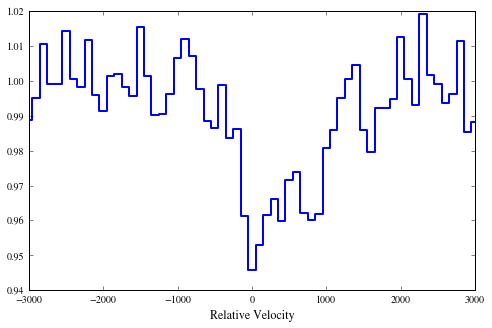

median z_fg = 0.934787988663
median, min, max of R_phys = 206.41426335 42.0765759631 298.33662174
Wrote spectrum to QPQ9_zIRMgII_2796_z1_smallvel_mean.fits


In [68]:
enigma_path = imp.find_module('enigma')[1]
QPQ9 = xxf.bintab_to_table(enigma_path+'/data/qpq/qpq9_final.fits')
c_QPQ9 = SkyCoord(QPQ9['FG_RA']*u.deg,QPQ9['FG_DEC']*u.deg)
sv_dv = []
for idict in all_dict:
    if idict == None:
        continue
    sv_dv.append(ltu.v_from_z(idict['qpq']['BG_Z'],idict['qpq']['Z_FG']).value)
med_dv = np.median(sv_dv)
# Mask spectra of velocity separation above median 
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
sv_z = []
sv_dv = []
sv_Rphys = []
for ii,idict in enumerate(all_dict):
    if idict is None:
        continue
    if ('J0822+1319' in idict['qpq']['NAME']) | ('J0908+4215' in idict['qpq']['NAME']): #BAL, strange emission 
        idx_mask.append(ii)
    if 'J1242+1817' in idict['qpq']['NAME']: # mask sky emission
        stck_mskN[ii,55:61] = 0
    if 'J1622+2031' in idict['qpq']['NAME']: # mask sky emission 
        stck_mskN[ii,53:58] = 0
    dv = ltu.v_from_z(idict['qpq']['BG_Z'],idict['qpq']['Z_FG']).value
    c_stacked = SkyCoord(idict['qpq']['FG_RA']*u.deg,idict['qpq']['FG_DEC']*u.deg)
    R_phys = QPQ9[np.where(c_stacked.separation(c_QPQ9) < 0.5*u.arcsec)[0]]['R_PHYS'][0]
    if dv >= med_dv:
        idx_mask.append(ii)
    else:
        sv_z.append(idict['qpq']['Z_FG'])
        sv_Rphys.append(R_phys)
for idx in idx_mask:
    stck_mskN[idx,:] = 0.
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)
plt.show()
print('median z_fg =',np.median(sv_z))
print('median, min, max of R_phys =',np.median(sv_Rphys),np.min(sv_Rphys),np.max(R_phys))
outfil = 'QPQ9_zIRMgII_2796_z1_smallvel_mean.fits'
relativistic_equiv = u.doppler_relativistic(2796.352*u.AA)
fin_wave = fin_velo.to(u.AA,equivalencies=relativistic_equiv)
xspec1d = XSpectrum1D.from_tuple((fin_wave, u.Quantity(fin_flx)))
xspec1d.write_to_fits(outfil,clobber=True)

In [70]:
qpq9b.boot_trans(wrest=2796.352*u.AA,outfil='IRMgII_2796_z1_smallvel_mean.fits',stack_tup=stack_tup,nboot=10000)

Equivalent width skewness: Mean=0.711744, Median=0.687121, std=0.25321 for Ntrials=10000
Tau-weighted centroid: Mean = 432.804 km / s, std=424.81 km / s
Wrote IRMgII_2796_z1_smallvel_mean.fits


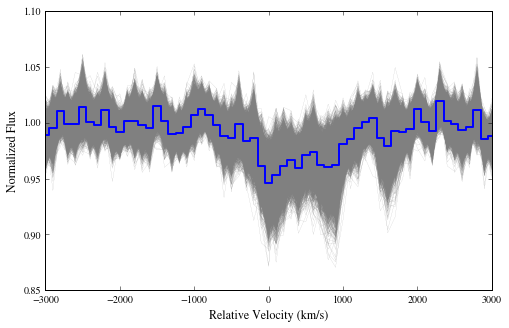

In [71]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
hdulist = fits.open('IRMgII_2796_z1_smallvel_mean.fits')
boot_img = hdulist[1].data
for bb in np.arange(np.shape(boot_img)[0]):
    plt.plot(fin_velo,boot_img[bb,:],drawstyle='step-mid',linewidth=0.1,color='gray')
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity (km/s)', size=12.)
plt.ylabel('Normalized Flux', size=12.)
plt.show()

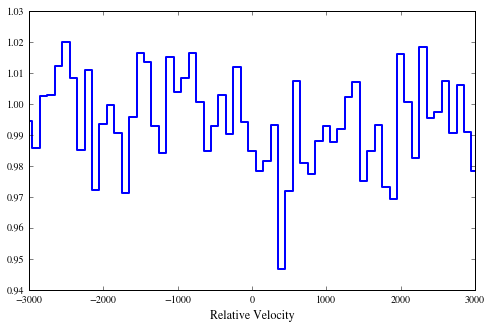

median z_fg = 0.934787988663


In [74]:
# The bin with velocity separation below median, and R_phys above median 
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
sv_z = []
sv_dv = []
sv_Rphys = []
for ii,idict in enumerate(all_dict):
    if idict is None:
        continue
    if ('J0822+1319' in idict['qpq']['NAME']) | ('J0908+4215' in idict['qpq']['NAME']): #BAL, strange emission 
        idx_mask.append(ii)
    if 'J1242+1817' in idict['qpq']['NAME']: # mask sky emission
        stck_mskN[ii,55:61] = 0
    if 'J1622+2031' in idict['qpq']['NAME']: # mask sky emission 
        stck_mskN[ii,53:58] = 0
    dv = ltu.v_from_z(idict['qpq']['BG_Z'],idict['qpq']['Z_FG']).value
    c_stacked = SkyCoord(idict['qpq']['FG_RA']*u.deg,idict['qpq']['FG_DEC']*u.deg)
    R_phys = QPQ9[np.where(c_stacked.separation(c_QPQ9) < 0.5*u.arcsec)[0]]['R_PHYS'][0]
    if dv >= med_dv:
        idx_mask.append(ii)
    else:
        sv_z.append(idict['qpq']['Z_FG'])
        sv_Rphys.append(R_phys)
for idx in idx_mask:
    stck_mskN[idx,:] = 0.
med_Rphys = np.median(sv_Rphys)
for ii,idict in enumerate(all_dict):
    if idict is None:
        continue
    c_stacked = SkyCoord(idict['qpq']['FG_RA']*u.deg,idict['qpq']['FG_DEC']*u.deg)
    R_phys = QPQ9[np.where(c_stacked.separation(c_QPQ9) < 0.5*u.arcsec)[0]]['R_PHYS'][0]
    if R_phys <= med_Rphys:
        idx_mask.append(ii)
for idx in idx_mask:
    stck_mskN[idx,:] = 0.
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)
plt.show()
print('median z_fg =',np.median(sv_z))

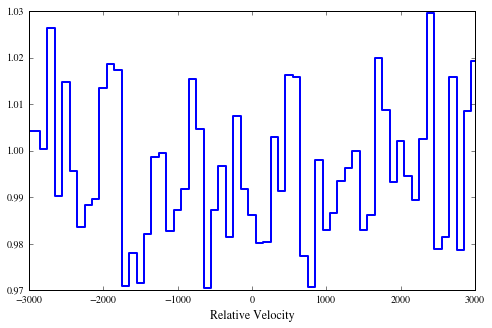

In [76]:
# The bin with z_fg below median, and R_phys above median 
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
sv_Rphys = []
for idict in all_dict:
    if idict == None:
        continue
    sv_z.append(idict['qpq']['Z_FG'])
med_z = np.median(sv_z)
for ii,idict in enumerate(all_dict):
    if idict is None:
        continue
    if ('J0822+1319' in idict['qpq']['NAME']) | ('J0908+4215' in idict['qpq']['NAME']): #BAL, strange emission 
        idx_mask.append(ii)
    if 'J1242+1817' in idict['qpq']['NAME']: # mask sky emission
        stck_mskN[ii,55:61] = 0
    if 'J1622+2031' in idict['qpq']['NAME']: # mask sky emission 
        stck_mskN[ii,53:58] = 0
    c_stacked = SkyCoord(idict['qpq']['FG_RA']*u.deg,idict['qpq']['FG_DEC']*u.deg)
    R_phys = QPQ9[np.where(c_stacked.separation(c_QPQ9) < 0.5*u.arcsec)[0]]['R_PHYS'][0]
    if idict['qpq']['Z_FG'] >= med_z:
        idx_mask.append(ii)
    else:
        sv_Rphys.append(R_phys)
for idx in idx_mask:
    stck_mskN[idx,:] = 0.
med_Rphys = np.median(sv_Rphys)
for ii,idict in enumerate(all_dict):
    if idict is None:
        continue
    c_stacked = SkyCoord(idict['qpq']['FG_RA']*u.deg,idict['qpq']['FG_DEC']*u.deg)
    R_phys = QPQ9[np.where(c_stacked.separation(c_QPQ9) < 0.5*u.arcsec)[0]]['R_PHYS'][0]
    if R_phys <= med_Rphys:
        idx_mask.append(ii)
for idx in idx_mask:
    stck_mskN[idx,:] = 0.
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)
plt.show()

## Try stacking CII without [OIII]

Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits
No spectrum found for BOSSJ0008-0039 and wvobs=3920.97 Angstrom!
No spectrum found for BOSSJ0042+1350 and wvobs=3704.79 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ034139.19-000012.7_b1200_F.fits.gz for SDSSJ0341-0000
S/N 67.0428935554 1 / Angstrom


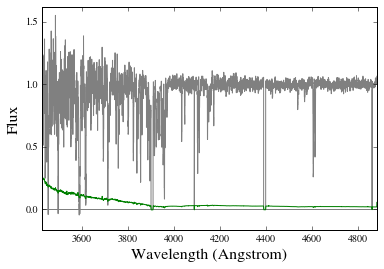

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ080048.74+354231.3_b1200_F.fits.gz for APOJ0800+3542
S/N 75.0359170696 1 / Angstrom


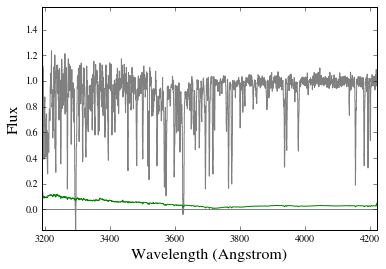

No spectrum found for BOSSJ0809+4539 and wvobs=4058.56 Angstrom!
No spectrum found for BOSSJ0826+4708 and wvobs=3734.97 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ082844.87+454518.2_b1200_F.fits.gz for SDSSJ0828+4545
S/N 26.1307452153 1 / Angstrom


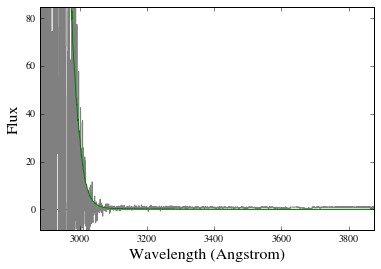

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ083757.13+383722.4_b1200_F.fits.gz for APOJ0837+3837
S/N 24.5031563117 1 / Angstrom


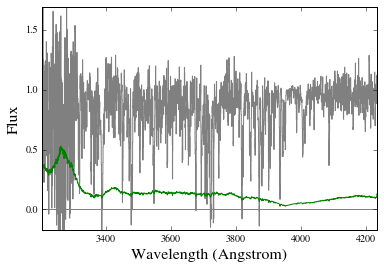

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ084159.26+392140.0.fits for BOSSJ0841+3921
S/N 8.52097176417 1 / Angstrom


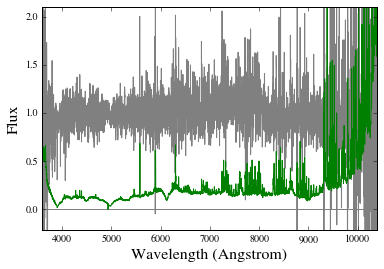

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ085357.49-001106.1_F.fits.gz for BOSSJ0853-0011
S/N 92.9574401142 1 / Angstrom


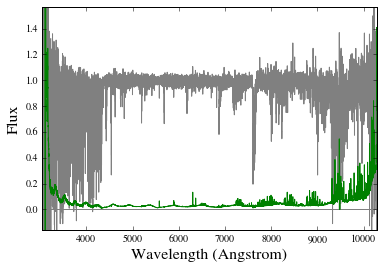

No spectrum found for BOSSJ0903+5133 and wvobs=3827.56 Angstrom!
No spectrum found for BOSSJ0904+0042 and wvobs=3493.83 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ091338.97-010704.6_F.fits.gz for BOSSJ0913-0107
S/N 154.945135067 1 / Angstrom


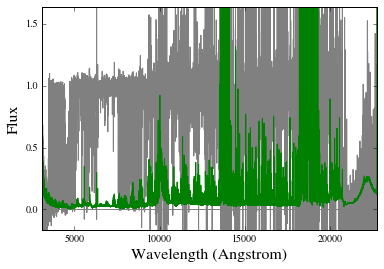

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091553.38+011911.3.fits for BOSSJ0915+0119
S/N 6.55962845821 1 / Angstrom


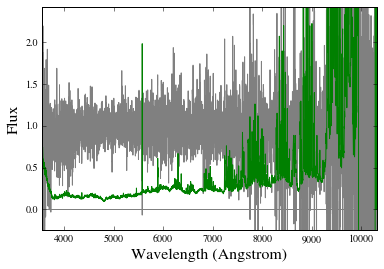

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ092416.73+392914.6_b1200_F.fits.gz for APOJ0924+3929
S/N 61.0004815303 1 / Angstrom


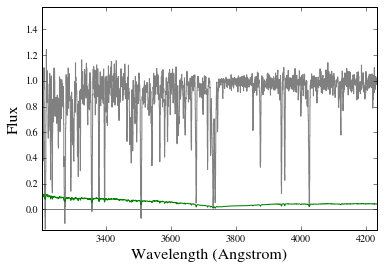

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ093225.60+092500.2_F.fits.gz for APOJ0932+0925
S/N 59.8322852369 1 / Angstrom


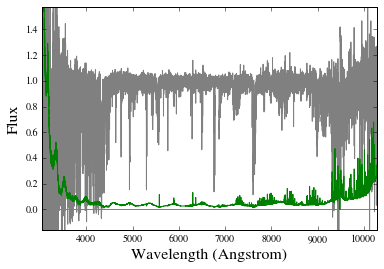

No spectrum found for BOSSJ1002+0020 and wvobs=4239.54 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ100507.08+501929.8_b1200_F.fits.gz for SDSSJ1005+5019
S/N 52.7244276535 1 / Angstrom


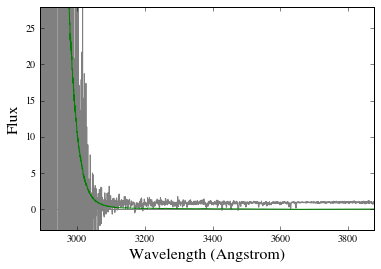

No spectrum found for APOJ1009+2500 and wvobs=3828.82 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ102616.12+461420.8_F.fits.gz for APOJ1026+4614
S/N 118.397707353 1 / Angstrom


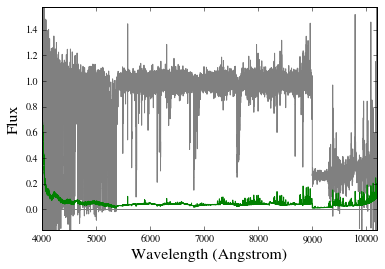

Using spec-6702-56381-0508.fits.gz for BOSSJ1036+5012
S/N 11.0602703675 1 / Angstrom


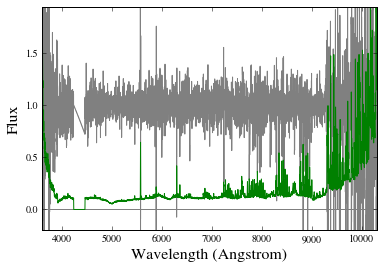

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ103900.01+502652.8_F.fits.gz for BOSSJ1039+5026
S/N 64.9694788715 1 / Angstrom


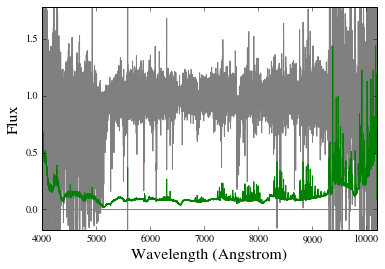

Using spec-7083-56722-0068.fits.gz for BOSSJ1042+6459
S/N 7.85775596901 1 / Angstrom


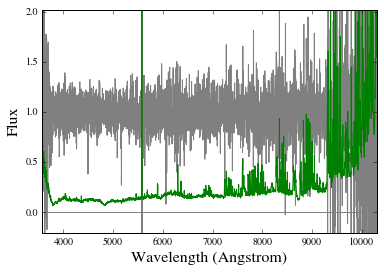

No continuum: /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114145.43+072423.3_b400_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ114145.43+072423.3_b600_F.fits.gz for APOJ1141+0724
S/N 25.4164574809 1 / Angstrom


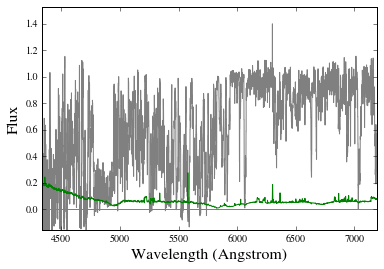

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ114436.66+095904.9_F.fits.gz for BOSSJ1144+0959
S/N 171.406440037 1 / Angstrom


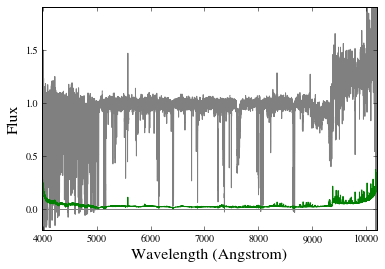

No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ120416.69+022111.0_b1200_F.fits.gz
No continuum: /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz
Using conti=1 for HIRES
Using /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz for BOSSJ1204+0221
S/N 386.536517315 1 / Angstrom


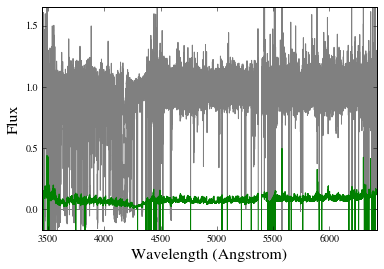

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ121558.80+571555.4.fits.gz for BOSSJ1215+5715
S/N 9.48453293613 1 / Angstrom


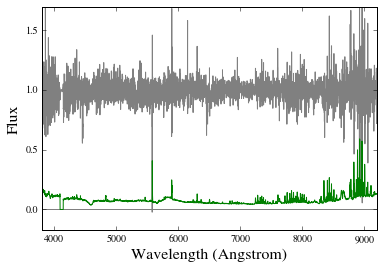

Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ123141.73+002913.9_b600_F.fits.gz for BOSSJ1231+0029
S/N 28.0243826395 1 / Angstrom


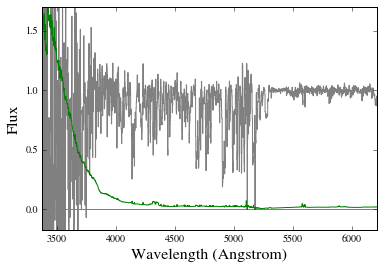

No spectrum found for BOSSJ1244+3208 and wvobs=3991.59 Angstrom!
No spectrum found for BOSSJ1253+6327 and wvobs=3960.22 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ130603.55+615835.2_b1200_F.fits.gz for APOJ1306+6158
S/N 26.0013604328 1 / Angstrom


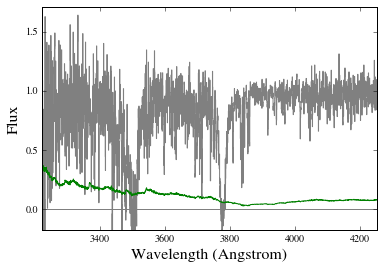

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ135629.54+613310.4_b1200_F.fits.gz for BOSSJ1356+6133
S/N 27.9882651058 1 / Angstrom


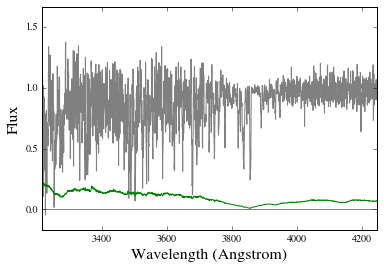

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ135849.54+273756.9.fits for APOJ1358+2737
S/N 9.40150347524 1 / Angstrom


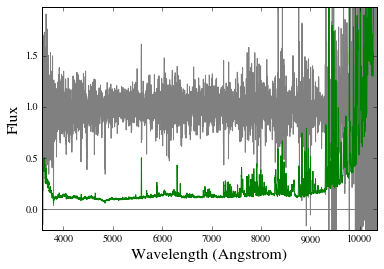

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142054.92+160342.9_F.fits.gz for APOJ1420+1603
S/N 46.3661168562 1 / Angstrom


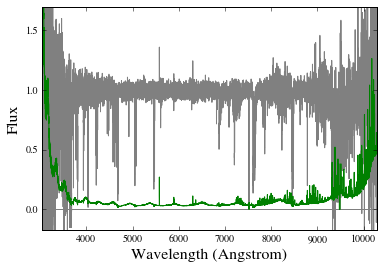

No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ142758.74-012136.2_b1200_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/MIKE_redux//./SDSSJ142758.74-012136.2_b_F.fits.gz for BOSSJ1427-0121
S/N 366.132948268 1 / Angstrom


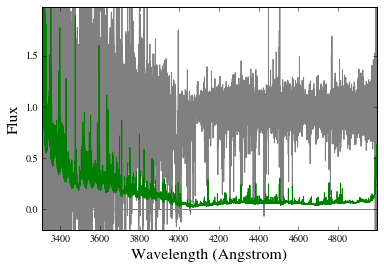

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_4_45/SDSSJ143344.55+064111.9.fits for BOSSJ1433+0641
S/N 12.3631226341 1 / Angstrom


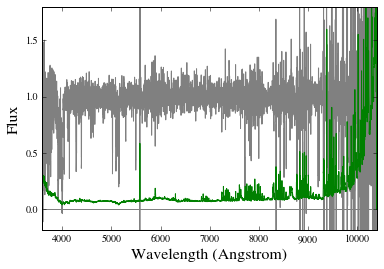

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ155325.89+192137.7_F.fits.gz for APOJ1553+1921
S/N 23.4573419536 1 / Angstrom


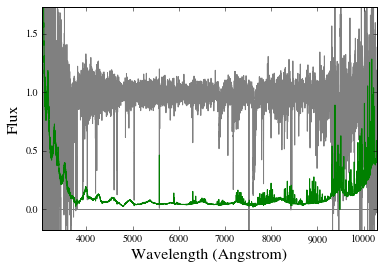

Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ155946.28+494326.5_b1200_F.fits.gz for APOJ1559+4943
S/N 21.2398400039 1 / Angstrom


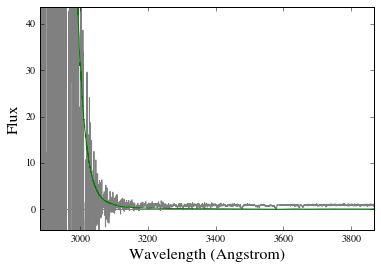

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ160546.67+511323.0.fits for BOSSJ1605+5113
S/N 11.4266522785 1 / Angstrom


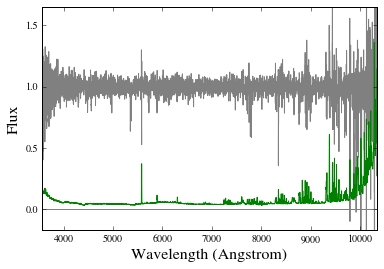

No spectrum found for BOSSJ1618+1842 and wvobs=4067.76 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ162737.25+460609.3_F.fits.gz for APOJ1627+4606
S/N 119.453754785 1 / Angstrom


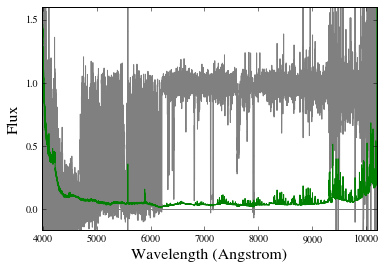

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ225549.55-000927.7.fits for BOSSJ2255-0009
S/N 6.1934643826 1 / Angstrom


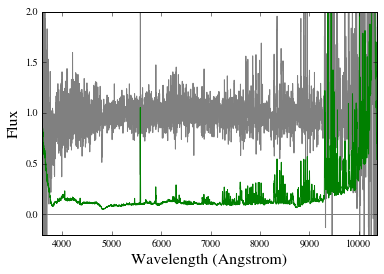

In [136]:
stack_tup0 = qpq9k.qpq9_IRMgII(passback=True,wrest=1334.5323*u.AA,S2N_cut=5.5/u.AA,zfg_mnx=(1.6,9999),atmosphere_cut=True)
# Mask
fin_velo, stck_img, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
    if 'J1508+3635' in dd['qpq']['NAME']: #DLA not excluded by forest cut, should be excluded now
        idx_mask.append(ii) 
    if '[OIII]' == dd['qpq']['ZFG_LINE']:
        idx_mask.append(ii)
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [145]:
sv_Rphys = []
for dd in all_dict:
    if dd is None:
        continue
    if '[OIII]' != dd['qpq']['ZFG_LINE']:
        sv_Rphys.append(dd['qpq']['R_PHYS'])
print(np.median(sv_Rphys))
sv_Rphys = []
for dd in all_dict:
    if dd is None:
        continue
    sv_Rphys.append(dd['qpq']['R_PHYS'])
print(np.median(sv_Rphys))

140.571571594
182.693675263


In [146]:
np.sum(stck_mskN,0)

array([ 17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,
        17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,
        17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,
        17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,
        17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,
        17.,  17.,  17.,  17.,  17.,  17.])

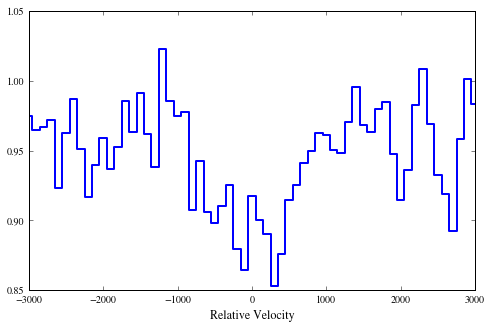

In [147]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)
plt.show()

## Try stacking CIV without [OIII]

Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits
No spectrum found for BOSSJ0008-0039 and wvobs=4045.27 Angstrom!
No spectrum found for BOSSJ0008-0039 and wvobs=4548.73 Angstrom!
No spectrum found for BOSSJ0042+1350 and wvobs=4297.93 Angstrom!
No spectrum found for BOSSJ0057-0001 and wvobs=4893.62 Angstrom!
Using spec-3735-55209-0693.fits.gz for BOSSJ0103-0002
S/N 7.99979837142 1 / Angstrom


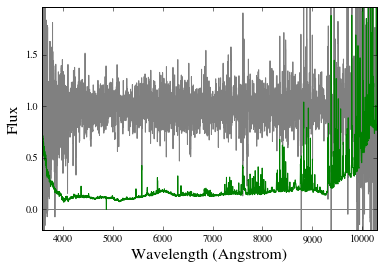

No spectrum found for SDSSJ0111+1402 and wvobs=5395.68 Angstrom!
No spectrum found for SDSSJ0149-0021 and wvobs=4152.65 Angstrom!
Using spec-4236-55479-0340.fits.gz for BOSSJ0214-0052
S/N 6.23200900767 1 / Angstrom


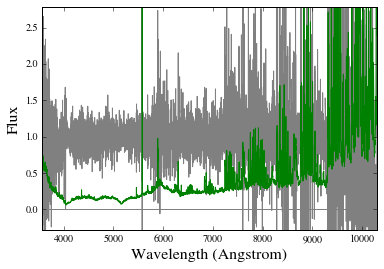

Using spec-6780-56605-0459.fits.gz for BOSSJ0224-0046
S/N 7.47685924003 1 / Angstrom


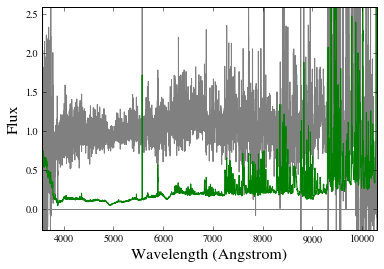

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ023019.99-033316.0.fits for BOSSJ0230-0333
S/N 10.0081325056 1 / Angstrom


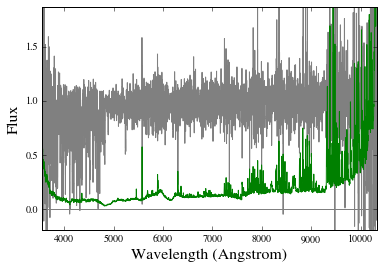

No continuum: /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ023946.44-010644.1_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ023946.45-010644.1.fits for BOSSJ0239-0106
S/N 12.0478731438 1 / Angstrom


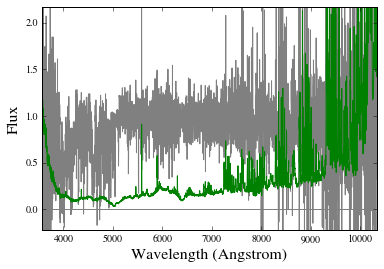

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ025039.82-004749.6.fits for BOSSJ0250-0047
S/N 7.1779329577 1 / Angstrom


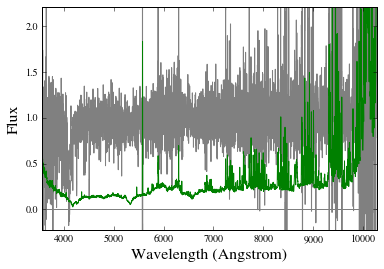

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ034139.19-000012.7_F.fits.gz for SDSSJ0341-0000
S/N 52.5198816706 1 / Angstrom


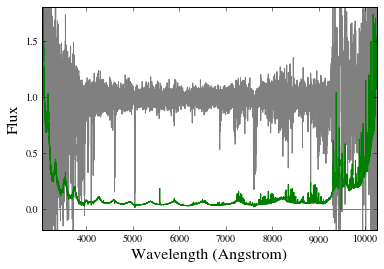

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ040954.21-041137.1_F.fits.gz for SDSSJ0409-0411
S/N 39.2178425522 1 / Angstrom


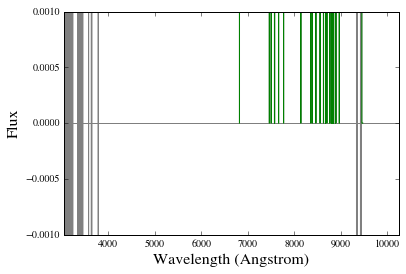

No spectrum found for BOSSJ0749+3702 and wvobs=4576.96 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ075259.14+401118.4.fits.gz for SDSSJ0752+4011
S/N 6.39883598742 1 / Angstrom


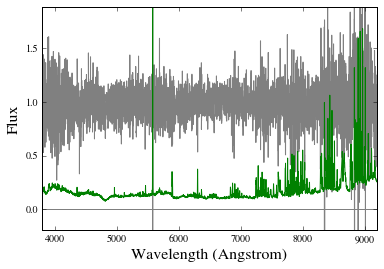

No spectrum found for APOJ0800+3542 and wvobs=4617.2 Angstrom!
No spectrum found for BOSSJ0809+4539 and wvobs=4708.35 Angstrom!
Using spec-4463-55868-0778.fits.gz for BOSSJ0812+2620
S/N 7.91669349809 1 / Angstrom


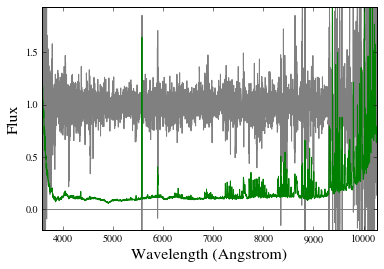

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ081833.97+123215.4.fits for BOSSJ0818+1232
S/N 10.2169718424 1 / Angstrom


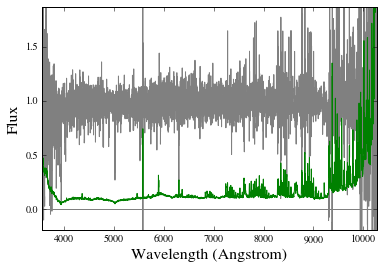

No spectrum found for BOSSJ0826+4708 and wvobs=4332.96 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ082844.87+454518.2.fits for SDSSJ0828+4545
S/N 8.13189991025 1 / Angstrom


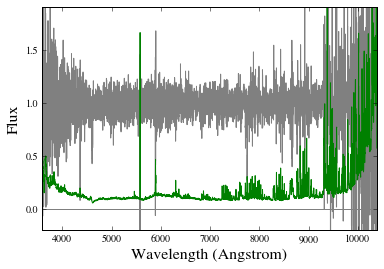

No spectrum found for BOSSJ0837+0810 and wvobs=4593.35 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MODS_redux//./SDSSJ083712.69+363037.7_b_F.fits.gz for APOJ0837+3630
S/N 17.8947228184 1 / Angstrom


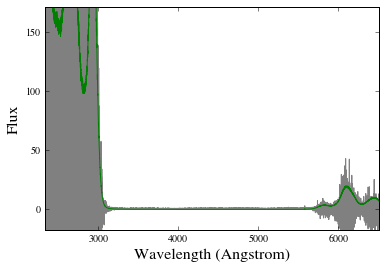

No spectrum found for APOJ0837+3837 and wvobs=4741.22 Angstrom!
Using spec-5160-55895-0092.fits.gz for BOSSJ0838+4621
S/N 6.57216966501 1 / Angstrom


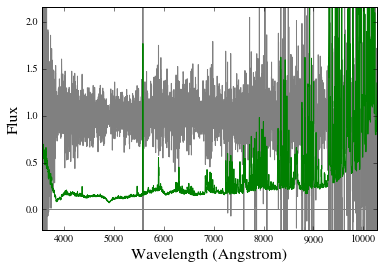

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ084159.26+392140.0.fits for BOSSJ0841+3921
S/N 7.76319133509 1 / Angstrom


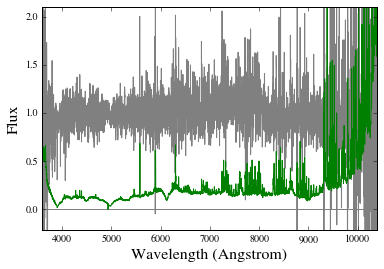

No spectrum found for BOSSJ0845+3202 and wvobs=4461.31 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ085357.49-001106.1_F.fits.gz for BOSSJ0853-0011
S/N 96.4983545463 1 / Angstrom


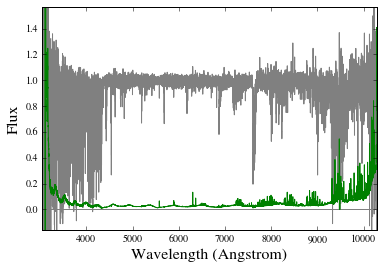

No spectrum found for BOSSJ0856+5514 and wvobs=4058.28 Angstrom!
No spectrum found for BOSSJ0902+3602 and wvobs=4274.28 Angstrom!
No spectrum found for BOSSJ0903+5133 and wvobs=4440.36 Angstrom!
No spectrum found for BOSSJ0904+0042 and wvobs=4053.2 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ091046.69+041448.4_F.fits.gz for APOJ0910+0414
S/N 54.2537884302 1 / Angstrom


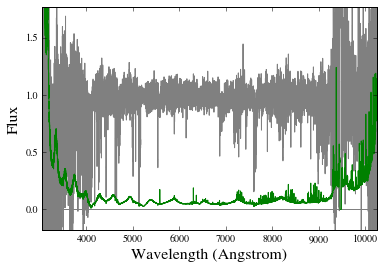

No spectrum found for BOSSJ0912+4139 and wvobs=4299.36 Angstrom!
Using spec-5809-56353-0052.fits.gz for BOSSJ0912+3056
S/N 14.3718470326 1 / Angstrom


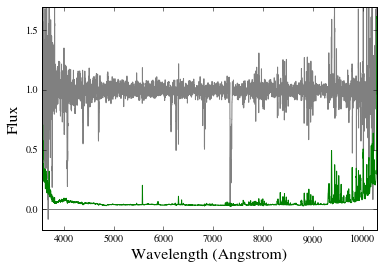

Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ091338.97-010704.6_F.fits.gz for BOSSJ0913-0107
S/N 75.6872586124 1 / Angstrom


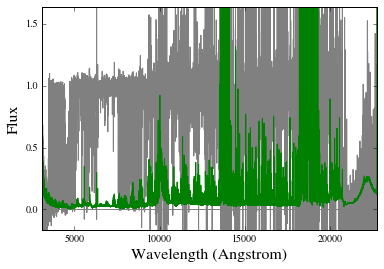

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091430.84+010927.5.fits for BOSSJ0914+0109
S/N 8.25998917053 1 / Angstrom


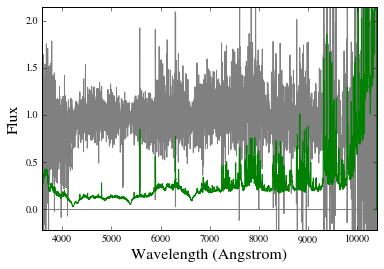

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091553.38+011911.3.fits for BOSSJ0915+0119
S/N 5.86331716164 1 / Angstrom


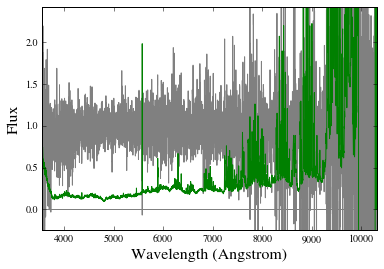

No spectrum found for BOSSJ0916+4250 and wvobs=4241.22 Angstrom!
No spectrum found for APOJ0924+3929 and wvobs=4466.88 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ093225.60+092500.2_F.fits.gz for APOJ0932+0925
S/N 64.2783612445 1 / Angstrom


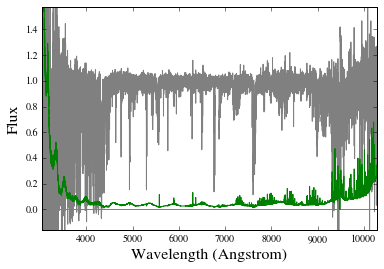

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ093642.20-005831.3.fits for BOSSJ0936-0058
S/N 6.27442689938 1 / Angstrom


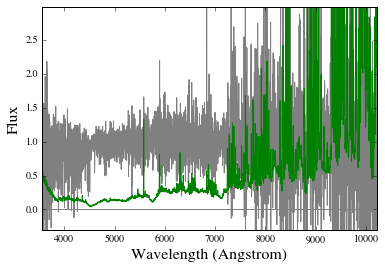

No spectrum found for APOJ0938+5317 and wvobs=4748.36 Angstrom!
No spectrum found for BOSSJ0942+1347 and wvobs=4182 Angstrom!
No spectrum found for BOSSJ0956+0248 and wvobs=4667.72 Angstrom!
No spectrum found for BOSSJ1000+0337 and wvobs=4178.92 Angstrom!
No spectrum found for BOSSJ1002+0020 and wvobs=4918.3 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ100507.08+501929.6.fits.gz for SDSSJ1005+5019
S/N 12.0867028884 1 / Angstrom


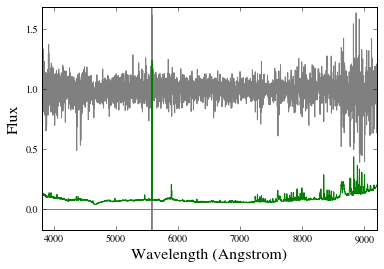

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ100627.10+480429.9.fits for BOSSJ1006+4804
S/N 8.49709978383 1 / Angstrom


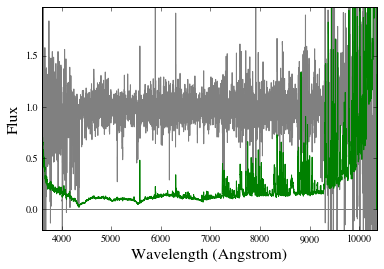

Using spec-4738-55650-0778.fits.gz for BOSSJ1009+0236
S/N 6.4553627316 1 / Angstrom


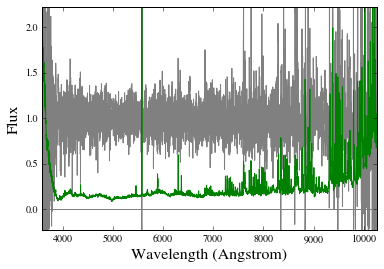

No spectrum found for APOJ1009+2500 and wvobs=4441.83 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ101003.47+403754.9.fits for BOSSJ1010+4037
S/N 13.3478805307 1 / Angstrom


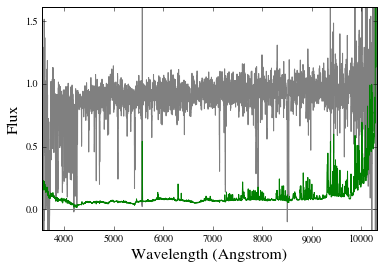

No spectrum found for BOSSJ1010+4517 and wvobs=4312.12 Angstrom!
No spectrum found for BOSSJ1010+0821 and wvobs=4446.09 Angstrom!
No spectrum found for BOSSJ1013+0330 and wvobs=4555.18 Angstrom!
No spectrum found for BOSSJ1014+2653 and wvobs=4224.29 Angstrom!
No spectrum found for BOSSJ1015+1245 and wvobs=4152.08 Angstrom!
No spectrum found for BOSSJ1020+6119 and wvobs=4316.62 Angstrom!
Using spec-6463-56340-0210.fits.gz for BOSSJ1024+2616
S/N 9.10303381718 1 / Angstrom


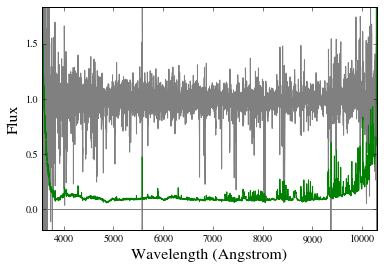

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ102616.12+461420.8_F.fits.gz for APOJ1026+4614
S/N 127.919846343 1 / Angstrom


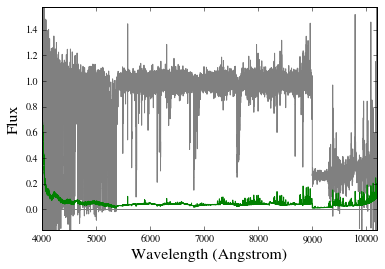

No spectrum found for BOSSJ1028+5121 and wvobs=4134.68 Angstrom!
Using spec-6702-56381-0508.fits.gz for BOSSJ1036+5012
S/N 8.37513187158 1 / Angstrom


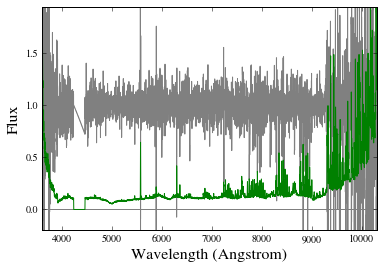

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ103900.01+502652.8_F.fits.gz for BOSSJ1039+5026
S/N 56.8645040078 1 / Angstrom


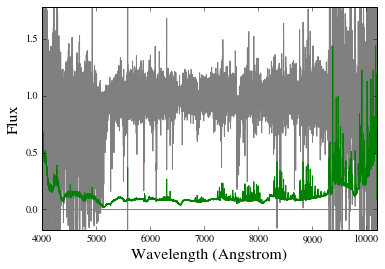

No spectrum found for APOJ1041+1957 and wvobs=4406.95 Angstrom!
Using spec-7083-56722-0068.fits.gz for BOSSJ1042+6459
S/N 7.58582013331 1 / Angstrom


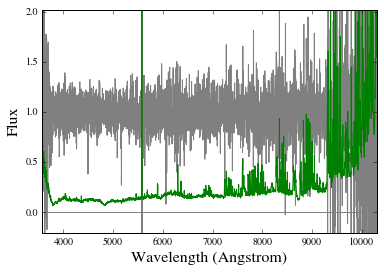

Using spec-6448-56365-0160.fits.gz for BOSSJ1044+3139
S/N 7.86940354567 1 / Angstrom


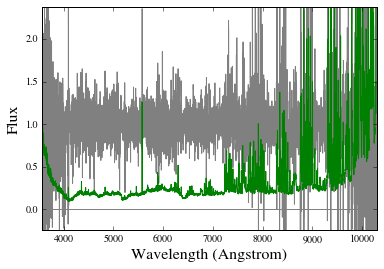

No spectrum found for APOJ1045+4351 and wvobs=5307.66 Angstrom!
Using spec-7094-56660-0184.fits.gz for BOSSJ1052+5553
S/N 9.29714661482 1 / Angstrom


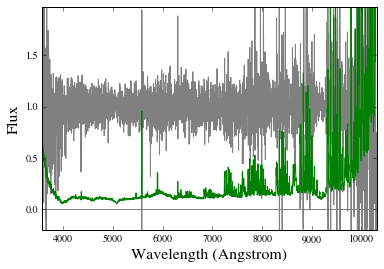

No spectrum found for BOSSJ1113+3305 and wvobs=4477.89 Angstrom!
No spectrum found for BOSSJ1118+4025 and wvobs=4525.75 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114145.43+072423.3_b400_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ114145.43+072423.3_b600_F.fits.gz for APOJ1141+0724
S/N 17.5284400508 1 / Angstrom


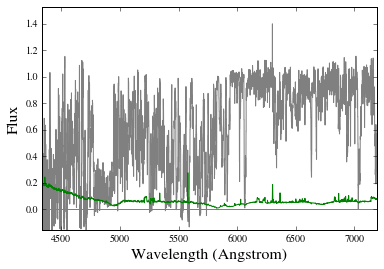

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ114436.66+095904.9_F.fits.gz for BOSSJ1144+0959
S/N 181.598447758 1 / Angstrom


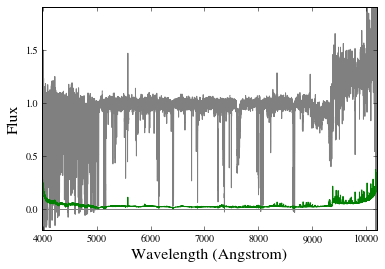

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ114546.22+032251.9_F.fits.gz for BOSSJ1145+0322
S/N 51.0192990134 1 / Angstrom


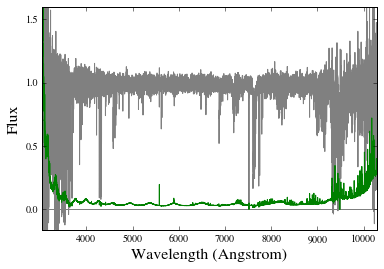

No spectrum found for BOSSJ1159+1433 and wvobs=4195.83 Angstrom!
No spectrum found for BOSSJ1200+0129 and wvobs=4709.44 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ120416.69+022111.0_b1200_F.fits.gz
No continuum: /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz
Using conti=1 for HIRES
Using /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz for BOSSJ1204+0221
S/N 326.062399277 1 / Angstrom


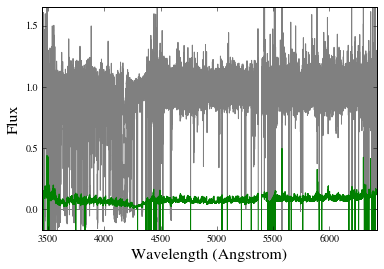

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120857.16+073727.3_F.fits.gz for APOJ1208+0737
S/N 14.4530959413 1 / Angstrom


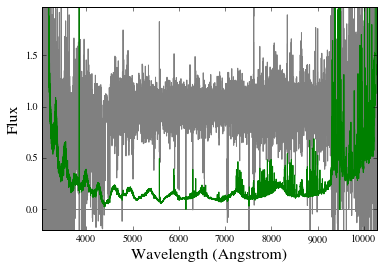

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ121201.68+324013.3.fits for BOSSJ1212+3240
S/N 7.97757344737 1 / Angstrom


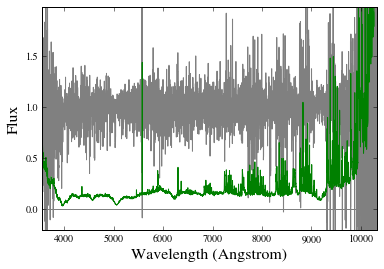

Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ121558.80+571555.4.fits.gz for BOSSJ1215+5715
S/N 15.3854556421 1 / Angstrom


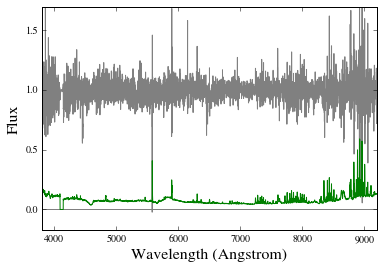

No spectrum found for BOSSJ1225+5709 and wvobs=4485.29 Angstrom!
No spectrum found for BOSSJ1231+0029 and wvobs=6504.24 Angstrom!
No spectrum found for BOSSJ1239+3955 and wvobs=4399.48 Angstrom!
No spectrum found for BOSSJ1242+5331 and wvobs=4206.91 Angstrom!
Using spec-3972-55589-0570.fits.gz for BOSSJ1244+3916
S/N 9.25724923589 1 / Angstrom


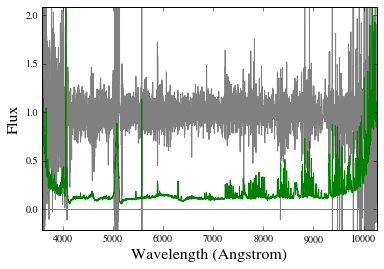

No spectrum found for BOSSJ1244+3208 and wvobs=4630.65 Angstrom!
No spectrum found for BOSSJ1245+5922 and wvobs=4514.02 Angstrom!
No spectrum found for BOSSJ1246+2345 and wvobs=4635.85 Angstrom!
Using spec-4703-55617-0350.fits.gz for BOSSJ1248+4058
S/N 13.6793656083 1 / Angstrom


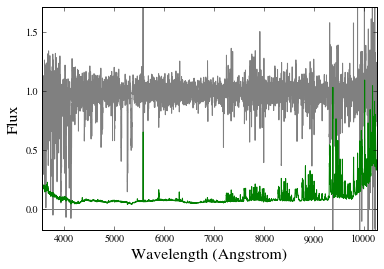

No spectrum found for BOSSJ1253+6327 and wvobs=4594.27 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ130125.67+475930.8.fits.gz for SDSSJ1301+4759
S/N 10.8580339213 1 / Angstrom


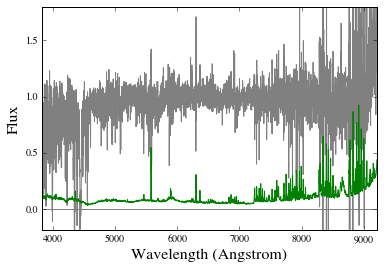

No spectrum found for APOJ1306+6158 and wvobs=4813.24 Angstrom!
No spectrum found for BOSSJ1310+1134 and wvobs=4517.18 Angstrom!
No spectrum found for BOSSJ1319+2138 and wvobs=4276.08 Angstrom!
No spectrum found for APOJ1327+3423 and wvobs=4100.35 Angstrom!
No spectrum found for BOSSJ1335+4330 and wvobs=4624.98 Angstrom!
No spectrum found for BOSSJ1346+1952 and wvobs=4749.06 Angstrom!
No spectrum found for BOSSJ1356+6133 and wvobs=4680.86 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ135849.54+273756.9.fits for APOJ1358+2737
S/N 8.49498885716 1 / Angstrom


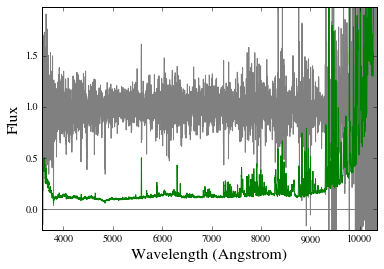

No spectrum found for BOSSJ1402+4701 and wvobs=4514.41 Angstrom!
No spectrum found for BOSSJ1410+4804 and wvobs=4312.2 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ141337.96+271511.0.fits for SDSSJ1413+2715
S/N 21.7889265018 1 / Angstrom


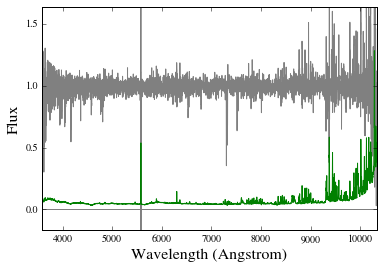

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ142004.12+022708.8_F.fits.gz for BOSSJ1420+0227
S/N 51.3980105492 1 / Angstrom


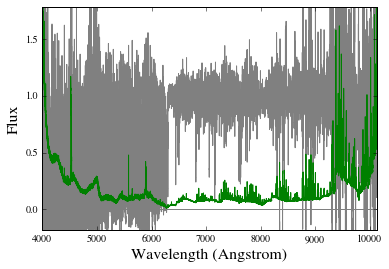

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142054.92+160342.9_F.fits.gz for APOJ1420+1603
S/N 92.5854414587 1 / Angstrom


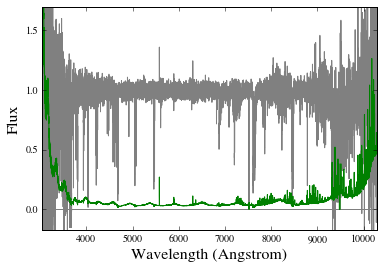

No spectrum found for BOSSJ1422+4652 and wvobs=4252.87 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ142758.74-012136.2_b1200_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142758.74-012136.2_F.fits.gz for BOSSJ1427-0121
S/N 110.259264069 1 / Angstrom


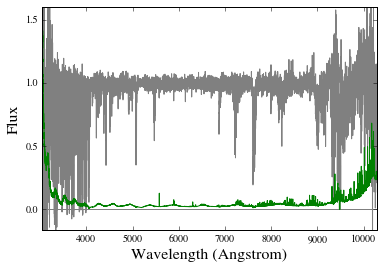

No spectrum found for BOSSJ1428+5509 and wvobs=4284.69 Angstrom!
No spectrum found for APOJ1431+5727 and wvobs=4147.67 Angstrom!
Using spec-5467-55973-0438.fits.gz for BOSSJ1433+0827
S/N 10.9165867956 1 / Angstrom


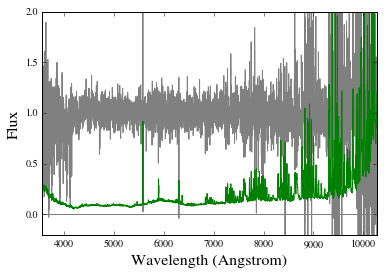

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_4_45/SDSSJ143344.55+064111.9.fits for BOSSJ1433+0641
S/N 14.6793126358 1 / Angstrom


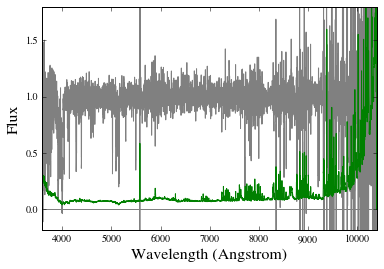

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ144231.91+013734.8.fits for BOSSJ1442+0137
S/N 24.5976142131 1 / Angstrom


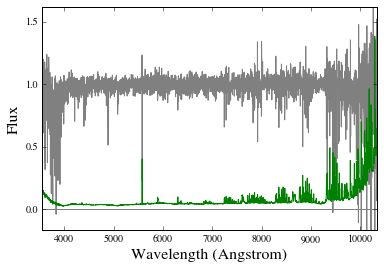

No spectrum found for BOSSJ1457+0237 and wvobs=4348.85 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ150812.80+363530.3.fits for BOSSJ1508+3635
S/N 6.87693182737 1 / Angstrom


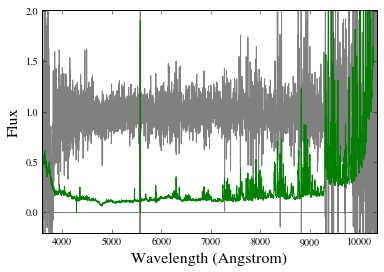

No spectrum found for BOSSJ1517+2002 and wvobs=4207.37 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ153329.17+142537.8.fits for BOSSJ1533+1425
S/N 12.7148246482 1 / Angstrom


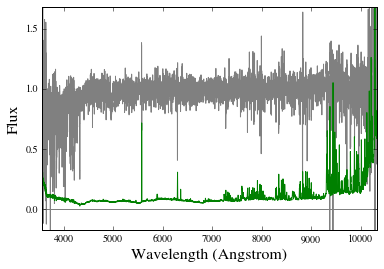

No spectrum found for BOSSJ1538+5707 and wvobs=4537.65 Angstrom!
No spectrum found for BOSSJ1539+3146 and wvobs=4441.25 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ155325.89+192137.7_F.fits.gz for APOJ1553+1921
S/N 45.206046235 1 / Angstrom


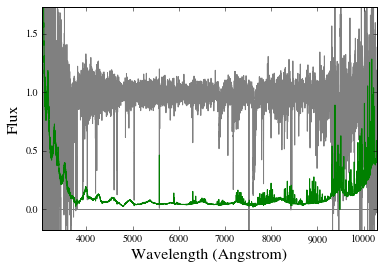

Using spec-4900-55739-0026.fits.gz for BOSSJ1554+1244
S/N 10.2994953239 1 / Angstrom


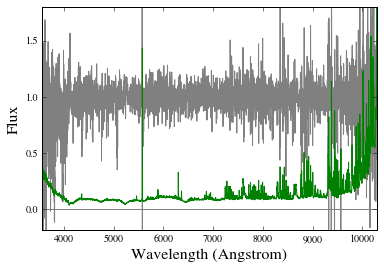

No spectrum found for BOSSJ1556+3040 and wvobs=4660.78 Angstrom!
No spectrum found for BOSSJ1557+0434 and wvobs=4428.74 Angstrom!
No spectrum found for APOJ1559+4943 and wvobs=4428.27 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ160546.67+511323.0.fits for BOSSJ1605+5113
S/N 20.8590099184 1 / Angstrom


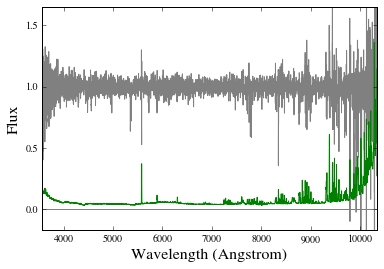

No spectrum found for BOSSJ1618+1842 and wvobs=4719.02 Angstrom!
No spectrum found for BOSSJ1619+1926 and wvobs=4306.14 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ162737.91+221509.3_F.fits.gz for BOSSJ1627+2215
S/N 57.8484634235 1 / Angstrom


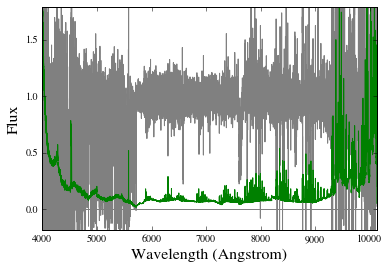

Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ162737.25+460609.3_F.fits.gz for APOJ1627+4606
S/N 91.8390265989 1 / Angstrom


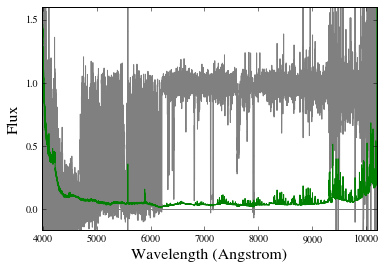

No spectrum found for BOSSJ1631+4333 and wvobs=4670.28 Angstrom!
No spectrum found for BOSSJ1651+3410 and wvobs=4131.89 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MODS_redux//./SDSSJ165716.52+310524.5_b_F.fits.gz for BOSSJ1657+3105
S/N 22.2855304955 1 / Angstrom


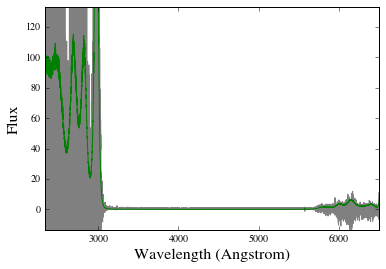

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ214620.98-075303.8_F.fits.gz for APOJ2146-0753
S/N 45.2887015656 1 / Angstrom


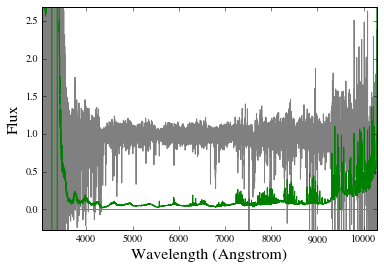

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ220248.31+123656.3.fits for BOSSJ2202+1236
S/N 7.00369061924 1 / Angstrom


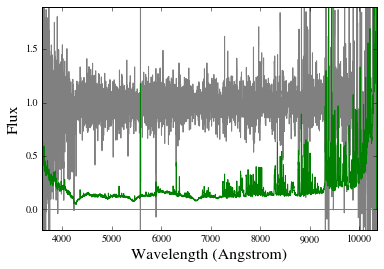

No spectrum found for BOSSJ2212-0011 and wvobs=4615.81 Angstrom!
Using spec-4206-55471-0936.fits.gz for BOSSJ2255-0001
S/N 8.96133909541 1 / Angstrom


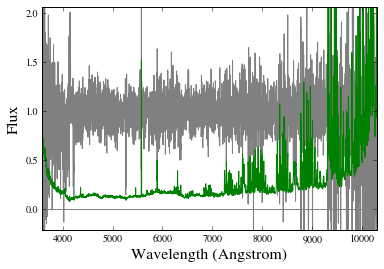

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ225549.55-000927.7.fits for BOSSJ2255-0009
S/N 8.3559972113 1 / Angstrom


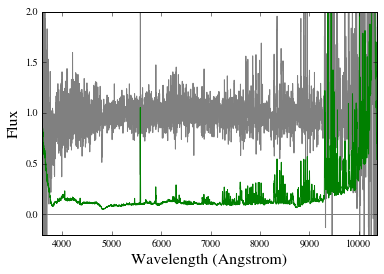

Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ233845.45-000331.8.fits for BOSSJ2338-0003
S/N 6.5900547353 1 / Angstrom


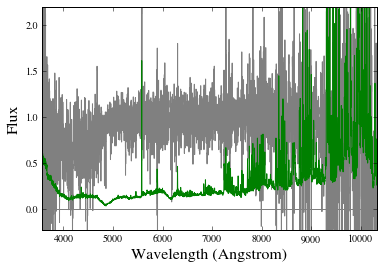

No spectrum found for BOSSJ2354-0019 and wvobs=4263.6 Angstrom!


In [28]:
stack_tup0 = qpq9k.qpq9_IRMgII(passback=True,wrest=1548.195*u.AA,S2N_cut=5.5/u.AA,zfg_mnx=(1.6,9999),atmosphere_cut=True)
# Mask
fin_velo, stck_img, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
    if 'J1002+0020' in dd['qpq']['NAME']:
        idx_mask.append(ii) 
    if '[OIII]' == dd['qpq']['ZFG_LINE']:
        idx_mask.append(ii)
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [29]:
np.sum(stck_mskN,0)

array([ 45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,
        45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,
        45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,
        45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,
        45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,  45.,
        45.,  45.,  45.,  45.,  45.,  45.])

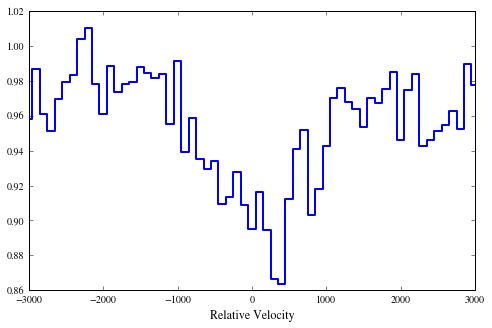

In [30]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)
plt.show()

## Try stacking MgII without [OIII]

Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits
No spectrum found for BOSSJ0001+0000 and wvobs=8359.87 Angstrom!
No spectrum found for BOSSJ0008-0039 and wvobs=7306.58 Angstrom!
No spectrum found for BOSSJ0008-0039 and wvobs=8215.92 Angstrom!
No spectrum found for BOSSJ0042+1350 and wvobs=7762.94 Angstrom!
Using spec-6203-56266-0300.fits.gz for BOSSJ0047+1447
S/N 10.2401891376 1 / Angstrom


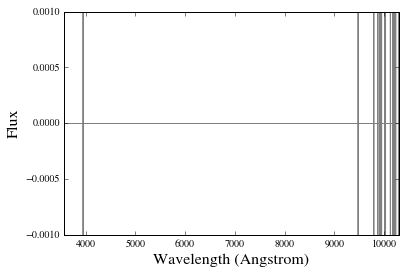

No spectrum found for BOSSJ0057-0001 and wvobs=8838.87 Angstrom!
No spectrum found for BOSSJ0103-0002 and wvobs=7700.43 Angstrom!
No spectrum found for BOSSJ0106+0056 and wvobs=8020.8 Angstrom!
No spectrum found for SDSSJ0111+1402 and wvobs=9745.68 Angstrom!
No spectrum found for SDSSJ0149-0021 and wvobs=7500.52 Angstrom!
No spectrum found for BOSSJ0154+0020 and wvobs=7755.5 Angstrom!
No spectrum found for BOSSJ0206+2238 and wvobs=7280.2 Angstrom!
No spectrum found for BOSSJ0214-0052 and wvobs=7835.16 Angstrom!
No spectrum found for BOSSJ0224-0046 and wvobs=7538.73 Angstrom!
No spectrum found for BOSSJ0230-0333 and wvobs=9452.35 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ023946.44-010644.1_F.fits.gz
No spectrum found for BOSSJ0239-0106 and wvobs=9224.55 Angstrom!
No spectrum found for BOSSJ0242-0046 and wvobs=7746.73 Angstrom!
No spectrum found for BOSSJ0250-0047 and wvobs=7976.1 Angstrom!
No spectrum found for BOSSJ0334-0058 and wvobs=7338.55 Angstrom!


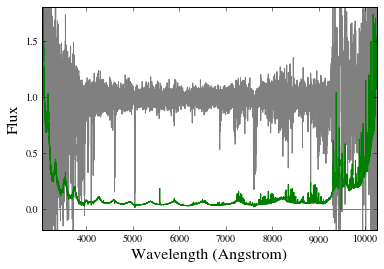

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ040954.21-041137.1_F.fits.gz for SDSSJ0409-0411
S/N 44.0551048259 1 / Angstrom


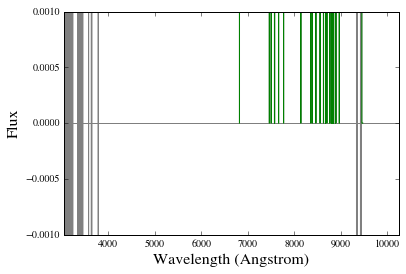

No spectrum found for BOSSJ0749+3702 and wvobs=8266.9 Angstrom!
No spectrum found for SDSSJ0752+4011 and wvobs=8062.43 Angstrom!
No spectrum found for APOJ0800+3542 and wvobs=8339.59 Angstrom!
No spectrum found for BOSSJ0809+4539 and wvobs=8504.22 Angstrom!
No spectrum found for BOSSJ0812+2620 and wvobs=7391.17 Angstrom!
No spectrum found for BOSSJ0814+0402 and wvobs=7730.43 Angstrom!
No spectrum found for BOSSJ0818+1527 and wvobs=7706.87 Angstrom!
No spectrum found for BOSSJ0818+1232 and wvobs=7554.39 Angstrom!
No spectrum found for BOSSJ0826+4708 and wvobs=7826.19 Angstrom!
No spectrum found for SDSSJ0828+4545 and wvobs=8030.56 Angstrom!
No spectrum found for BOSSJ0830+5452 and wvobs=7471.48 Angstrom!
No spectrum found for BOSSJ0833+4823 and wvobs=7272.9 Angstrom!
No spectrum found for BOSSJ0837+0810 and wvobs=8296.52 Angstrom!
No spectrum found for APOJ0837+3630 and wvobs=7928.15 Angstrom!
No spectrum found for APOJ0837+3837 and wvobs=8563.61 Angstrom!
No spectrum found for BOSSJ083

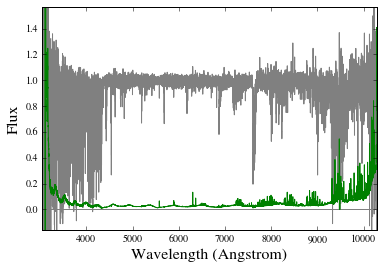

No spectrum found for BOSSJ0856+5514 and wvobs=7330.08 Angstrom!
No spectrum found for BOSSJ0857+3901 and wvobs=8258.74 Angstrom!
No spectrum found for BOSSJ0902+3602 and wvobs=7720.21 Angstrom!
No spectrum found for BOSSJ0903+5133 and wvobs=8020.18 Angstrom!
No spectrum found for BOSSJ0904+0042 and wvobs=7320.9 Angstrom!
No spectrum found for BOSSJ0906+1001 and wvobs=7543.03 Angstrom!
No spectrum found for BOSSJ0907+2802 and wvobs=7704.3 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ091046.69+041448.4_F.fits.gz for APOJ0910+0414
S/N 26.7515845542 1 / Angstrom


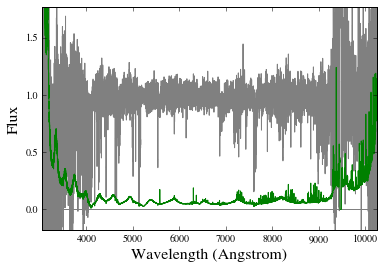

No spectrum found for BOSSJ0911+4905 and wvobs=7811.53 Angstrom!
No spectrum found for BOSSJ0912+4139 and wvobs=7765.52 Angstrom!
No spectrum found for BOSSJ0912+2518 and wvobs=7415.93 Angstrom!
Using spec-5809-56353-0052.fits.gz for BOSSJ0912+3056
S/N 16.4793636553 1 / Angstrom


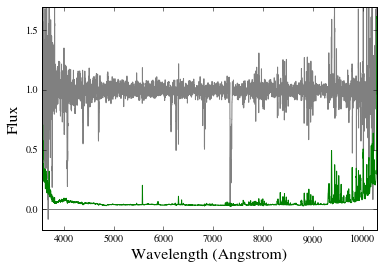

Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ091338.97-010704.6_F.fits.gz for BOSSJ0913-0107
S/N 36.2045833385 1 / Angstrom


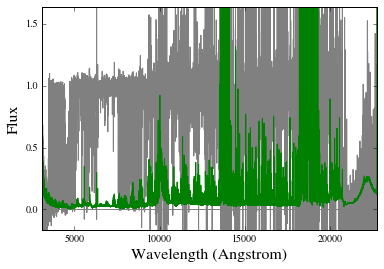

No spectrum found for BOSSJ0913+3151 and wvobs=7533.3 Angstrom!
No spectrum found for BOSSJ0914+0109 and wvobs=8781.11 Angstrom!
No spectrum found for BOSSJ0915+0119 and wvobs=8308.95 Angstrom!
No spectrum found for BOSSJ0916+4250 and wvobs=7660.49 Angstrom!
No spectrum found for BOSSJ0920+3340 and wvobs=7644.43 Angstrom!
No spectrum found for APOJ0924+3929 and wvobs=8068.09 Angstrom!
No spectrum found for BOSSJ0932+0843 and wvobs=7721.14 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ093225.60+092500.2_F.fits.gz for APOJ0932+0925
S/N 15.5986877946 1 / Angstrom


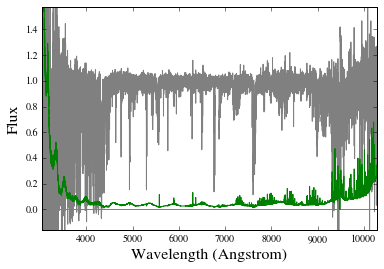

No spectrum found for BOSSJ0933+5920 and wvobs=7992.61 Angstrom!
No spectrum found for BOSSJ0935+4532 and wvobs=8647.46 Angstrom!
No spectrum found for BOSSJ0936-0058 and wvobs=8971.95 Angstrom!
No spectrum found for APOJ0938+5317 and wvobs=8576.49 Angstrom!
No spectrum found for BOSSJ0940+3345 and wvobs=7789.14 Angstrom!
No spectrum found for BOSSJ0941+2308 and wvobs=7754.32 Angstrom!
No spectrum found for BOSSJ0942+1347 and wvobs=7553.54 Angstrom!
No spectrum found for BOSSJ0956+0248 and wvobs=8430.84 Angstrom!
No spectrum found for BOSSJ1000+0337 and wvobs=7547.97 Angstrom!
No spectrum found for BOSSJ1001+4023 and wvobs=7907.67 Angstrom!
No spectrum found for BOSSJ1002+0020 and wvobs=8883.44 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ100507.08+501929.6.fits.gz for SDSSJ1005+5019
S/N 6.52941856034 1 / Angstrom


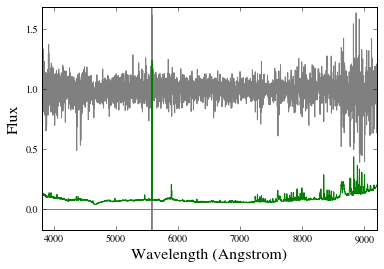

No spectrum found for BOSSJ1006+4804 and wvobs=9236.78 Angstrom!
No spectrum found for BOSSJ1009+1749 and wvobs=8344.39 Angstrom!
No spectrum found for BOSSJ1009+0236 and wvobs=7650.85 Angstrom!
No spectrum found for APOJ1009+2500 and wvobs=8022.84 Angstrom!
No spectrum found for BOSSJ1010+4037 and wvobs=8926.94 Angstrom!
No spectrum found for BOSSJ1010+4517 and wvobs=7788.56 Angstrom!
No spectrum found for BOSSJ1010+0821 and wvobs=8030.54 Angstrom!
No spectrum found for BOSSJ1013+0330 and wvobs=8227.58 Angstrom!
No spectrum found for BOSSJ1014+2653 and wvobs=7629.92 Angstrom!
No spectrum found for BOSSJ1015+1245 and wvobs=7499.5 Angstrom!
No spectrum found for BOSSJ1017+6226 and wvobs=7418.7 Angstrom!
No spectrum found for BOSSJ1020+6119 and wvobs=7796.69 Angstrom!
No spectrum found for BOSSJ1024+0354 and wvobs=7461.87 Angstrom!
Using spec-6463-56340-0210.fits.gz for BOSSJ1024+2616
S/N 6.18168413014 1 / Angstrom


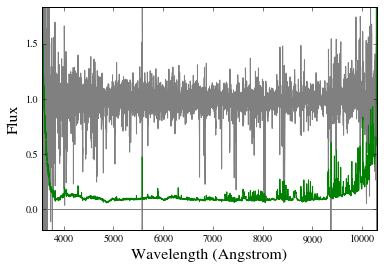

No spectrum found for APOJ1026+4614 and wvobs=12165.5 Angstrom!
No spectrum found for BOSSJ1028+5121 and wvobs=7468.07 Angstrom!
No spectrum found for BOSSJ1034+0856 and wvobs=7375.17 Angstrom!
No spectrum found for BOSSJ1036+5012 and wvobs=8396.78 Angstrom!
No spectrum found for BOSSJ1039+5026 and wvobs=11555.2 Angstrom!
No spectrum found for APOJ1041+1957 and wvobs=7959.85 Angstrom!
No spectrum found for BOSSJ1042+6459 and wvobs=8351.16 Angstrom!
No spectrum found for BOSSJ1044+3139 and wvobs=7568.46 Angstrom!
No spectrum found for APOJ1045+4351 and wvobs=9586.7 Angstrom!
No spectrum found for BOSSJ1045+1000 and wvobs=8447.16 Angstrom!
No spectrum found for BOSSJ1052+5553 and wvobs=8375.3 Angstrom!
No spectrum found for BOSSJ1059+6255 and wvobs=7671.11 Angstrom!
Using spec-6693-56384-0164.fits.gz for BOSSJ1106+4635
S/N 10.8815825437 1 / Angstrom


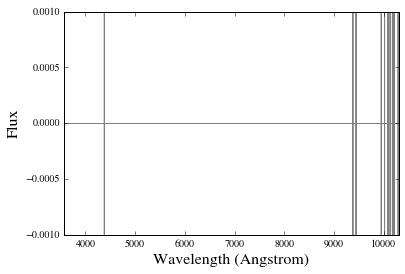

No spectrum found for BOSSJ1113+3305 and wvobs=8087.98 Angstrom!
No spectrum found for BOSSJ1118+4025 and wvobs=8174.42 Angstrom!
No spectrum found for BOSSJ1136-0029 and wvobs=7301.72 Angstrom!
No spectrum found for BOSSJ1138+6329 and wvobs=8065.77 Angstrom!
No spectrum found for BOSSJ1140+2709 and wvobs=7602.13 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114145.43+072423.3_b400_F.fits.gz
No spectrum found for APOJ1141+0724 and wvobs=12725.9 Angstrom!
No spectrum found for BOSSJ1142+2822 and wvobs=7549.73 Angstrom!
No spectrum found for BOSSJ1142+1128 and wvobs=7301.66 Angstrom!
No spectrum found for BOSSJ1144+0959 and wvobs=11110.1 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ114546.22+032251.9_F.fits.gz for BOSSJ1145+0322
S/N 51.7294399516 1 / Angstrom


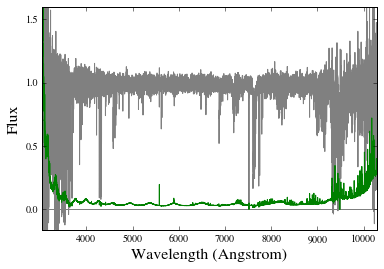

No spectrum found for BOSSJ1150+5802 and wvobs=7666.46 Angstrom!
Using spec-5383-56013-0218.fits.gz for BOSSJ1152+1507
S/N 6.87088787863 1 / Angstrom


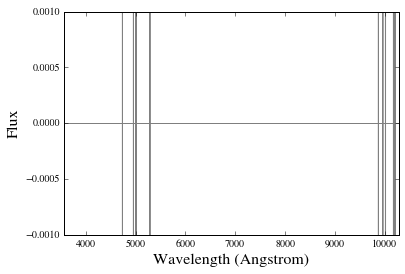

Using spec-4697-55660-0326.fits.gz for BOSSJ1155+3934
S/N 5.51243918821 1 / Angstrom


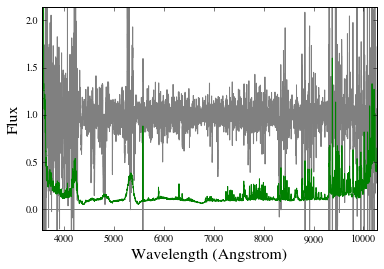

No spectrum found for BOSSJ1159+1433 and wvobs=7578.51 Angstrom!
No spectrum found for BOSSJ1200+0129 and wvobs=8506.2 Angstrom!
No spectrum found for BOSSJ1202+0747 and wvobs=7443.04 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ120416.69+022111.0_b1200_F.fits.gz
No continuum: /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz
Using conti=1 for HIRES
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120416.69+022111.0_F.fits.gz for BOSSJ1204+0221
S/N 10.9859192226 1 / Angstrom


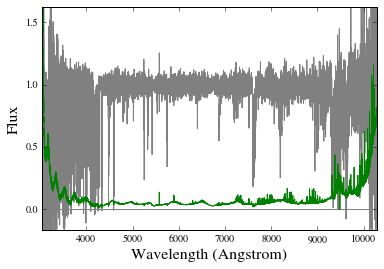

Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ120857.16+073727.3_F.fits.gz for APOJ1208+0737
S/N 10.7536360531 1 / Angstrom


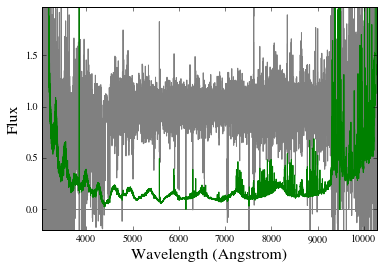

No spectrum found for BOSSJ1212+3240 and wvobs=8335.29 Angstrom!
No spectrum found for BOSSJ1213+4719 and wvobs=7919.04 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ121558.80+571555.4.fits.gz for BOSSJ1215+5715
S/N 9.0646628842 1 / Angstrom


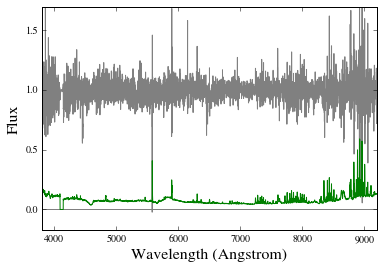

No spectrum found for BOSSJ1225+5709 and wvobs=8101.33 Angstrom!
No spectrum found for BOSSJ1231+0029 and wvobs=11748 Angstrom!
No spectrum found for BOSSJ1239+3955 and wvobs=7946.35 Angstrom!
No spectrum found for BOSSJ1242+5331 and wvobs=7598.52 Angstrom!
No spectrum found for BOSSJ1244+3916 and wvobs=8381.61 Angstrom!
No spectrum found for BOSSJ1244+3208 and wvobs=8363.89 Angstrom!
No spectrum found for BOSSJ1245+5922 and wvobs=8153.23 Angstrom!
No spectrum found for BOSSJ1246+2345 and wvobs=8373.27 Angstrom!
Using spec-4703-55617-0350.fits.gz for BOSSJ1248+4058
S/N 5.87116767045 1 / Angstrom


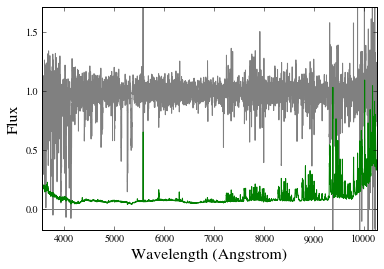

No spectrum found for BOSSJ1253+6327 and wvobs=8298.17 Angstrom!
No spectrum found for BOSSJ1255+2234 and wvobs=7875.36 Angstrom!
No spectrum found for SDSSJ1301+4759 and wvobs=8931.42 Angstrom!
No spectrum found for APOJ1306+6158 and wvobs=8693.68 Angstrom!
No spectrum found for BOSSJ1310+1134 and wvobs=8158.93 Angstrom!
No spectrum found for BOSSJ1319+2138 and wvobs=7723.46 Angstrom!
No spectrum found for BOSSJ1325+5409 and wvobs=8518.69 Angstrom!
No spectrum found for APOJ1327+3423 and wvobs=7406.06 Angstrom!
No spectrum found for BOSSJ1335+4330 and wvobs=8353.65 Angstrom!
No spectrum found for BOSSJ1346+1952 and wvobs=8577.76 Angstrom!
No spectrum found for BOSSJ1356+6133 and wvobs=8454.58 Angstrom!
No spectrum found for APOJ1358+2737 and wvobs=8108.32 Angstrom!
No spectrum found for BOSSJ1402+4701 and wvobs=8153.94 Angstrom!
No spectrum found for BOSSJ1410+4804 and wvobs=7788.69 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ141337.96+271511.0.fits for SDSSJ1413

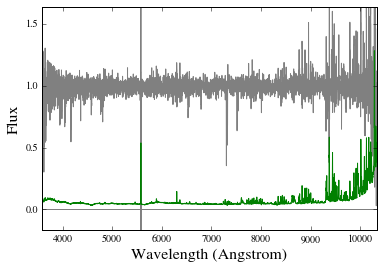

No spectrum found for BOSSJ1420+0227 and wvobs=12909.8 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142054.92+160342.9_F.fits.gz for APOJ1420+1603
S/N 34.7418613707 1 / Angstrom


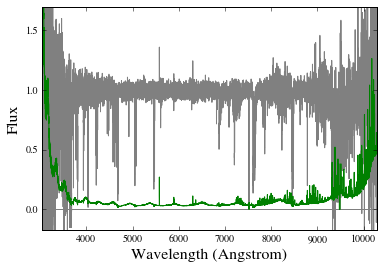

No spectrum found for BOSSJ1422+4652 and wvobs=7681.55 Angstrom!
No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ142758.74-012136.2_b1200_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142758.74-012136.2_F.fits.gz for BOSSJ1427-0121
S/N 35.6455711808 1 / Angstrom


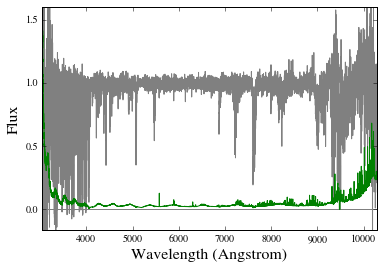

No spectrum found for BOSSJ1428+5509 and wvobs=7739.01 Angstrom!
No spectrum found for APOJ1431+5727 and wvobs=7491.53 Angstrom!
No spectrum found for BOSSJ1433+0827 and wvobs=8055.24 Angstrom!
No spectrum found for BOSSJ1433+0641 and wvobs=9210.41 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ144231.91+013734.8.fits for BOSSJ1442+0137
S/N 8.76419878037 1 / Angstrom


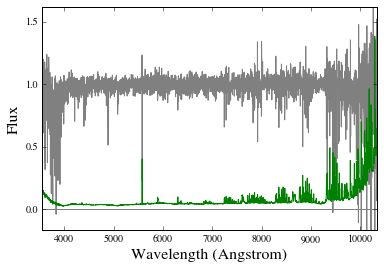

No spectrum found for BOSSJ1448+5649 and wvobs=7859.53 Angstrom!
No spectrum found for BOSSJ1457+0237 and wvobs=7854.9 Angstrom!
No spectrum found for BOSSJ1508+3635 and wvobs=7964.3 Angstrom!
No spectrum found for BOSSJ1515+2627 and wvobs=8201.42 Angstrom!
No spectrum found for BOSSJ1517+2002 and wvobs=7599.35 Angstrom!
No spectrum found for BOSSJ1530+2515 and wvobs=7812.69 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ153329.17+142537.8.fits for BOSSJ1533+1425
S/N 5.65945699302 1 / Angstrom


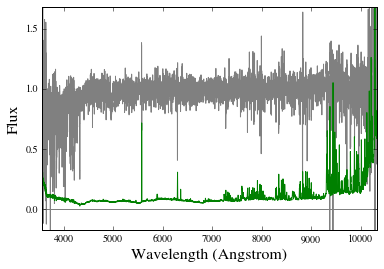

No spectrum found for BOSSJ1534+2153 and wvobs=7463.36 Angstrom!
No spectrum found for BOSSJ1538+5707 and wvobs=8195.92 Angstrom!
No spectrum found for BOSSJ1539+3146 and wvobs=8021.79 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ155325.89+192137.7_F.fits.gz for APOJ1553+1921
S/N 28.2784594603 1 / Angstrom


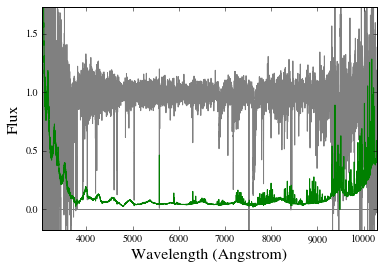

No spectrum found for BOSSJ1554+1244 and wvobs=7874.64 Angstrom!
No spectrum found for BOSSJ1556+3040 and wvobs=8418.31 Angstrom!
No spectrum found for BOSSJ1557+0434 and wvobs=7999.19 Angstrom!
No spectrum found for APOJ1559+4943 and wvobs=7998.35 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ160546.67+511323.0.fits for BOSSJ1605+5113
S/N 11.398281721 1 / Angstrom


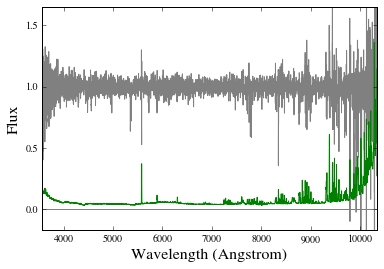

No spectrum found for BOSSJ1618+1842 and wvobs=8523.49 Angstrom!
No spectrum found for BOSSJ1619+1926 and wvobs=7777.76 Angstrom!
No spectrum found for BOSSJ1627+2215 and wvobs=11897.1 Angstrom!
No spectrum found for APOJ1627+4606 and wvobs=13463.2 Angstrom!
No spectrum found for BOSSJ1628+2342 and wvobs=7607.08 Angstrom!
No spectrum found for BOSSJ1631+4333 and wvobs=8435.48 Angstrom!
No spectrum found for BOSSJ1631+3659 and wvobs=7381.25 Angstrom!
No spectrum found for BOSSJ1635+2547 and wvobs=8023.04 Angstrom!
No spectrum found for BOSSJ1651+3410 and wvobs=7463.03 Angstrom!
No spectrum found for BOSSJ1657+3105 and wvobs=8757.58 Angstrom!
No spectrum found for BOSSJ2053-0104 and wvobs=8426.08 Angstrom!
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ214620.98-075303.8_F.fits.gz for APOJ2146-0753
S/N 19.0978714623 1 / Angstrom


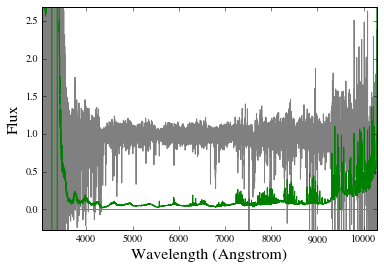

No spectrum found for BOSSJ2156-0003 and wvobs=7490.9 Angstrom!
No spectrum found for BOSSJ2202+1236 and wvobs=8583.38 Angstrom!
No spectrum found for BOSSJ2212-0011 and wvobs=8337.09 Angstrom!
No spectrum found for BOSSJ2255-0001 and wvobs=7640.11 Angstrom!
No spectrum found for BOSSJ2255-0009 and wvobs=8417.3 Angstrom!
No spectrum found for BOSSJ2314-0108 and wvobs=7400.53 Angstrom!
No spectrum found for BOSSJ2338-0003 and wvobs=9618.54 Angstrom!
No spectrum found for BOSSJ2341-0041 and wvobs=7637.36 Angstrom!
No spectrum found for BOSSJ2348+0110 and wvobs=7534.78 Angstrom!
No spectrum found for BOSSJ2352-0015 and wvobs=7627.15 Angstrom!
No spectrum found for BOSSJ2354-0019 and wvobs=7700.92 Angstrom!


In [25]:
stack_tup0 = qpq9k.qpq9_IRMgII(passback=True,wrest=2796.352*u.AA,S2N_cut=5.5/u.AA,zfg_mnx=(1.6,9999),atmosphere_cut=True)
# Mask
fin_velo, stck_img, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
    if 'J0822+1319' in dd['qpq']['NAME']: #BAL
        idx_mask.append(ii) 
    if '[OIII]' == dd['qpq']['ZFG_LINE']:
        idx_mask.append(ii)
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [26]:
np.sum(stck_mskN,0)

array([ 17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,
        17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  16.,
        16.,  16.,  16.,  16.,  16.,  16.,  17.,  17.,  17.,  17.,  17.,
        17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,
        17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,  17.,
        17.,  16.,  16.,  16.,  16.,  16.])

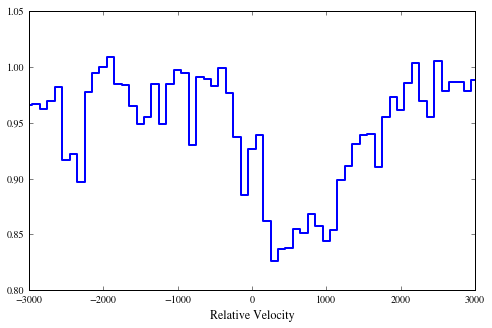

In [27]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)
plt.show()

## Try replacing [OIII] in the sample with Halpha or Hbeta or MgII, when available

In [5]:
qpq9 = eqpq.QPQ('QPQ9')
qpq9.cull(1334.5323*u.AA,4)
zfg = qpq9._fulldata['Z_FG']
bad = np.where((zfg < 1.6) | (zfg > 9999))[0]
qpq9.mask[bad] = False
QPQ9 = copy.deepcopy(qpq9._fulldata[qpq9.mask])
c_qpq9 = SkyCoord(ra=QPQ9['FG_RA']*u.deg,dec=QPQ9['FG_DEC']*u.deg)

Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits


In [5]:
zem_fil = glob.glob(os.getenv('DROPBOX_DIR')+'Marie_Enrico/papers/QPQ9/Analysis/Redshifts/zem/From_X_Joe/*')
zem_list = []
zem_coord = []
for ff in zem_fil:
    zem = xxf.bintab_to_table(ff)
    zem_list.append(zem)
    ipos = zem['SPEC_FIL'][0].rfind('/SDSSJ')+6
    radec = zem['SPEC_FIL'][0][ipos:]
    ipos2 = radec.rfind('+')
    if ipos2 == -1:
        ipos2 = radec.rfind('-')
    ipos3 = radec.rfind('_F.fits')
    if ipos3 == -1:
        ipos3 = radec.rfind('.fits')
    RA = radec[0:2]+'h'+radec[2:4]+'m'+radec[4:ipos2]+'s'
    dec = radec[ipos2:ipos2+3]+'d'+radec[ipos2+3:ipos2+5]+'m'+radec[ipos2+5:ipos3]+'s'
    zem_coord.append(SkyCoord(RA,dec))
zem_fil = glob.glob(os.getenv('DROPBOX_DIR')+'Marie_Enrico/papers/QPQ9/Analysis/Redshifts/zem/*.fits')
for ff in zem_fil:
    zem = xxf.bintab_to_table(ff)
    zem_list.append(zem)
    ipos = zem['SPEC_FIL'][0].rfind('/SDSSJ')+6
    radec = zem['SPEC_FIL'][0][ipos:]
    RA = radec[0:2]+'h'+radec[2:4]+'m'+radec[4:9]+'s'
    dec = radec[9:12]+'d'+radec[12:14]+'m'+radec[14:18]+'s'
    zem_coord.append(SkyCoord(RA,dec))
zem_coord = SkyCoord(zem_coord)

x.fits.bintab_to_table: Reading /Users/lwymarie/Dropbox/Marie_Enrico/papers/QPQ9/Analysis/Redshifts/zem/From_X_Joe/SDSSJ005717.36-000113.3_zem.fits
x.fits.bintab_to_table: Reading /Users/lwymarie/Dropbox/Marie_Enrico/papers/QPQ9/Analysis/Redshifts/zem/From_X_Joe/SDSSJ022517.68+004821.9_zem.fits
x.fits.bintab_to_table: Reading /Users/lwymarie/Dropbox/Marie_Enrico/papers/QPQ9/Analysis/Redshifts/zem/From_X_Joe/SDSSJ080049.89+354249.6_zem.fits
x.fits.bintab_to_table: Reading /Users/lwymarie/Dropbox/Marie_Enrico/papers/QPQ9/Analysis/Redshifts/zem/From_X_Joe/SDSSJ083757.91+383727.1_zem.fits
x.fits.bintab_to_table: Reading /Users/lwymarie/Dropbox/Marie_Enrico/papers/QPQ9/Analysis/Redshifts/zem/From_X_Joe/SDSSJ084158.47+392121.0_zem.fits
x.fits.bintab_to_table: Reading /Users/lwymarie/Dropbox/Marie_Enrico/papers/QPQ9/Analysis/Redshifts/zem/From_X_Joe/SDSSJ085358.36-001108.0_zem.fits
x.fits.bintab_to_table: Reading /Users/lwymarie/Dropbox/Marie_Enrico/papers/QPQ9/Analysis/Redshifts/zem/From_X_J

In [17]:
SkyCoord(QPQ9[26]['RA']*u.deg,QPQ9[26]['DEC']*u.deg).to_string('hmsdms'),QPQ9[26]['ZFG_LINE']

(u'12h15m58.82s +57d15m55.5s', 'H$\\alpha$')

In [7]:
# replace [OIII] with MgII or Halpha or Hbeta, in this order
for qq,cc in enumerate(c_qpq9):
    if QPQ9[qq]['ZFG_LINE'] == '[OIII]':
        for zz,zem in enumerate(zem_list):
            if cc.separation(zem_coord[zz]) < 5*u.arcsec:
                print(zem_coord[zz].to_string('hmsdms'))
                if zem['MGII_GAUS'] != -1:
                    QPQ9[qq]['Z_FG'] = zem['MGII_GAUS']/2799.4026-1
                    QPQ9[qq]['Z_FSIG'] = 272
                    QPQ9[qq]['ZFG_LINE'] = 'MgII'
                elif zem['HA_GAUS'] != -1:
                    QPQ9[qq]['Z_FG'] = zem['HA_GAUS']/6564.61-1
                    QPQ9[qq]['Z_FSIG'] = 109
                    QPQ9[qq]['ZFG_LINE'] = 'H$\\alpha$' 
                    print('Changed to Ha')
                elif zem['HB_GAUS'] != -1:
                    QPQ9[qq]['Z_FG'] = zem['HB_GAUS']/4862.68-1
                    QPQ9[qq]['Z_FSIG'] = 109
                    QPQ9[qq]['ZFG_LINE'] = 'H$\\beta$'         
                else:
                    print('[OIII] is kept')
                break

08h00m49.89s +35d42m49.6s
08h41m58.47s +39d21m21s
08h53m58.36s -00d11m08s
09h32m26.34s +09d25m26.1s
10h38m57.37s +50d27m08s
11h44m35.53s +09d59m21.6s
[OIII] is kept
12h04m17.47s +02d21m04.7s
12h15m59s +57d16m16.7s
Changed to Ha
12h31m43.09s +00d28m46.2s
14h20m54.418s +16d03m33.34s
14h27m58.88s -01d21m30.3s
14h33m45.5s +06d41m10s
15h53m25.61s +19d21m40.9s
Changed to Ha
16h27m38.63s +46d05m38.4s


/Users/lwymarie/python/specdb/specdb/query_catalog.py:140: UserWarning: No sources found at your coordinate within tol=0.5 arcsec.  Returning None
  warnings.warn("No sources found at your coordinate within tol={:g}.  Returning None".format(tol))
/Users/lwymarie/python/linetools/linetools/spectra/xspectrum1d.py:295: UserWarning: No unit given to wavelength, assuming Angstroms.
  warnings.warn("No unit given to wavelength, assuming Angstroms.")


4.5030178527 1 / Angstrom
No spectrum found for BOSSJ0008-0039 and wvobs=3920.97 Angstrom!
3.96814209033 1 / Angstrom
No spectrum found for BOSSJ0042+1350 and wvobs=3704.79 Angstrom!
81.1223225091 1 / Angstrom
44.1513656402 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ034139.19-000012.7_b1200_F.fits.gz for SDSSJ0341-0000
S/N 81.1223225091 1 / Angstrom


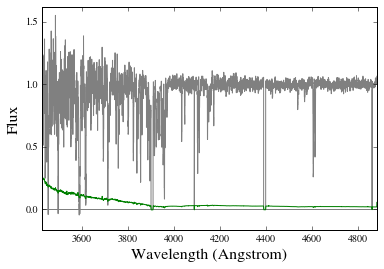

91.8644862996 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ080048.74+354231.3_b1200_F.fits.gz for APOJ0800+3542
S/N 91.8644862996 1 / Angstrom


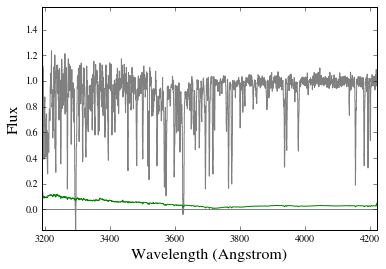

6.82627542183 1 / Angstrom
Using spec-7328-56715-0428.fits.gz for BOSSJ0809+4539
S/N 6.82627542183 1 / Angstrom


/Users/lwymarie/python/specdb/specdb/query_catalog.py:145: UserWarning: Found multiple sources in the catalog. Taking the closest one
  warnings.warn("Found multiple sources in the catalog. Taking the closest one")


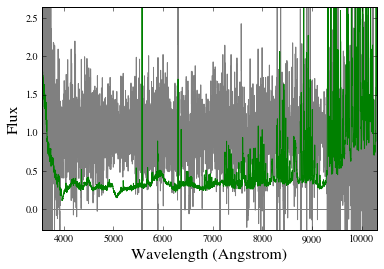

No spectrum found for BOSSJ0826+4708 and wvobs=3734.97 Angstrom!
7.18768185783 1 / Angstrom
30.4325951329 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ082844.87+454518.2_b1200_F.fits.gz for SDSSJ0828+4545
S/N 30.4325951329 1 / Angstrom


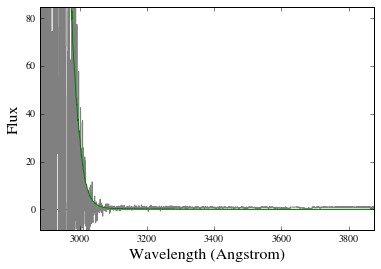

30.2325672808 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ083757.13+383722.4_b1200_F.fits.gz for APOJ0837+3837
S/N 30.2325672808 1 / Angstrom


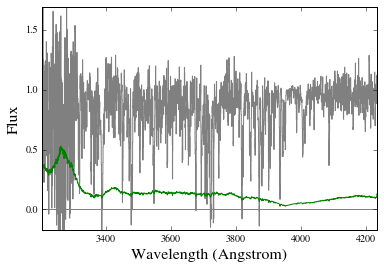

14.0924895296 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ084159.26+392140.0.fits for BOSSJ0841+3921
S/N 14.0924895296 1 / Angstrom


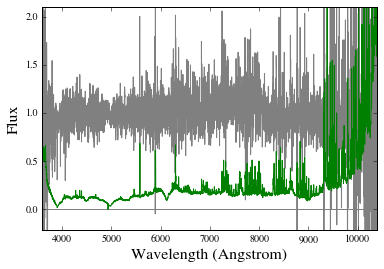

98.9437539982 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ085357.49-001106.1_F.fits.gz for BOSSJ0853-0011
S/N 98.9437539982 1 / Angstrom


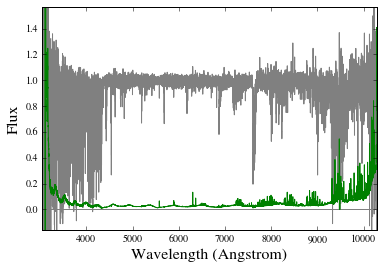

1.62381004726 1 / Angstrom
No spectrum found for BOSSJ0903+5133 and wvobs=3827.56 Angstrom!
No spectrum found for BOSSJ0904+0042 and wvobs=3493.83 Angstrom!
150.03949429 1 / Angstrom
17.3991571859 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/XSHOOTER_redux//./SDSSJ091338.97-010704.6_F.fits.gz for BOSSJ0913-0107
S/N 150.03949429 1 / Angstrom


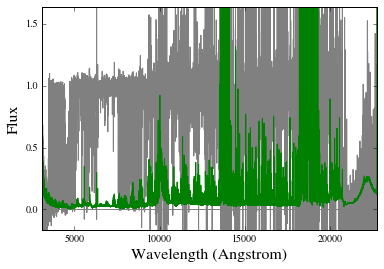

10.8041188824 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ091553.38+011911.3.fits for BOSSJ0915+0119
S/N 10.8041188824 1 / Angstrom


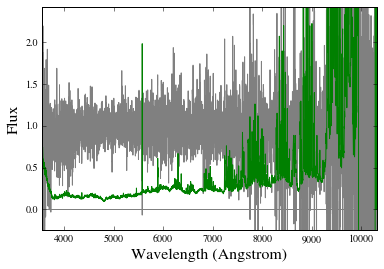

73.81824179 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ092416.73+392914.6_b1200_F.fits.gz for APOJ0924+3929
S/N 73.81824179 1 / Angstrom


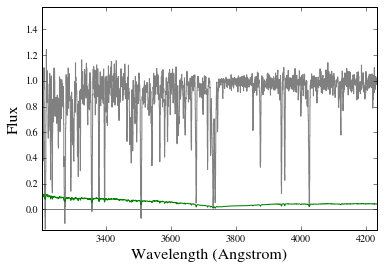

61.3974990367 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ093225.60+092500.2_F.fits.gz for APOJ0932+0925
S/N 61.3974990367 1 / Angstrom


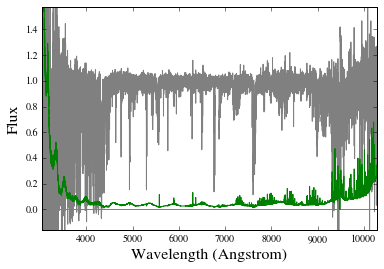

3.9769376434 1 / Angstrom
No spectrum found for BOSSJ1002+0020 and wvobs=4239.54 Angstrom!
61.5398404705 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ100507.08+501929.8_b1200_F.fits.gz for SDSSJ1005+5019
S/N 61.5398404705 1 / Angstrom


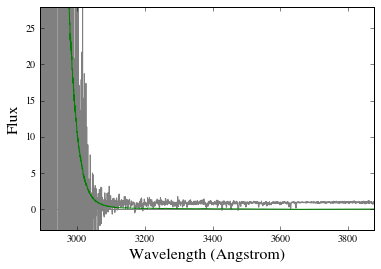

5.73742272355 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ100940.58+250053.9.fits for APOJ1009+2500
S/N 5.73742272355 1 / Angstrom


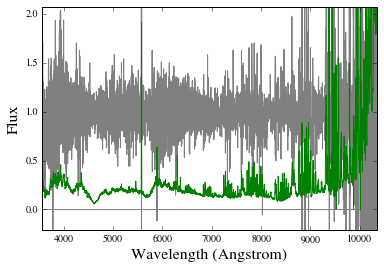

108.634313678 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ102616.12+461420.8_F.fits.gz for APOJ1026+4614
S/N 108.634313678 1 / Angstrom


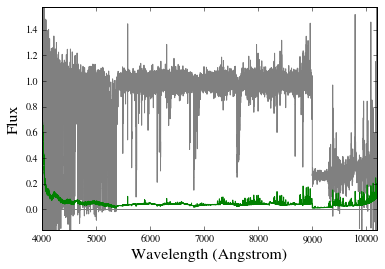

18.4091862035 1 / Angstrom
Using spec-6702-56381-0508.fits.gz for BOSSJ1036+5012
S/N 18.4091862035 1 / Angstrom


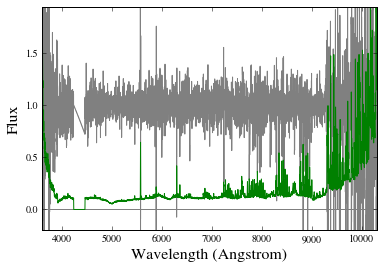

47.8718880457 1 / Angstrom
14.4279488875 1 / Angstrom
56.6564553345 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ103900.01+502652.8_F.fits.gz for BOSSJ1039+5026
S/N 56.6564553345 1 / Angstrom


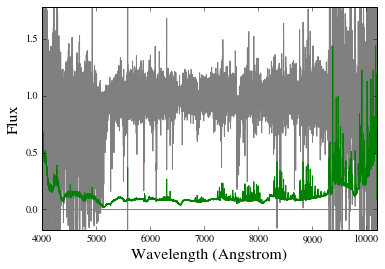

13.0086514544 1 / Angstrom
Using spec-7083-56722-0068.fits.gz for BOSSJ1042+6459
S/N 13.0086514544 1 / Angstrom


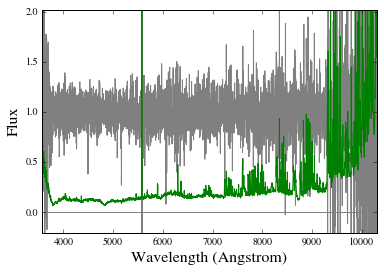

52.1925547055 1 / Angstrom
24.7137380174 1 / Angstrom
No continuum: /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ114145.43+072423.3_b400_F.fits.gz
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ114145.43+072423.3_b600_F.fits.gz for APOJ1141+0724
S/N 52.1925547055 1 / Angstrom


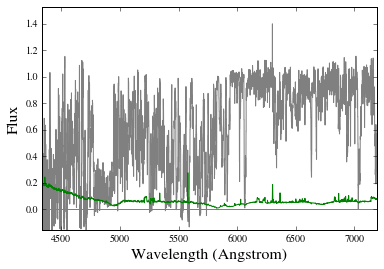

68.393253611 1 / Angstrom
143.628373235 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ114436.66+095904.9_F.fits.gz for BOSSJ1144+0959
S/N 143.628373235 1 / Angstrom


/Users/lwymarie/anaconda/lib/python2.7/site-packages/astropy/units/quantity.py:850: RuntimeWarning: invalid value encountered in true_divide
  return super(Quantity, self).__itruediv__(other)
/Users/lwymarie/anaconda/lib/python2.7/site-packages/astropy/units/quantity.py:850: RuntimeWarning: divide by zero encountered in true_divide
  return super(Quantity, self).__itruediv__(other)


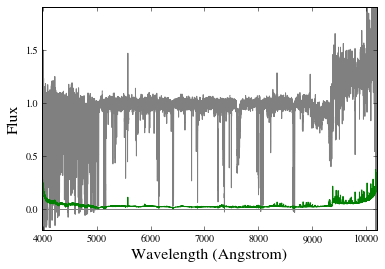

No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ120416.69+022111.0_b1200_F.fits.gz
No continuum: /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz
Using conti=1 for HIRES
143.047334526 1 / Angstrom
47.188441262 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/HIRES_redux//./SDSSJ120416.69+022111.0_f.fits.gz for BOSSJ1204+0221
S/N 143.047334526 1 / Angstrom


/Users/lwymarie/python/linetools/linetools/spectra/xspectrum1d.py:807: UserWarning: Ignoring NAN and inf in flux
  warnings.warn("Ignoring NAN and inf in flux")


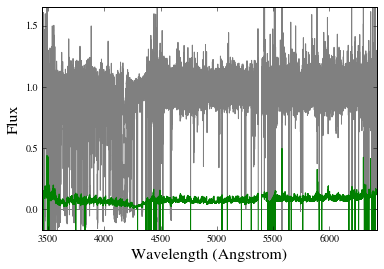

15.401234436 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/SDSS//./SDSSJ121558.80+571555.4.fits.gz for BOSSJ1215+5715
S/N 15.401234436 1 / Angstrom


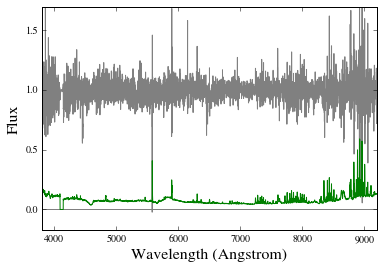

81.0471443799 1 / Angstrom
12.4844749585 1 / Angstrom
28.8304567774 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ123141.73+002913.9_b600_F.fits.gz for BOSSJ1231+0029
S/N 81.0471443799 1 / Angstrom


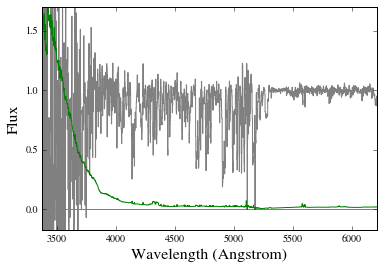

5.74372243786 1 / Angstrom
Using spec-6482-56358-0110.fits.gz for BOSSJ1244+3208
S/N 5.74372243786 1 / Angstrom


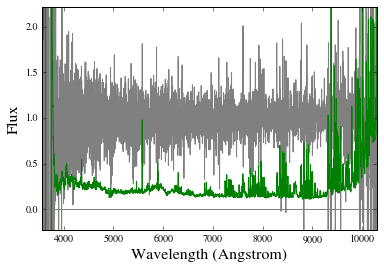

3.27963612433 1 / Angstrom
No spectrum found for BOSSJ1253+6327 and wvobs=3960.22 Angstrom!
32.2260362938 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ130603.55+615835.2_b1200_F.fits.gz for APOJ1306+6158
S/N 32.2260362938 1 / Angstrom


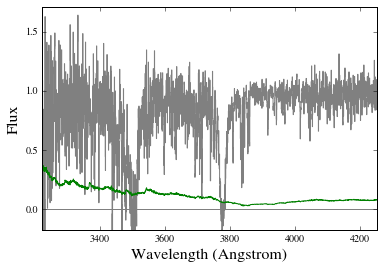

34.4735060467 1 / Angstrom
5.29411699216 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ135629.54+613310.4_b1200_F.fits.gz for BOSSJ1356+6133
S/N 34.4735060467 1 / Angstrom


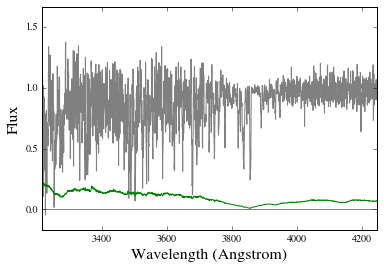

15.1103513223 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ135849.54+273756.9.fits for APOJ1358+2737
S/N 15.1103513223 1 / Angstrom


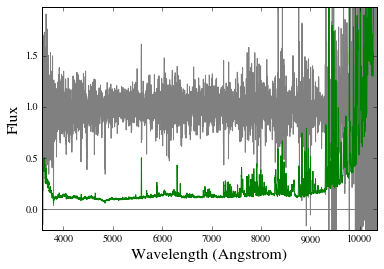

41.7015175221 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ142054.92+160342.9_F.fits.gz for APOJ1420+1603
S/N 41.7015175221 1 / Angstrom


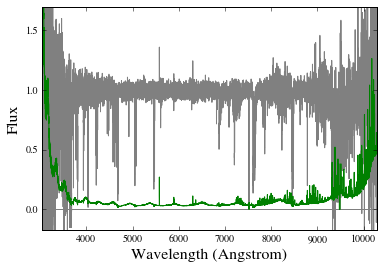

No continuum: /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ142758.74-012136.2_b1200_F.fits.gz
138.620893611 1 / Angstrom
105.908839572 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/MIKE_redux//./SDSSJ142758.74-012136.2_b_F.fits.gz for BOSSJ1427-0121
S/N 138.620893611 1 / Angstrom


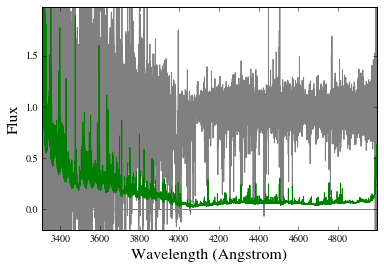

22.5674938369 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_4_45/SDSSJ143344.55+064111.9.fits for BOSSJ1433+0641
S/N 22.5674938369 1 / Angstrom


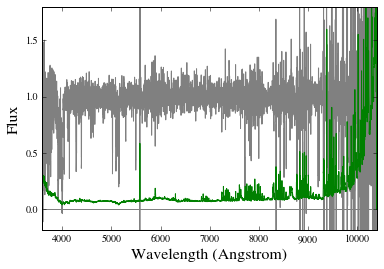

22.4699077216 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/MAGE_redux//./SDSSJ155325.89+192137.7_F.fits.gz for APOJ1553+1921
S/N 22.4699077216 1 / Angstrom


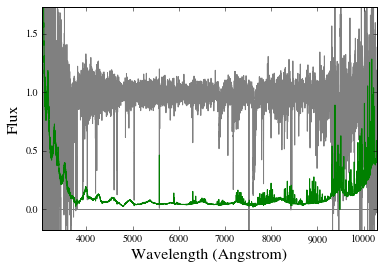

24.779005478 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ155946.28+494326.5_b1200_F.fits.gz for APOJ1559+4943
S/N 24.779005478 1 / Angstrom


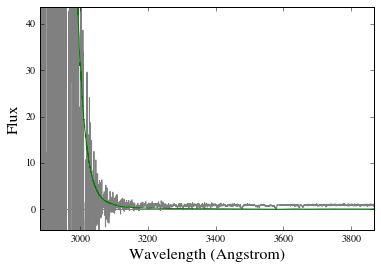

17.6300410978 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_6_0/SDSSJ160546.67+511323.0.fits for BOSSJ1605+5113
S/N 17.6300410978 1 / Angstrom


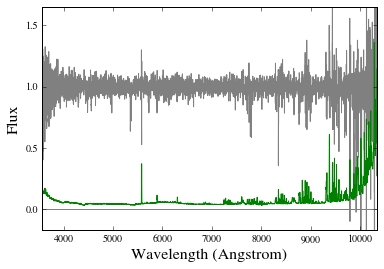

1.30299972739 1 / Angstrom
No spectrum found for BOSSJ1618+1842 and wvobs=4067.76 Angstrom!
119.709296397 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/ESI_redux//./SDSSJ162737.25+460609.3_F.fits.gz for APOJ1627+4606
S/N 119.709296397 1 / Angstrom


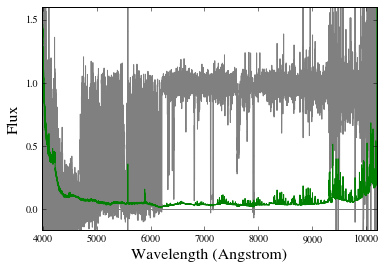

10.3337297074 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/BOSS/v5_5_0/SDSSJ225549.55-000927.7.fits for BOSSJ2255-0009
S/N 10.3337297074 1 / Angstrom


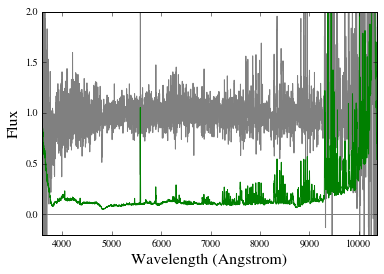

In [18]:
# Stack at CII
stack_tup0 = qpqk.load_stack_img(QPQ9,1334.5323*u.AA,vmnx=(-3000.,3000.)*u.km/u.s,
                                 S2N_cut=5.5/u.AA,atmosphere_cut=True,plot_indiv=False)
# Mask
fin_velo, stck_img, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
        pass
    if 'J1508+3635' in dd['qpq']['NAME']: #DLA not excluded by forest cut, should be excluded now
        idx_mask.append(ii) 
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

In [19]:
np.sum(stck_mskN,0)

array([ 34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,
        34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,
        34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,
        34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,
        34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,  34.,
        34.,  34.,  34.,  34.,  34.,  34.])

In [ ]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)
plt.show()

## Try updating redshifts to Shen+16

In [42]:
# Load QPQ9
qpq9 = eqpq.QPQ('QPQ9')
qpq9.cull(1334.5323*u.AA,4)
zfg = qpq9._fulldata['Z_FG']
bad = np.where((zfg < 1.6) | (zfg > 9999))[0]
qpq9.mask[bad] = False
QPQ9 = copy.deepcopy(qpq9._fulldata[qpq9.mask])
c_qpq9 = SkyCoord(ra=QPQ9['FG_RA']*u.deg,dec=QPQ9['FG_DEC']*u.deg)

Reading /Users/lwymarie/python/enigma/enigma/data/qpq/qpq9_final.fits


In [43]:
# Run this if want to replace [OIII] redshifts only 
# replace [OIII] with MgII or Halpha or Hbeta, in this order
for qq,cc in enumerate(c_qpq9):
    if QPQ9[qq]['ZFG_LINE'] == '[OIII]':
        for zz,zem in enumerate(zem_list):
            if cc.separation(zem_coord[zz]) < 5*u.arcsec:
                print(zem_coord[zz].to_string('hmsdms'))
                if zem['MGII_GAUS'] != -1:
                    QPQ9[qq]['Z_FG'] = zem['MGII_GAUS']/2799.4026-1
                    QPQ9[qq]['Z_FSIG'] = 272
                    QPQ9[qq]['ZFG_LINE'] = 'MgII'
                elif zem['HA_GAUS'] != -1:
                    QPQ9[qq]['Z_FG'] = zem['HA_GAUS']/6564.61-1
                    QPQ9[qq]['Z_FSIG'] = 109
                    QPQ9[qq]['ZFG_LINE'] = 'H$\\alpha$' 
                    print('Changed to Ha')
                elif zem['HB_GAUS'] != -1:
                    QPQ9[qq]['Z_FG'] = zem['HB_GAUS']/4862.68-1
                    QPQ9[qq]['Z_FSIG'] = 109
                    QPQ9[qq]['ZFG_LINE'] = 'H$\\beta$'
                    print('Changed to Hb')
                else:
                    print('[OIII] is kept')
                break

08h00m49.89s +35d42m49.6s
Changed to Hb
08h41m58.47s +39d21m21s
Changed to Hb
08h53m58.36s -00d11m08s
Changed to Hb
09h32m26.34s +09d25m26.1s
10h38m57.37s +50d27m08s
Changed to Hb
11h44m35.53s +09d59m21.6s
[OIII] is kept
12h04m17.47s +02d21m04.7s
12h15m59s +57d16m16.7s
Changed to Ha
12h31m43.09s +00d28m46.2s
14h20m54.418s +16d03m33.34s
14h27m58.88s -01d21m30.3s
14h33m45.5s +06d41m10s
15h53m25.61s +19d21m40.9s
Changed to Ha
16h27m38.63s +46d05m38.4s
Changed to Hb


In [14]:
# Run this if want to replace [OIII] redshifts only 
# replace [OIII] with MgII or Hbeta or Halpha, in this order
for qq,cc in enumerate(c_qpq9):
    if QPQ9[qq]['ZFG_LINE'] == '[OIII]':
        for zz,zem in enumerate(zem_list):
            if cc.separation(zem_coord[zz]) < 5*u.arcsec:
                print(zem_coord[zz].to_string('hmsdms'))
                if zem['MGII_GAUS'] != -1:
                    QPQ9[qq]['Z_FG'] = zem['MGII_GAUS']/2799.4026-1
                    QPQ9[qq]['Z_FSIG'] = 272
                    QPQ9[qq]['ZFG_LINE'] = 'MgII'
                elif zem['HB_GAUS'] != -1:
                    QPQ9[qq]['Z_FG'] = zem['HB_GAUS']/4862.68-1
                    QPQ9[qq]['Z_FSIG'] = 109
                    QPQ9[qq]['ZFG_LINE'] = 'H$\\beta$'
                    print('Changed to Hb')
                elif zem['HA_GAUS'] != -1:
                    QPQ9[qq]['Z_FG'] = zem['HA_GAUS']/6564.61-1
                    QPQ9[qq]['Z_FSIG'] = 109
                    QPQ9[qq]['ZFG_LINE'] = 'H$\\alpha$' 
                    print('Changed to Ha')
                else:
                    print('[OIII] is kept')
                break

08h00m49.89s +35d42m49.6s
Changed to Hb
08h41m58.47s +39d21m21s
Changed to Hb
08h53m58.36s -00d11m08s
Changed to Hb
09h32m26.34s +09d25m26.1s
10h38m57.37s +50d27m08s
Changed to Hb
11h44m35.53s +09d59m21.6s
[OIII] is kept
12h04m17.47s +02d21m04.7s
12h15m59s +57d16m16.7s
Changed to Hb
12h31m43.09s +00d28m46.2s
14h20m54.418s +16d03m33.34s
14h27m58.88s -01d21m30.3s
14h33m45.5s +06d41m10s
15h53m25.61s +19d21m40.9s
Changed to Hb
16h27m38.63s +46d05m38.4s
Changed to Hb


In [44]:
# Add the systematic biases in Shen+16
for ii,qq in enumerate(QPQ9):
    if qq['ZFG_LINE'] == 'MgII':
        # bring to z_em 
        qq['Z_FG'] = ltu.z_from_v(qq['Z_FG'],+70.)
        # bring to z_sys
        qq['Z_FG'] = ltu.z_from_v(qq['Z_FG'],+57.)
    if qq['ZFG_LINE'] == 'H$\\beta$':
        qq['Z_FG'] = ltu.z_from_v(qq['Z_FG'],+109.)
    if qq['ZFG_LINE'] == '[OIII]':
        # bring to z_em 
        qq['Z_FG'] = ltu.z_from_v(qq['Z_FG'],-27.)
        # bring to z_sys
        qq['Z_FG'] == ltu.z_from_v(qq['Z_FG'],+48.)
    # Also update SDSS-HW redshifts? # Will get centroid = +72 km/s
    if qq['ZFG_LINE'] == 'SDSS-HW':
        # Just trying 
        qq['Z_FG'] = ltu.z_from_v(qq['Z_FG'],+57.)

In [45]:
# Stack at CII
stack_tup0 = qpqk.load_stack_img(QPQ9,1334.5323*u.AA,vmnx=(-3000.,3000.)*u.km/u.s,
                                 S2N_cut=5.5/u.AA,atmosphere_cut=True,plot_indiv=False)
# Mask
fin_velo, stck_img, stck_msk, all_dict = stack_tup0
stck_mskN = copy.deepcopy(stck_msk)
idx_mask = []
for ii,dd in enumerate(all_dict):
    if dd is None:
        continue
        pass
    if 'J1508+3635' in dd['qpq']['NAME']: #DLA not excluded by forest cut, should be excluded now
        idx_mask.append(ii) 
for idx in idx_mask:
    stck_mskN[idx,:] = 0.

4.50292750736 1 / Angstrom
No spectrum found for BOSSJ0008-0039 and wvobs=3921.71 Angstrom!
3.96738337038 1 / Angstrom
No spectrum found for BOSSJ0042+1350 and wvobs=3705.49 Angstrom!
81.2002163512 1 / Angstrom
43.8725850917 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/GMOS_redux//./SDSSJ034139.19-000012.7_b1200_F.fits.gz for SDSSJ0341-0000
S/N 81.2002163512 1 / Angstrom
91.8840842366 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ080048.74+354231.3_b1200_F.fits.gz for APOJ0800+3542
S/N 91.8840842366 1 / Angstrom
6.81812554325 1 / Angstrom
Using spec-7328-56715-0428.fits.gz for BOSSJ0809+4539
S/N 6.81812554325 1 / Angstrom
No spectrum found for BOSSJ0826+4708 and wvobs=3735.68 Angstrom!
7.18837682491 1 / Angstrom
30.3853921563 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux//./SDSSJ082844.87+454518.2_b1200_F.fits.gz for SDSSJ0828+4545
S/N 30.3853921563 1 / Angstrom
30.2325672808 1 / Angstrom
Using /u/xavier/Dropbox//QSOPairs/data/LRIS_redux

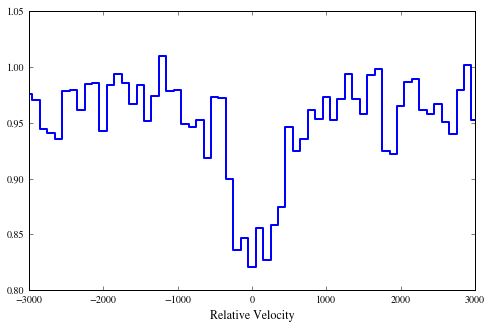

In [46]:
stack_tup = (fin_velo, stck_img, stck_mskN, all_dict)
fin_velo, fin_flx, all_dict = qpqk.stack_avg(stack_tup)
plt.figure(figsize=(8,5),dpi=1200)
plt.plot(fin_velo, fin_flx, drawstyle='steps-mid',linewidth=2.)
plt.xlabel('Relative Velocity', size=12.)
plt.show()

In [47]:
from linetools.spectra.xspectrum1d import XSpectrum1D
outfil = 'QPQ9_1334_Shen+16z_mean.fits'
relativistic_equiv = u.doppler_relativistic(1334.5323*u.AA)
fin_wave = fin_velo.to(u.AA,equivalencies=relativistic_equiv)
xspec1d = XSpectrum1D.from_tuple((fin_wave, u.Quantity(fin_flx)))
xspec1d.write_to_fits(outfil,clobber=True)

Wrote spectrum to QPQ9_1334_Shen+16z_mean.fits


Centroid velocity in km/s =  Parameter('mean_1', value=71.7607365923)
Error in centroid and dispersion =  28.0066724288 29.6198916888
tau-weighted centroid in km/s =  270.074653688


<CompoundModel9(amplitude_0=0.9679661756928908, amplitude_1=0.14815414363794538, mean_1=71.76073659230542, stddev_1=300.8481941308811)>

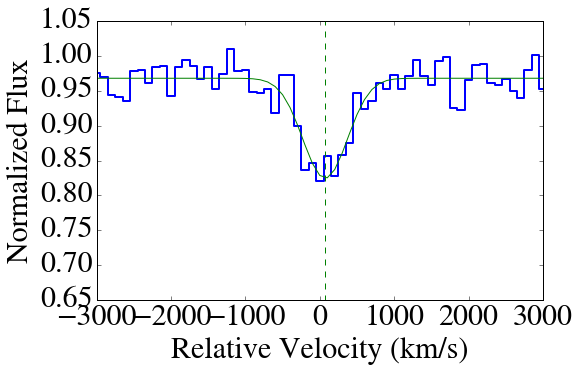

In [53]:
CII_stack = fits.open('QPQ9_1334_Shen+16z_mean.fits')
relativistic_equiv = u.doppler_relativistic(1334.5323*u.AA)
velo = (CII_stack[1].data*u.AA).to(u.km/u.s,equivalencies=relativistic_equiv)
g_init = models.GaussianAbsorption1D(amplitude=0.2,mean=140.,stddev=400.)
c_init = models.Const1D(amplitude=0.98)
model_init = c_init*(g_init)
fit = fitting.LevMarLSQFitter()
model_final = fit(model_init,velo,CII_stack[0].data)
plt.figure(figsize=(8,5))
plt.plot(velo.value, CII_stack[0].data,drawstyle='steps-mid',linewidth=2.)
plt.plot(velo.value, model_final(velo.value), label='Gaussian')
plt.plot([model_final.mean_1.value,model_final.mean_1.value],[0,2],'g--')
plt.axis([-3000,3000,0.65,1.05])
plt.xlabel('Relative Velocity (km/s)', size=30)
plt.ylabel('Normalized Flux',size=30)
plt.tick_params(axis='both', which='major', labelsize=30)
print('Centroid velocity in km/s = ',model_final.mean_1)
print('Error in centroid and dispersion = ',np.sqrt(fit.fit_info['param_cov'][2][2]),np.sqrt(fit.fit_info['param_cov'][3][3]))
#tau-weighted centroid
tau = np.log(1./(CII_stack[0].data/model_final.amplitude_0))
start = np.int((len(velo)-1)*1./6.)-1
end = np.int((len(velo)-1)*5./6.)+1
tau_cen = np.sum(velo.value[start:end]*tau[start:end])/np.sum(tau[start:end])
print('tau-weighted centroid in km/s = ',tau_cen)
dict = {}
for ii,pp in enumerate(model_final.parameters):
    dict[model_final.param_names[ii]] = [pp]
ascii.write(Table(dict),'CII_MgII_mean_fit.dat')
model_final

In [27]:
# Find mean redshift errors 
sigmas = np.array([221,67,272,221,300,67,67,221,221,221,67,221,221,417,221,67,221,417,67,67,67,67,221,300,221,221,67,
                   67,67,67,221,221,67,221])

In [26]:
np.sqrt(37**2+56**2),np.sqrt(400**2+119**2),np.sqrt(200**2+94**2)

(67.119296778199342, 417.32601165036431, 220.9886874932742)

In [30]:
np.sqrt(np.mean(sigmas**2))

202.71850955856758

In [34]:
np.sqrt(369**2-203**2)

308.14282402807953

In [33]:
np.sqrt(355**2-67**2)

348.62013711201479